In [37]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


sns.set_style("whitegrid")

In [8]:
from scipy.stats import moment
from scipy.stats import describe

In [9]:
def basic_stats_error(datalist):
    
    if len(datalist)>1:
        result_describe = list(describe(datalist)[2:])
        result_percentile = result_describe + list(np.percentile(datalist,[10,25,50,75,90]))
        array = np.array(datalist)
        result_percentile = result_percentile+[len(array),len(array[np.where(array>0)[0]])/len(array)*100,
                                               len(array[np.where(array<0)[0]])/len(array)*100]
    else:
        result_percentile = []

    return result_percentile

In [56]:
describe([1,2,3,4,5,6,7,8])

DescribeResult(nobs=8, minmax=(1, 8), mean=4.5, variance=6.0, skewness=0.0, kurtosis=-1.2380952380952381)

In [3]:
noun_sentence_df_final_reindex_df = pd.read_feather('noun_sentence_df_final_reindex_df.fea')

In [57]:
noun_sentence_df_final_reindex_df.columns

Index(['index', 'AVM_Error_List', 'Listing_Error_List', 'Listingid_List',
       'noun_sentence_corrections_embeddings', 'AVM_Error_Indicators',
       'Listing_Error_Indicators', 'AVM_Error_List_count',
       'Listing_Error_List_count', 'Listingid_List_count'],
      dtype='object')

In [59]:
noun_sentence_df_final_reindex_df.head(1)

,index,AVM_Error_List,Listing_Error_List,Listingid_List,noun_sentence_corrections_embeddings,AVM_Error_Indicators,Listing_Error_Indicators,AVM_Error_List_count,Listing_Error_List_count,Listingid_List_count
160,digitdigit,"[0.23705872727272725, 0.3935276169265033, -0.0...","[0.03636363636363636, 0.16481069042316257, -0....","[226955936, 226027366, 226062913, 226871633, 2...","[-0.051151186, -0.01976485, -0.02099902, 0.070...","[0.001799202155746338, 0.03519902312117105, -1...","[-0.0493439661624518, 0.010351003841992477, -3...",1332890,1332890,1332890


In [58]:
noun_sentence_df_final_reindex_df['AVM_Error_Indicators'].values[0]

[0.001799202155746338,
 0.03519902312117105,
 -1.2394612693913052,
 7.132379904211502,
 -0.17853966666666676,
 -0.07563054583624917,
 0.004455166666666677,
 0.09308670329670332,
 0.20473713114754089,
 1332890,
 51.510627283571786,
 48.489372716428214]

In [10]:
noun_sentence_df_final_reindex_df['AVM_Error_Indicators'] = noun_sentence_df_final_reindex_df['AVM_Error_List'].apply(lambda x: basic_stats_error(x))

In [11]:
noun_sentence_df_final_reindex_df['Listing_Error_Indicators'] = noun_sentence_df_final_reindex_df['Listing_Error_List'].apply(lambda x: basic_stats_error(x))

In [12]:
noun_sentence_df_final_reindex_df

,index,AVM_Error_List,Listing_Error_List,Listingid_List,noun_sentence_corrections_embeddings,AVM_Error_Indicators,Listing_Error_Indicators
0,new bathrooms,"[0.10878560975609752, 0.0656260194174757, 0.25...","[0.024878048780487806, 0.032362459546925564, -...","[229017180, 229329212, 215966190, 231445008, 1...","[-0.011923872, -0.040925846, -0.060033374, -0....","[0.12710563082025159, 0.03797707814719036, -0....","[-0.04844011373672176, 0.0064442156371367285, ..."
1,new vanities,"[0.2046909923664122, 0.25085974999999994, 0.31...","[-0.029770992366412213, -0.07416666666666667, ...","[226851936, 227207328, 228059944, 228694545, 2...","[-0.05858002, -0.078841336, 0.007744186, -0.04...","[0.10859357389313391, 0.03146946706234901, 0.2...","[-0.03939157831539426, 0.006370195642863663, -..."
2,quartz countertops,"[0.07266934782608703, 0.04711003921568624, 0.2...","[0.0, 0.021568627450980392, 0.0, -0.1217073170...","[227301599, 227066289, 227003853, 228078778, 2...","[-0.030976344, 0.010525043, 0.008025839, -0.02...","[0.10278558717924147, 0.0300275849369525, 0.28...","[-0.028740320391495287, 0.004150199369384, -3...."
3,top bottom,"[-0.17483815668202762, 0.14467078688524593, 0....","[-0.03686635944700461, -0.04885245901639344, -...","[226661263, 227553043, 227207328, 227436501, 2...","[-0.055551246, -0.050620284, 0.022666093, 0.04...","[0.10252106060171957, 0.029362176033909306, 0....","[-0.043342693333633595, 0.007001744630591242, ..."
4,new kitchen cabinets,"[0.3935276169265033, -0.02473273949579835, 0.2...","[0.16481069042316257, -0.008067226890756302, -...","[226027366, 227018382, 228973883, 229099586, 2...","[-0.0027903197, 0.035919096, -0.03295671, -0.0...","[0.06349636673543807, 0.03165227364315959, -0....","[-0.043469152422077995, 0.007031763497734845, ..."
...,...,...,...,...,...,...,...
5423,seller requests buyer use seller,"[-1.3322289999999999, 0.16222735849056613, -0....","[-0.25, -0.1320754716981132, 0.042553191489361...","[198263962, 200651017, 209001692, 212786867, 1...","[-0.071547754, -0.007990354, 0.044830173, 0.01...","[-0.38333426451694014, 0.14118332477478868, -0...","[-0.020515015912612608, 0.03274158365671943, -..."
5424,great home investors,"[0.2702147777777778, -0.23938986666666673, -0....","[-0.1, -0.19866666666666666, -0.08790322580645...","[197054770, 3232636, 151180267, 130595497, 532...","[-0.021865588, -0.05759102, -0.037234746, -0.0...","[-0.3949718558900011, 0.19840775937258184, -0....","[-0.09646376871182749, 0.021014897596130223, -..."
5425,needs repairs,"[-0.7064920000000001, -0.2677977391304347, -0....","[-0.047619047619047616, -0.08695652173913043, ...","[230618952, 187242734, 196407010, 139519327, 5...","[-0.04354262, -0.037721384, 0.010220117, 0.044...","[-0.4032442734091763, 0.14411336538546365, -0....","[-0.12695612324300912, 0.04233632919491009, -1..."
5426,seller chooses attorney,"[0.06298180555555555, -0.2739625714285714, -0....","[0.02847222222222222, -0.2571428571428571, -0....","[77911179, 189586243, 180510904, 77958589, 854...","[-0.05809925, -0.012980465, -0.021596901, 0.03...","[-0.4837196232059463, 0.1564176054870049, 0.07...","[-0.034887794557957034, 0.03955142645604079, -..."


In [13]:
noun_sentence_df_final_reindex_df['AVM_Error_List_count'] = noun_sentence_df_final_reindex_df['AVM_Error_List'].apply(lambda x: len(x))

In [15]:
noun_sentence_df_final_reindex_df['Listing_Error_List_count'] = noun_sentence_df_final_reindex_df['Listing_Error_List'].apply(lambda x: len(x))

In [17]:
noun_sentence_df_final_reindex_df['Listingid_List_count'] = noun_sentence_df_final_reindex_df['Listingid_List'].apply(lambda x: len(x))

In [18]:
noun_sentence_df_final_reindex_df

,index,AVM_Error_List,Listing_Error_List,Listingid_List,noun_sentence_corrections_embeddings,AVM_Error_Indicators,Listing_Error_Indicators,AVM_Error_List_count,Listing_Error_List_count,Listingid_List_count
0,new bathrooms,"[0.10878560975609752, 0.0656260194174757, 0.25...","[0.024878048780487806, 0.032362459546925564, -...","[229017180, 229329212, 215966190, 231445008, 1...","[-0.011923872, -0.040925846, -0.060033374, -0....","[0.12710563082025159, 0.03797707814719036, -0....","[-0.04844011373672176, 0.0064442156371367285, ...",1523,1523,1523
1,new vanities,"[0.2046909923664122, 0.25085974999999994, 0.31...","[-0.029770992366412213, -0.07416666666666667, ...","[226851936, 227207328, 228059944, 228694545, 2...","[-0.05858002, -0.078841336, 0.007744186, -0.04...","[0.10859357389313391, 0.03146946706234901, 0.2...","[-0.03939157831539426, 0.006370195642863663, -...",1300,1300,1300
2,quartz countertops,"[0.07266934782608703, 0.04711003921568624, 0.2...","[0.0, 0.021568627450980392, 0.0, -0.1217073170...","[227301599, 227066289, 227003853, 228078778, 2...","[-0.030976344, 0.010525043, 0.008025839, -0.02...","[0.10278558717924147, 0.0300275849369525, 0.28...","[-0.028740320391495287, 0.004150199369384, -3....",8006,8006,8006
3,top bottom,"[-0.17483815668202762, 0.14467078688524593, 0....","[-0.03686635944700461, -0.04885245901639344, -...","[226661263, 227553043, 227207328, 227436501, 2...","[-0.055551246, -0.050620284, 0.022666093, 0.04...","[0.10252106060171957, 0.029362176033909306, 0....","[-0.043342693333633595, 0.007001744630591242, ...",1218,1218,1218
4,new kitchen cabinets,"[0.3935276169265033, -0.02473273949579835, 0.2...","[0.16481069042316257, -0.008067226890756302, -...","[226027366, 227018382, 228973883, 229099586, 2...","[-0.0027903197, 0.035919096, -0.03295671, -0.0...","[0.06349636673543807, 0.03165227364315959, -0....","[-0.043469152422077995, 0.007031763497734845, ...",10781,10781,10781
...,...,...,...,...,...,...,...,...,...,...
5423,seller requests buyer use seller,"[-1.3322289999999999, 0.16222735849056613, -0....","[-0.25, -0.1320754716981132, 0.042553191489361...","[198263962, 200651017, 209001692, 212786867, 1...","[-0.071547754, -0.007990354, 0.044830173, 0.01...","[-0.38333426451694014, 0.14118332477478868, -0...","[-0.020515015912612608, 0.03274158365671943, -...",68,68,68
5424,great home investors,"[0.2702147777777778, -0.23938986666666673, -0....","[-0.1, -0.19866666666666666, -0.08790322580645...","[197054770, 3232636, 151180267, 130595497, 532...","[-0.021865588, -0.05759102, -0.037234746, -0.0...","[-0.3949718558900011, 0.19840775937258184, -0....","[-0.09646376871182749, 0.021014897596130223, -...",61,61,61
5425,needs repairs,"[-0.7064920000000001, -0.2677977391304347, -0....","[-0.047619047619047616, -0.08695652173913043, ...","[230618952, 187242734, 196407010, 139519327, 5...","[-0.04354262, -0.037721384, 0.010220117, 0.044...","[-0.4032442734091763, 0.14411336538546365, -0....","[-0.12695612324300912, 0.04233632919491009, -1...",92,92,92
5426,seller chooses attorney,"[0.06298180555555555, -0.2739625714285714, -0....","[0.02847222222222222, -0.2571428571428571, -0....","[77911179, 189586243, 180510904, 77958589, 854...","[-0.05809925, -0.012980465, -0.021596901, 0.03...","[-0.4837196232059463, 0.1564176054870049, 0.07...","[-0.034887794557957034, 0.03955142645604079, -...",77,77,77


In [24]:
noun_sentence_df_final_reindex_df = noun_sentence_df_final_reindex_df.sort_values(['AVM_Error_List_count'],ascending=False)

(array([1.9000e+02, 3.7000e+02, 3.8000e+02, 6.0000e+02, 6.2000e+02,
        7.0000e+02, 9.1000e+02, 9.7000e+02, 1.4400e+03, 1.7000e+03,
        2.0400e+03, 2.7800e+03, 3.8800e+03, 5.3600e+03, 7.1200e+03,
        1.0960e+04, 1.7540e+04, 3.0700e+04, 5.7970e+04, 1.2459e+05,
        2.4773e+05, 3.0876e+05, 2.1967e+05, 1.2383e+05, 6.9380e+04,
        4.0600e+04, 2.4280e+04, 1.4730e+04, 8.6500e+03, 4.4400e+03]),
 array([-1.49238762, -1.42264915, -1.35291068, -1.28317221, -1.21343374,
        -1.14369526, -1.07395679, -1.00421832, -0.93447985, -0.86474138,
        -0.79500291, -0.72526444, -0.65552597, -0.58578749, -0.51604902,
        -0.44631055, -0.37657208, -0.30683361, -0.23709514, -0.16735667,
        -0.0976182 , -0.02787972,  0.04185875,  0.11159722,  0.18133569,
         0.25107416,  0.32081263,  0.3905511 ,  0.46028957,  0.53002805,
         0.59976652]),
 <a list of 30 Patch objects>)

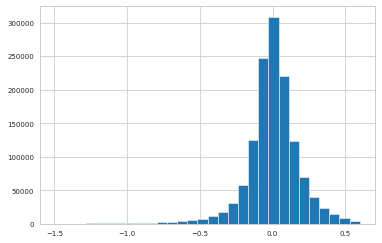

In [38]:
plt.hist(noun_sentence_df_final_reindex_df['AVM_Error_List'].iloc[0],bins=30)

0.001799202155746338


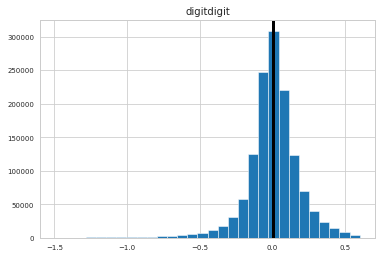

In [52]:
which = 0
plt.hist(noun_sentence_df_final_reindex_df['AVM_Error_List'].iloc[which],bins=30)
plt.axvline(x=0,linewidth=3,color='k')
plt.title(noun_sentence_df_final_reindex_df['index'].iloc[which])
print(np.mean(noun_sentence_df_final_reindex_df['AVM_Error_List'].iloc[which]))

0.001799202155746338


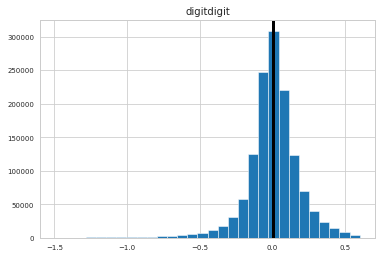

-0.0006426987403536736


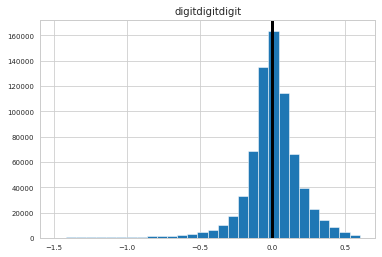

-0.0032887929096413675


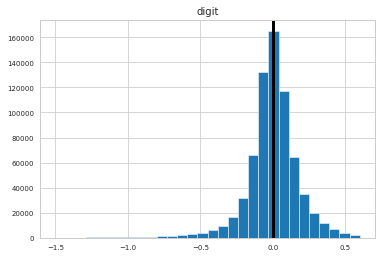

0.010333160017378003


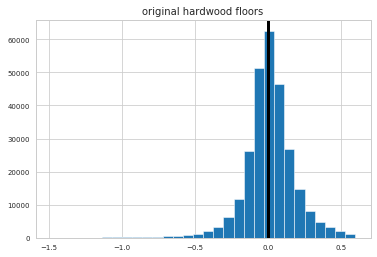

0.03054963401523638


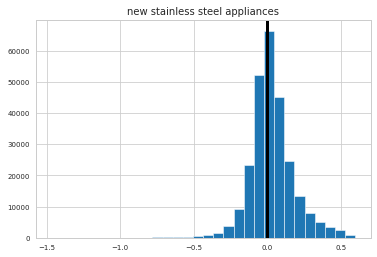

0.005194783110621833


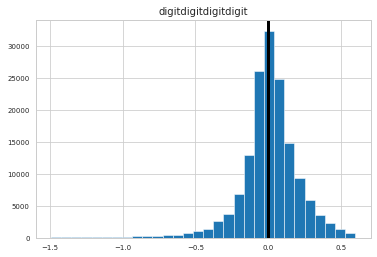

-0.003583221487749071


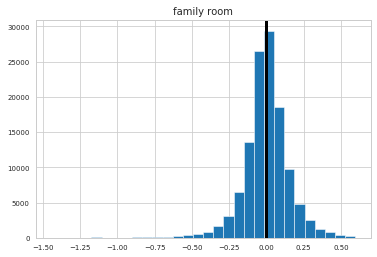

-0.0024435226626696328


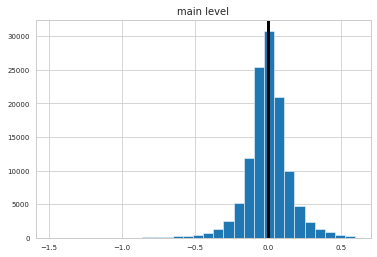

-0.00543099487202504


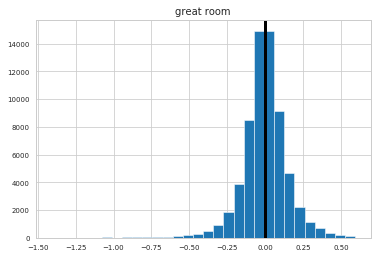

-0.01213209598088329


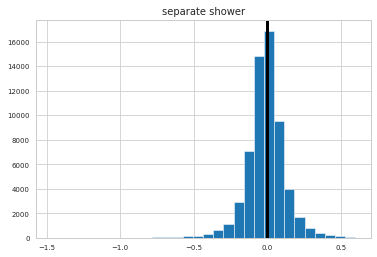

0.030267105838636784


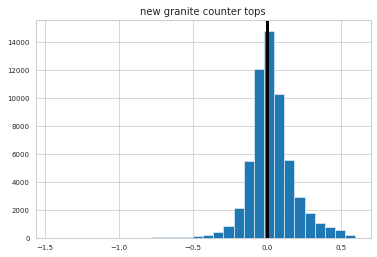

0.007324042038797658


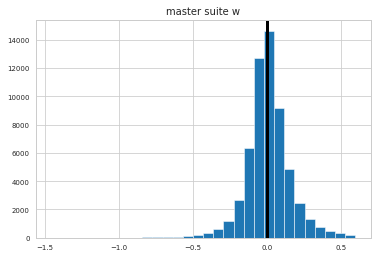

0.00055645936129935


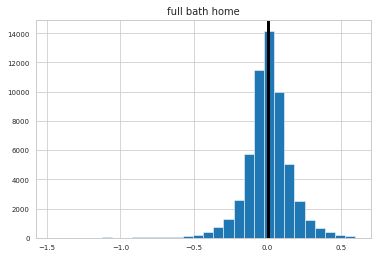

-3.47067251363597e-05


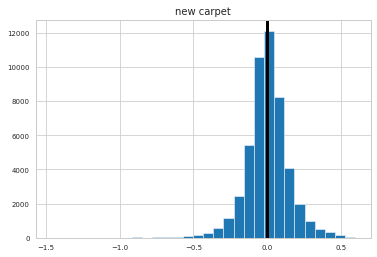

-0.012361599732615334


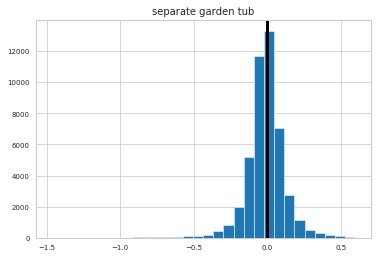

-0.008900603281105793


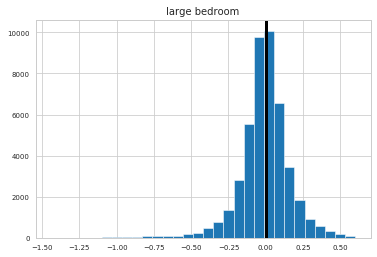

-0.005074283499144962


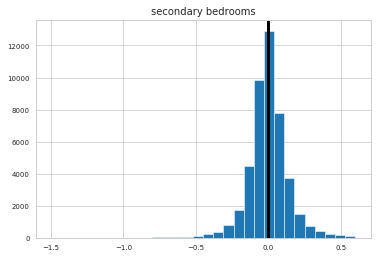

-0.025554531547505373


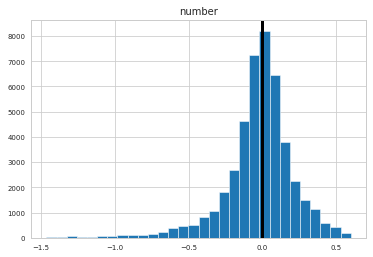

-0.005515103922424587


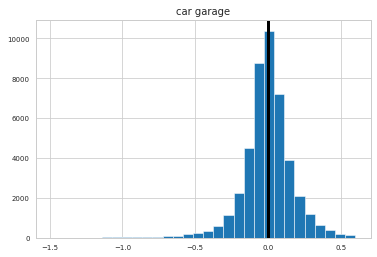

0.003079969290965016


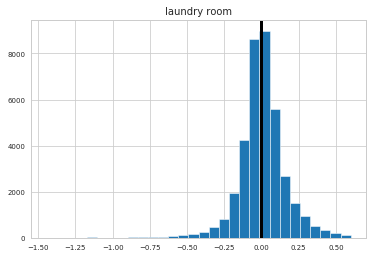

-0.0006955425130532245


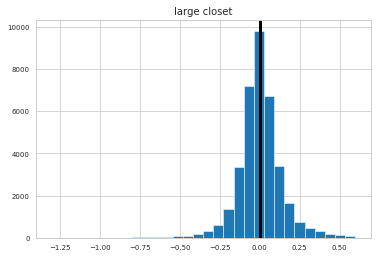

-0.013837375408641281


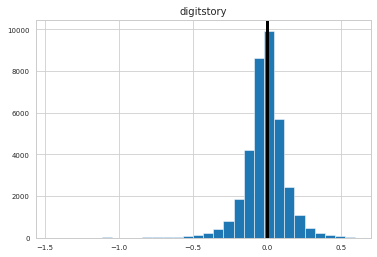

0.00537580100039921


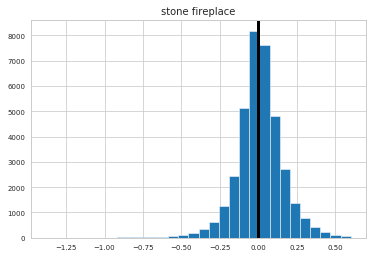

0.030453141305803448


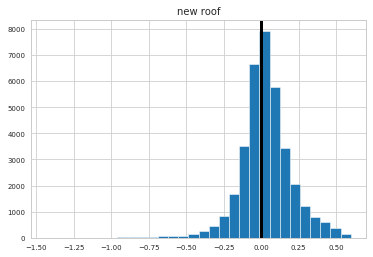

-0.007554526503056289


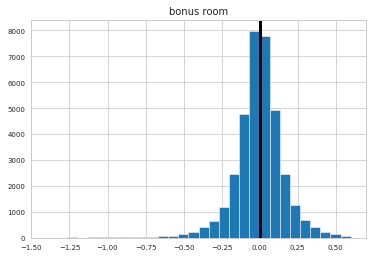

-0.006064910741834424


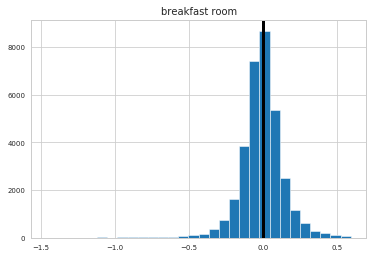

0.005599447936277037


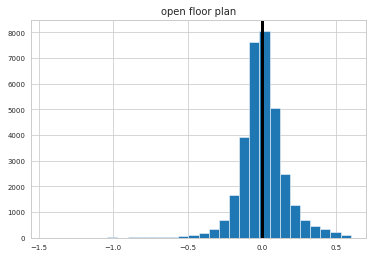

-0.0073468484767228864


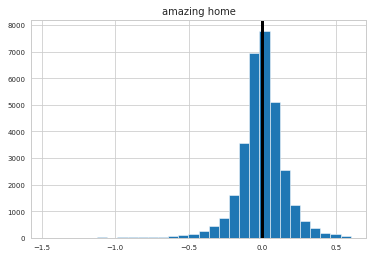

-0.013282293791580104


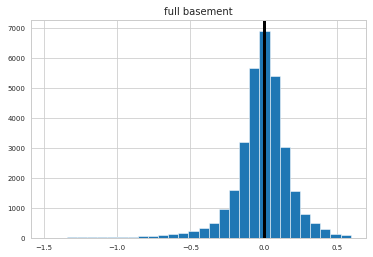

-0.006039462096749182


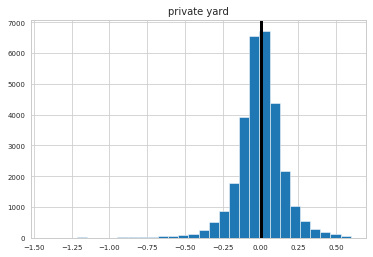

-0.013015735524728659


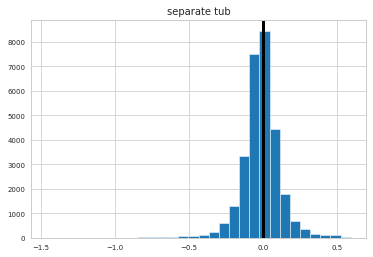

-0.0021976883946872544


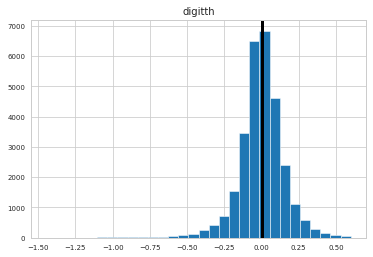

0.020703677186928345


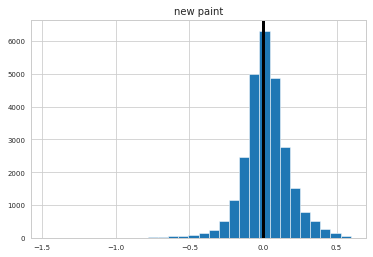

0.008871880972902276


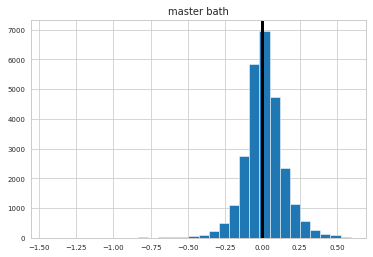

0.0004014993374313872


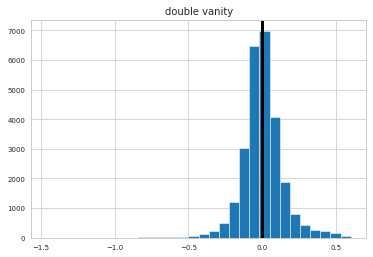

0.004182875662051413


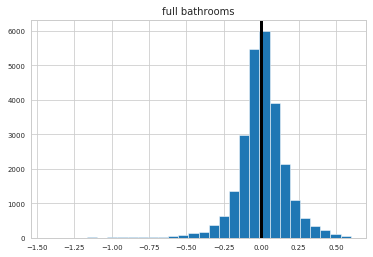

-0.01887766501923639


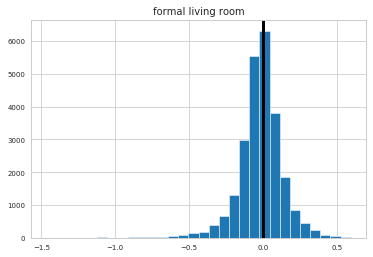

0.02640588540027666


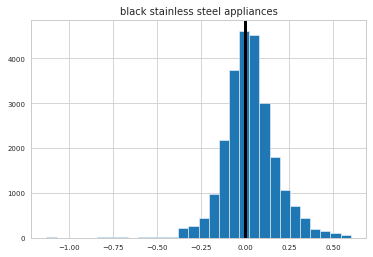

-0.007140609540453873


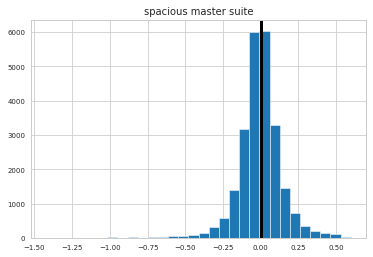

-0.013081623994729894


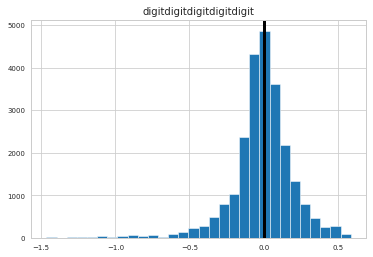

0.009430254555523744


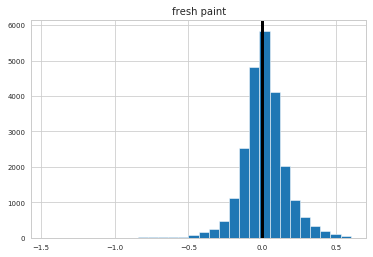

0.004103644231073616


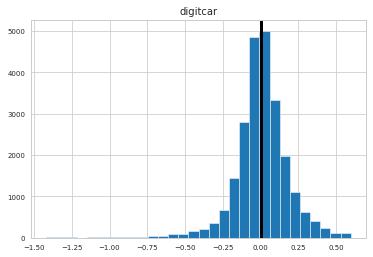

-0.006166811133253746


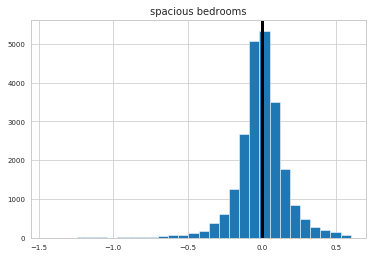

0.0011736303036411365


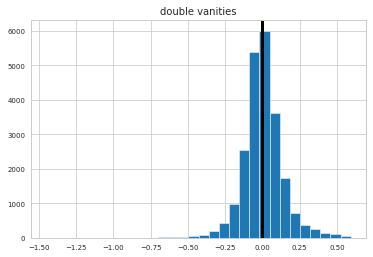

0.0023206421105474296


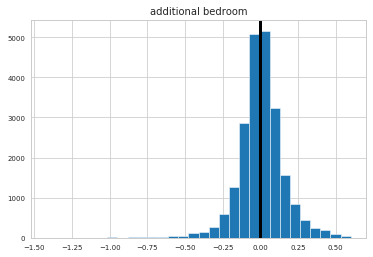

0.03660951075659063


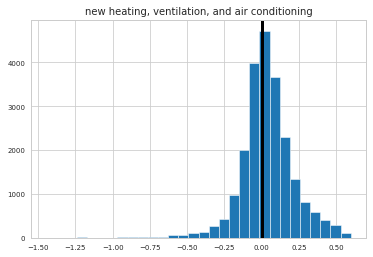

-0.02489064770570783


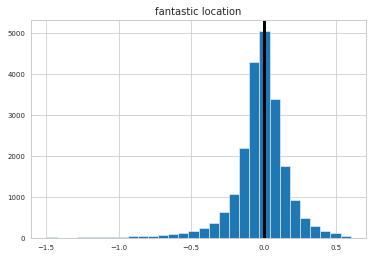

0.005785052677286547


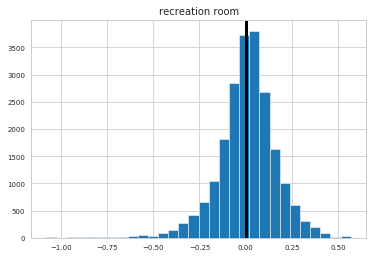

-0.017027588754473633


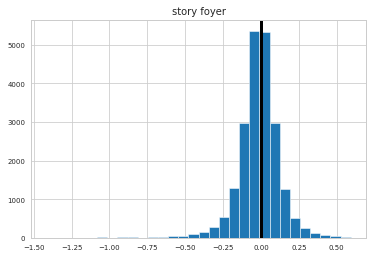

0.004202795975533731


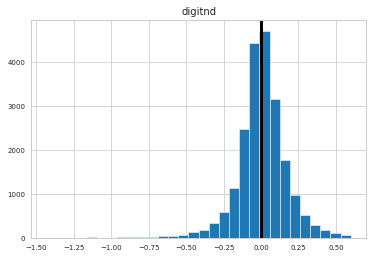

-0.0011646532851572375


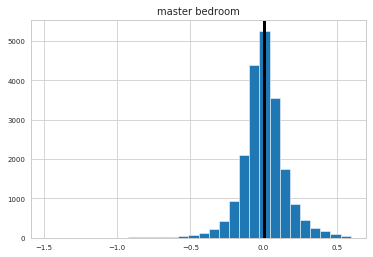

0.002360339496495661


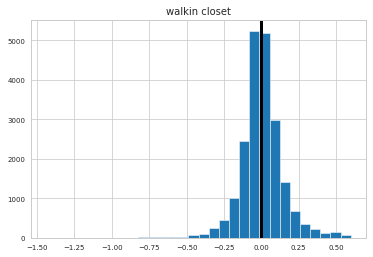

0.006391957030008691


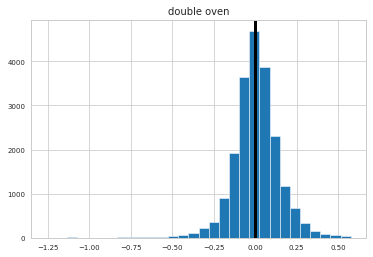

-0.010838499726151786


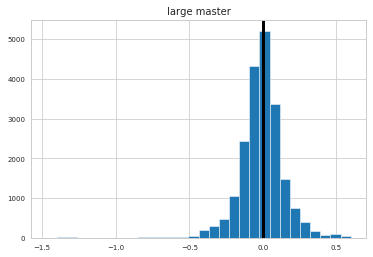

0.02518170339377321


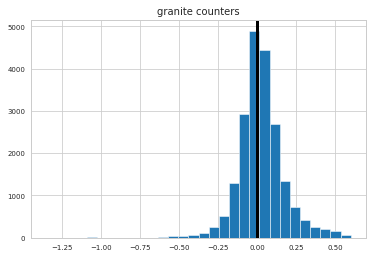

0.0048437931483140215


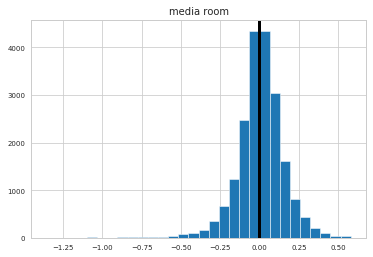

0.029834202236116575


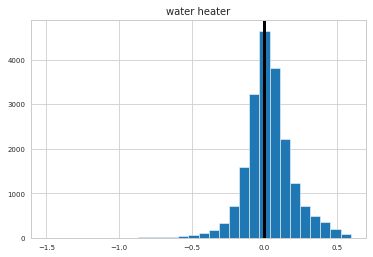

0.01971500987043749


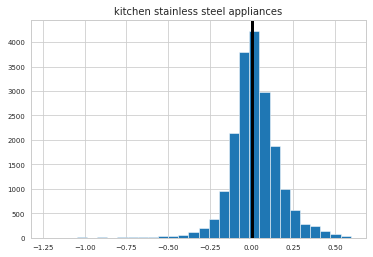

-0.00297314614535225


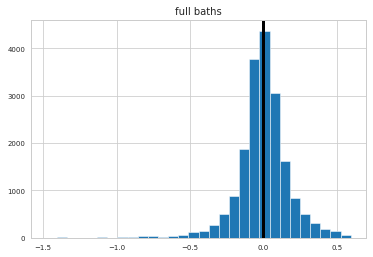

-0.008595308876249699


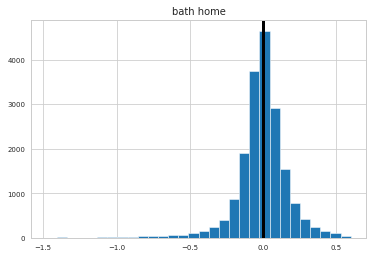

0.013027772499751384


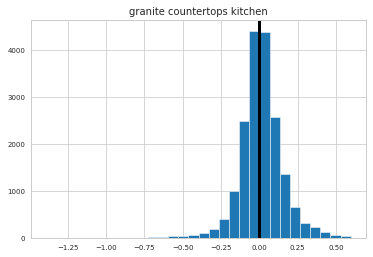

0.011426342858442379


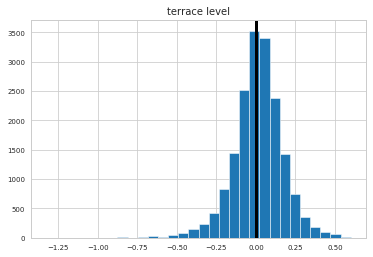

0.010679724242668142


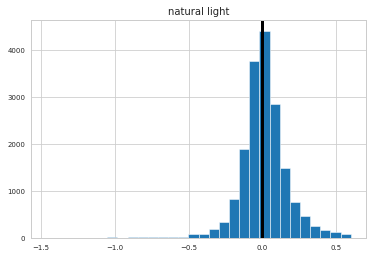

-0.0012837595072884695


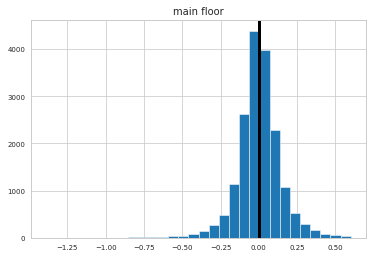

-0.017355374078141583


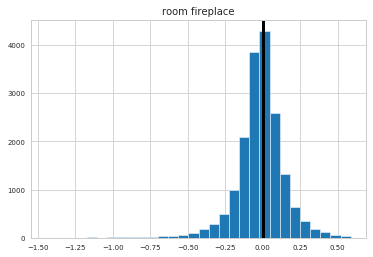

0.0075971175262557955


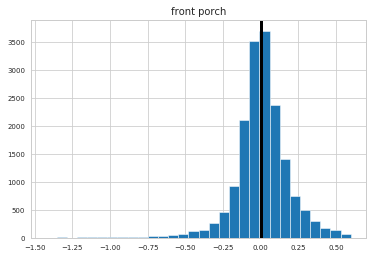

0.008152634135517471


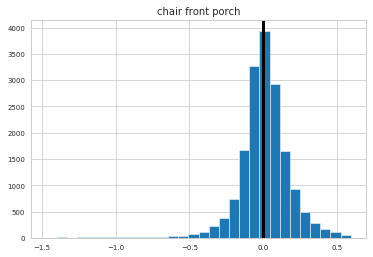

0.008002676517386065


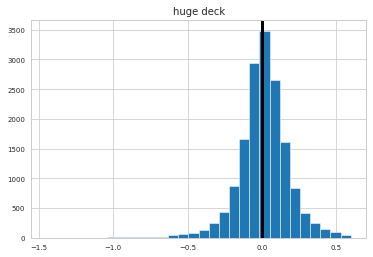

-0.020027956927483014


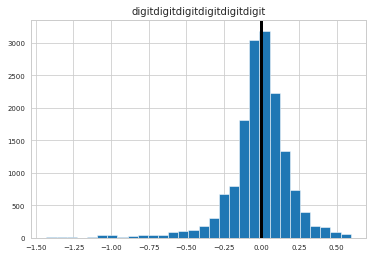

-0.008802633949408577


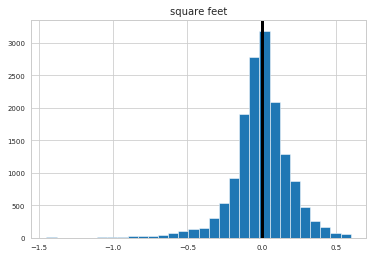

-0.003925859451313481


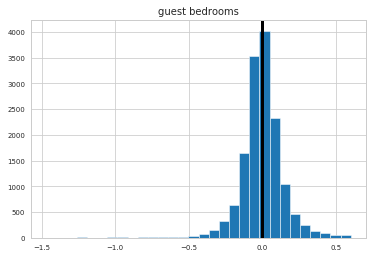

-0.0005679664129690541


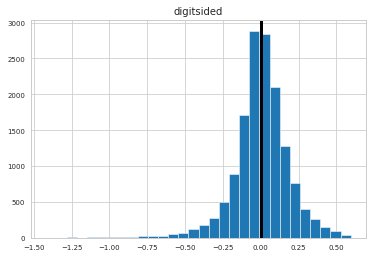

-0.024460465343177057


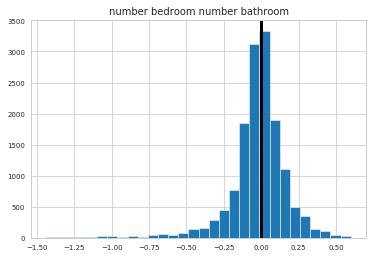

-0.0022175502893011954


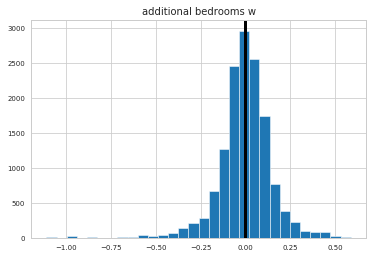

0.016714132678391398


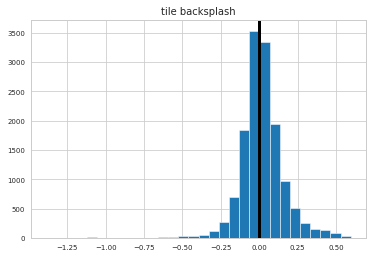

0.0010541655331830818


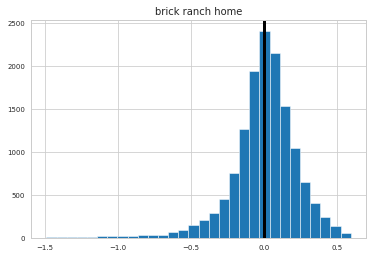

-0.005026680446625274


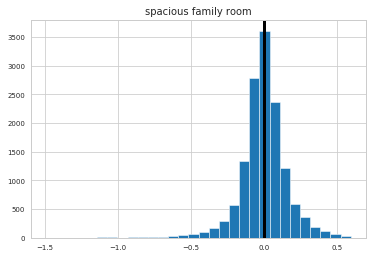

-0.00015995075918370227


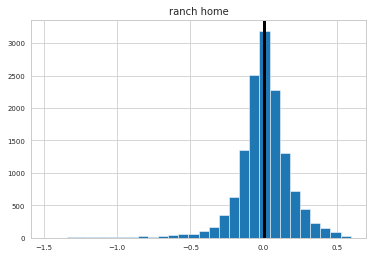

-0.014819023507969898


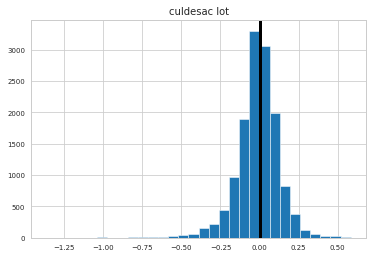

-0.0017034631406013313


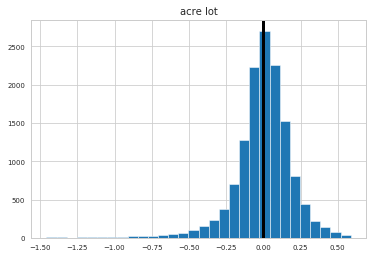

0.004325761337250526


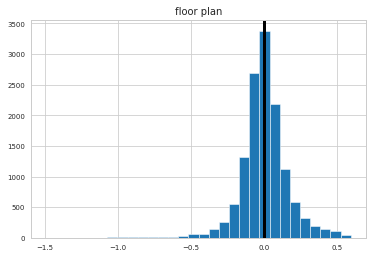

-0.012453398357105518


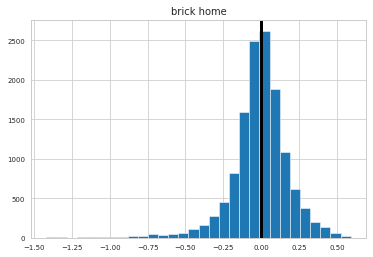

0.01638071075774891


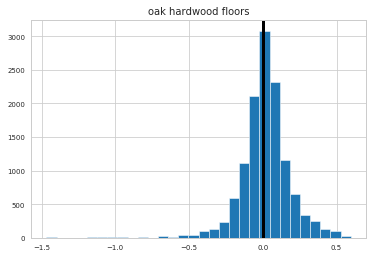

0.009763890622525914


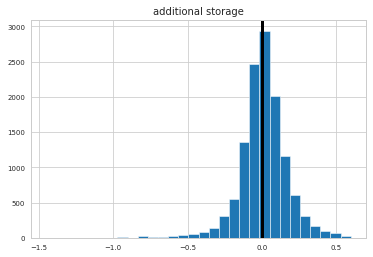

-0.008967724044618968


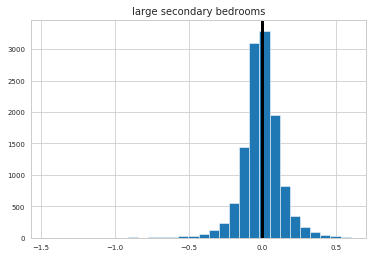

-0.01380614076383672


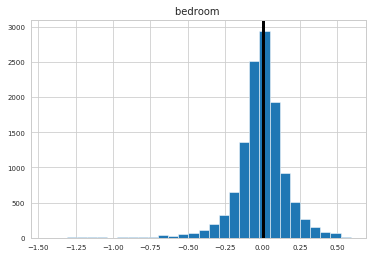

-0.01902007018533356


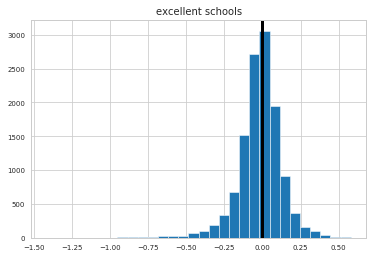

-0.018662230742108418


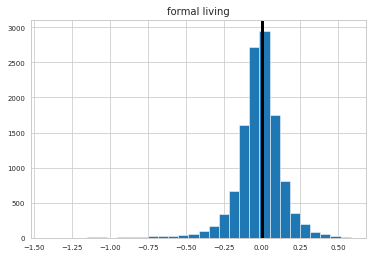

-0.004554587907747357


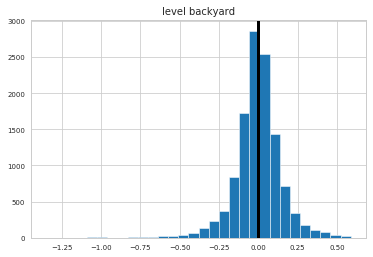

0.00936210543735567


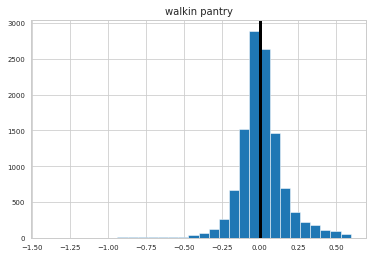

-0.01630994329647936


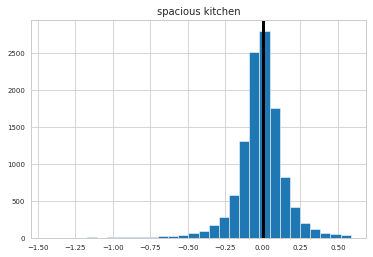

0.012846004709194453


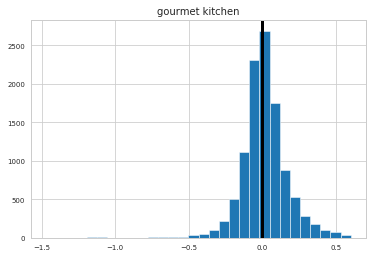

0.06349636673543807


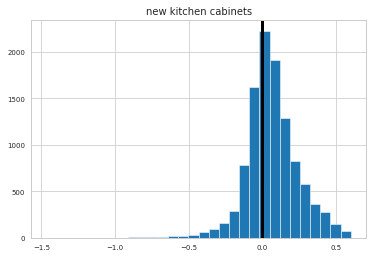

-0.011009592734751645


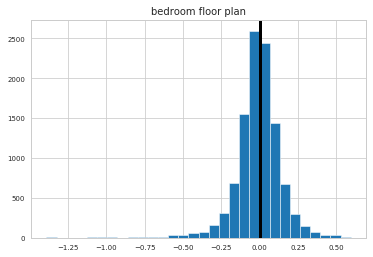

0.013172433341678051


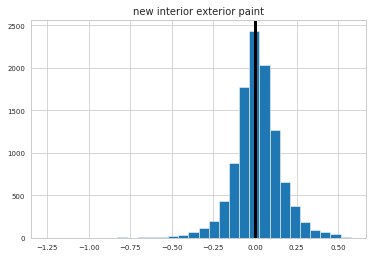

0.041486147492141565


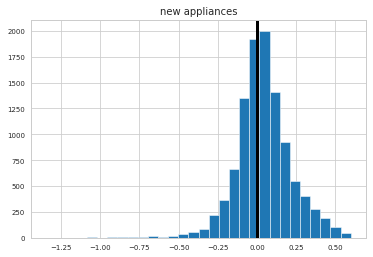

-0.01345911912735108


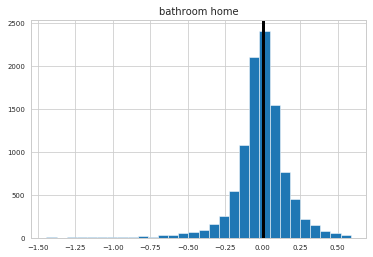

-0.009481954971456652


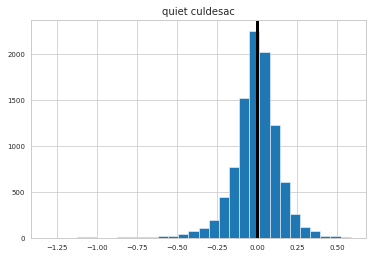

-0.007696345546395374


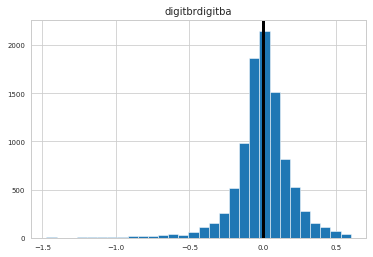

-0.021881208614847103


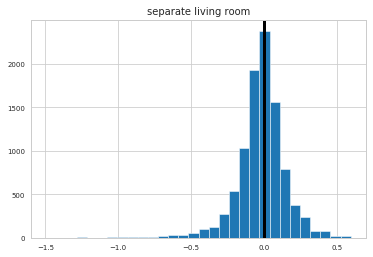

-0.017549491591249685


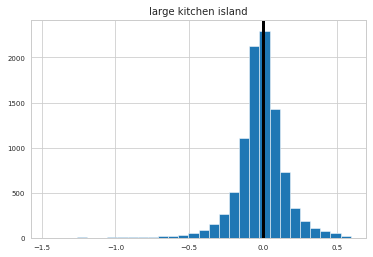

0.037607842280051026


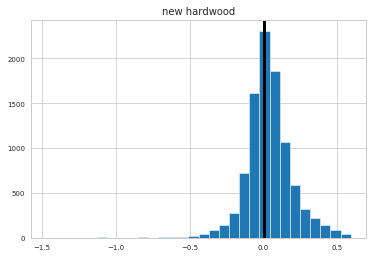

0.015367884355803961


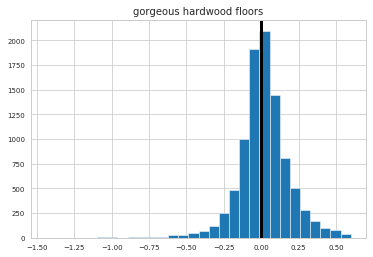

-0.0030814639852189828


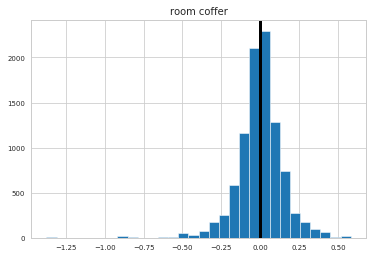

0.041928832586224714


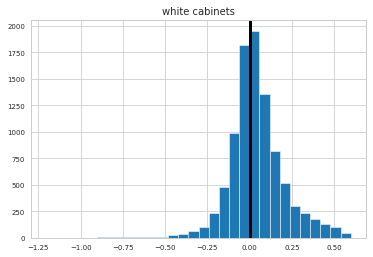

0.006430144044178265


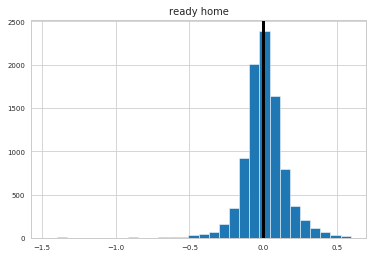

-0.0018198807180969953


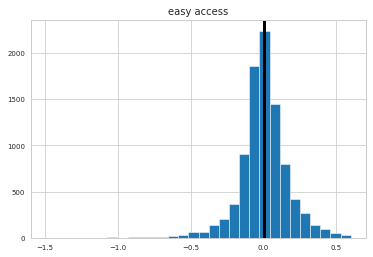

0.0024171997491350904


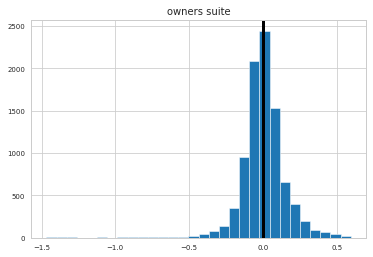

0.07531814426174555


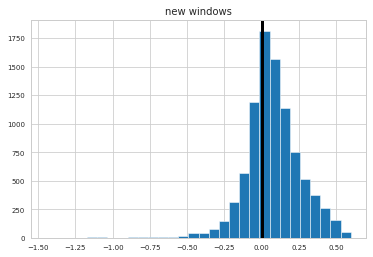

-0.027312946471705884


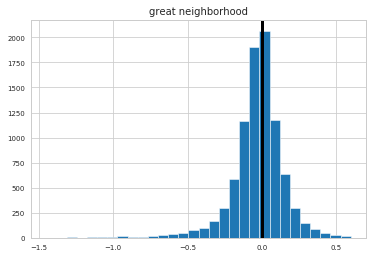

-0.007317118500249028


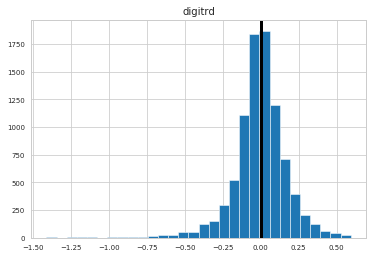

0.0009641130740097784


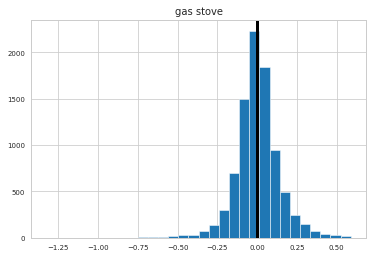

-0.013109613944658049


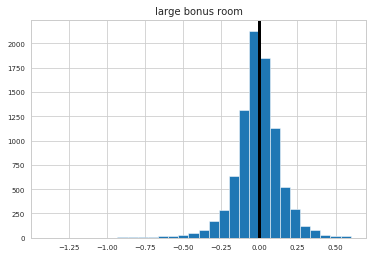

-0.010966893174971097


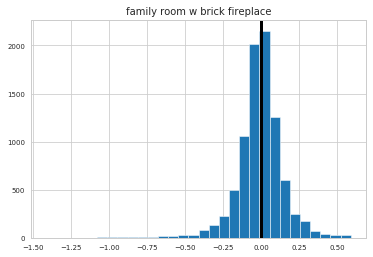

-0.0046605137603804945


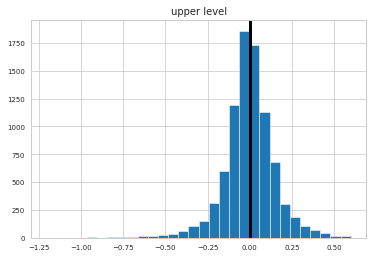

-0.014040285209902496


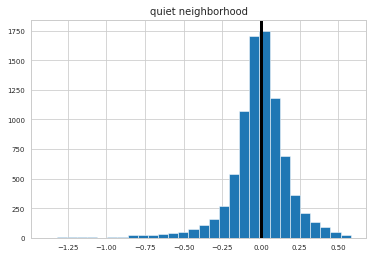

-0.01700400933565072


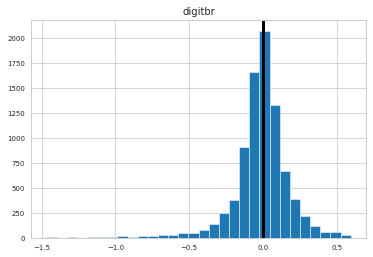

-0.01793182491123611


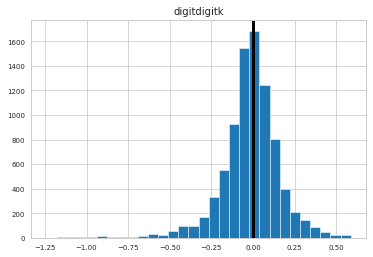

0.035049618928629005


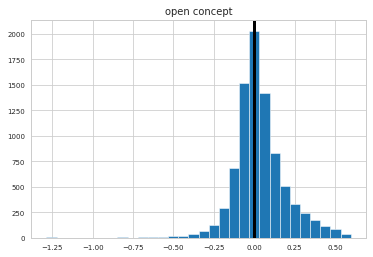

-0.029171557060791678


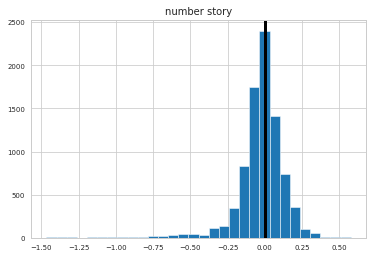

0.02405081413300716


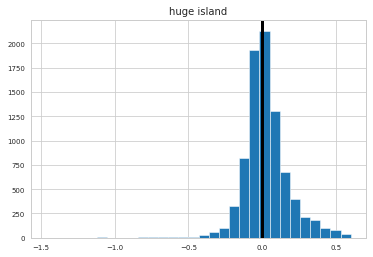

-0.00491428415103966


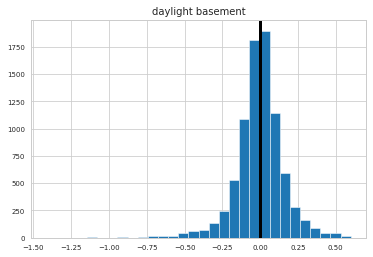

-0.020234578791449128


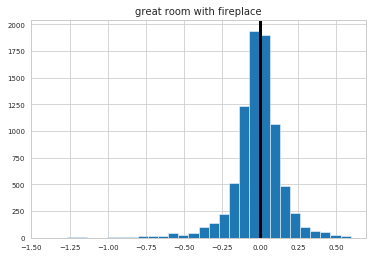

-0.009140311175815846


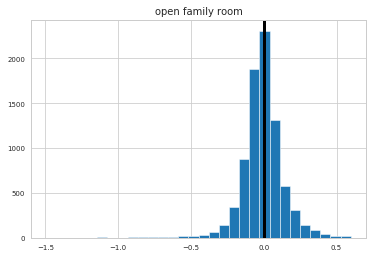

0.01099392948354103


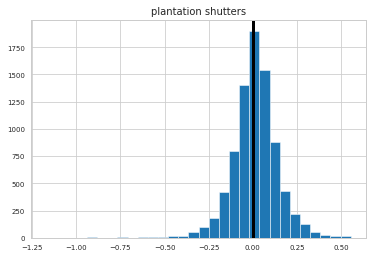

-0.0038969899894158435


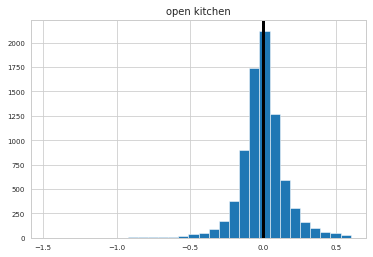

-0.017397618407819112


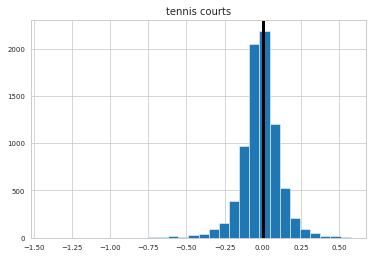

0.019797281379299377


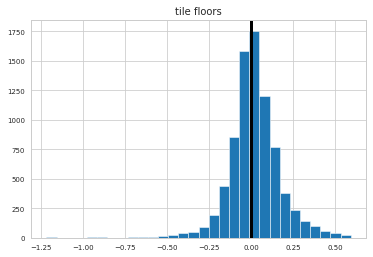

0.0013041803453473725


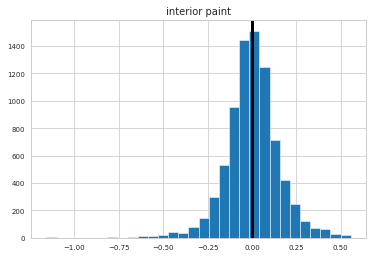

0.012569979983115747


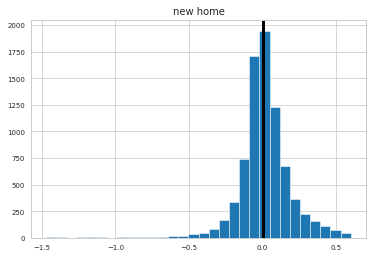

0.10278558717924147


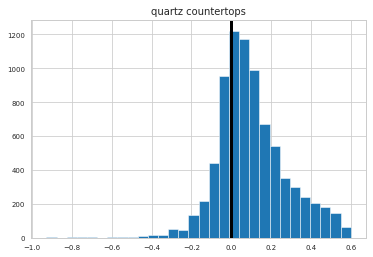

0.0022792348020465023


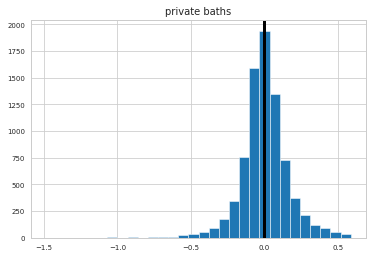

-0.0644330981023916


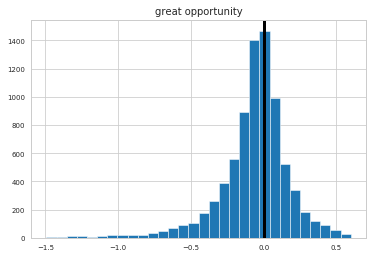

-0.003887972274060993


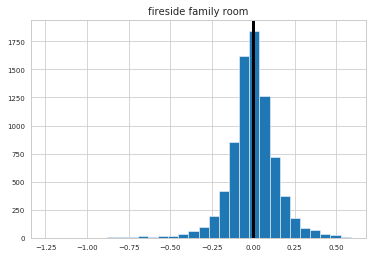

-0.000635317516305609


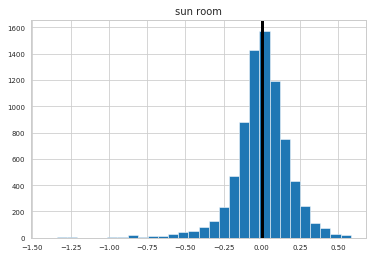

-0.018117690760984056


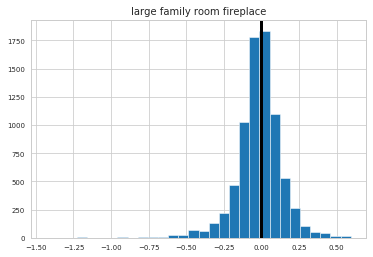

0.018055572306114036


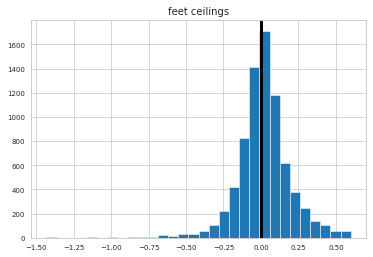

0.044004876820701026


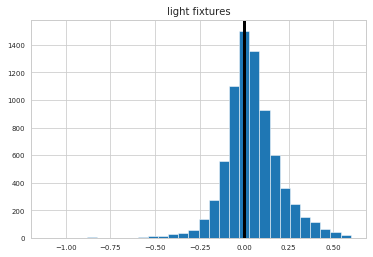

0.07606270219324797


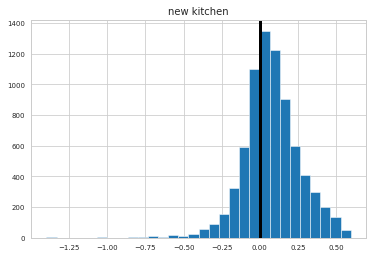

-0.00904751155615561


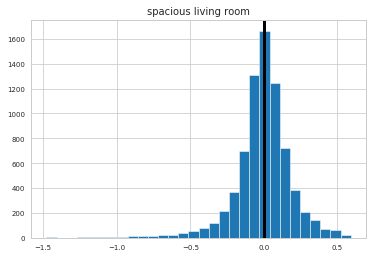

0.0004994970287895144


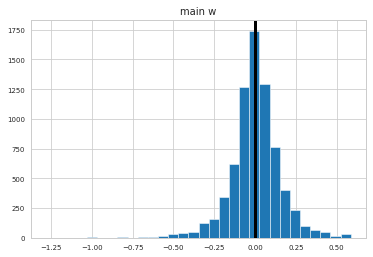

0.019913593811334812


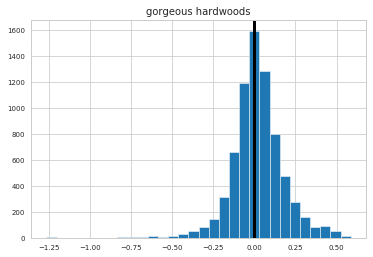

0.006272664112241381


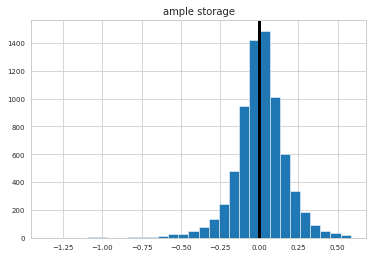

-0.02101716439726032


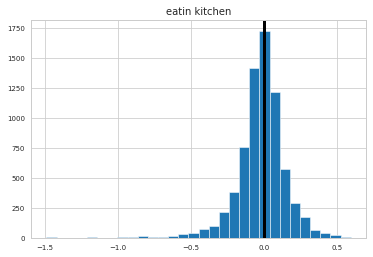

-0.013349252056240424


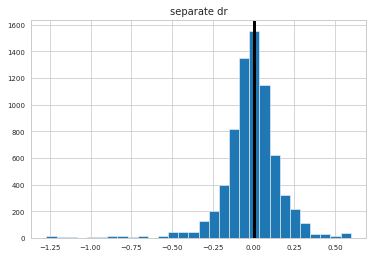

-0.004375304239392691


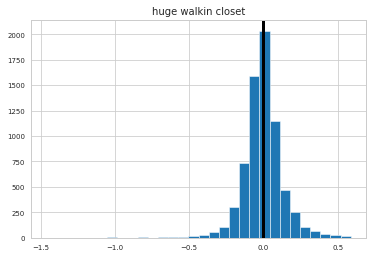

-0.0031364817449684346


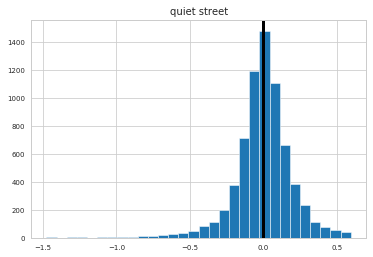

-0.007656300916699524


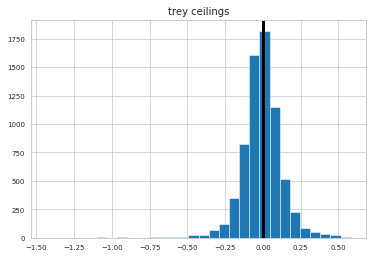

-0.016485839381740263


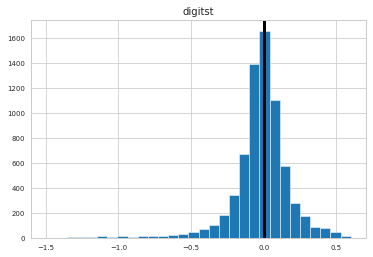

0.007701459068328422


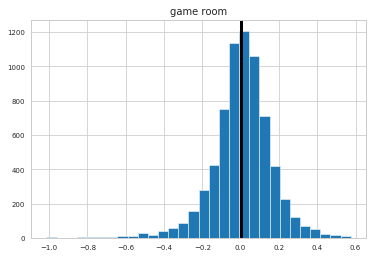

-0.022710376375548562


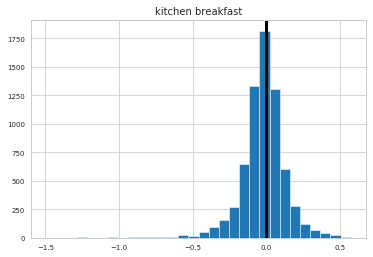

0.0499356410988307


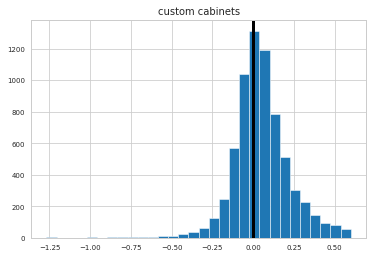

-0.01577549847692248


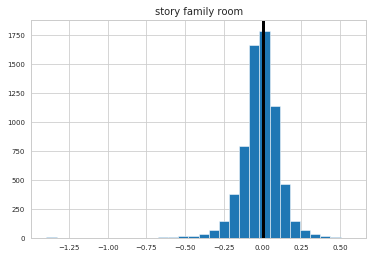

-6.971909756443719e-05


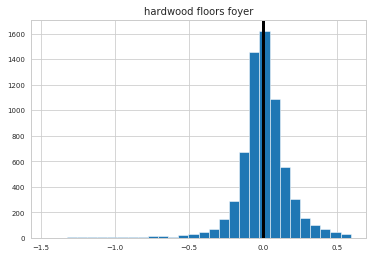

-0.009473969864922983


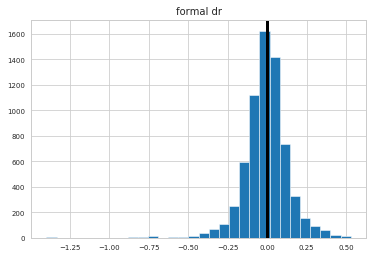

0.004755502795265892


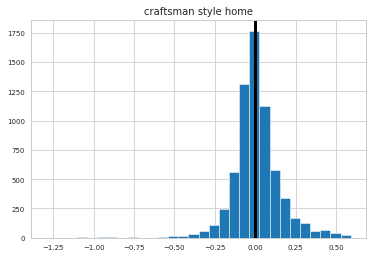

0.0036038680682066457


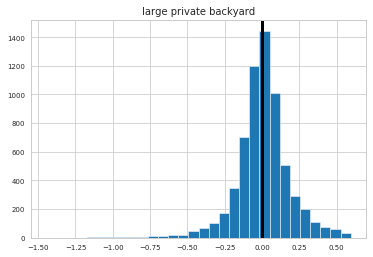

0.02291946744987232


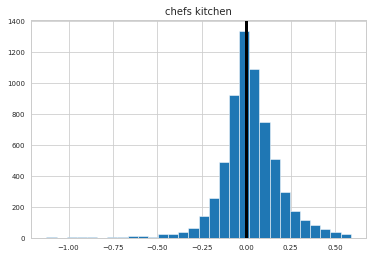

-0.10441177079257326


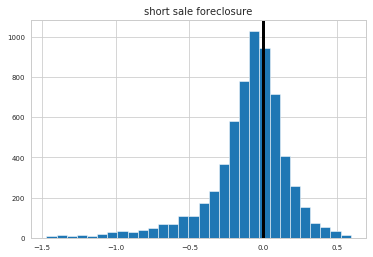

0.04593815074992217


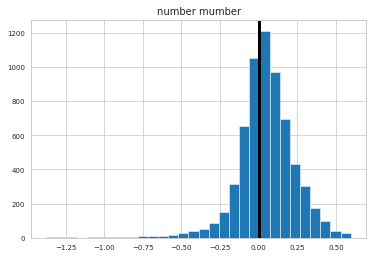

-0.009682649082406085


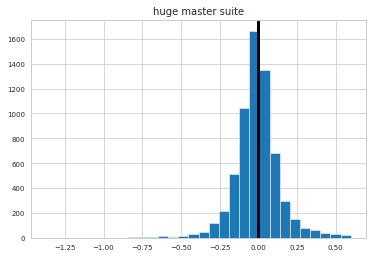

0.007222674173284453


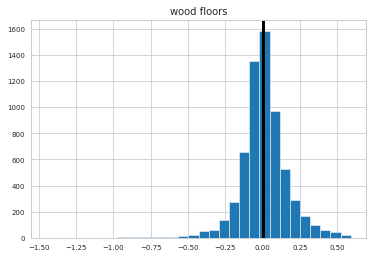

-0.020203567100007015


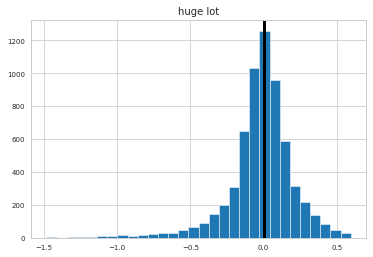

0.004282134424917558


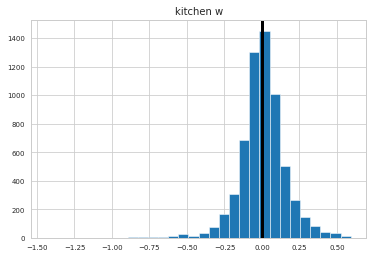

0.0024742416131317284


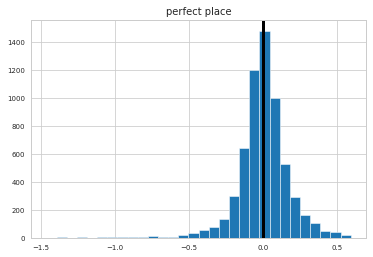

-0.014483475168239583


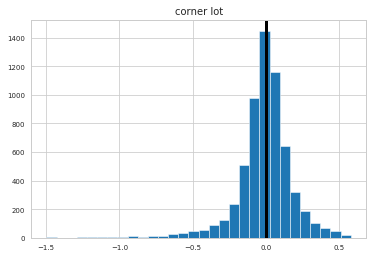

0.025529084960495656


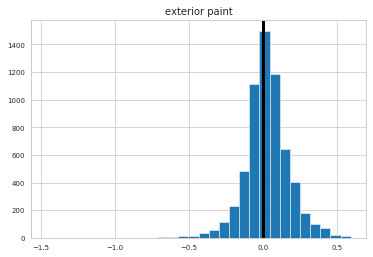

0.02140968971026908


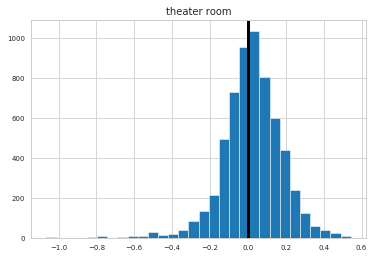

-0.018387296768792524


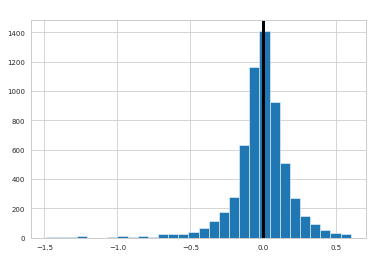

-0.0001691523600474168


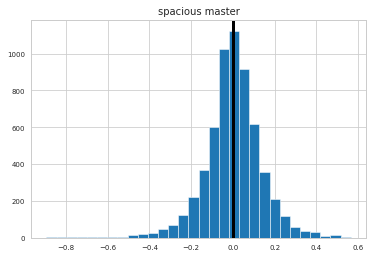

-0.0015605306088645645


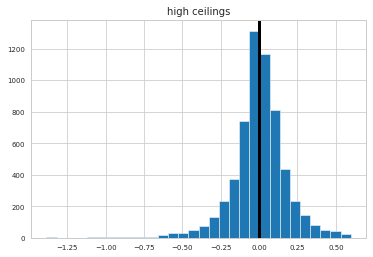

-0.003513305187003582


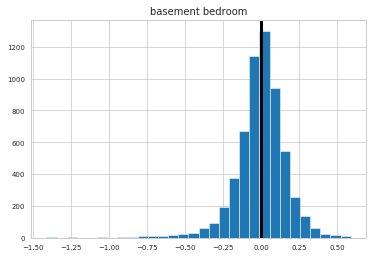

-0.006832660409529891


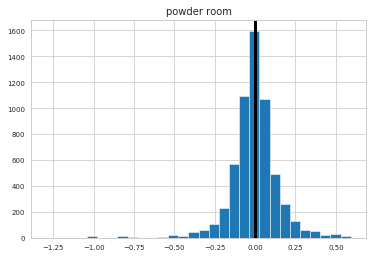

0.013021664725323855


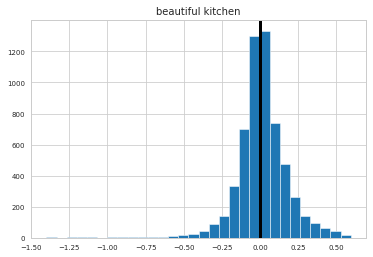

-0.0002730744888466521


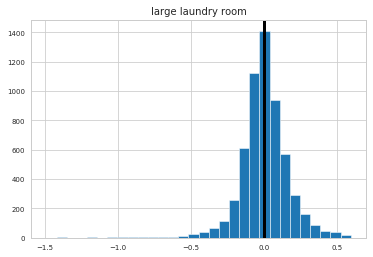

-0.017749125248512476


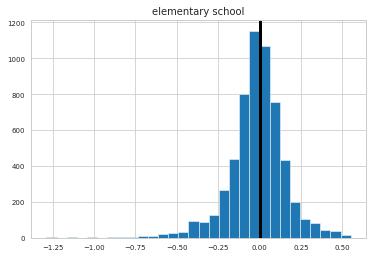

-0.018108326042509577


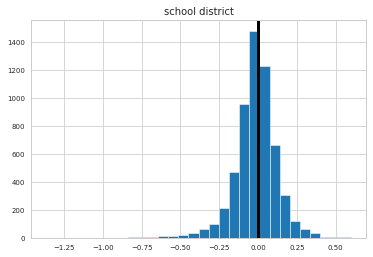

0.03059476846156505


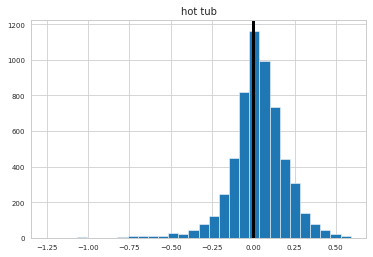

0.013912945345402888


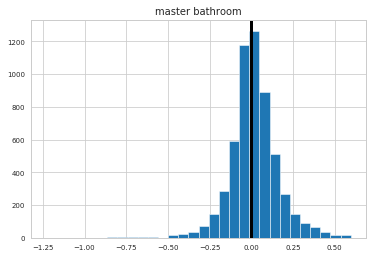

-0.016372147794002655


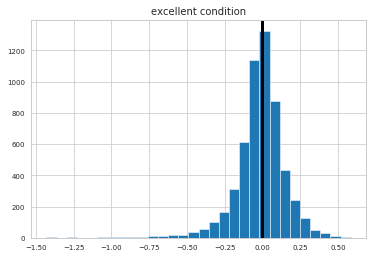

0.01006736720889559


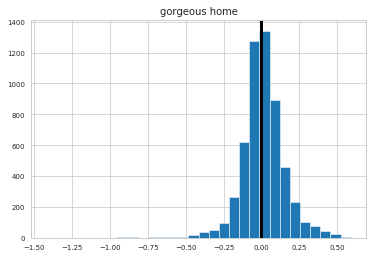

-0.006162896002981383


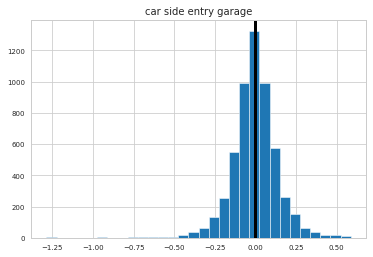

0.006128834692091255


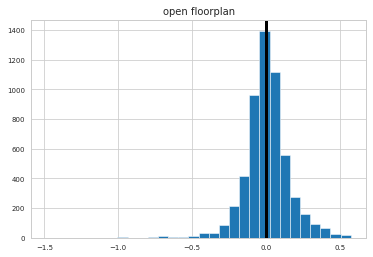

0.02660483951355795


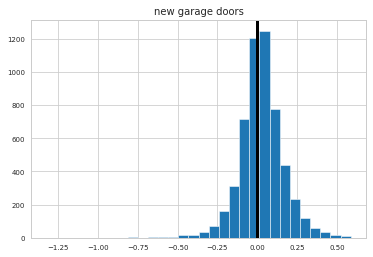

0.033222770210948195


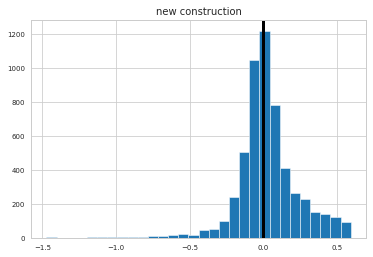

-0.03219826895326783


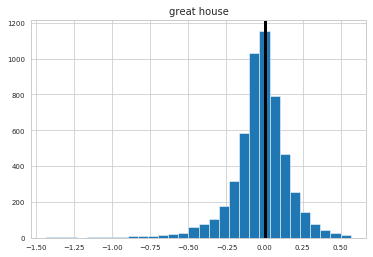

-0.0034369208639557455


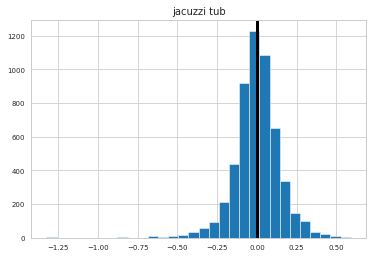

-0.026335244694202564


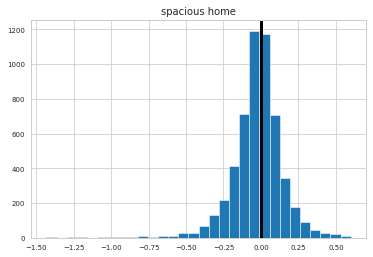

-0.0012719747895284994


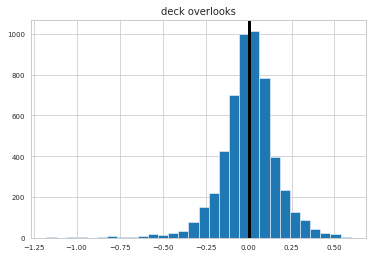

-0.0028246834581954587


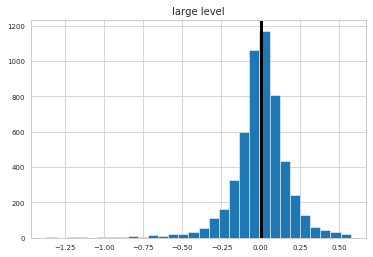

-0.01292109453994789


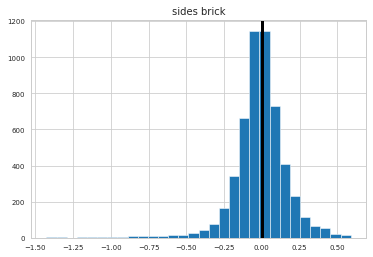

0.02325777354841625


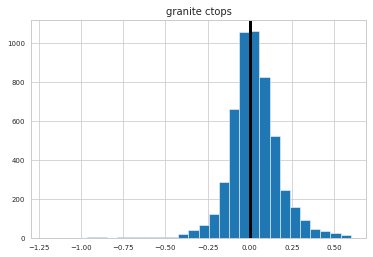

0.03251220842949713


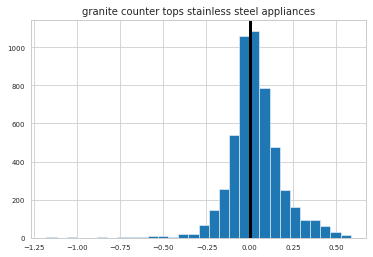

0.0609742980337382


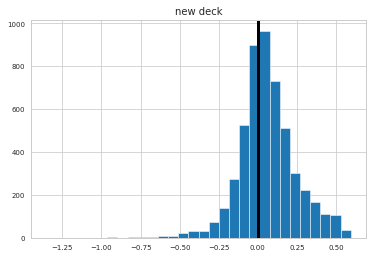

0.01816875870799067


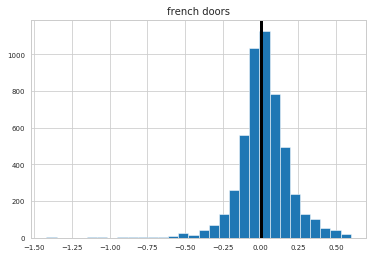

-0.00129559905255476


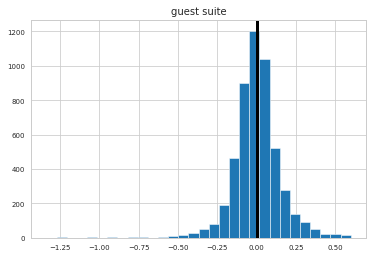

0.050639197563277255


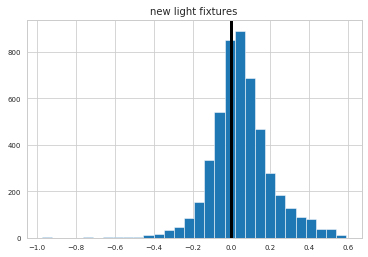

-0.012356179416316528


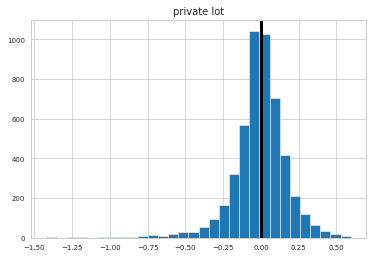

0.022326174628465534


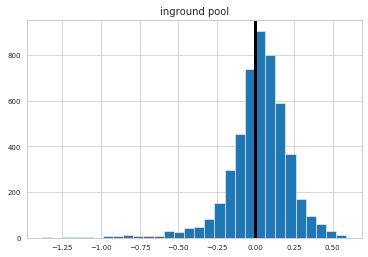

0.029624028212674673


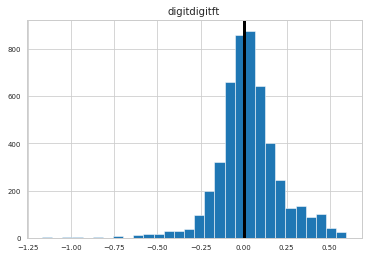

0.034927449720401585


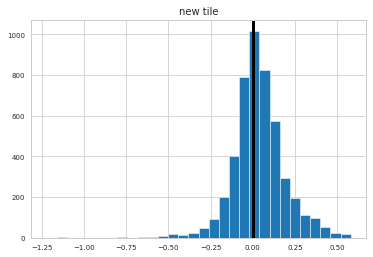

-0.0007496013405751535


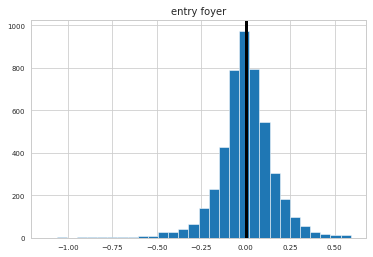

-0.01680530779303751


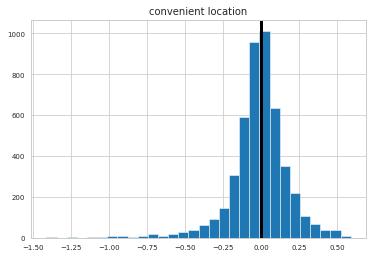

0.009250919724386061


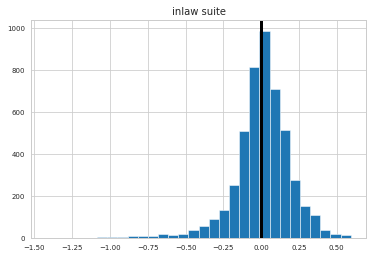

0.03586463555009353


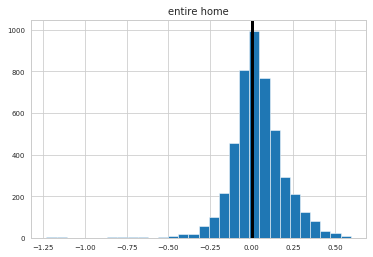

-0.015959327092353433


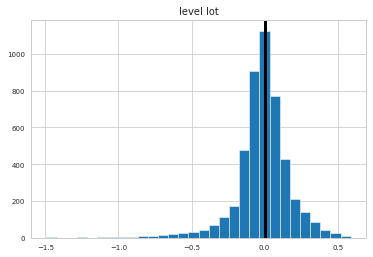

0.005030855061935133


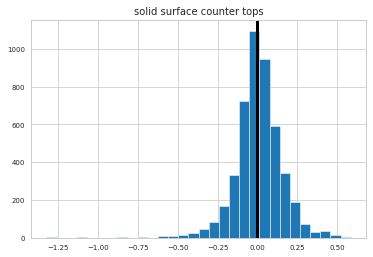

0.005873287750207765


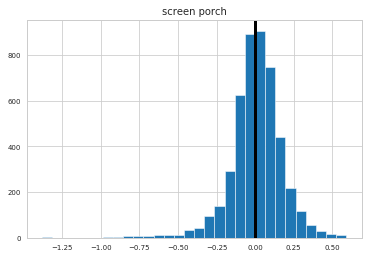

-0.011147905326436867


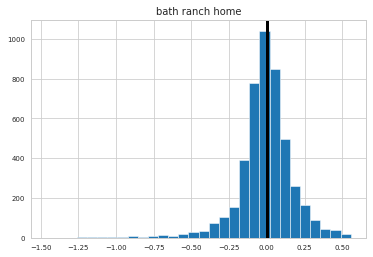

-0.013732027327090989


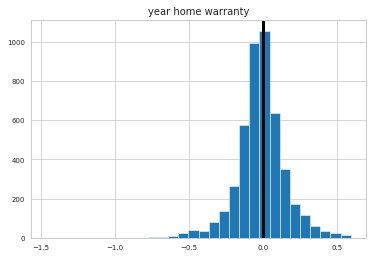

-0.0020991815529747696


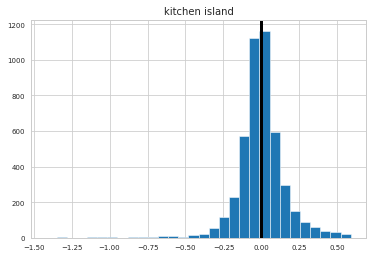

-0.010905872456680881


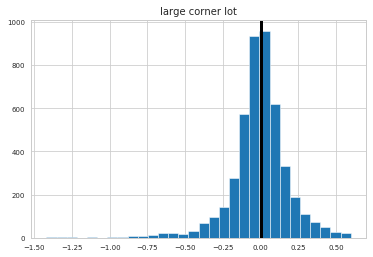

0.001133594801321929


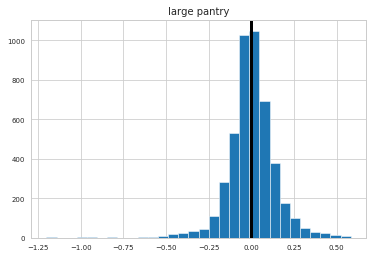

-0.051327568407063


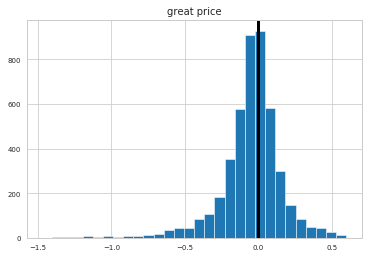

0.005176340071520902


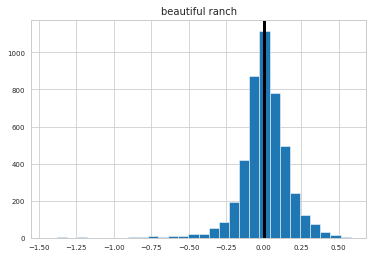

0.00025557405734049997


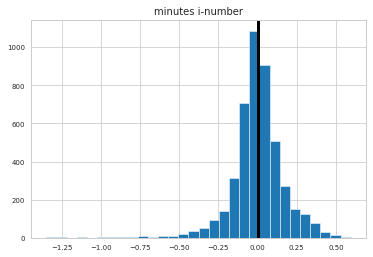

0.0060018146108119725


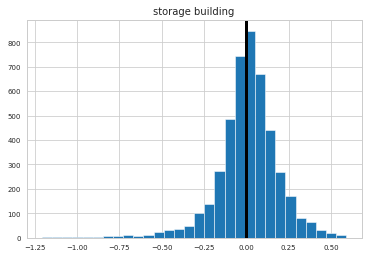

0.007386924658923541


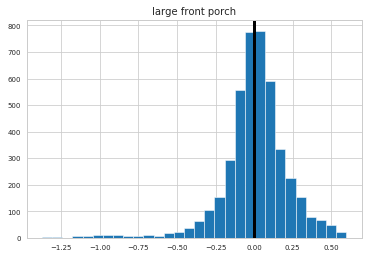

0.0016542511333703467


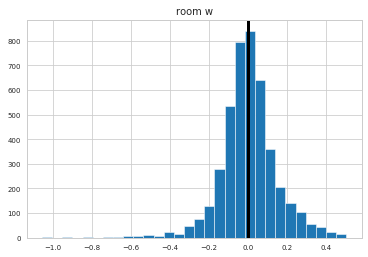

-0.052510500115957835


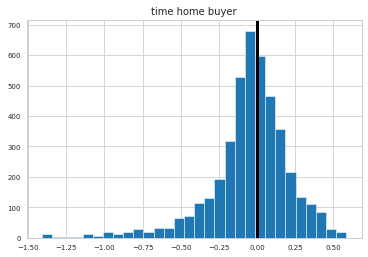

0.002736213168753439


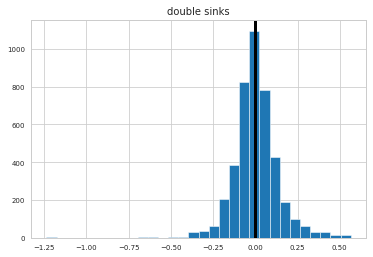

0.03179955344396205


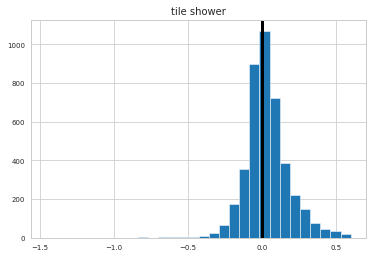

-0.048750458089188306


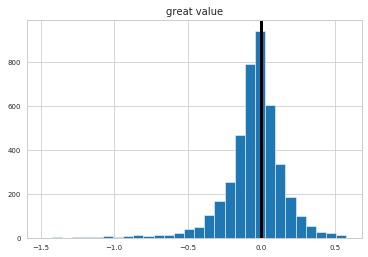

-0.00833148467311461


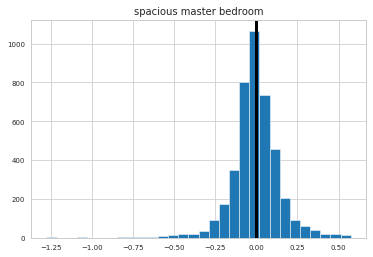

-0.003147445848525578


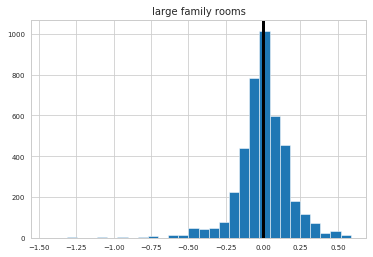

-0.002273365408940153


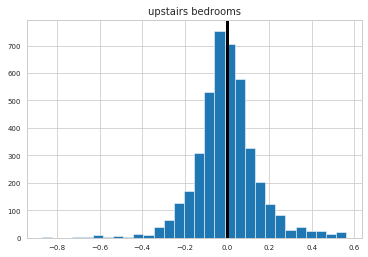

0.017564643206713516


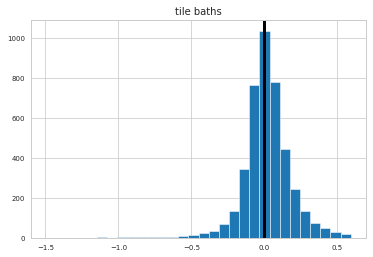

-0.021163380646544837


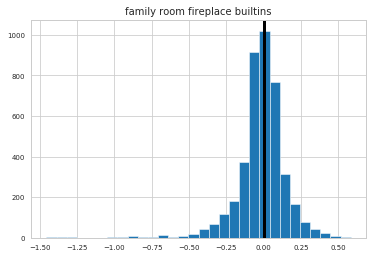

0.022208946144382173


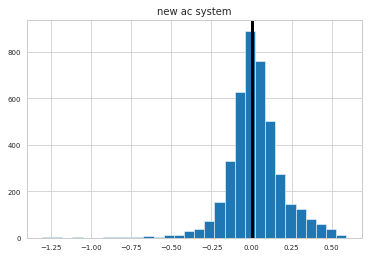

-0.014138658468986782


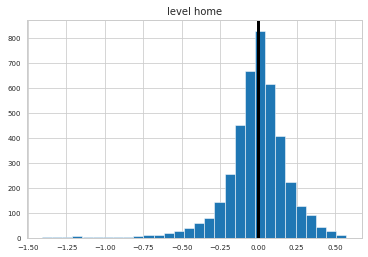

0.007013858092968761


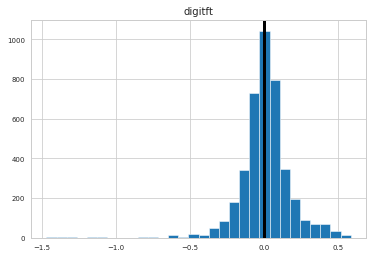

0.050630425889703685


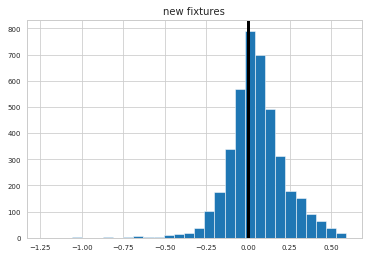

0.0119312679961738


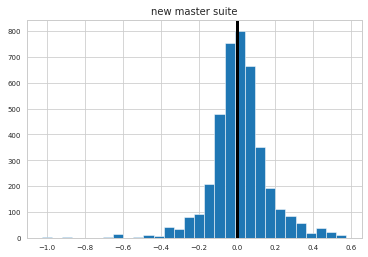

0.0041219844081529875


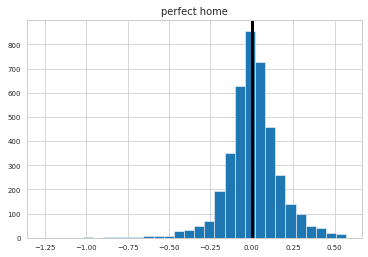

0.004321088030211905


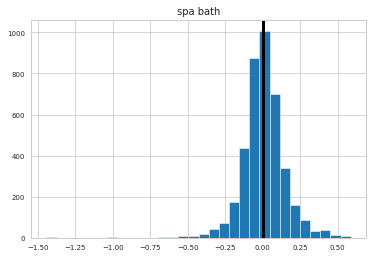

0.013273590510935952


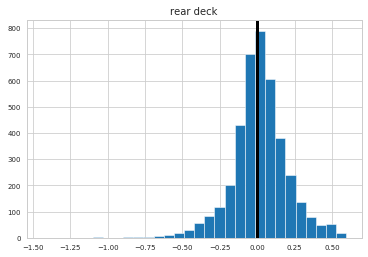

0.0051522797257732905


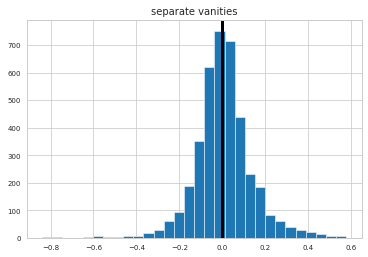

-0.016652519350722268


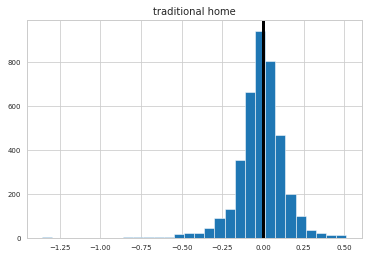

0.04162384612202084


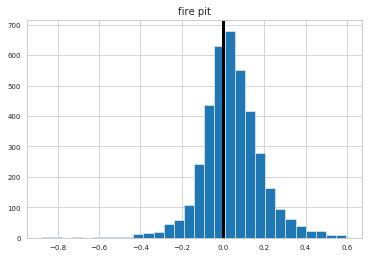

0.01579120928346916


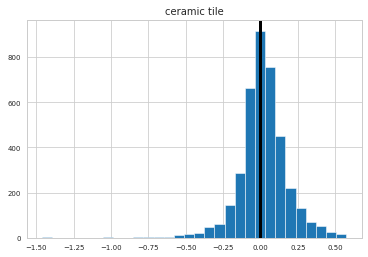

-0.000632990024664455


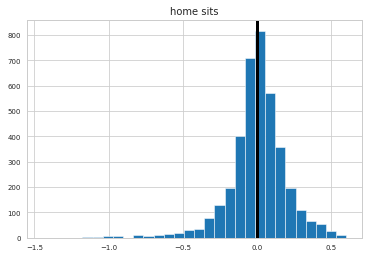

-0.019441460929726446


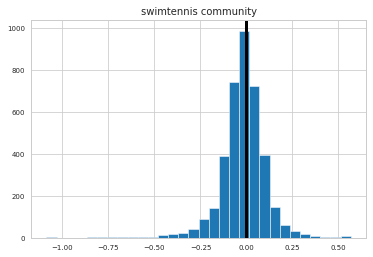

0.008048435658306647


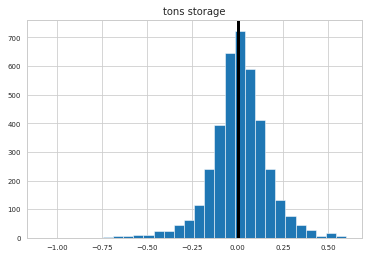

0.02015180374019951


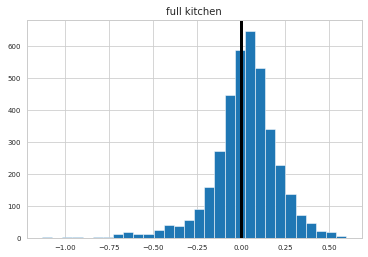

-0.012045555500530684


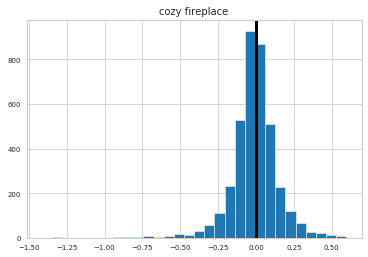

-0.011061299774806058


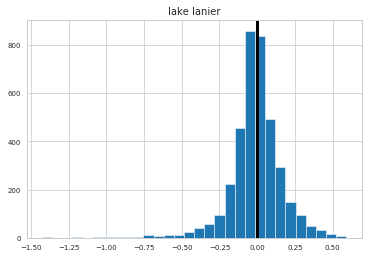

0.018107161015249895


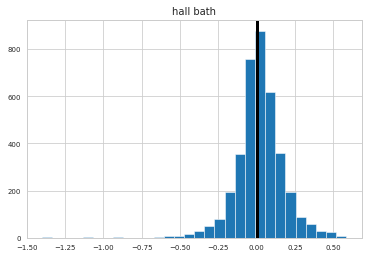

-0.014765123560256645


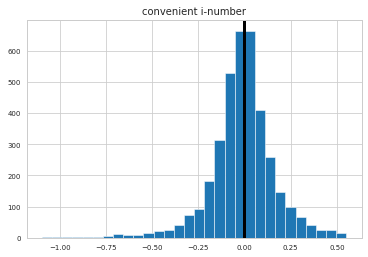

0.0029790130769045994


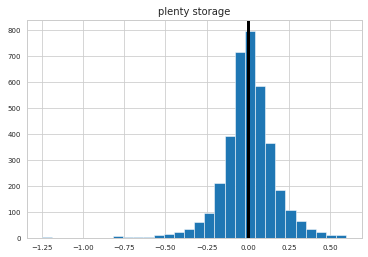

0.006467117327253885


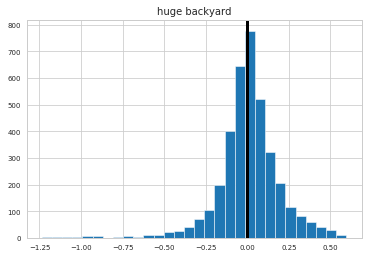

-0.006922135374573635


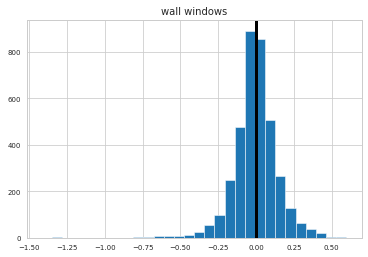

0.01667910468721051


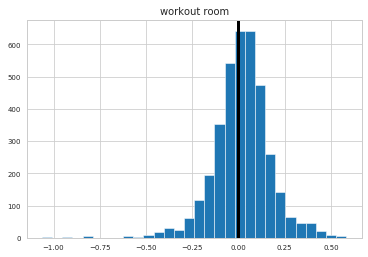

-0.008437936423010052


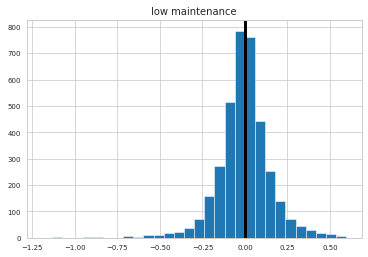

-0.036558986166189404


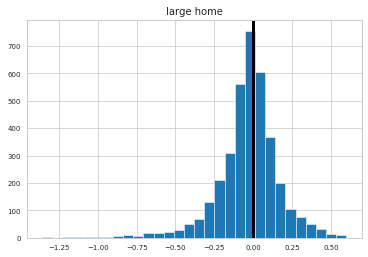

-0.028802311710065677


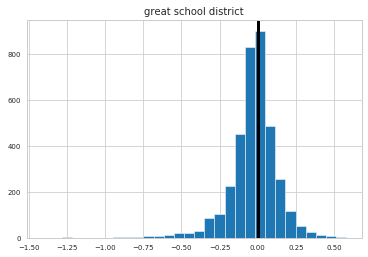

0.010257896113858165


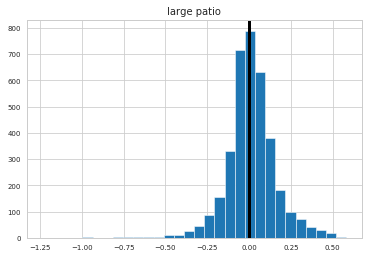

0.018052675129209585


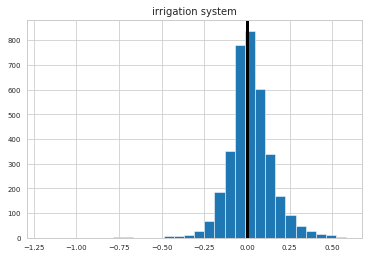

0.0013501842733295519


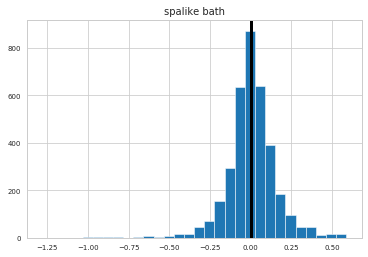

0.014844111552018811


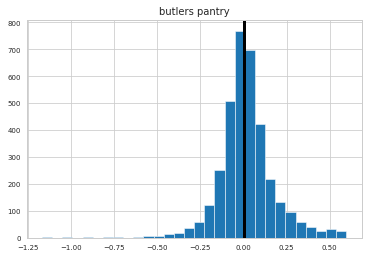

-0.013784121053624256


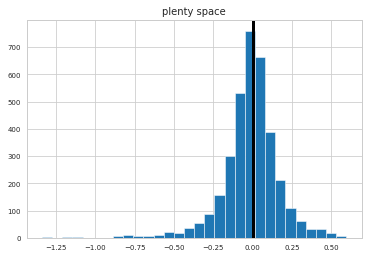

-0.00020466255524729008


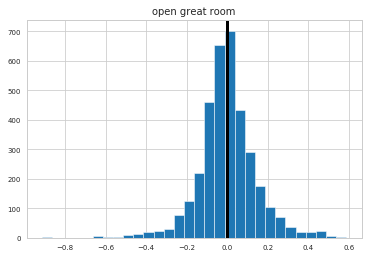

-0.015354293553687042


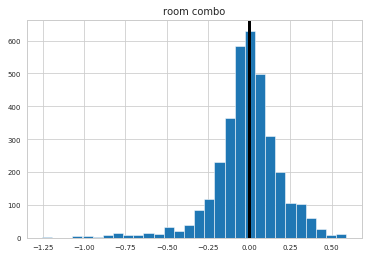

-0.0037915320011693504


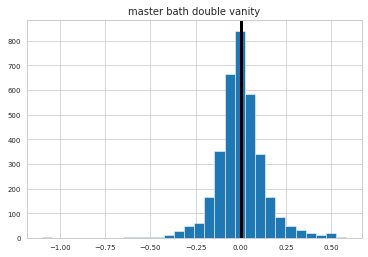

-0.015613004809123476


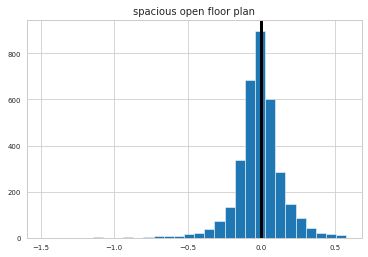

-0.004539541781089534


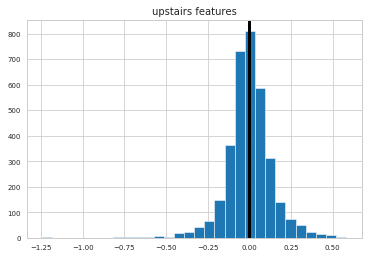

0.007492224100960831


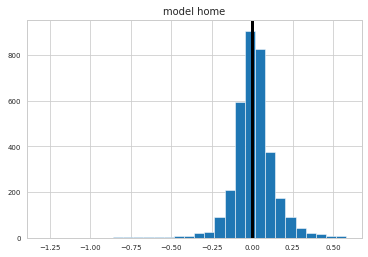

-0.011954852564370505


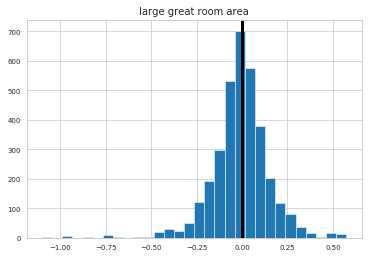

-0.0024842999961797066


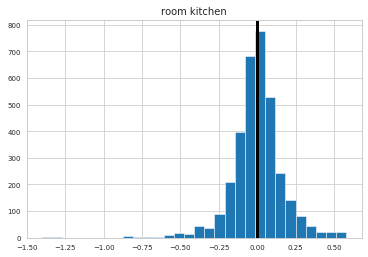

-0.022019085154365414


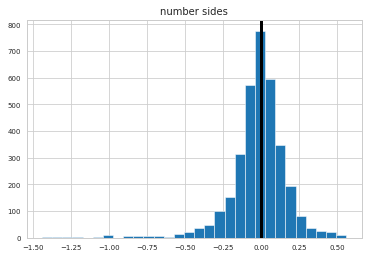

0.00567555654240713


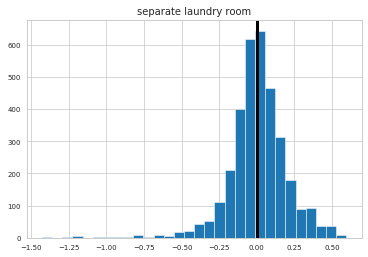

0.014590023976116466


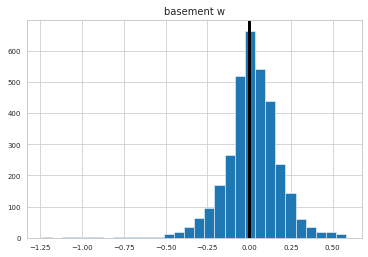

0.009934526136798507


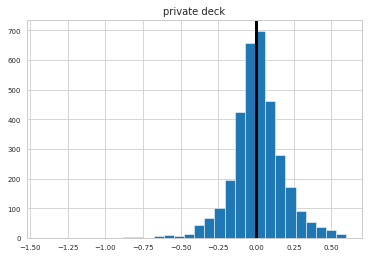

-0.008755919890840997


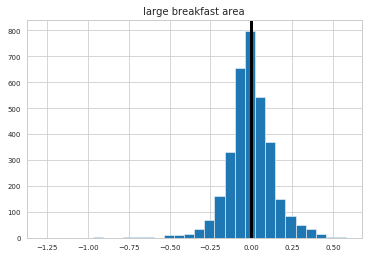

-0.006088255130506134


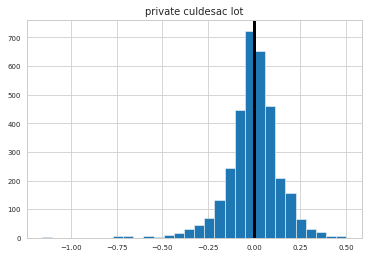

-0.018889850381166057


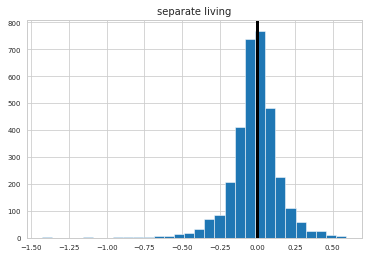

-0.010230734544245878


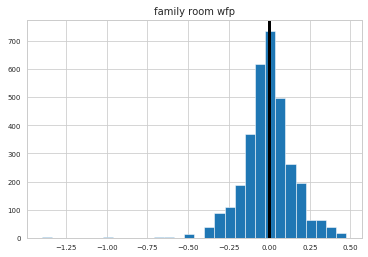

-0.003346762358264476


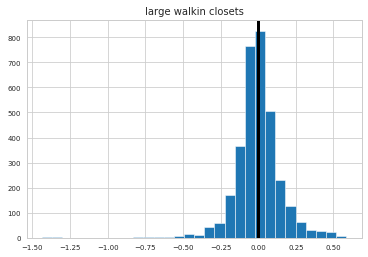

-0.015075906966844858


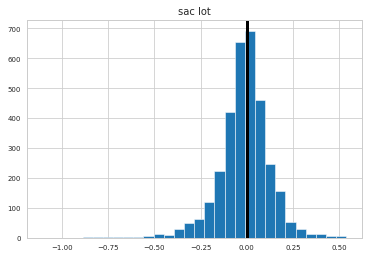

-3.8858291750980816e-05


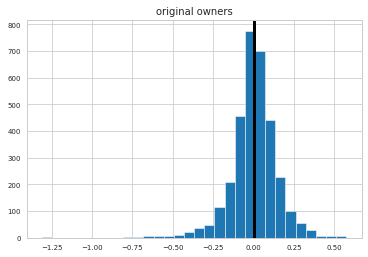

-0.003807166835162212


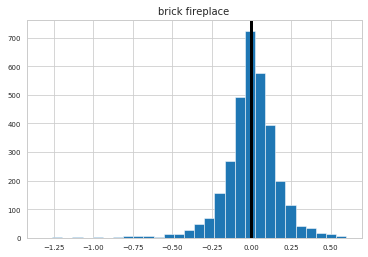

0.05779013550138


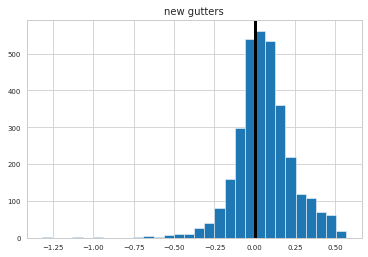

0.0018789561136672572


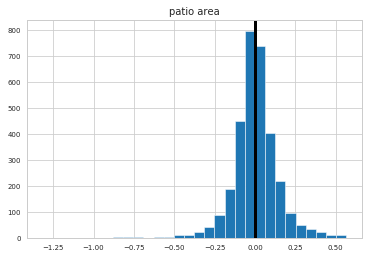

-0.013891715962750077


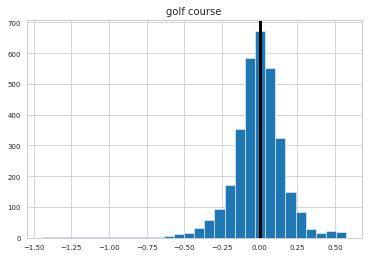

0.00876357437051002


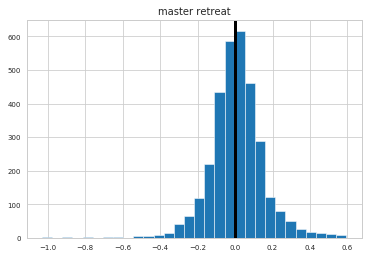

0.003590375947464026


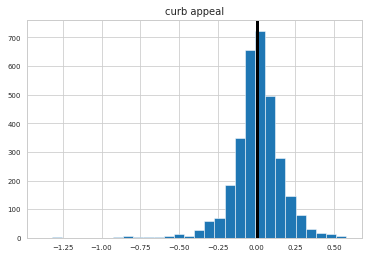

-0.01731910759431241


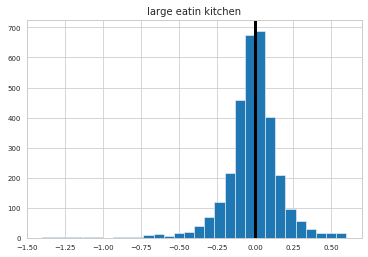

-0.009751807914319264


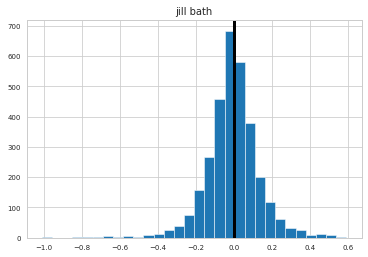

-0.017811445613849838


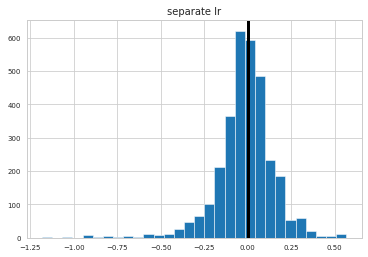

0.002062628416538328


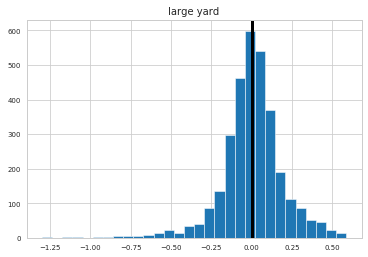

-0.018828916657025706


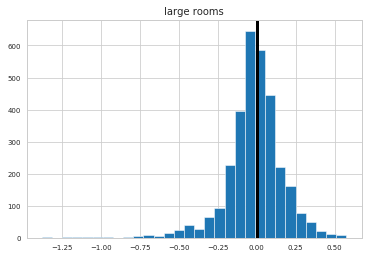

-0.005273170384888769


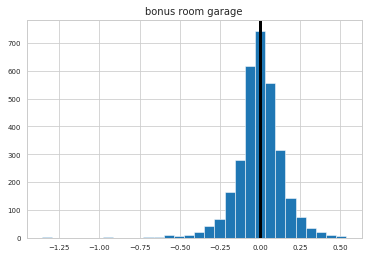

0.00406231208836166


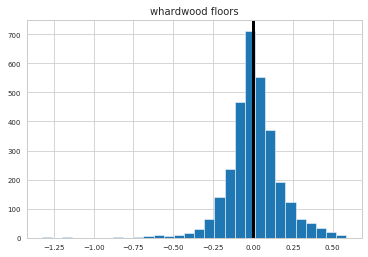

0.0007687989875174075


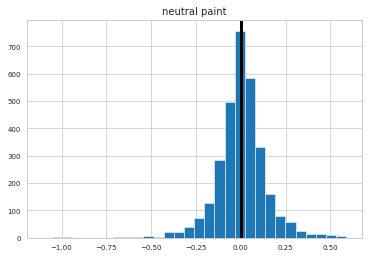

-0.010105244665570607


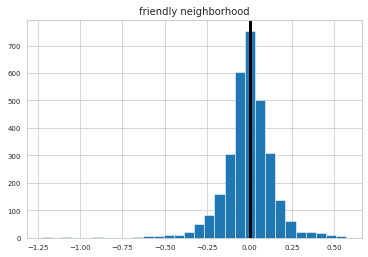

0.026169072002344515


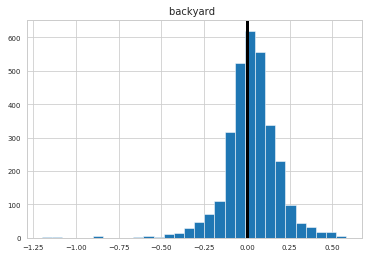

0.0021501801802713827


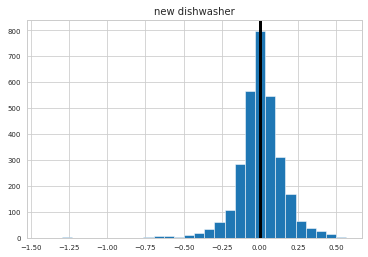

-0.018865609470642045


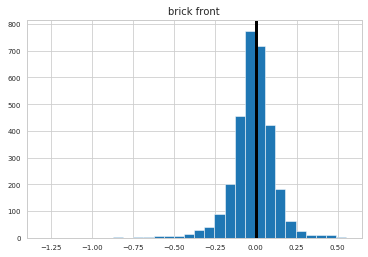

-0.006656458021087884


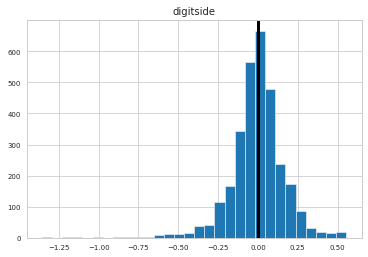

-0.017388917235571427


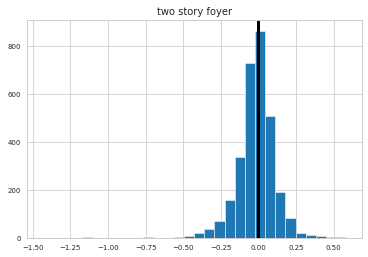

0.008068434955398406


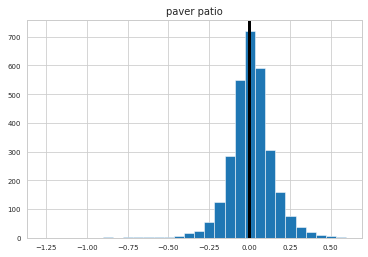

-0.019642251394200033


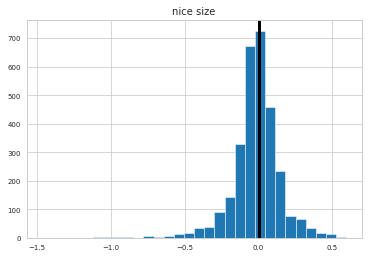

0.014159665742725584


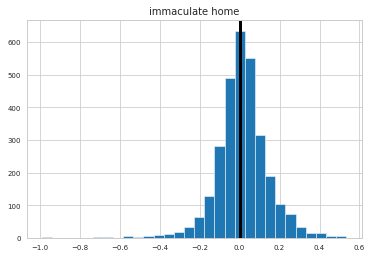

-0.023431142276965067


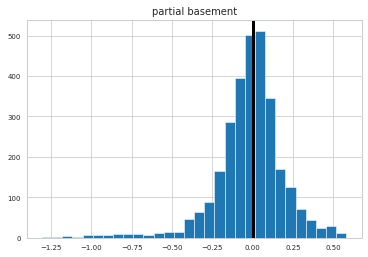

0.005250684851988965


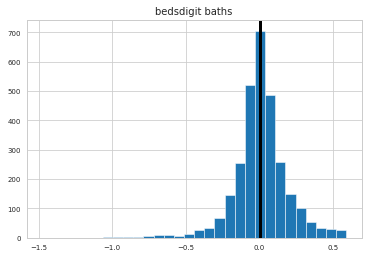

0.04978862746282836


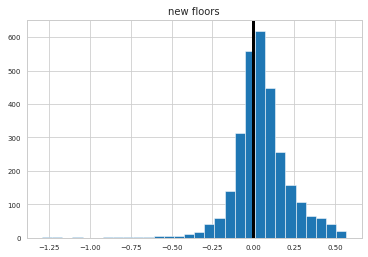

0.00010391604159107042


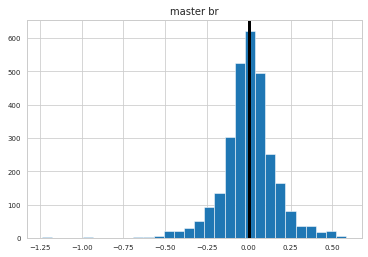

-0.015748300209865784


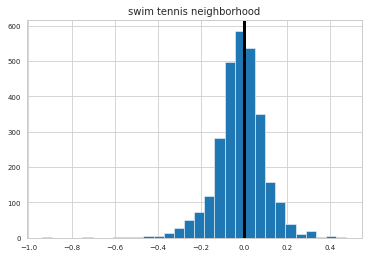

0.00041899745567561974


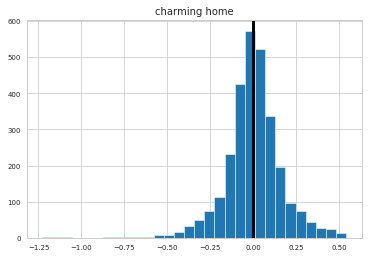

0.01087480854276752


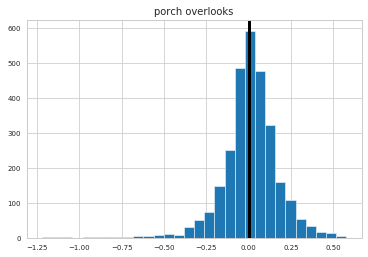

-0.014098782638118099


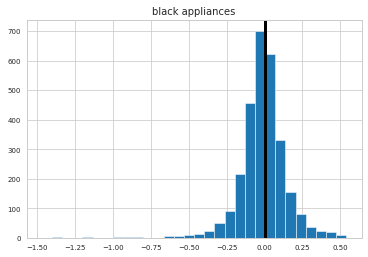

0.024497606725648553


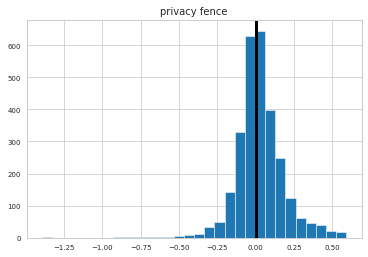

0.010693793965324673


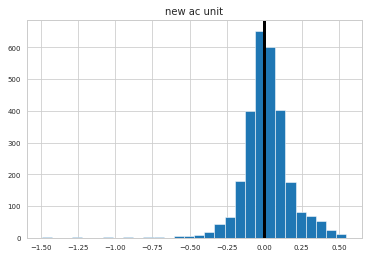

0.012678942972333367


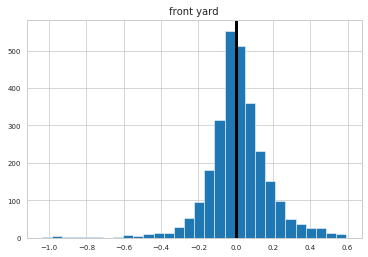

0.03500341588996124


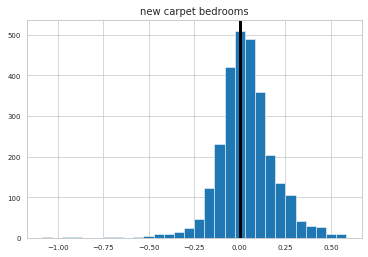

0.0195362599016822


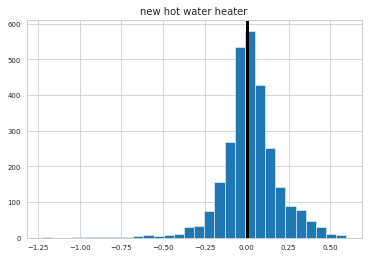

0.027702600010716217


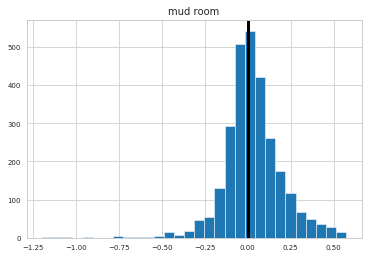

-0.003063904893376317


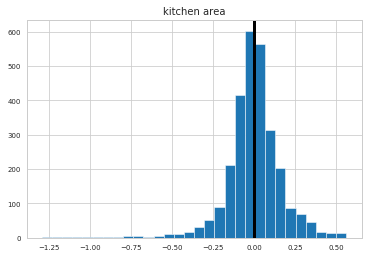

-0.006267525246056963


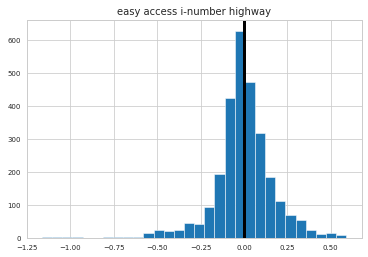

0.04247704660971049


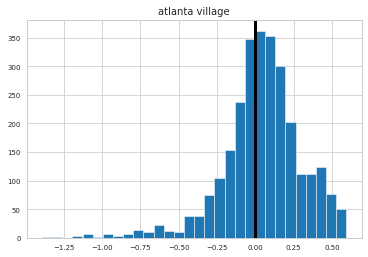

0.011012398805599889


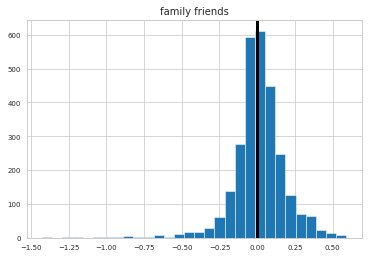

0.027105124814939863


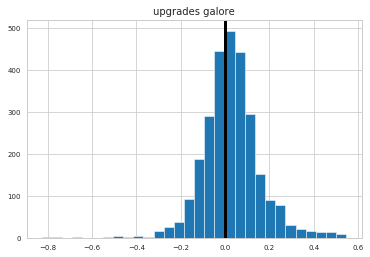

-0.0008455493650400159


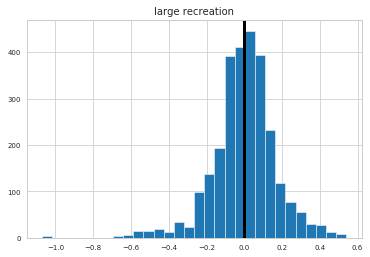

-0.014846909250881793


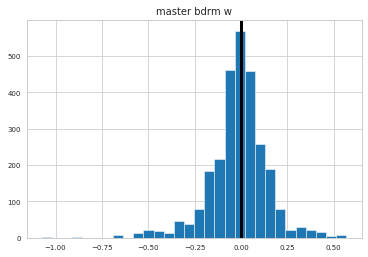

-0.025505460931542878


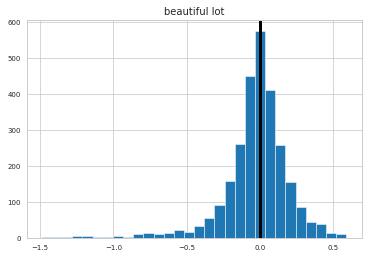

0.002098850019346246


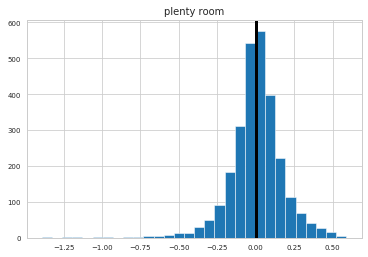

-0.0008617527788854086


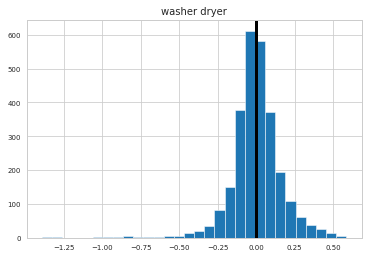

-0.02087897156574319


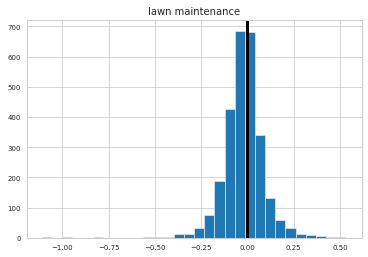

-0.0024003566558799217


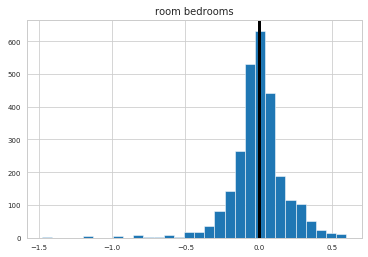

-0.009197520474794546


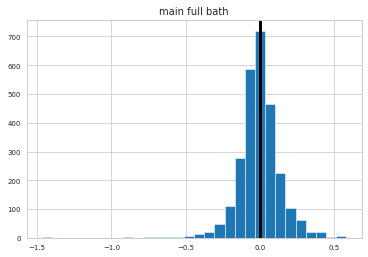

0.0036511404432632436


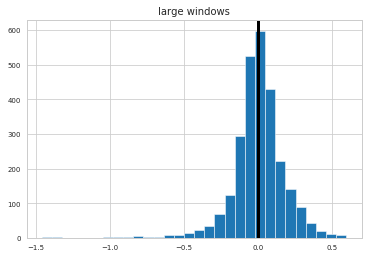

0.01764170949502685


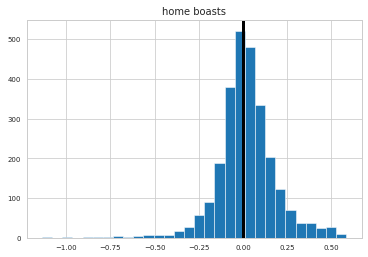

0.01218029617459741


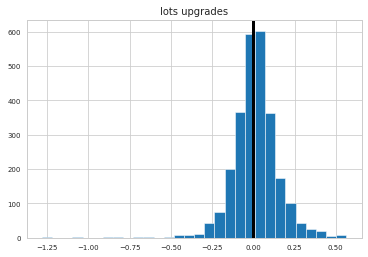

-0.0286350630258737


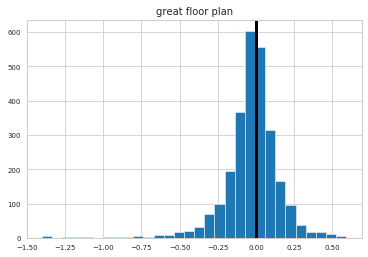

-0.017780738131617894


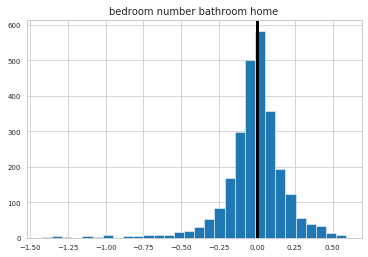

-0.009185954044203637


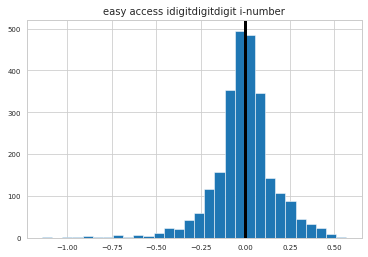

-0.0031144238902607044


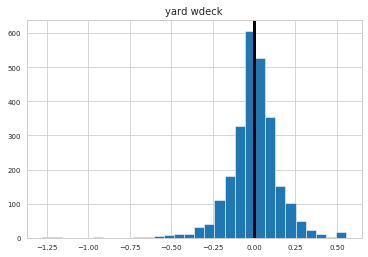

0.028507111111400567


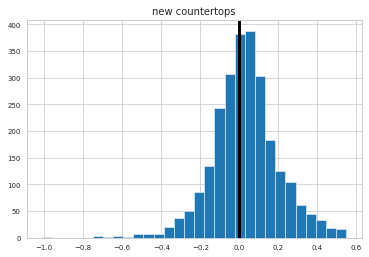

0.01504335407461416


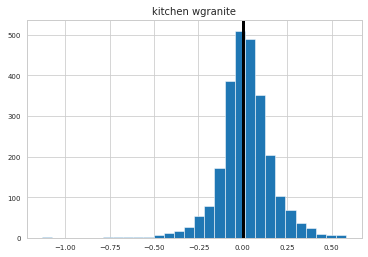

0.0016956051379011826


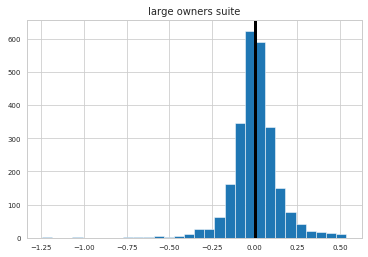

-0.001518061723415484


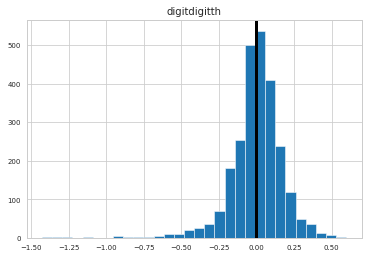

-0.0031838211201849153


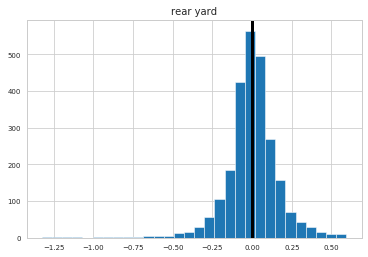

-0.018895612321299448


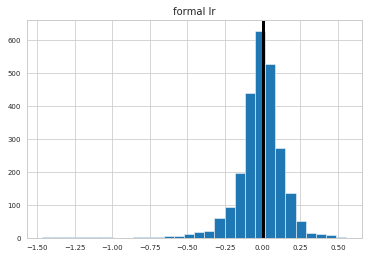

0.009436141622759799


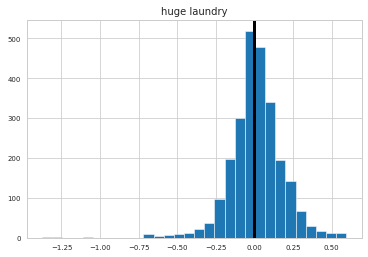

0.012915183755309197


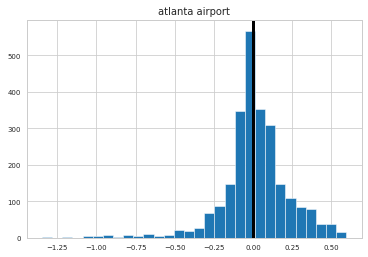

0.00962585429239921


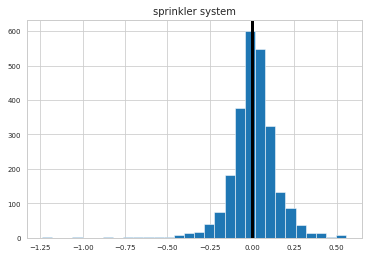

-0.007926431695898573


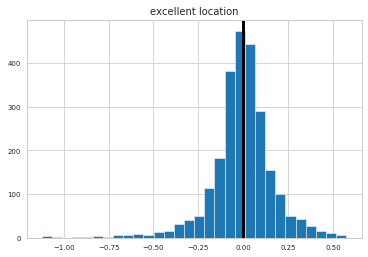

0.002184606903850149


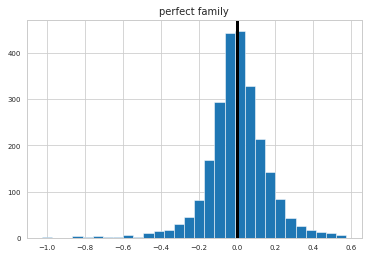

0.07535664570161865


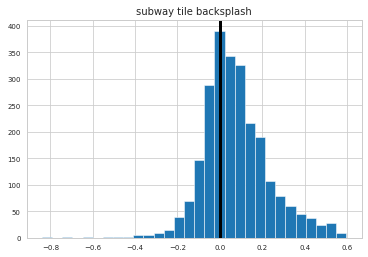

-0.022974568008229442


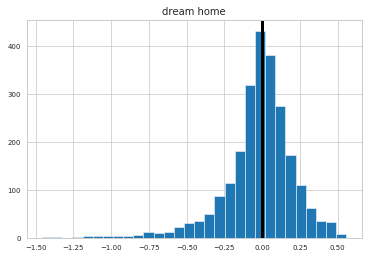

-0.03563282348047847


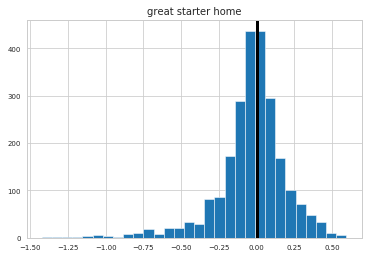

-0.009708843773180114


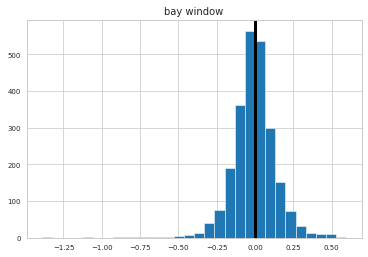

-0.0027062781889062174


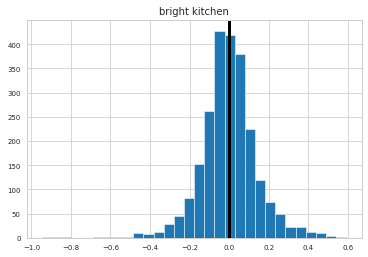

0.003990914637799741


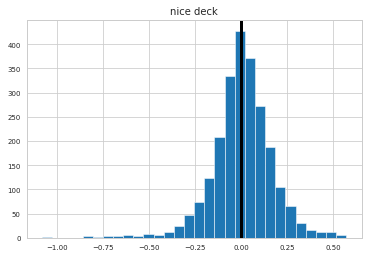

-0.003089099021909178


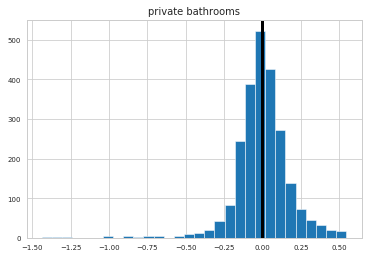

0.005905469036811639


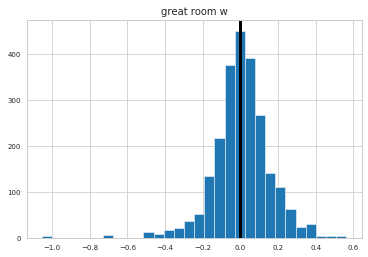

-0.0033213923020759695


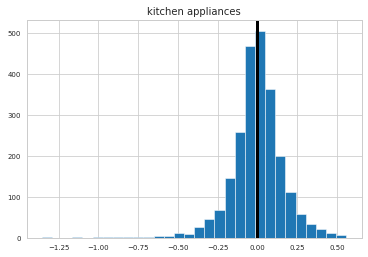

0.013686696269399699


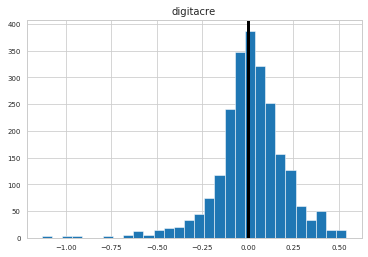

0.013689139896635822


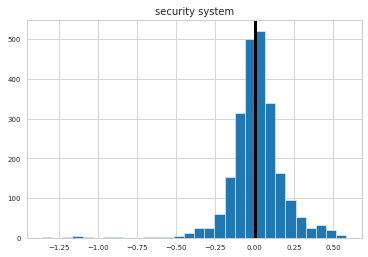

-0.010136662506137335


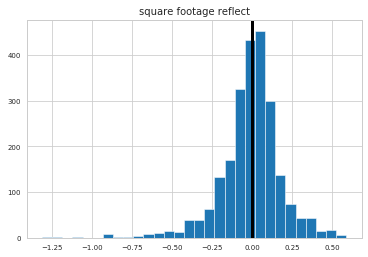

-0.0025196057838163736


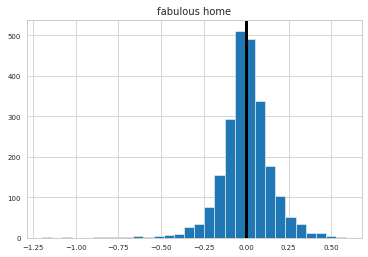

-0.021122476949407318


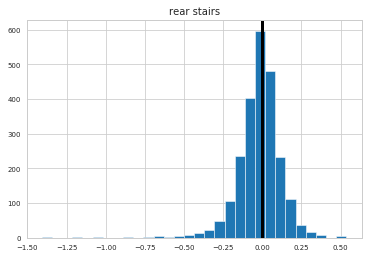

-0.005952581899910023


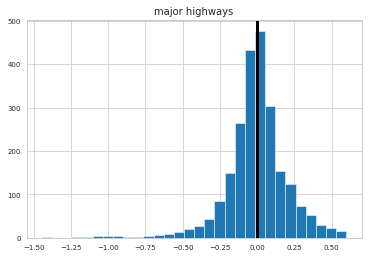

-0.00837323969916272


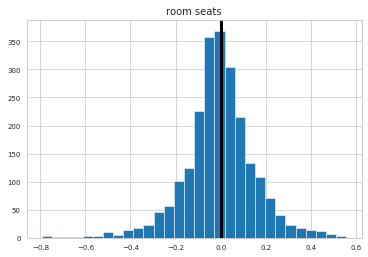

-0.010141989920555788


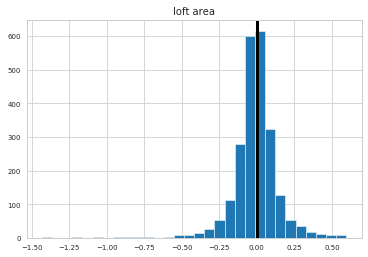

-0.009385211429989429


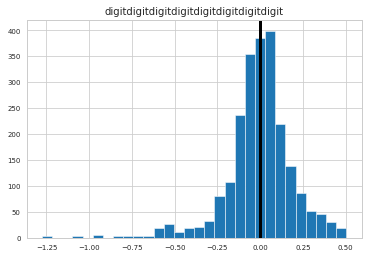

-0.01882944843242796


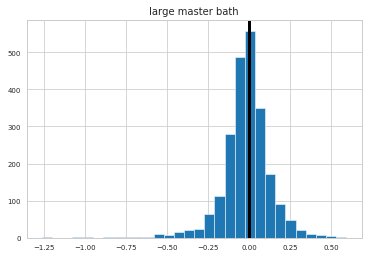

0.03436877049186586


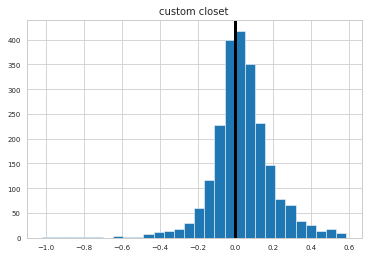

0.009761296875573958


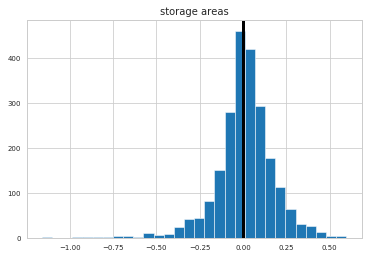

-0.017689177909928817


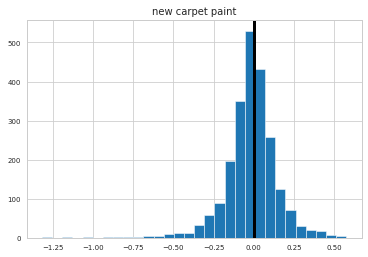

-0.004423749465645784


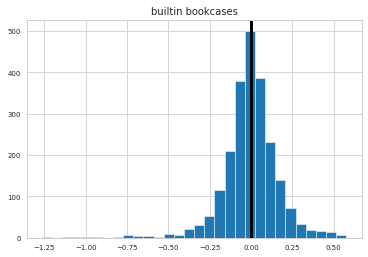

-0.010682830825827622


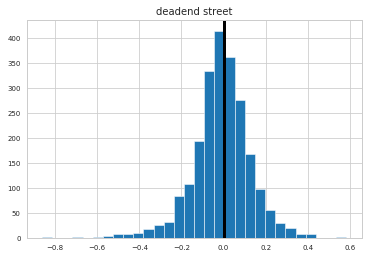

0.0025809046569676727


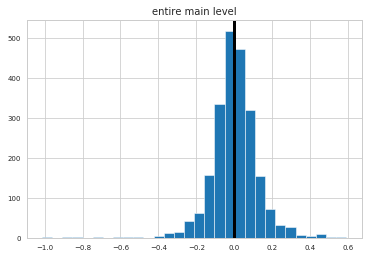

-0.02164122620274963


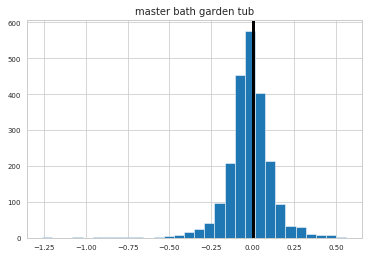

-0.002665143716210809


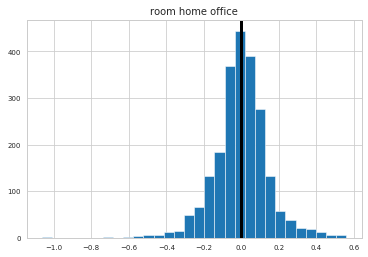

-0.0039165507638646


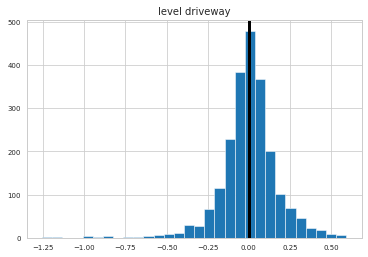

0.033881278614484096


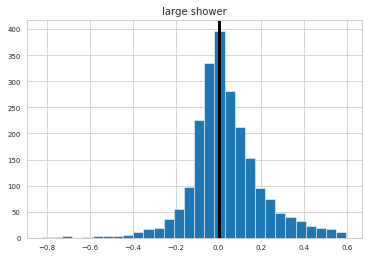

0.020030623425742872


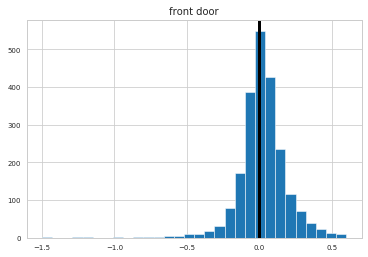

0.0016990370027048418


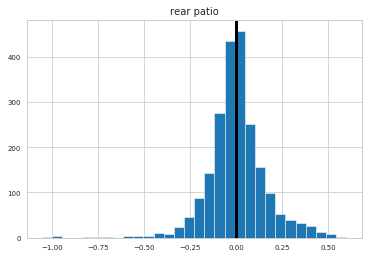

-0.0012525275034025627


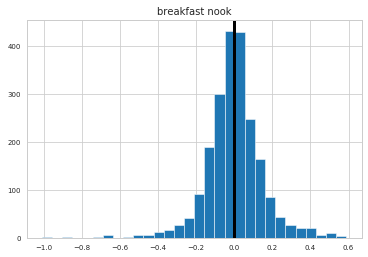

-0.01931006868338508


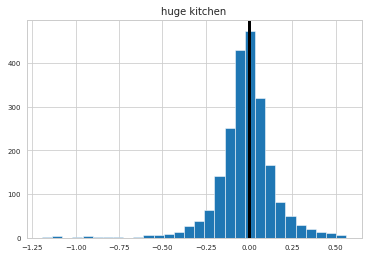

0.030376047816761405


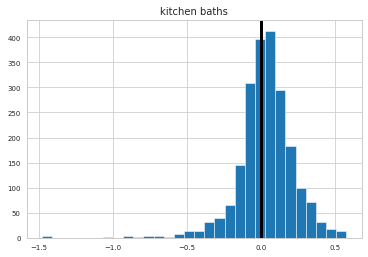

0.03924551805644142


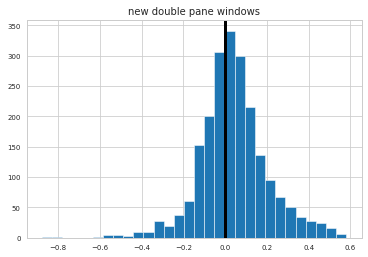

-0.01007021250441299


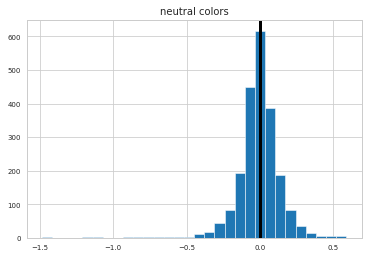

-0.014720279623965002


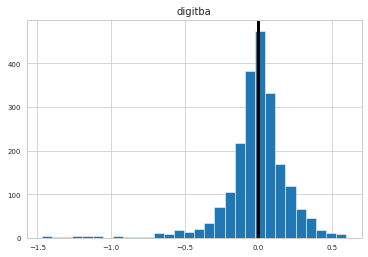

0.015257021804587925


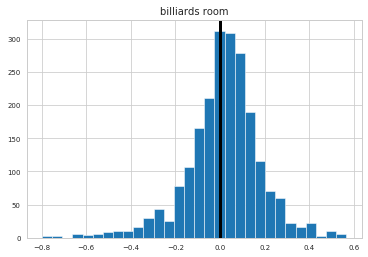

0.006959770056796612


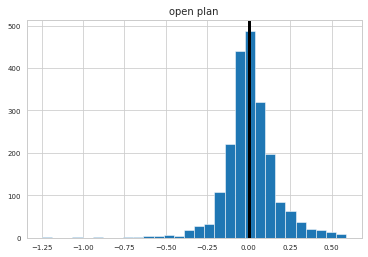

0.003934505456448547


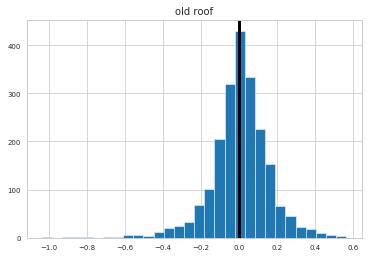

-0.015177488020531458


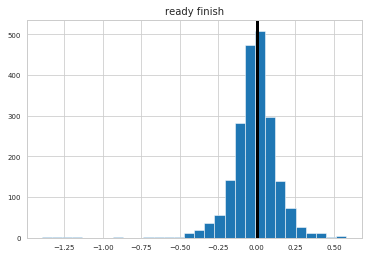

0.0201771457409213


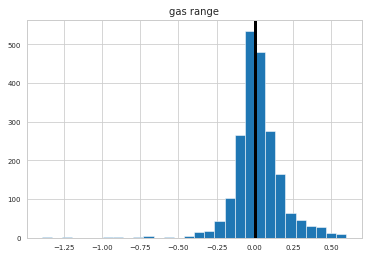

-0.017744930692287324


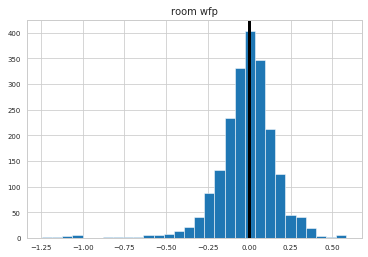

-0.008215177835173075


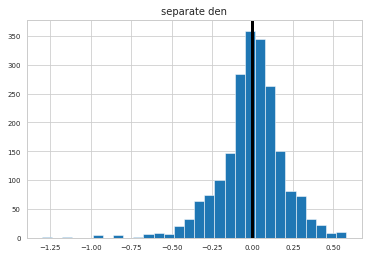

-0.003506551090527295


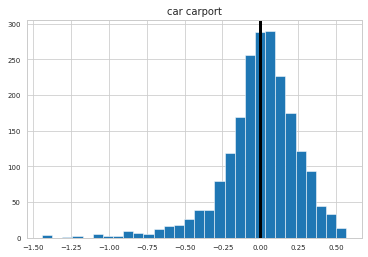

0.019307946718364534


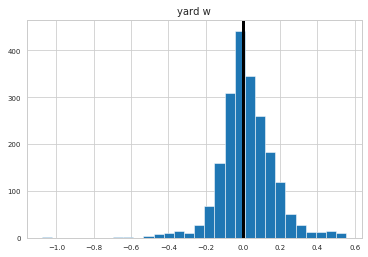

-0.005735425323332231


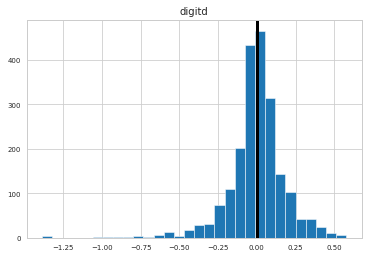

-0.015505644680994224


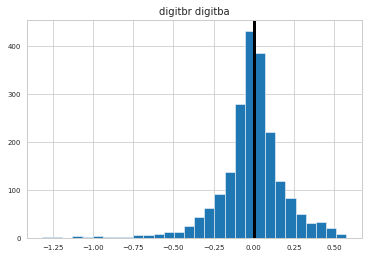

0.019369436155250705


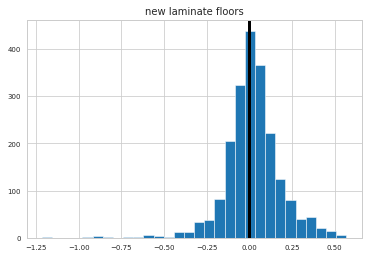

0.01935547189924762


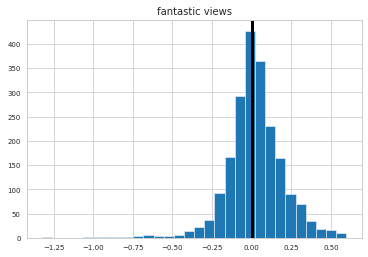

-0.005144831859347828


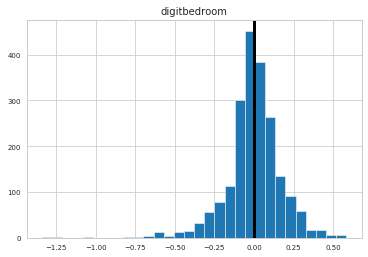

-0.0053837975270152934


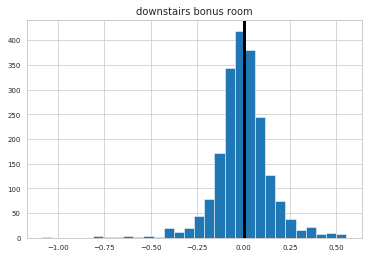

0.005916830606667041


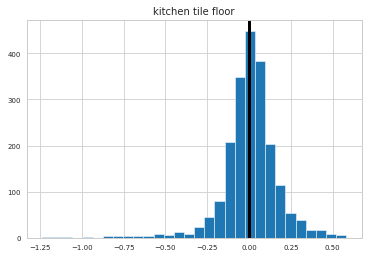

-0.01904639184681904


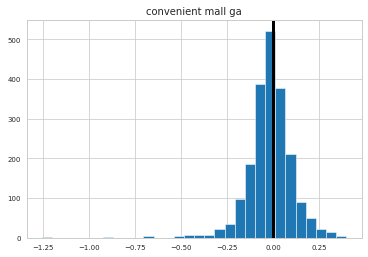

-0.00973923314382645


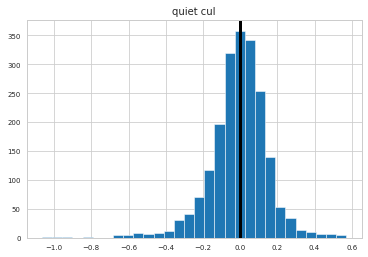

-0.0035994722134378566


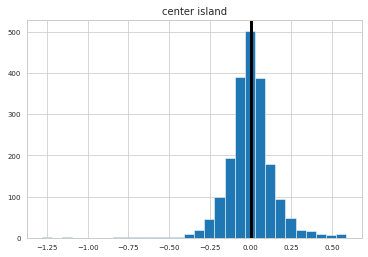

-0.00960949161068629


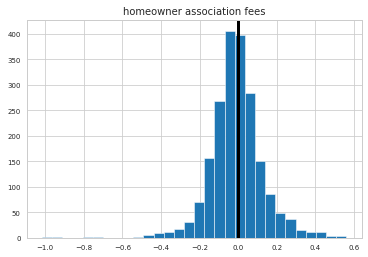

0.011119432568662008


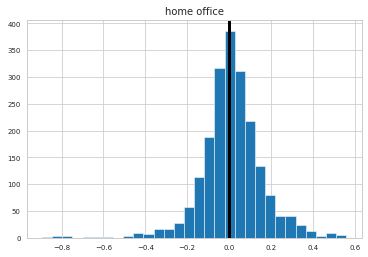

0.0002850162590954937


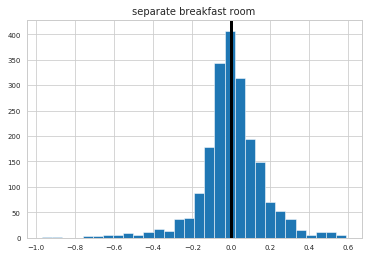

0.03429340620532008


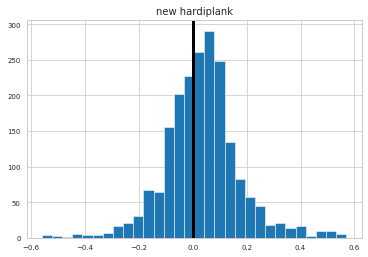

-0.008678305162135394


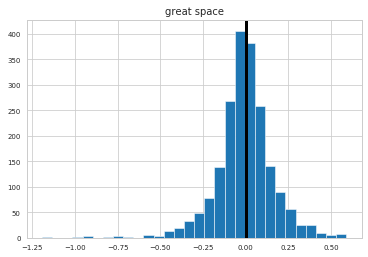

-0.009757691285954127


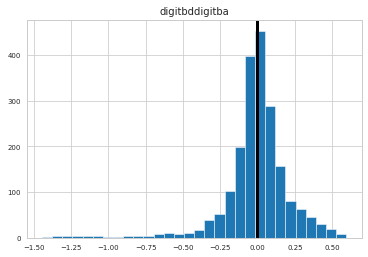

0.11783095585446672


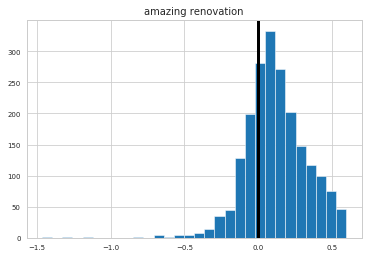

-0.005897576896738166


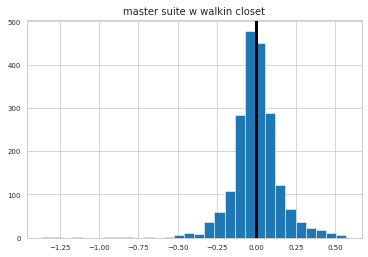

-0.0004893332703660427


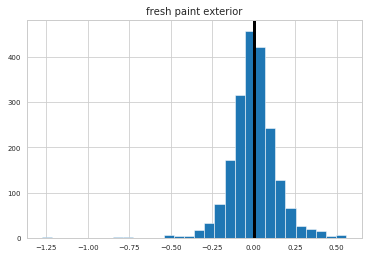

0.0646443852043299


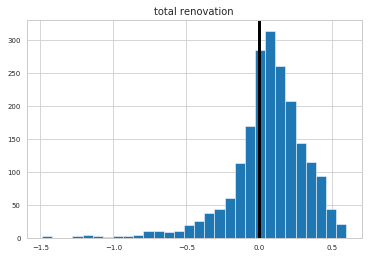

0.00557443696571563


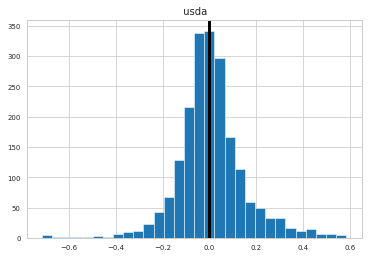

-0.016337088887345957


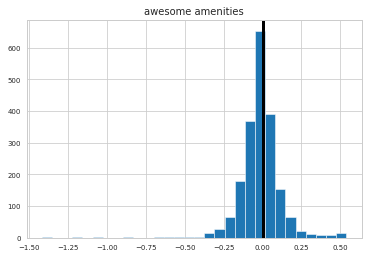

0.012721853369006482


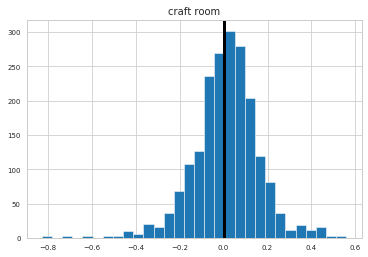

-0.023368214816481367


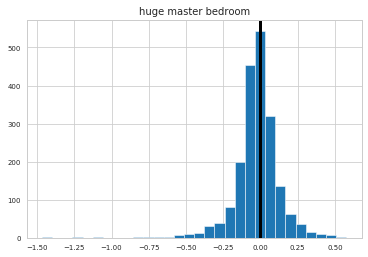

-0.01440039992625461


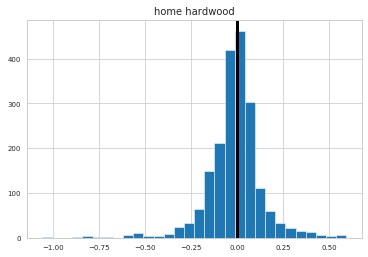

0.013097138961450287


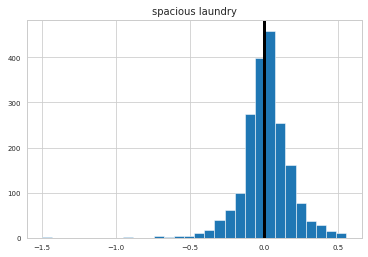

0.012205119455590663


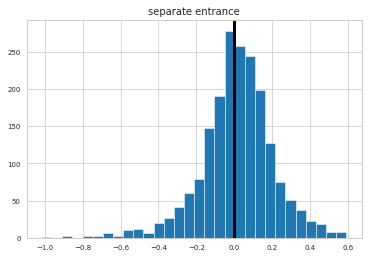

-0.0872421552718502


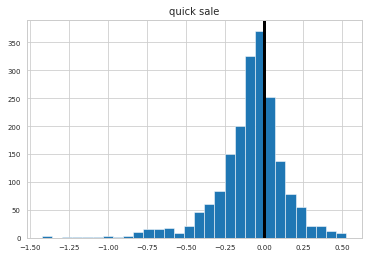

0.007977091522124214


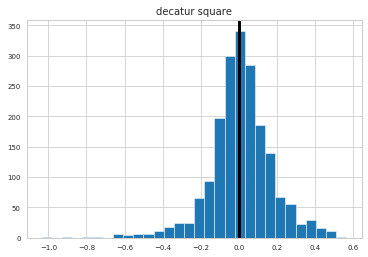

0.009869917981591326


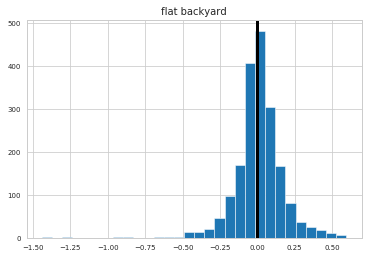

-0.04047235238002408


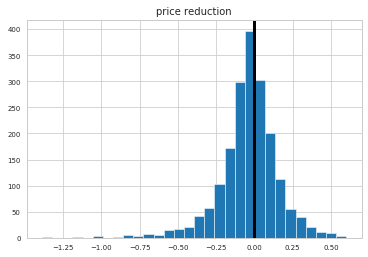

-0.018014420943300892


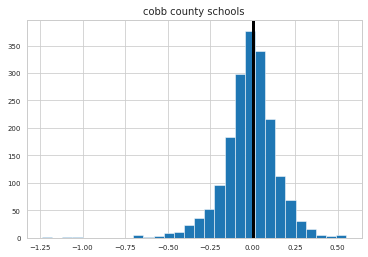

-0.006102765252950431


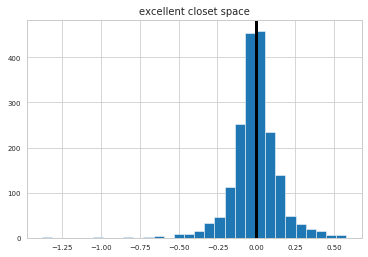

-0.014249262710687712


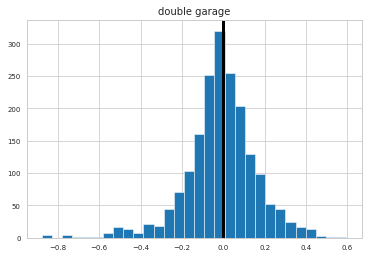

-0.006923116963860133


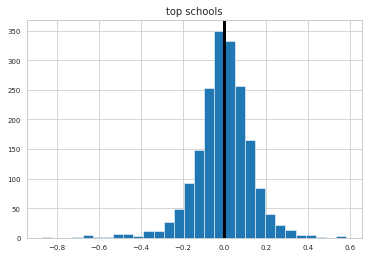

0.017600869964474318


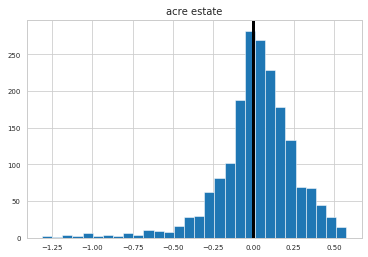

-0.0063431092084178745


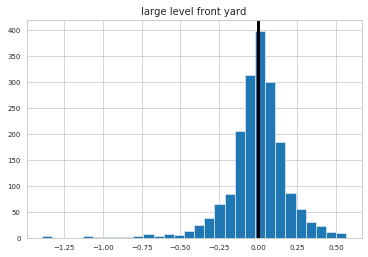

-0.023191454184881954


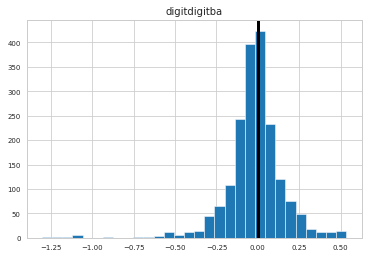

-0.007550671473373496


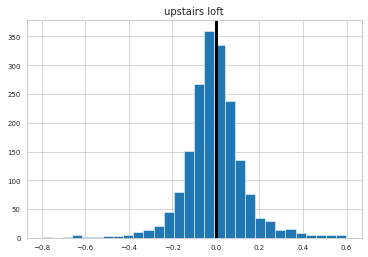

-0.025719338948452276


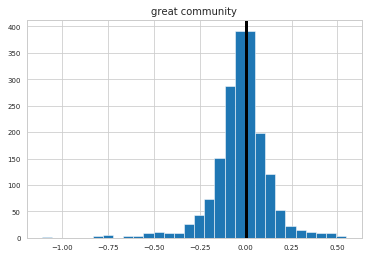

0.009178647531295105


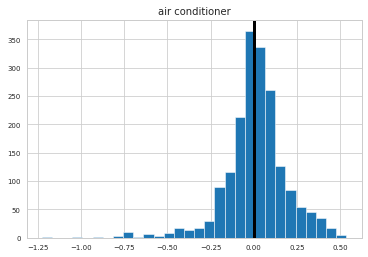

0.006780557565023326


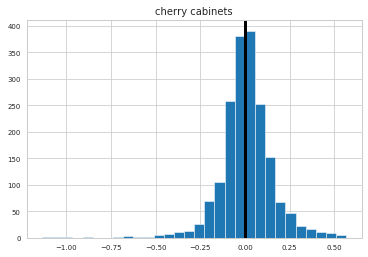

-0.06923911367178916


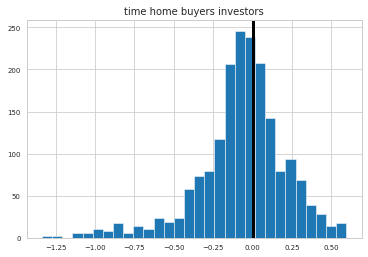

-0.0069092045578309


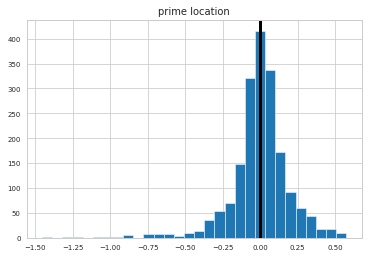

0.013367167165345133


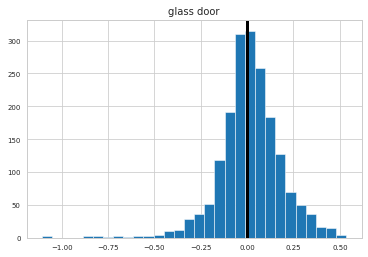

0.0027884419412361203


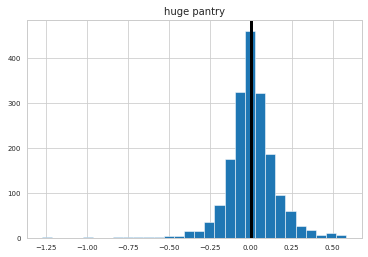

0.02196402904744154


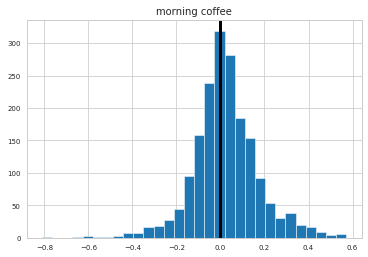

-0.002430577882526361


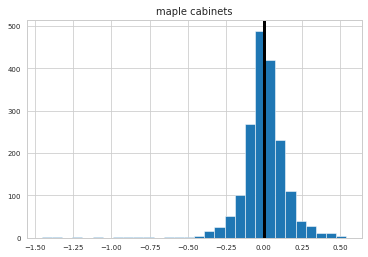

-0.004874158528723047


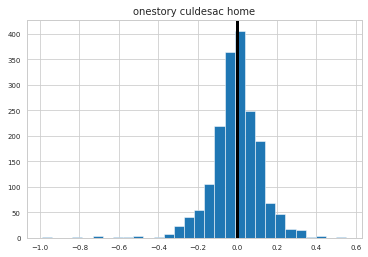

-0.027721892757133108


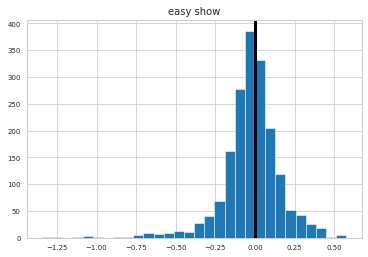

-0.003014643686610851


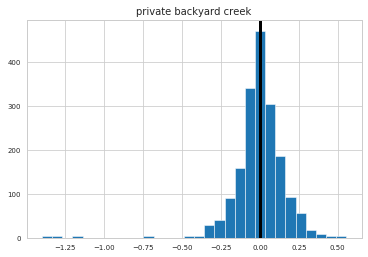

-0.005425787318267685


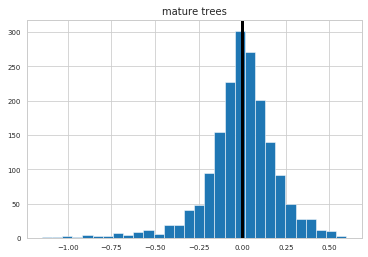

0.02583287497090287


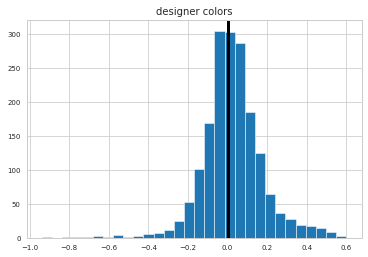

-0.012030948972430405


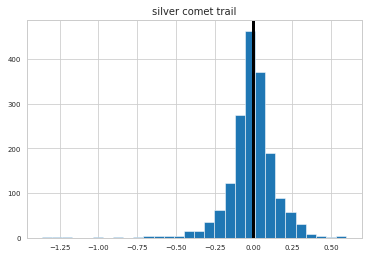

-0.007945494549303331


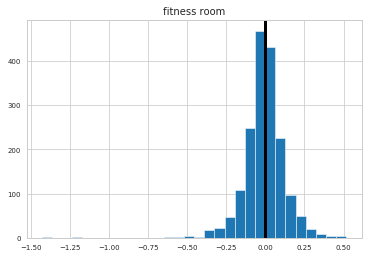

0.039196204991817085


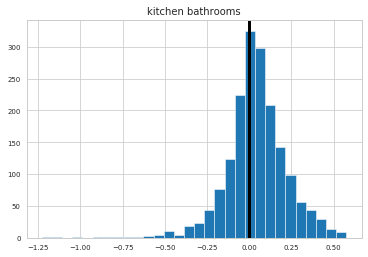

-0.009457689292145598


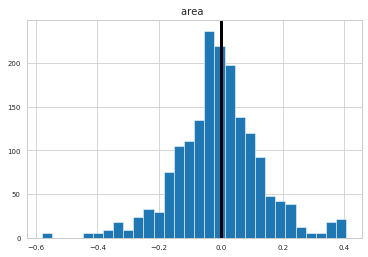

0.005220675221149942


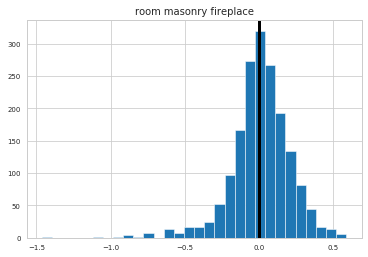

-0.006834304585671067


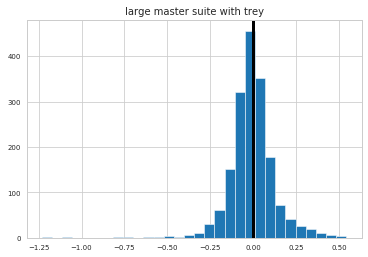

0.02778018773177994


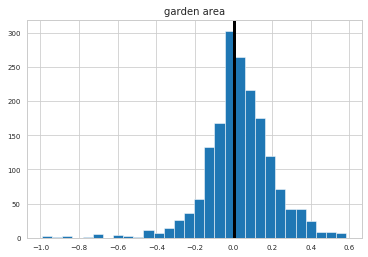

0.012911942533237226


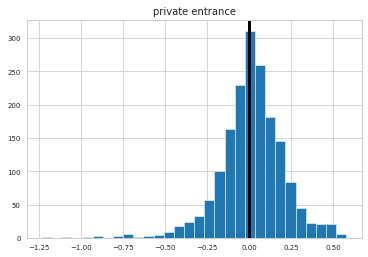

-0.20653465444635408


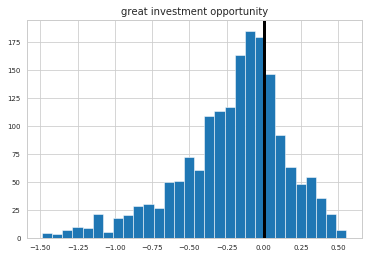

0.037797642835485916


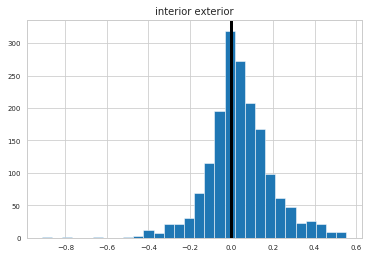

-0.009334028587671149


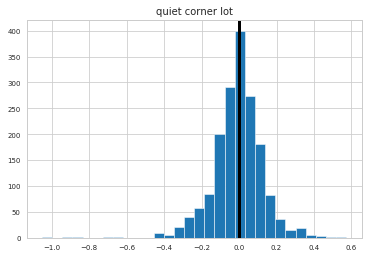

-0.006852493450397197


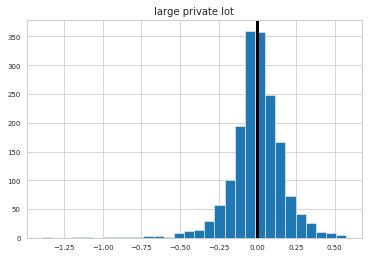

-0.02184629559803723


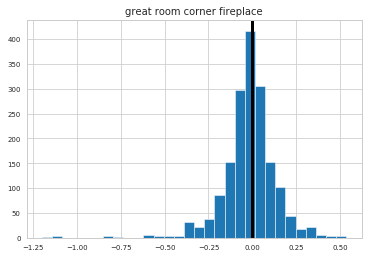

-0.016034002516750655


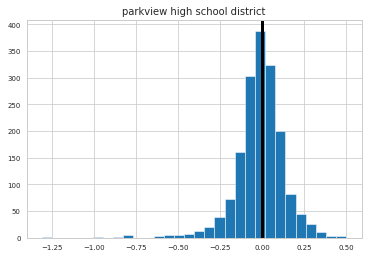

0.009464373820142024


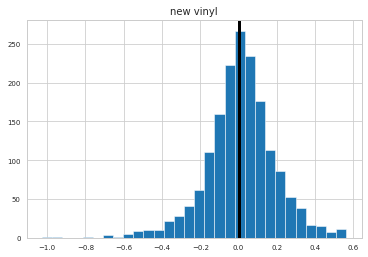

0.014760528224341611


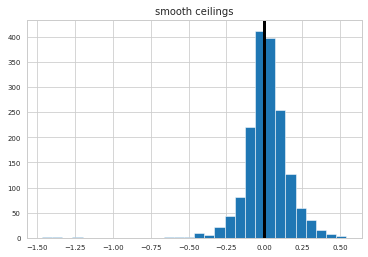

0.019172671739369016


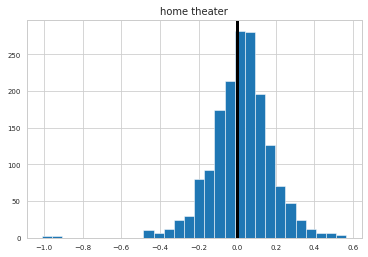

-0.0021588791466605776


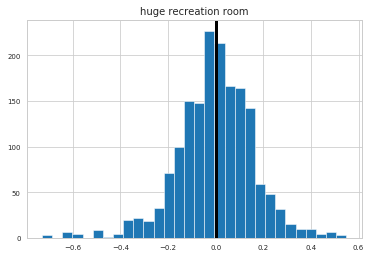

-0.043339873321034485


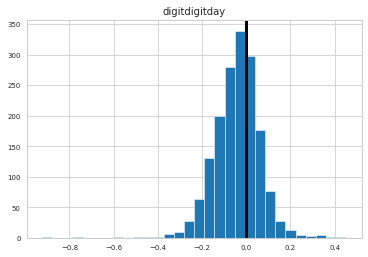

0.011485983043470309


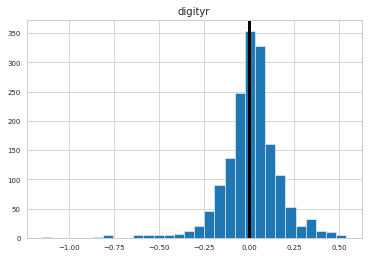

-0.02699859764808903


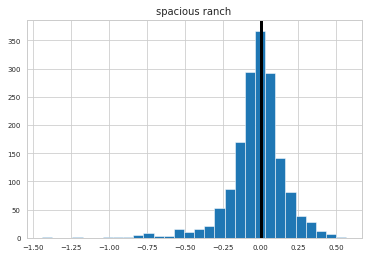

-0.011559603021516351


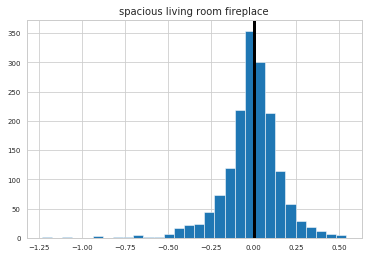

0.045867100872388204


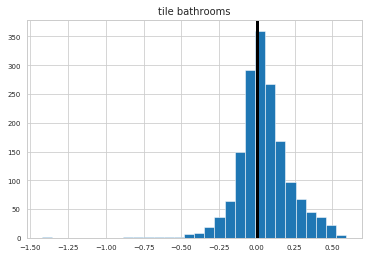

0.012909267593959444


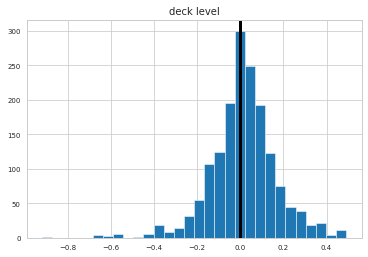

0.004904251427136805


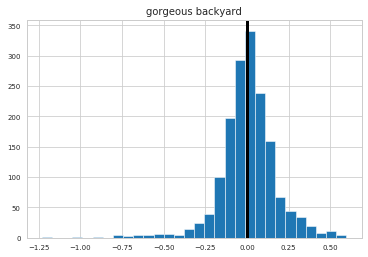

0.008567032639045343


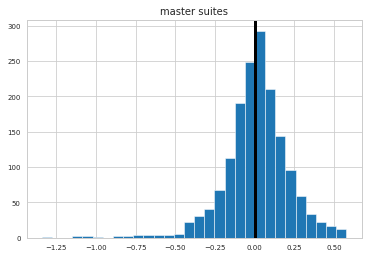

0.002407740335205237


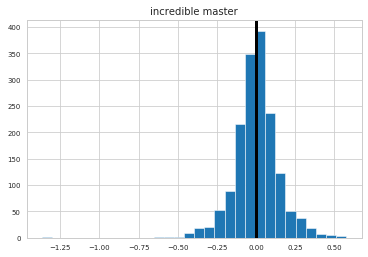

0.023815189278651318


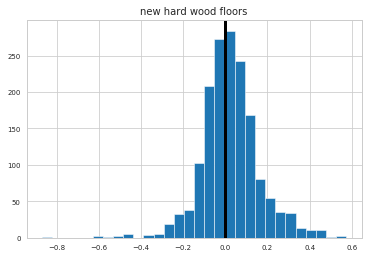

0.0038730195863733046


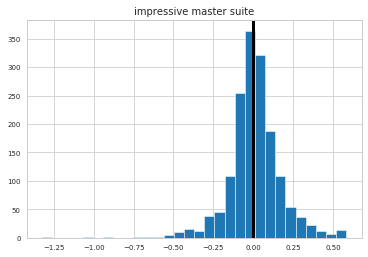

-0.007868027483067664


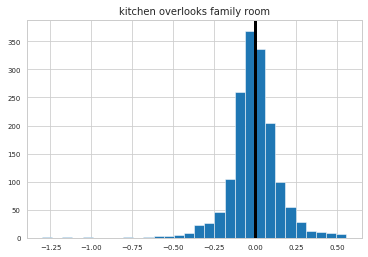

-0.000855654823044675


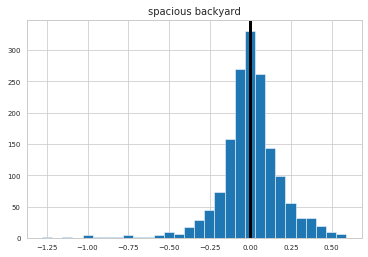

0.006862736354893887


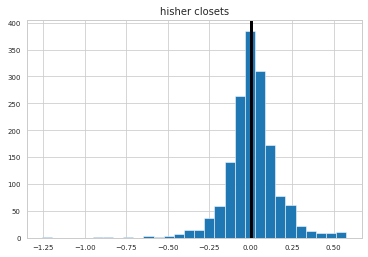

-0.00391985761656908


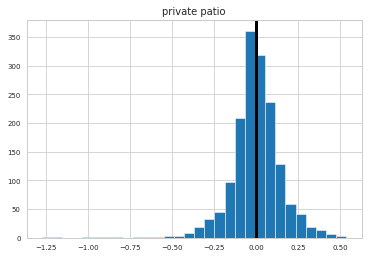

-0.012095725747676183


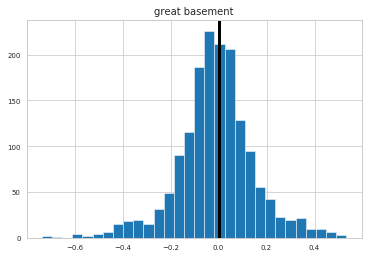

-0.011051747815554083


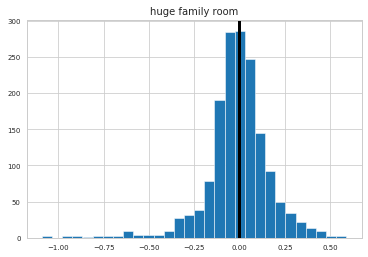

-0.013746184628401947


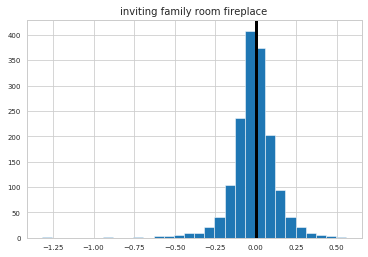

-0.0420130789077522


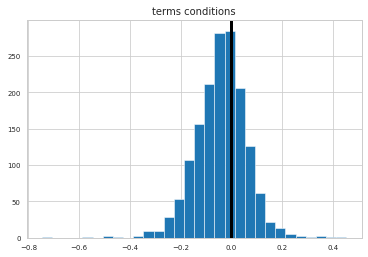

0.0013685876117973427


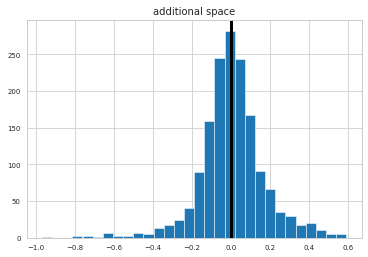

0.002534051994636155


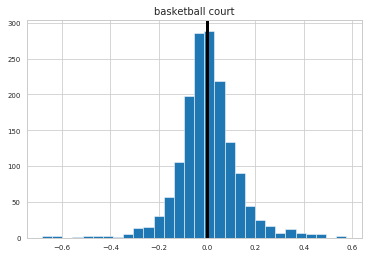

-0.03108124266303198


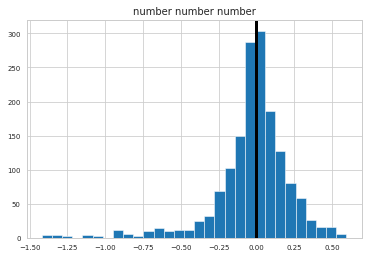

-0.002913263175795684


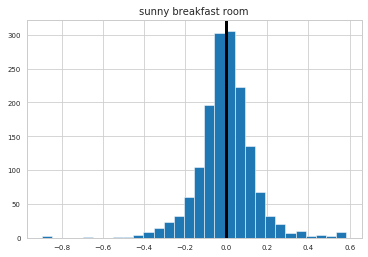

0.012811790688732757


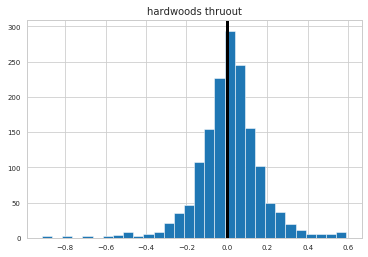

0.05340190513144418


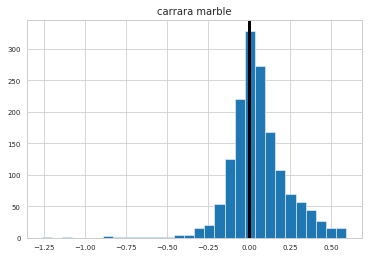

-0.002050115949907003


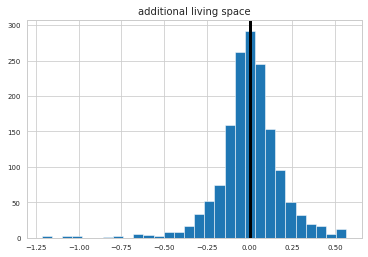

0.014743851957101256


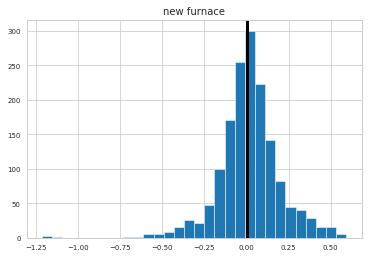

-0.013194945971869248


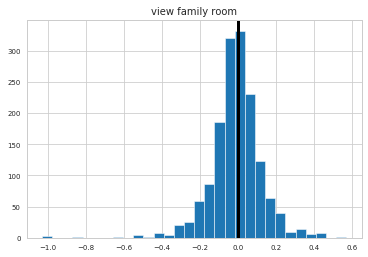

-0.00378861976399348


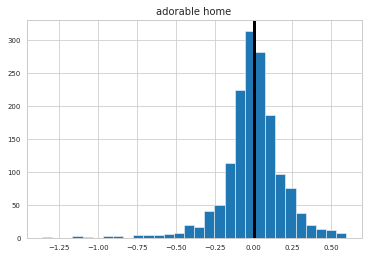

0.0030736892978876483


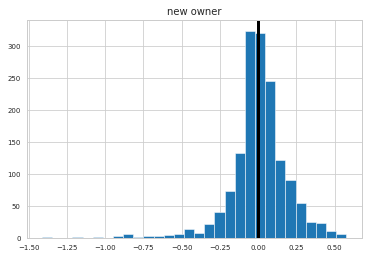

-0.01687924310975591


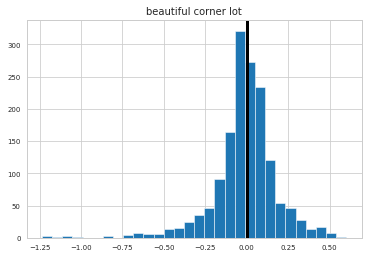

0.026967553104988638


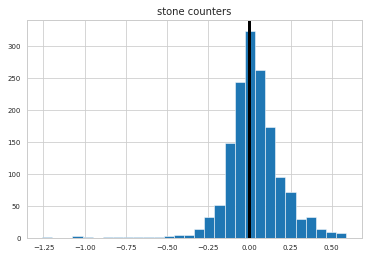

0.010594871612951052


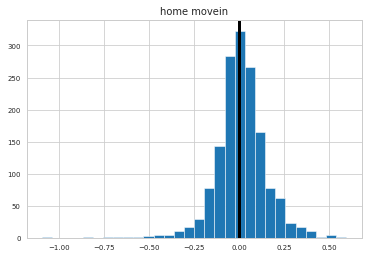

-0.047857277150383994


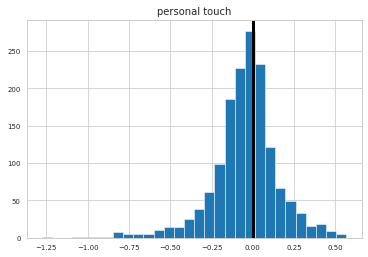

0.008143638695901836


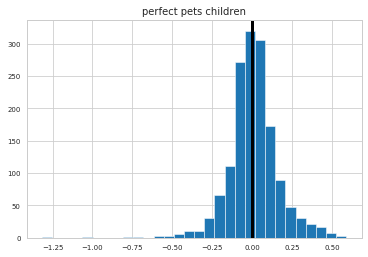

0.005409424346401259


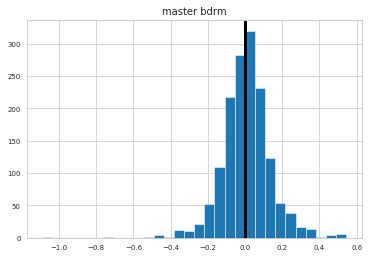

-0.0012861396401594245


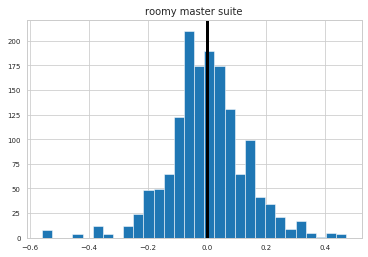

0.02393955892310459


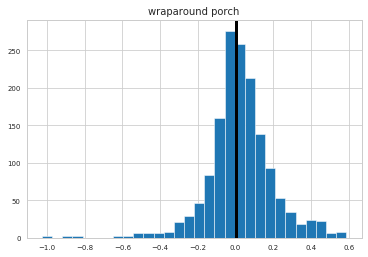

0.12710563082025159


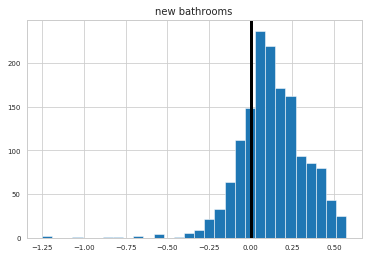

-0.009592102913153355


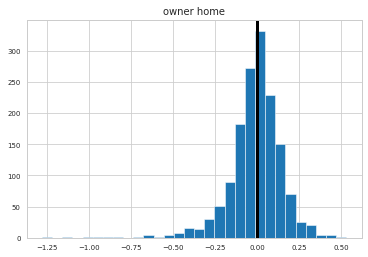

-0.00992876250078698


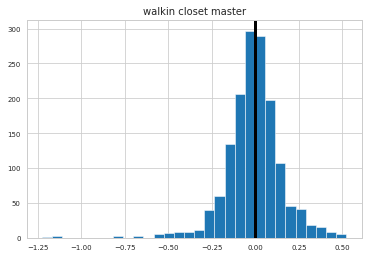

-0.010985161651844615


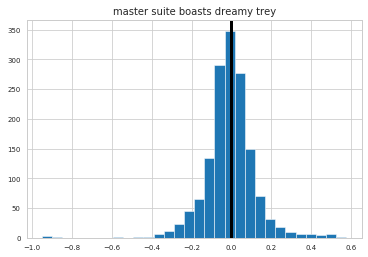

-0.010794211380814982


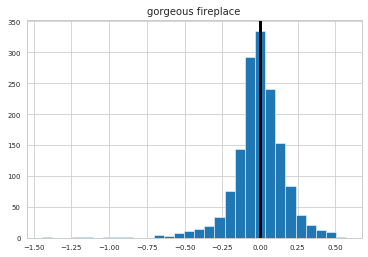

-0.006426538140332859


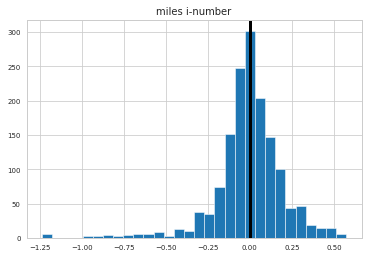

-0.019470066451814667


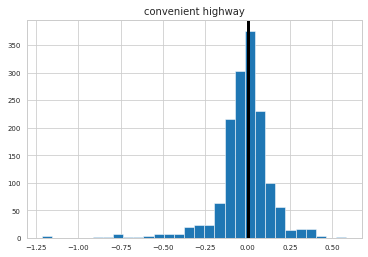

0.0014471511255847204


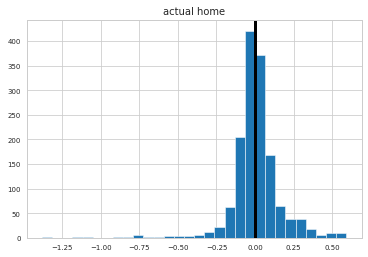

-0.00032874437955488395


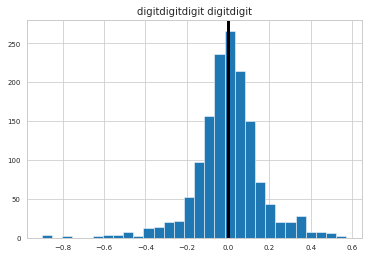

-0.014008530961358033


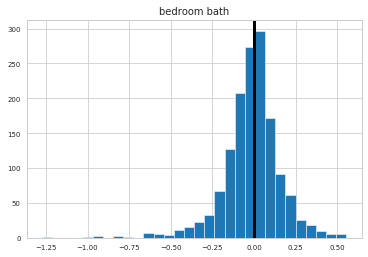

-0.0019280750743425649


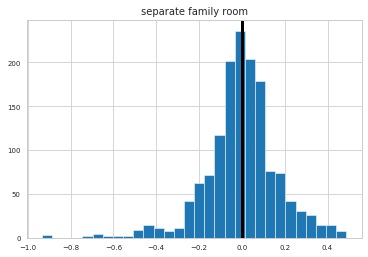

0.0801410361923159


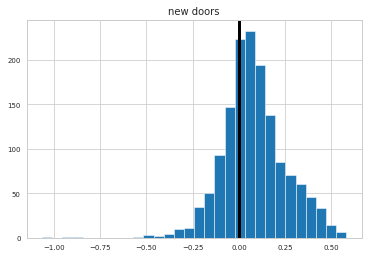

0.07482095970906233


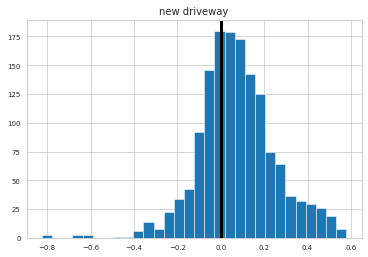

-0.01735901730791799


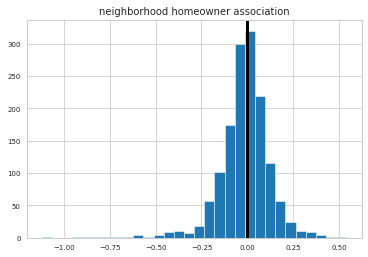

0.024238306449385807


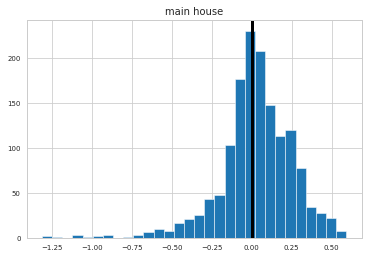

0.000135886628602754


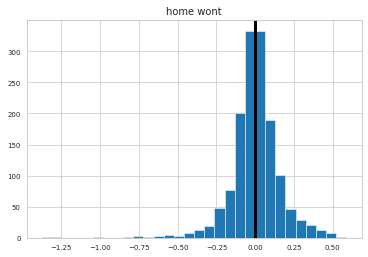

0.03641468005333351


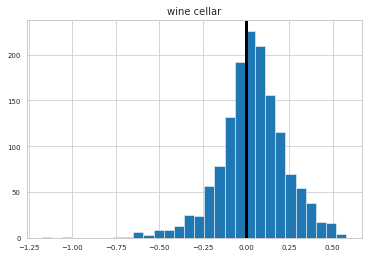

-0.01006240187186311


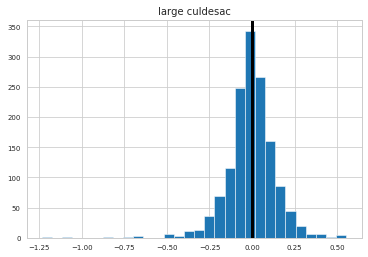

-0.006388838460577067


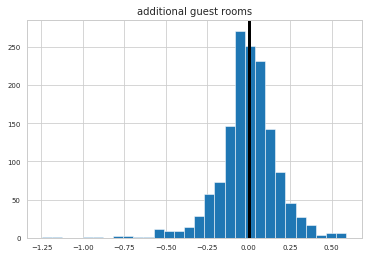

0.04695015379433782


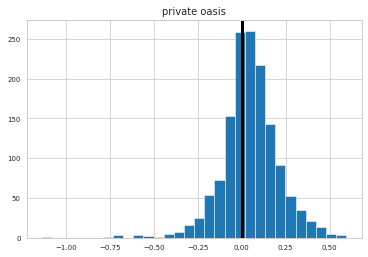

0.026658127210071977


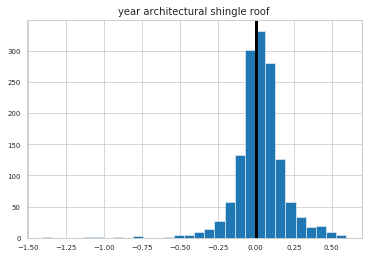

0.007093611263584843


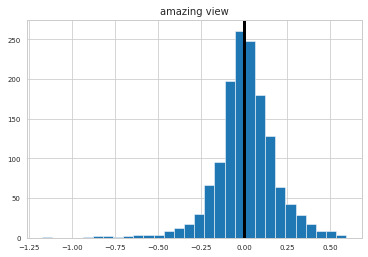

0.01885977011067961


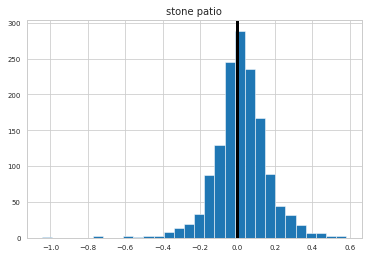

-0.015057370595455845


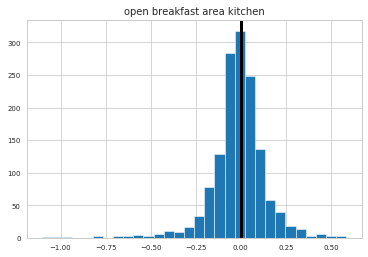

-0.03340700813172786


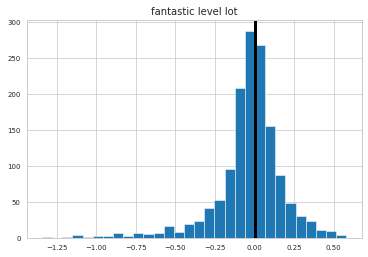

-0.003971046185494915


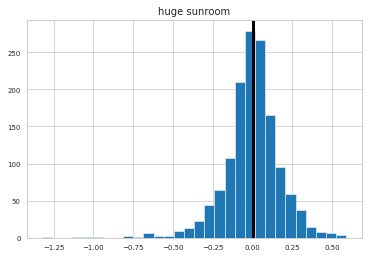

-0.01639374647346368


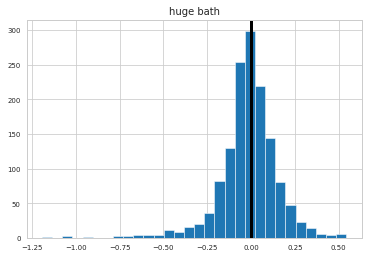

0.013758187895235014


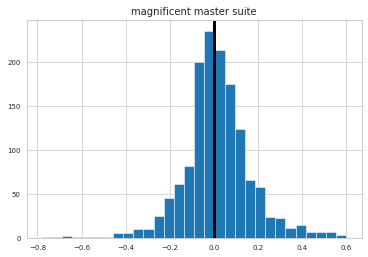

-0.0014178444948657685


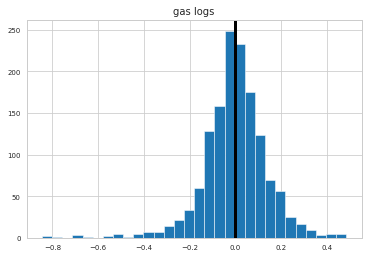

-0.01664254323366825


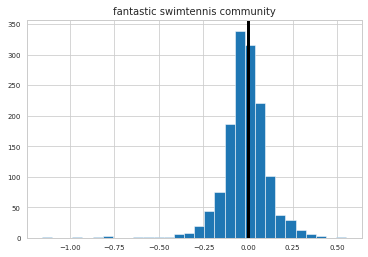

-0.0032850420861715796


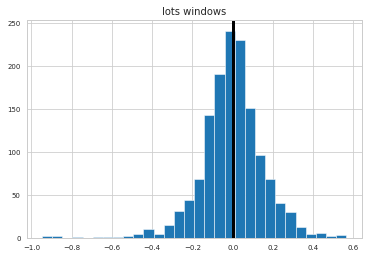

0.015622060134133139


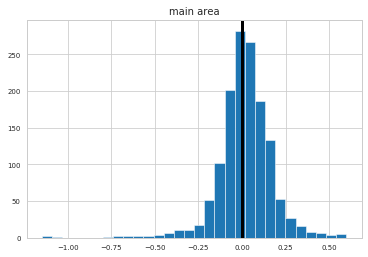

0.04149025065616745


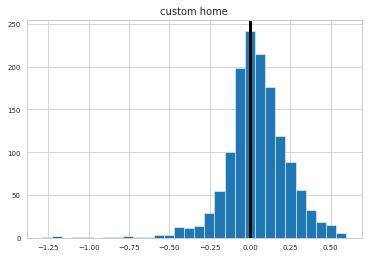

0.004247183103138219


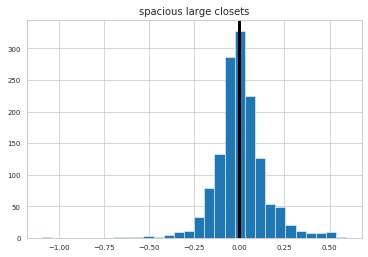

-0.010171884357915679


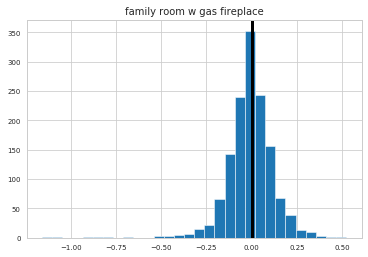

0.01950306170918423


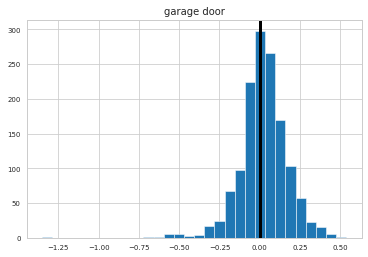

0.007802309262586521


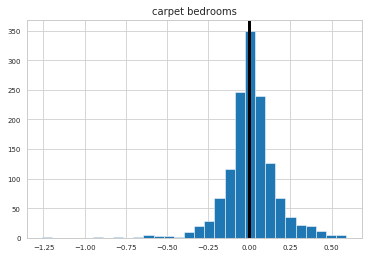

0.020778024927316396


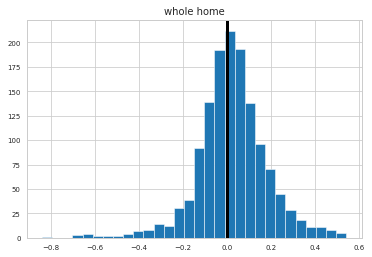

0.010651745625436186


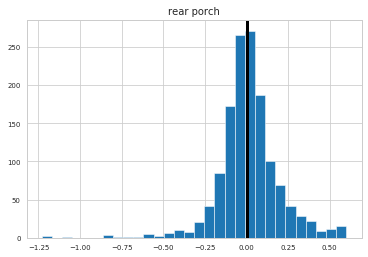

0.003917764234950291


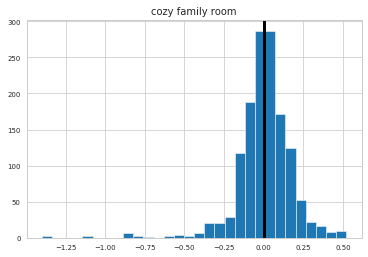

0.0011702012145485018


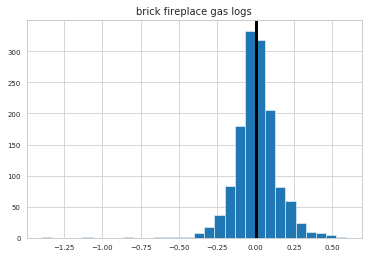

-0.019482506300181425


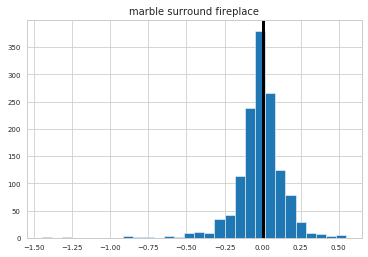

0.04624638013404446


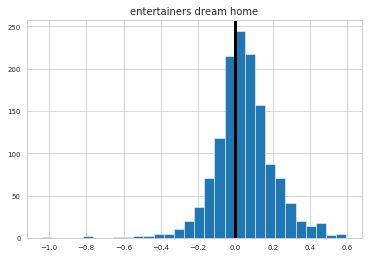

-0.016094622634447164


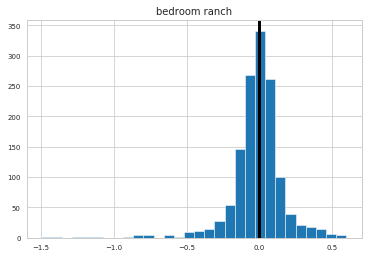

0.0024172598287422365


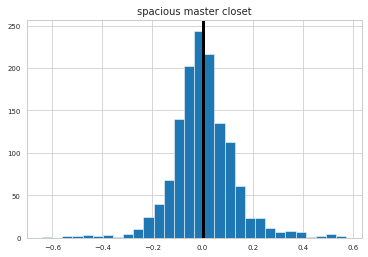

-0.0024716794110699915


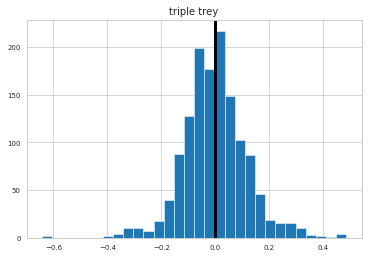

0.0013356945825177835


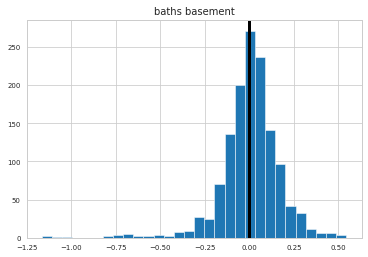

-0.007067169958965388


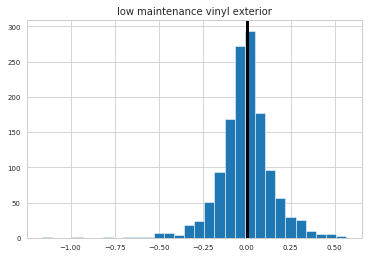

0.01019129831594345


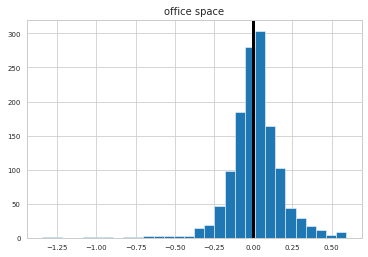

-0.007273726335354242


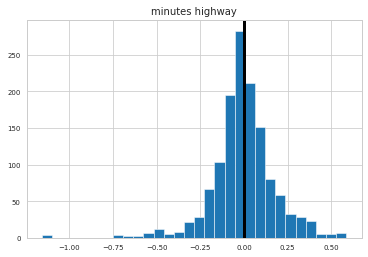

0.030735109123173062


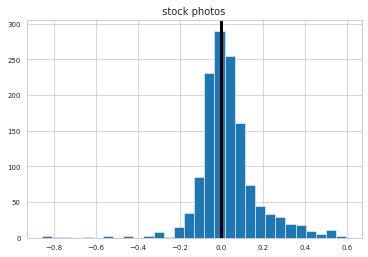

0.00015027539269045002


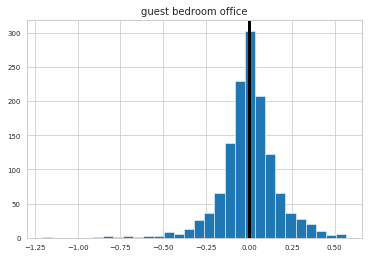

0.0016070951640260857


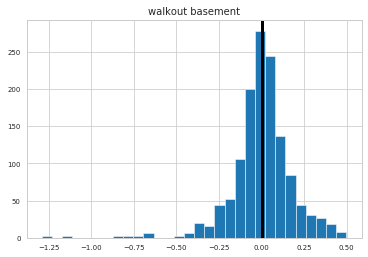

-0.0013817982784986344


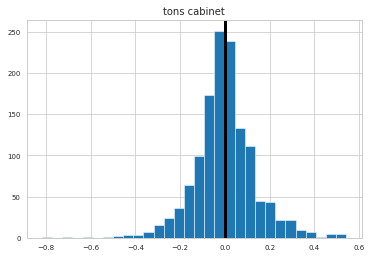

-0.012713091126421015


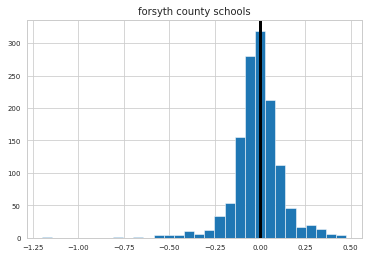

-0.0005931492094255177


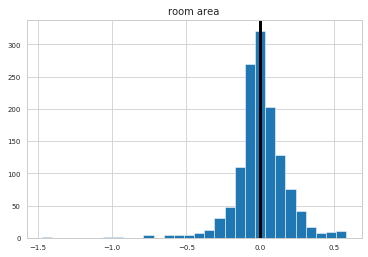

-0.021532450810657716


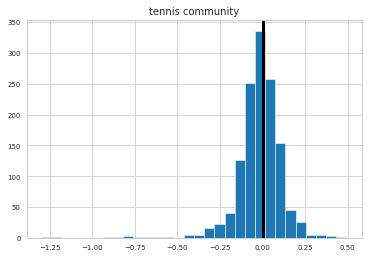

-0.051218942422611824


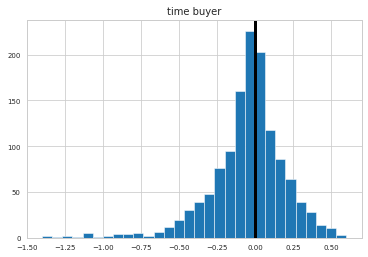

-0.0013480257101836468


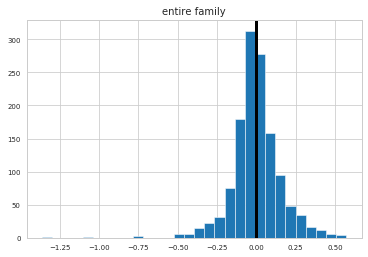

0.10859357389313391


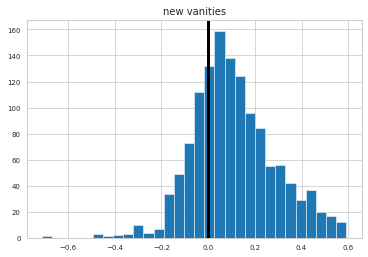

-0.024128900081963122


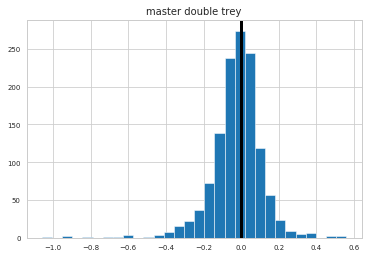

0.01936530103279177


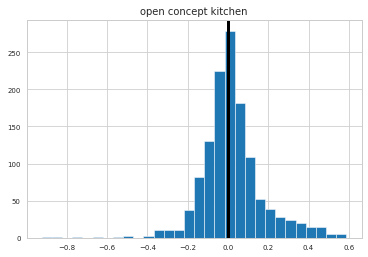

-0.02799505327434763


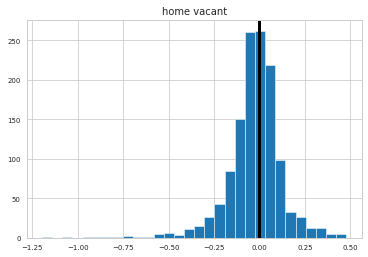

-0.008559776321599353


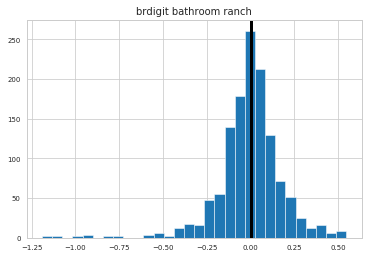

-0.001443510078773728


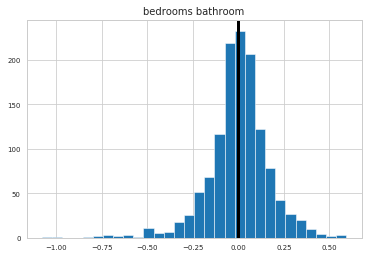

-0.001135045307933315


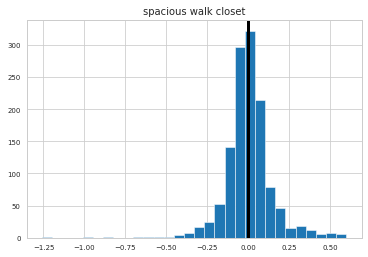

0.000514881741022157


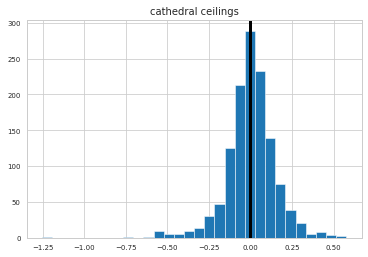

0.002386734499789826


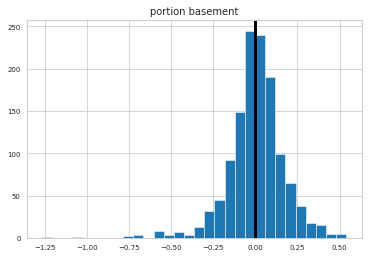

0.004145971422625943


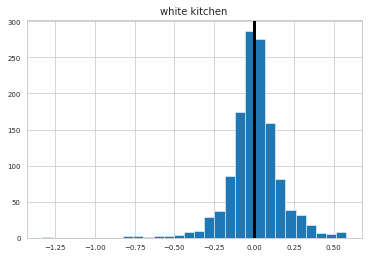

0.03896908315258851


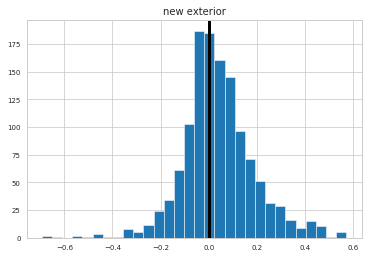

-0.011677299335878116


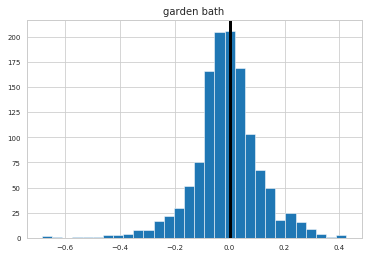

0.05735054466736861


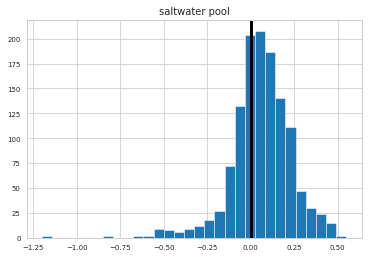

-0.0071757355056572495


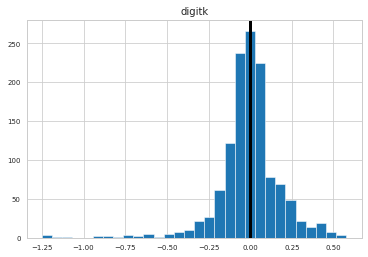

0.03155024610882144


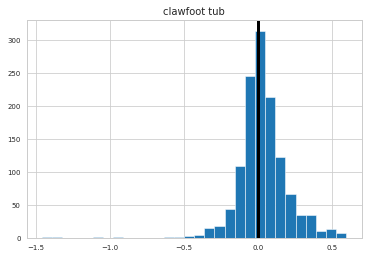

0.002284235818161487


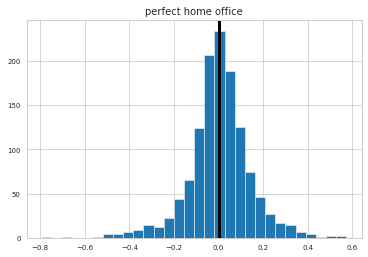

-0.277130818944184


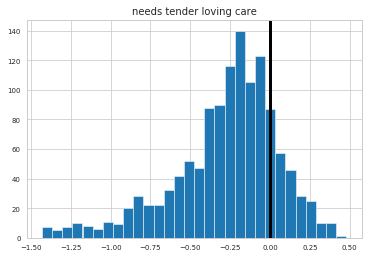

0.04786456505161215


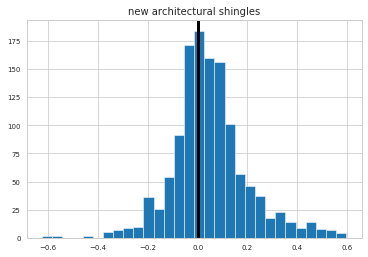

-0.014761846518514131


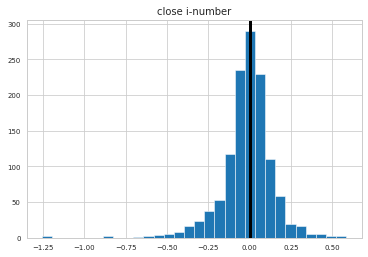

0.017962600052273993


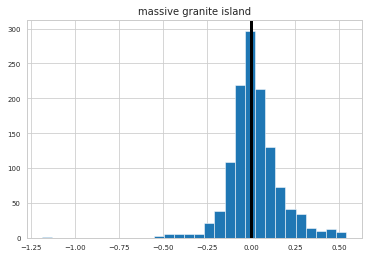

0.0001265733830459266


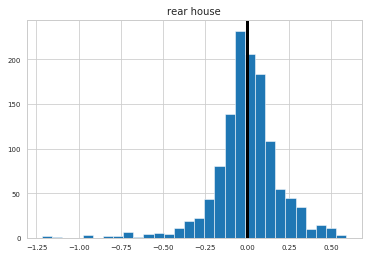

0.05436557325932942


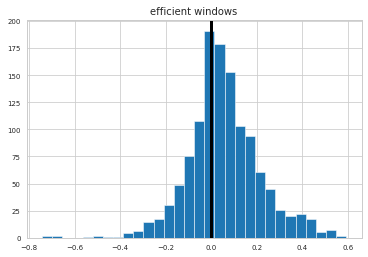

-0.020482862803698657


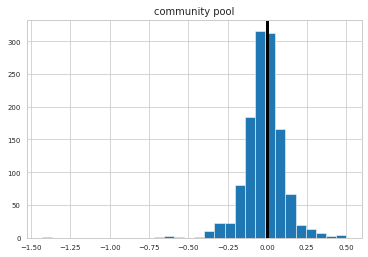

-0.016674729980168425


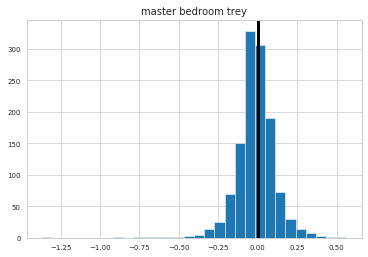

0.011892436611037192


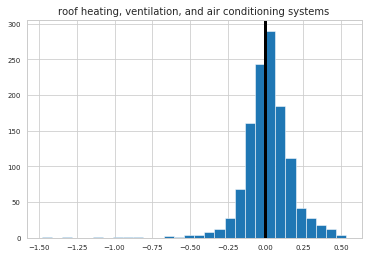

0.04543802626609844


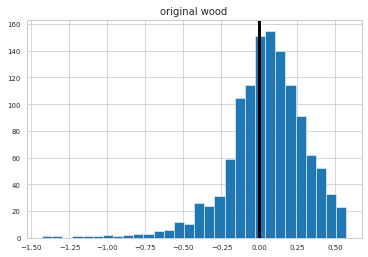

-0.012495334186169637


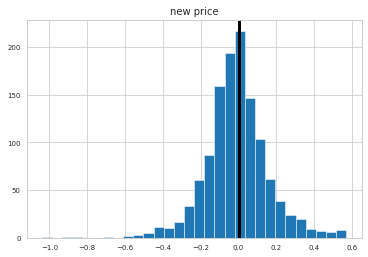

-0.01443402269983073


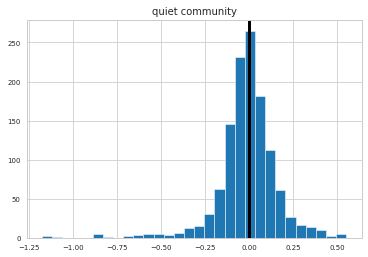

-0.003085227296978515


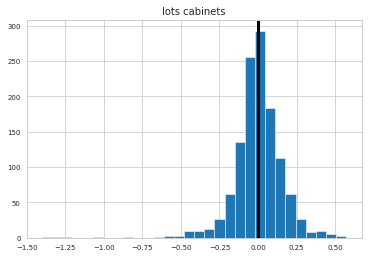

0.017290515657538332


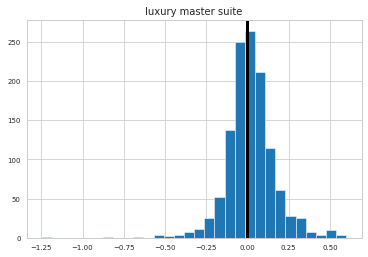

-0.053404888918879914


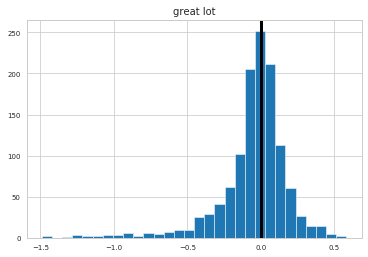

0.006409397766615417


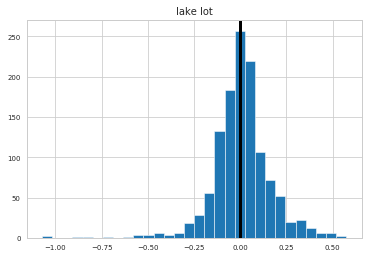

0.10252106060171957


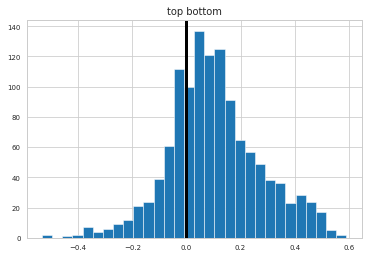

-0.0013603571208701771


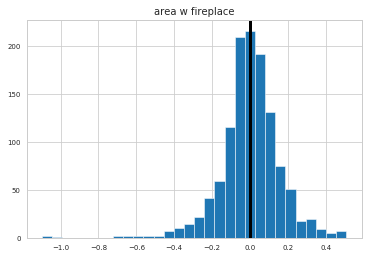

0.047400410886475425


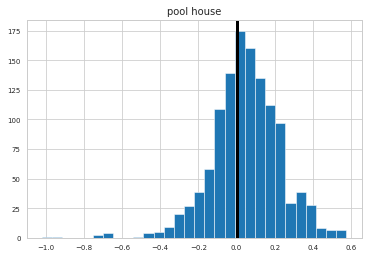

0.03103893953682694


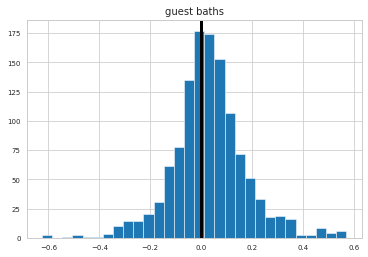

0.06188709970685136


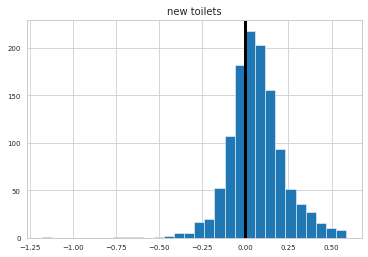

0.023697779436718164


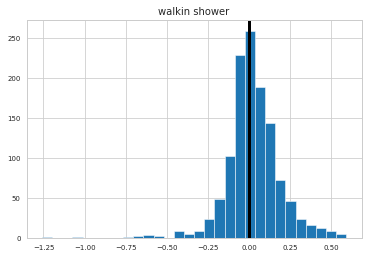

-0.0015988608967220529


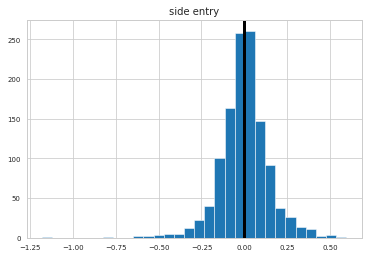

0.04546014502488438


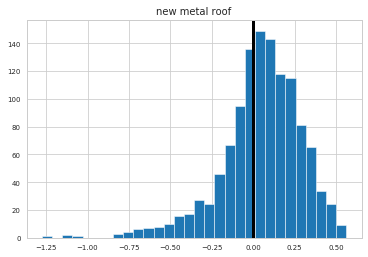

0.01418826183053455


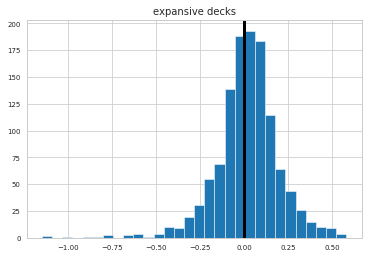

0.027333044800342328


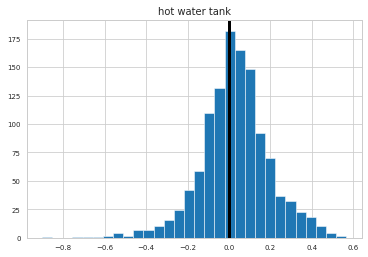

0.018326818373286174


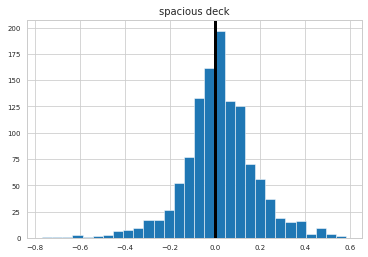

-0.001769928619291966


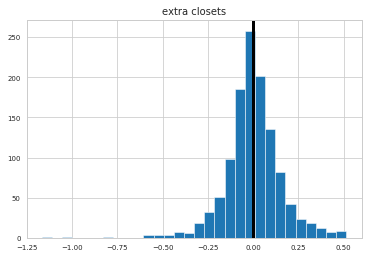

-0.025174169565224155


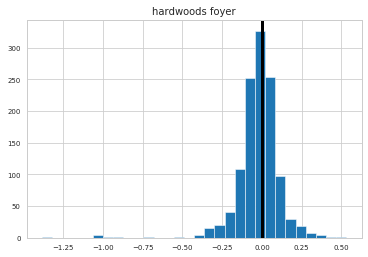

-0.014513477359706286


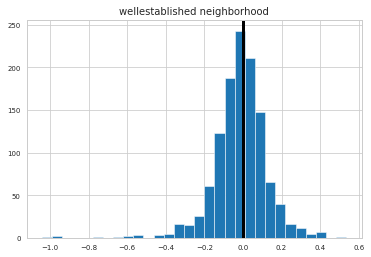

-0.0029385940915709354


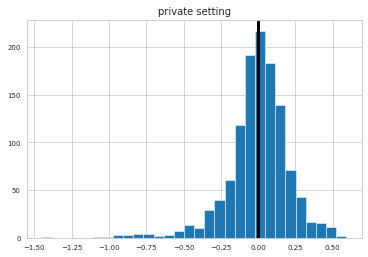

0.006756602701194721


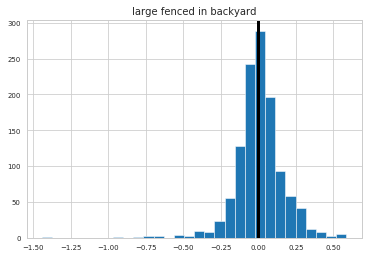

-0.005739275738337106


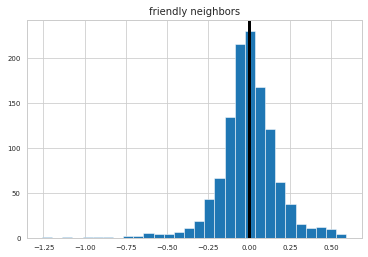

0.015211456857662066


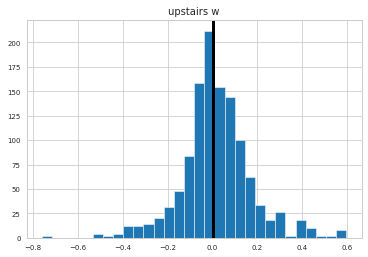

-0.008638130856601069


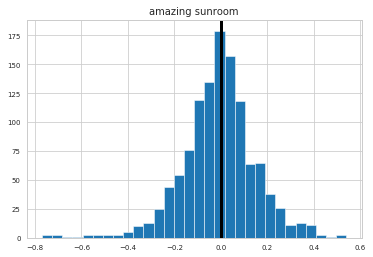

0.01701312903760926


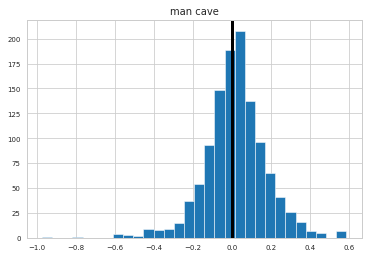

-0.012442108318000739


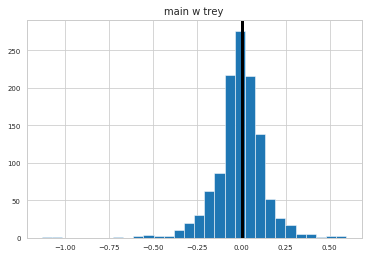

0.05962376204661494


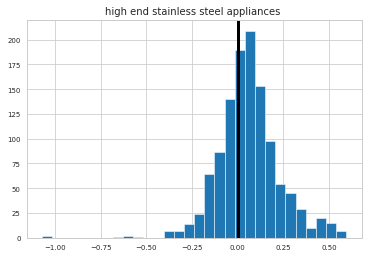

-0.006628086269382235


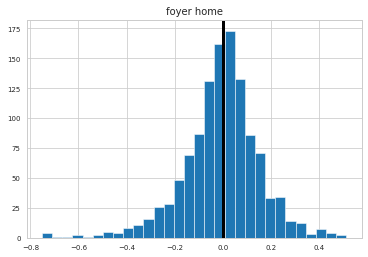

-0.004304905926723739


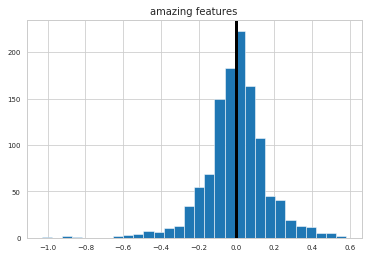

-0.21262989359212542


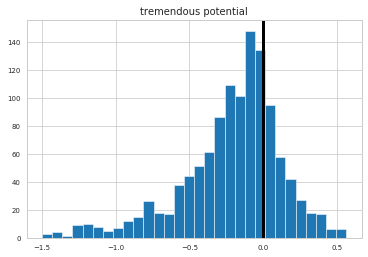

0.00048395683101568927


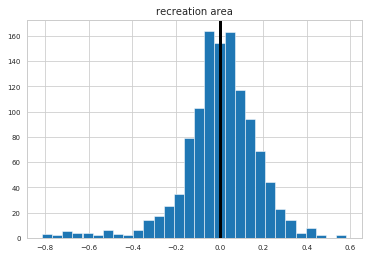

-0.007776440836623962


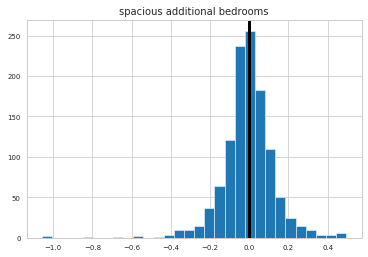

0.08939729441406741


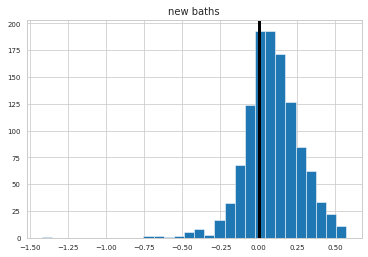

-0.02811114794128109


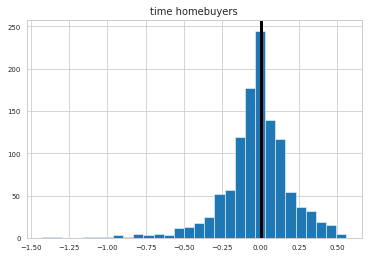

0.009250623384790097


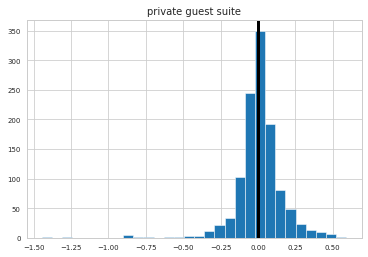

0.015047154997575096


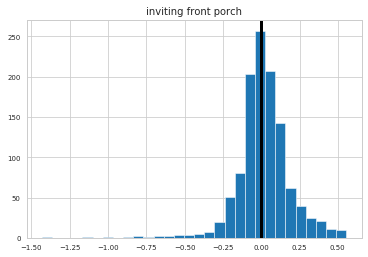

-0.011811183727926559


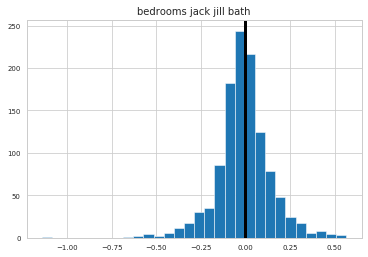

0.04693809627154968


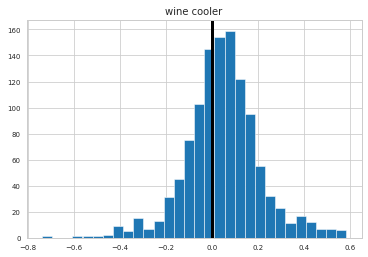

0.016541633143654744


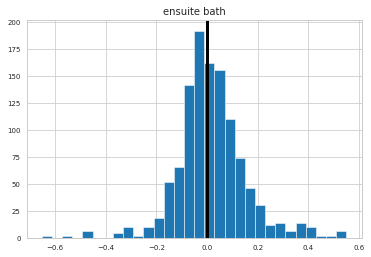

-0.025140111090950937


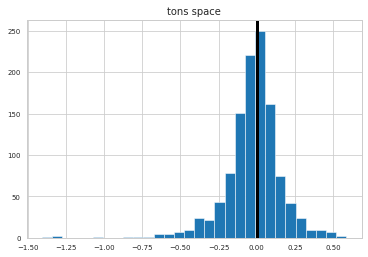

0.005844071681528984


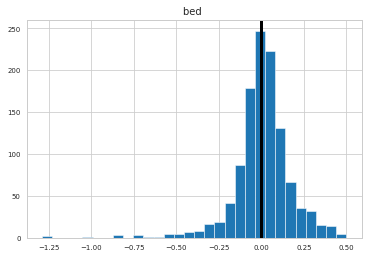

0.002357509504346623


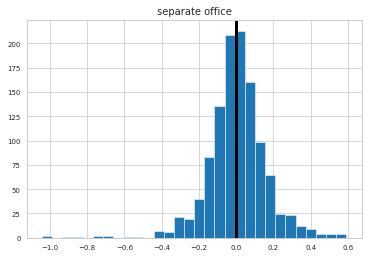

0.028761718500605427


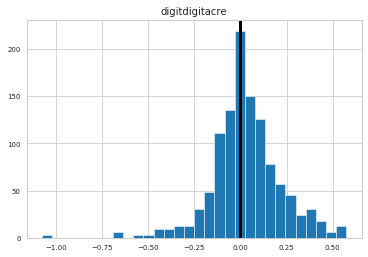

-0.005234176216511572


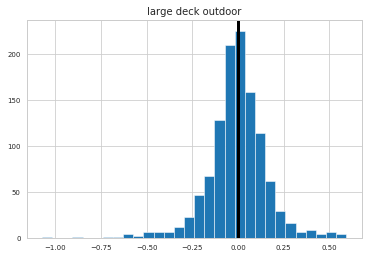

0.0056834221110618486


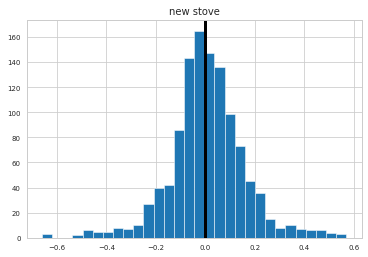

0.020409400331344477


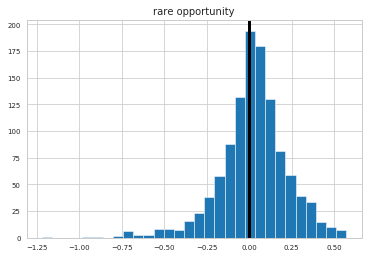

-0.17444455818459825


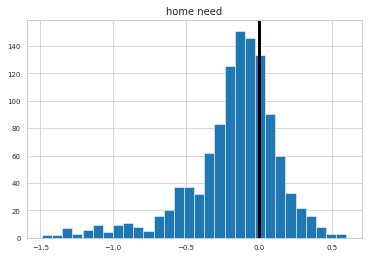

-0.01248665834730039


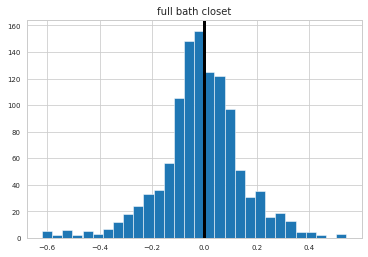

0.03787825045376354


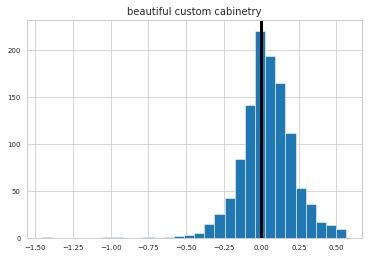

-0.0034985045645506865


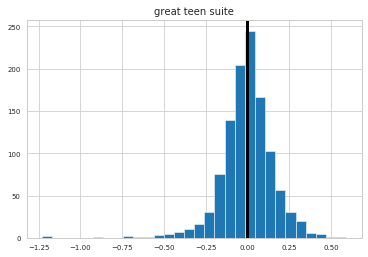

-0.004299530122650319


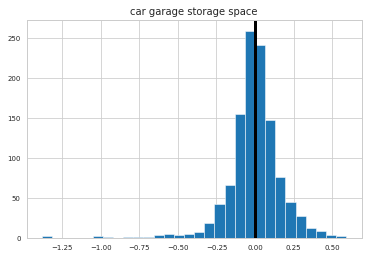

0.003702581724052032


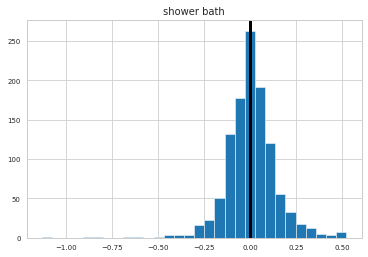

0.009049837526148519


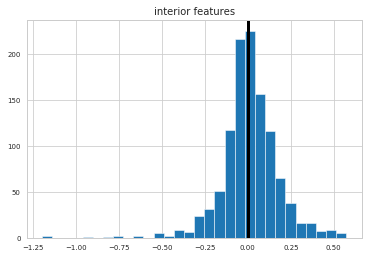

0.06677160606022839


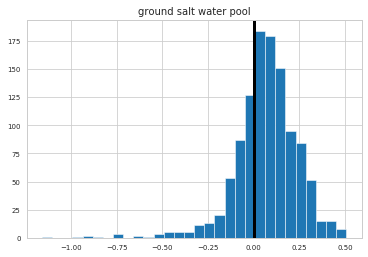

-0.005478177559298557


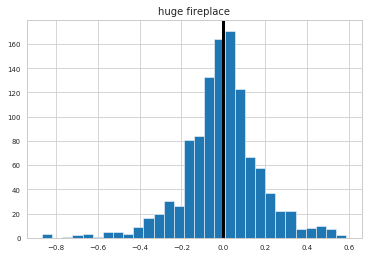

0.021092802802931562


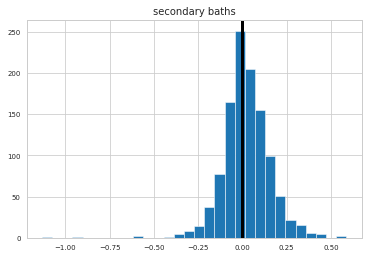

-0.04025674968802281


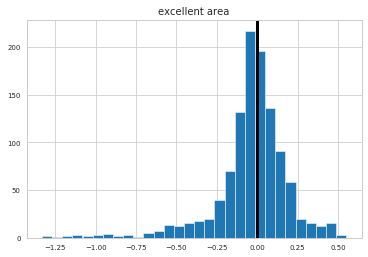

-0.004093819202120016


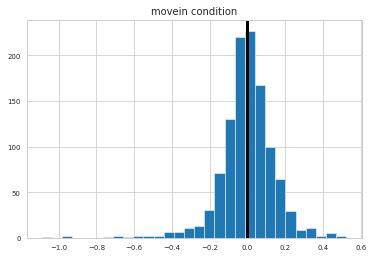

0.03571166294192016


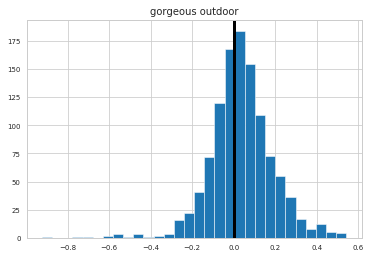

0.01596335079568586


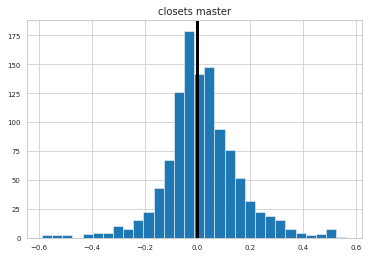

-0.006980414071989998


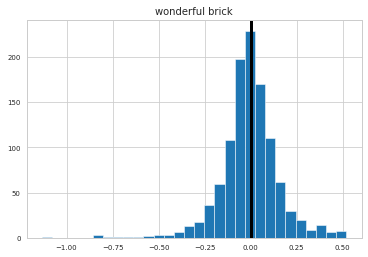

0.03682870556177935


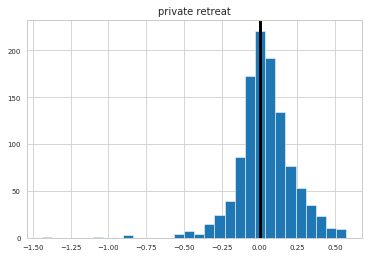

0.009586148649439463


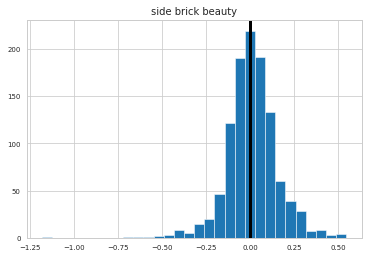

0.040879581971560636


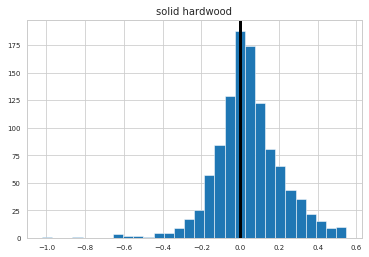

-0.005819985190880031


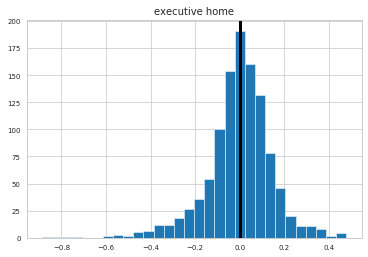

0.01041636634281146


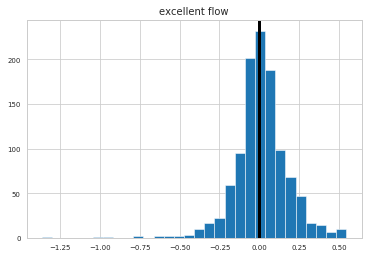

-0.02315862203097733


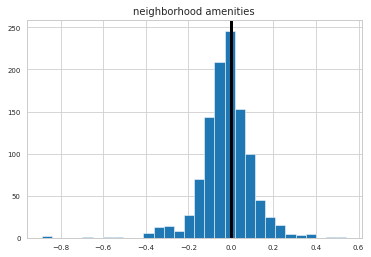

0.013301599495977938


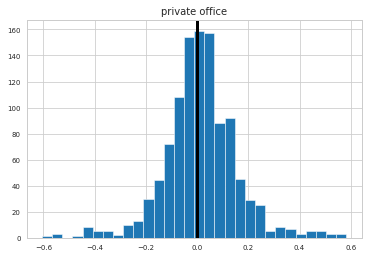

0.002914896669090139


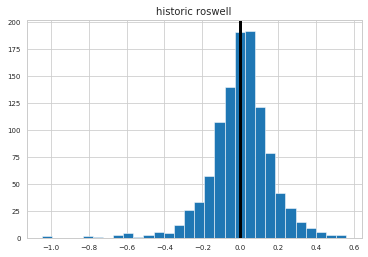

-0.08208130819051863


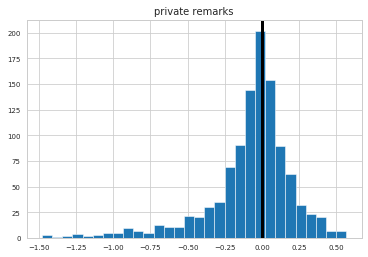

-0.024977511360401574


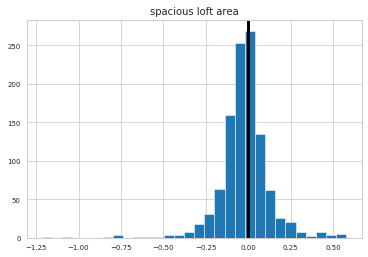

0.019341052741396605


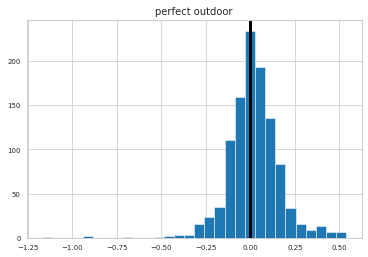

-0.022356014178150765


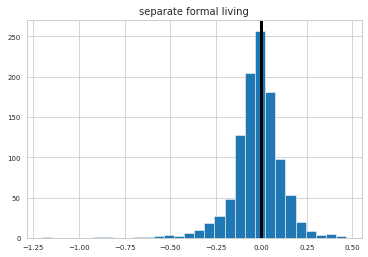

0.03275609179966453


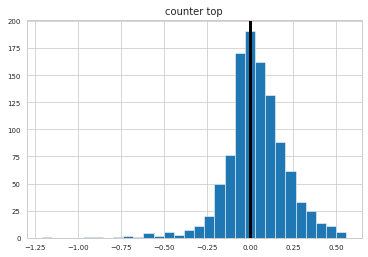

0.043797094938604966


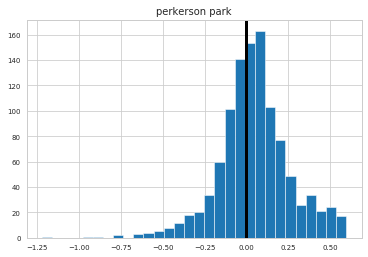

0.00752146568685496


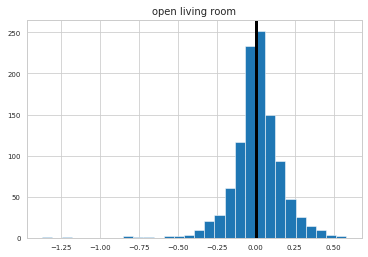

-0.020112777877892212


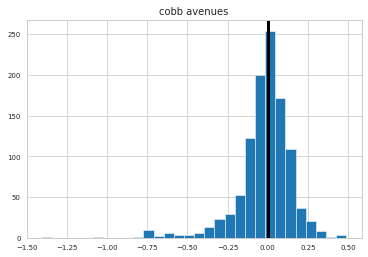

-0.01690291712140462


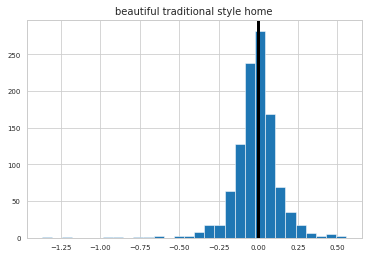

0.01995326852571078


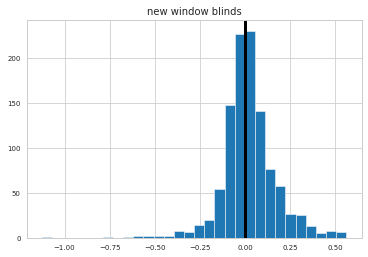

0.0026946105767185788


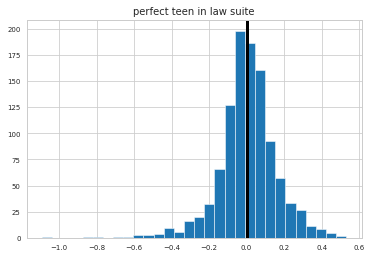

-0.0005780404034959329


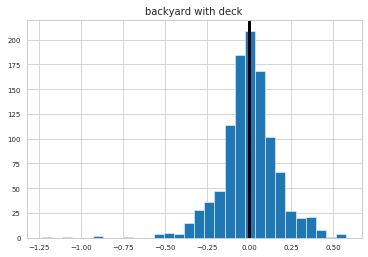

0.011316761350154813


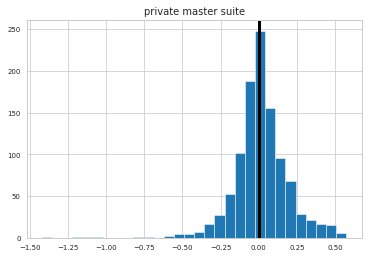

-0.018216686542831248


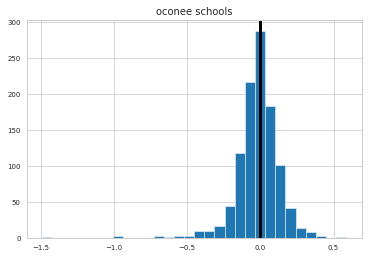

0.017037230923266648


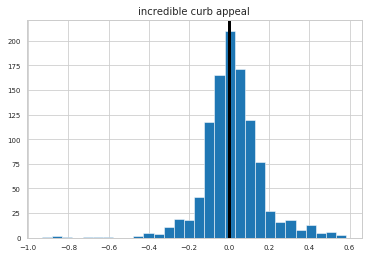

0.006649570541588847


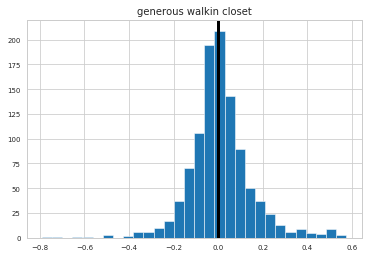

0.01016384669373652


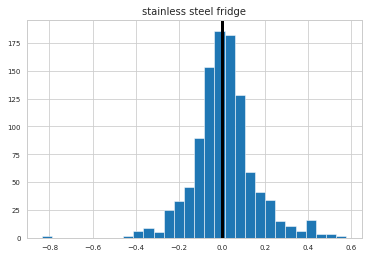

-0.011528927454839936


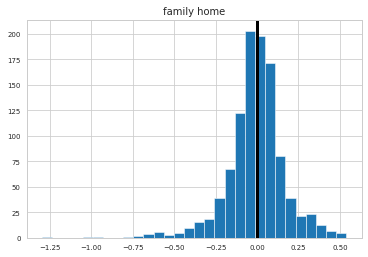

0.012373641668447274


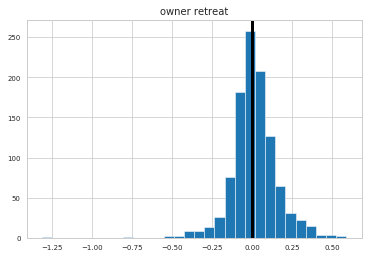

0.0032944170619230995


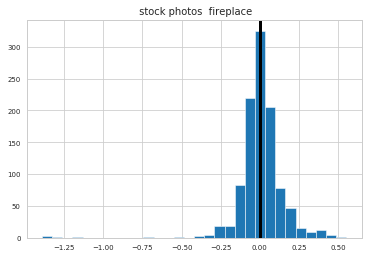

0.012242957170983197


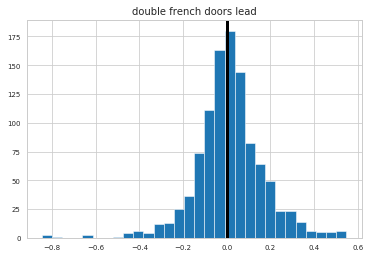

-0.010502564576658607


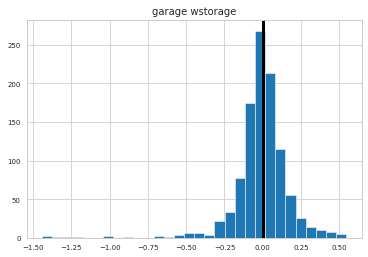

-0.001357904065922267


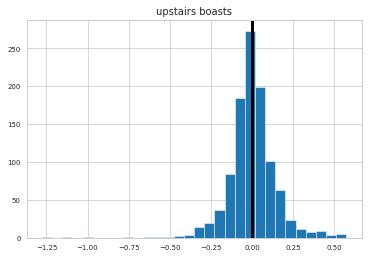

0.014727536843918244


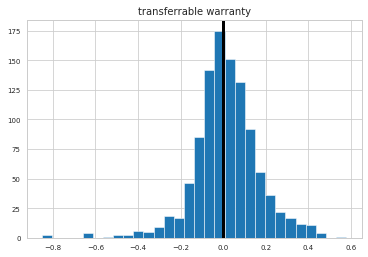

-0.00643894543256838


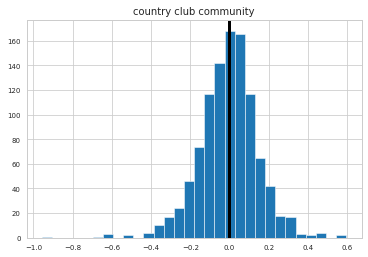

-0.00014352008559301437


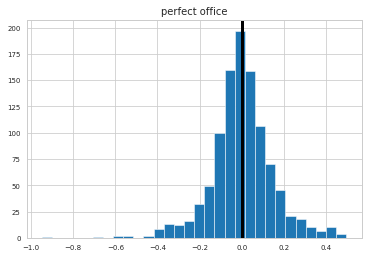

-0.015385014384863727


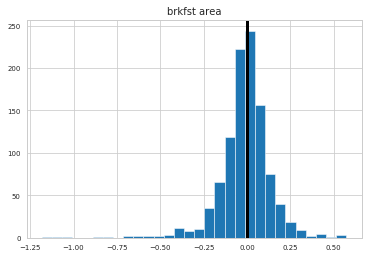

-0.022951332806219332


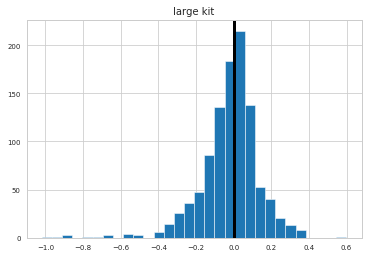

-0.006643849882249654


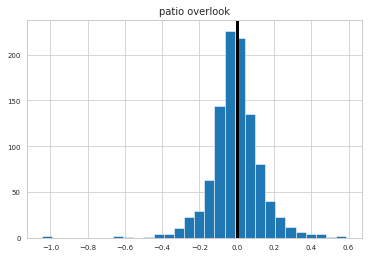

-0.018557651425249677


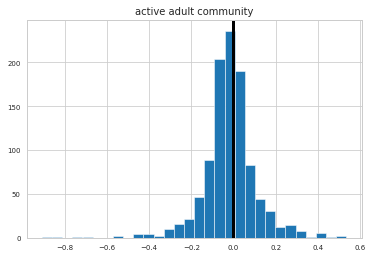

-0.012483773635337536


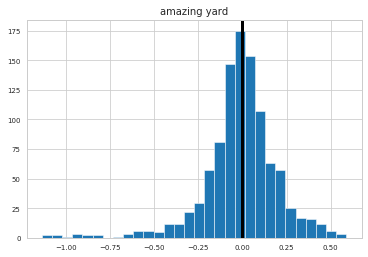

-0.0010495909297636586


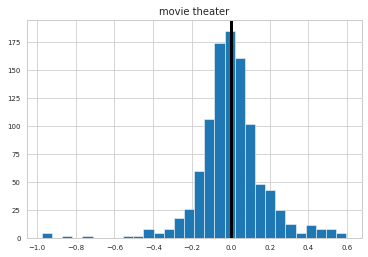

-0.01910817591161137


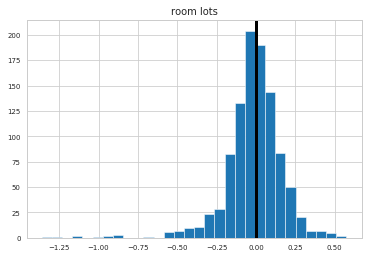

0.02357463452088359


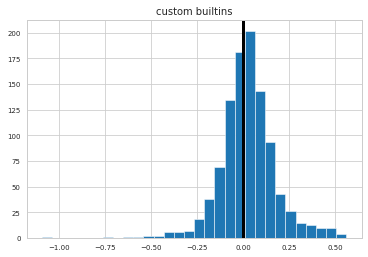

-0.005757599158852225


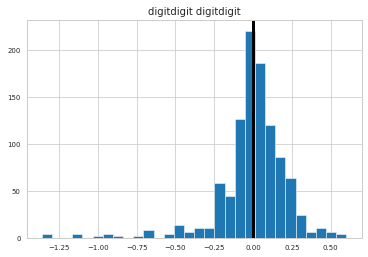

-0.17686091463174988


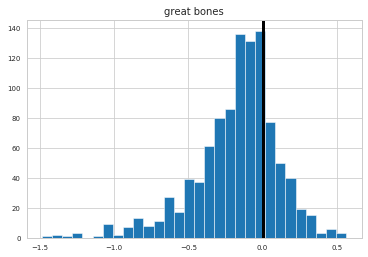

0.010789996857296095


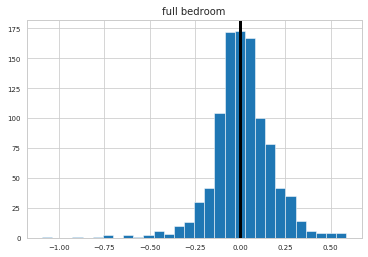

-0.020860315669610028


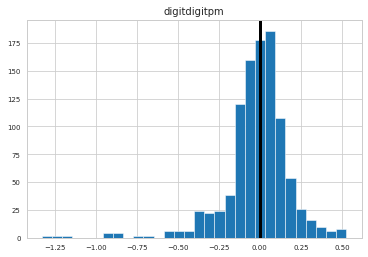

-0.021446097809803166


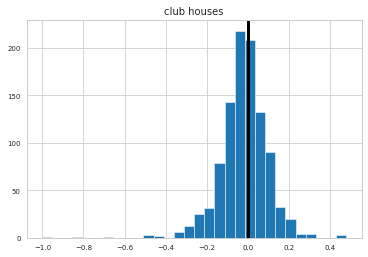

0.011132025262271396


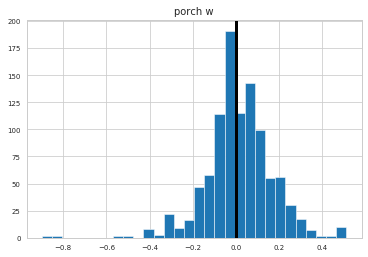

-0.1703341731392167


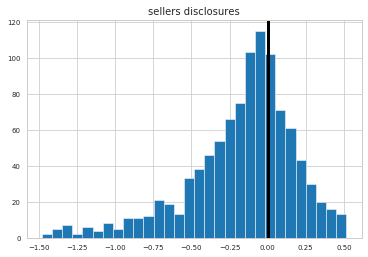

-0.19389941737052477


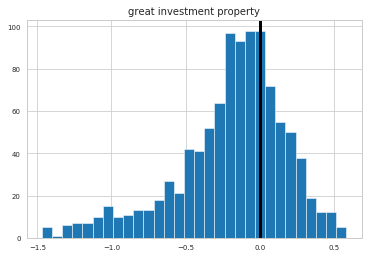

-0.009577684416644985


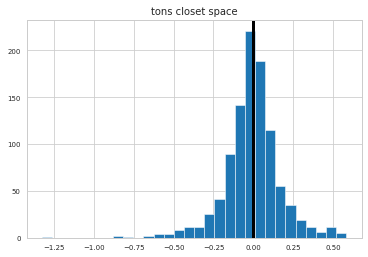

-0.04824747301636183


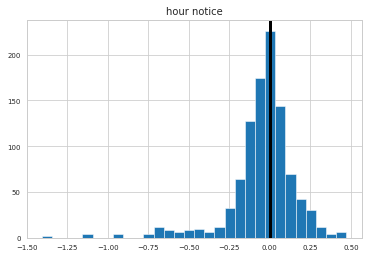

0.0030467698131332512


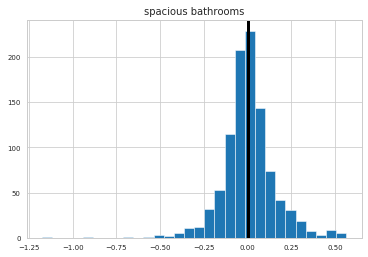

-0.020778748470626125


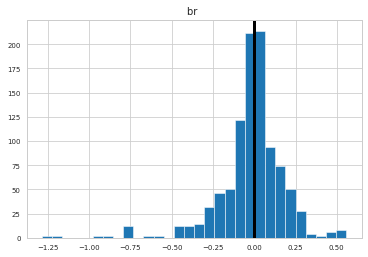

-0.05293355303175541


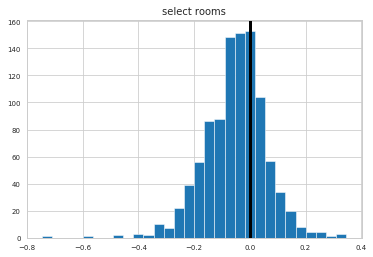

0.016199124733002404


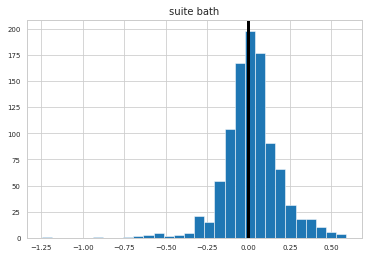

-0.00030822224948560853


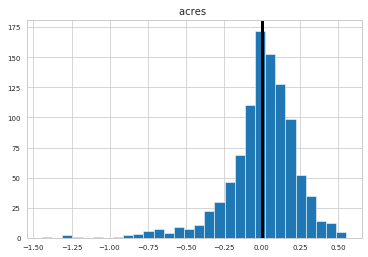

0.016365261491384002


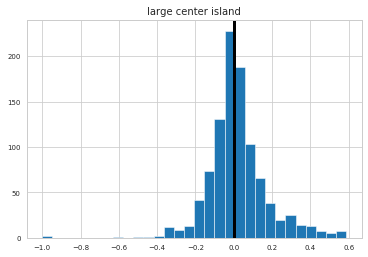

-0.014869251799301828


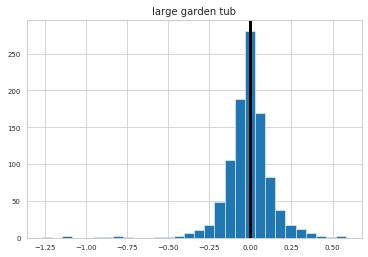

0.0028926160544322206


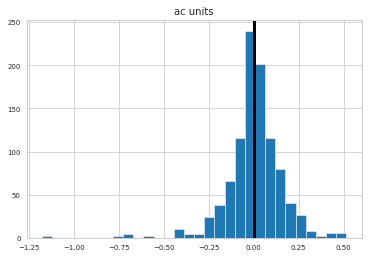

-0.0051866701844979594


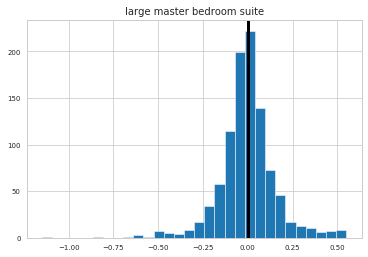

0.026348079264469467


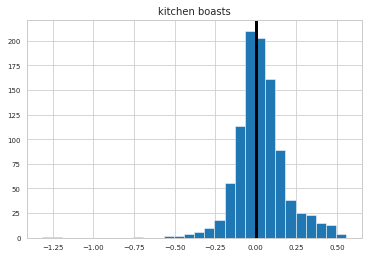

-0.0011973981399915283


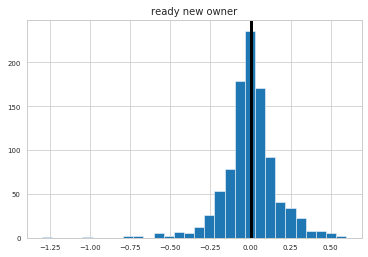

0.003379029522678916


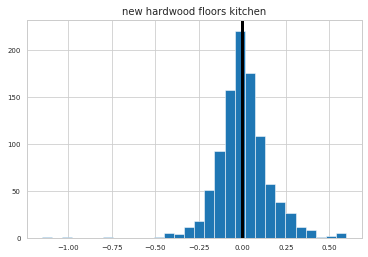

-0.013622279265053792


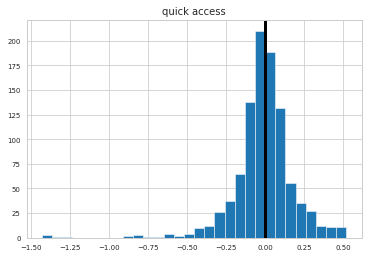

0.0051340216513107665


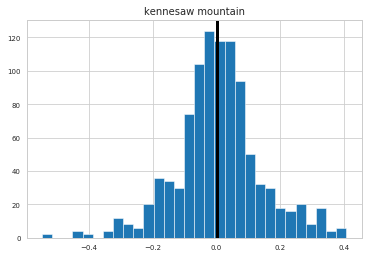

0.042356040882074814


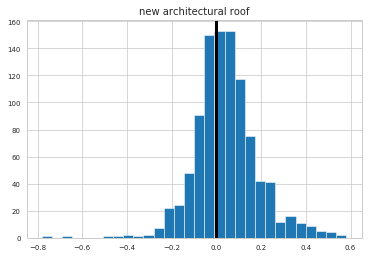

0.00895745447336467


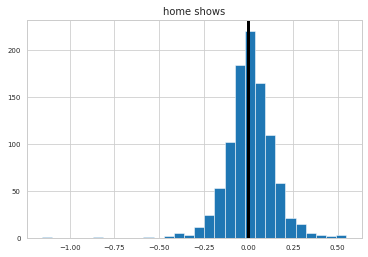

0.009367803804579149


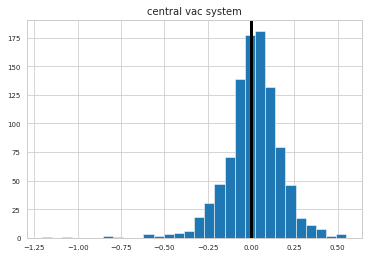

-0.010838790709958015


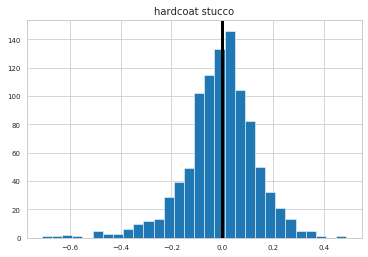

0.040031668489353064


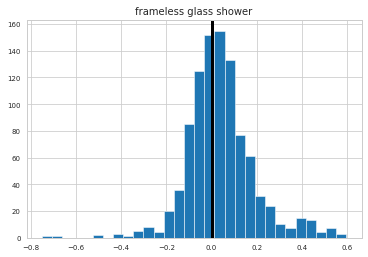

-0.027205961883659216


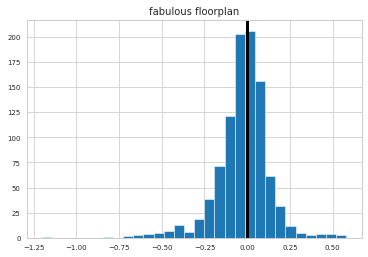

0.002893017947848707


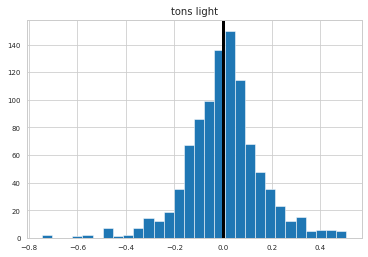

0.025555597009131244


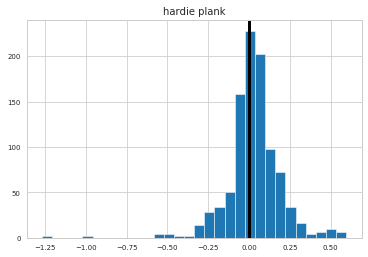

-0.0029123476627714866


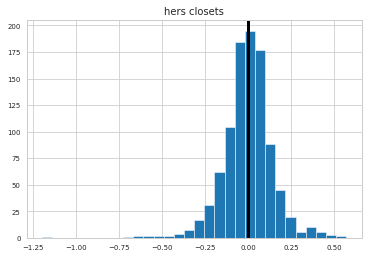

0.010029300531707754


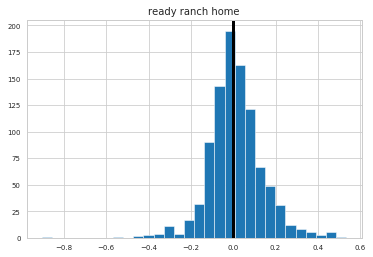

-0.012822836244926798


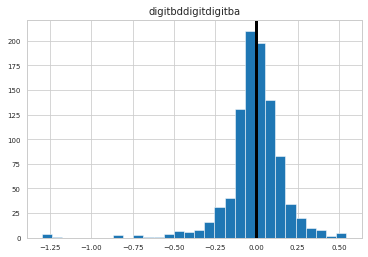

0.04056646952592859


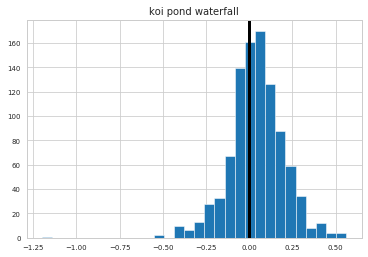

-0.004247889185704274


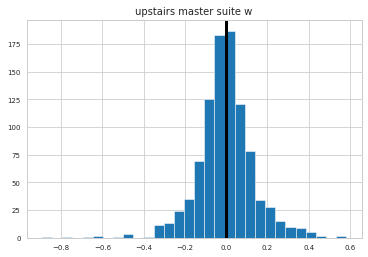

-0.019756034281074853


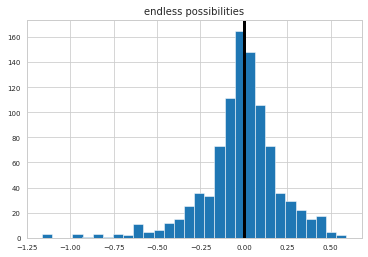

0.05322051077960774


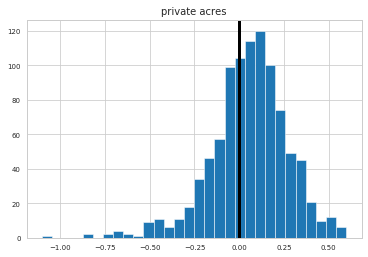

0.01518108904492889


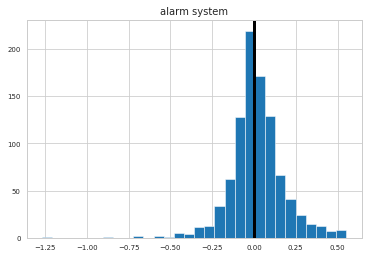

0.06559579208839751


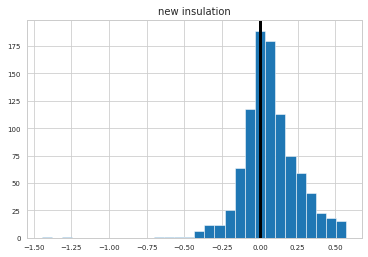

0.01652313673387862


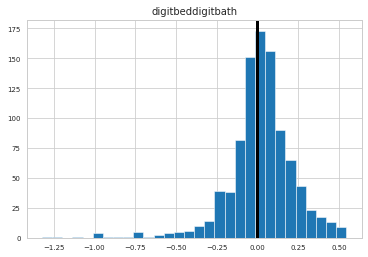

0.0037256152837468258


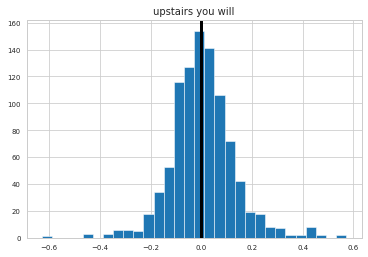

-0.011386737364912972


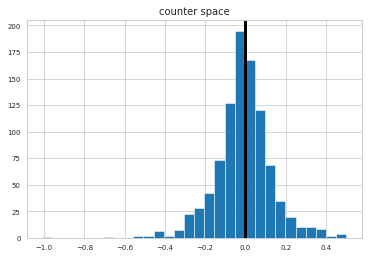

0.00376226057185866


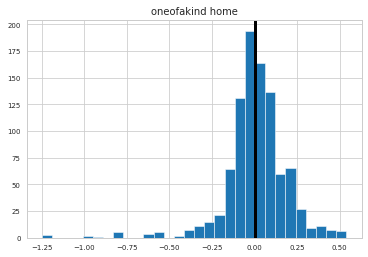

0.012014246037011497


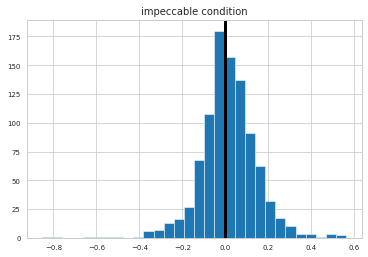

0.048983854230867874


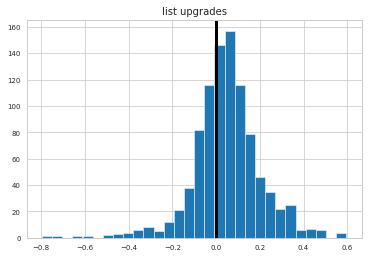

0.02470646771205321


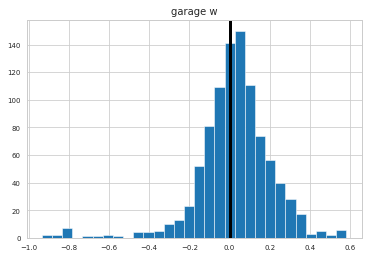

0.010906395863849406


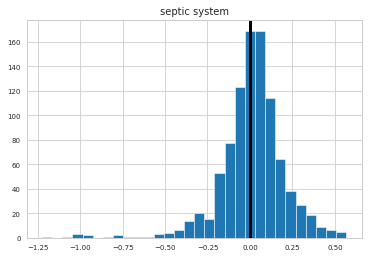

-0.007004216835219028


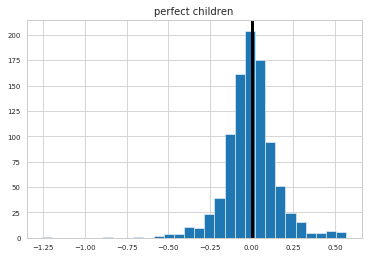

-0.033427206745666856


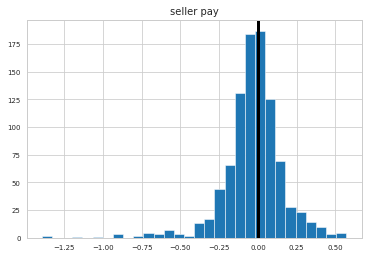

0.008292867274199455


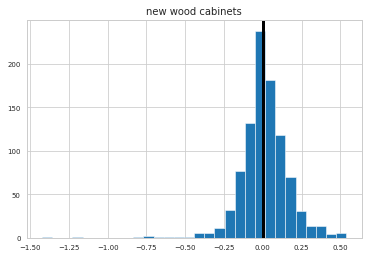

0.00175111669897072


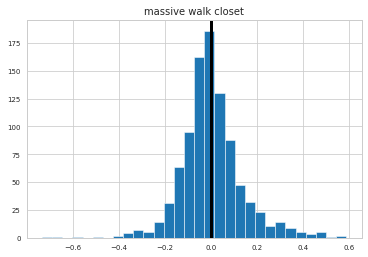

0.06614091481859055


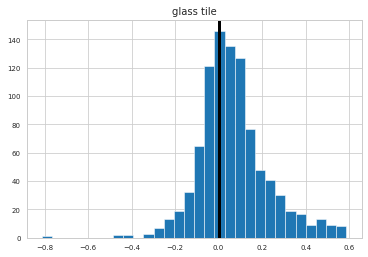

0.001208107781697341


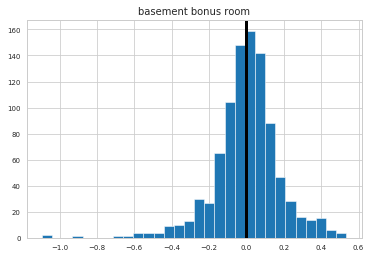

0.020842619099639508


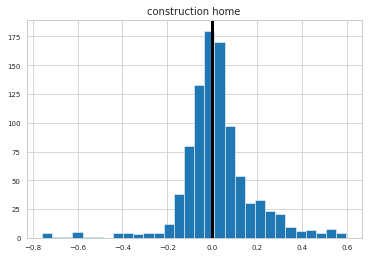

-0.09824979021344282


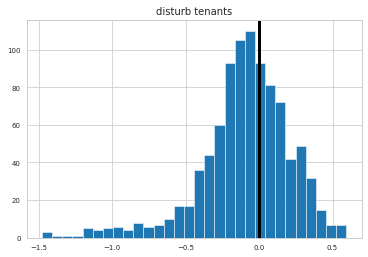

0.0013813633746367956


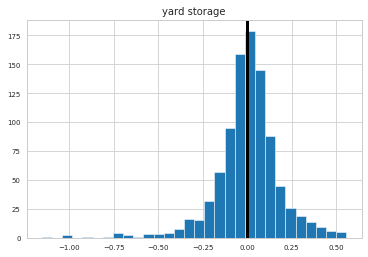

-0.019216521430846633


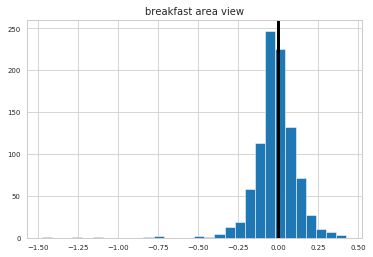

0.00332991768789877


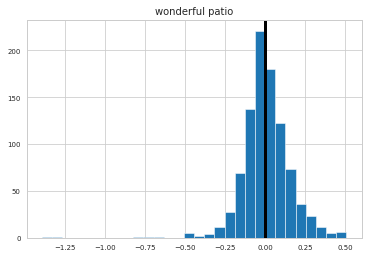

0.023960662513221095


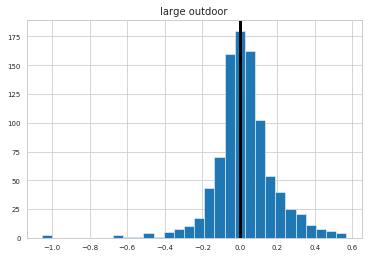

-0.009609919864146145


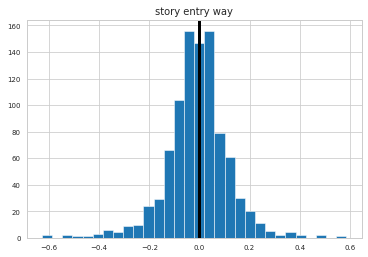

0.008498230744763377


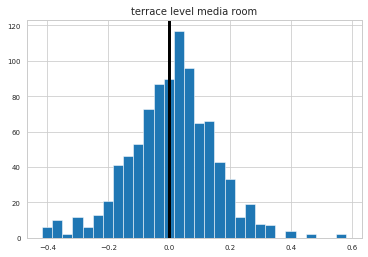

-0.01313556800270299


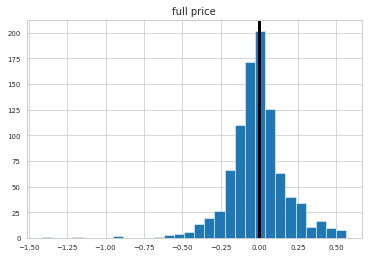

-0.020260821951996813


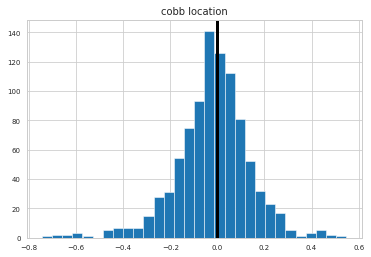

0.0164998655945825


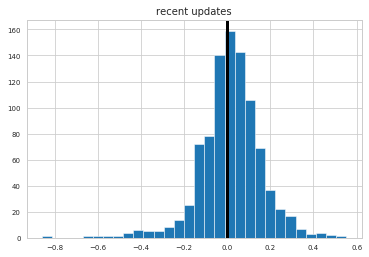

0.015677079831630567


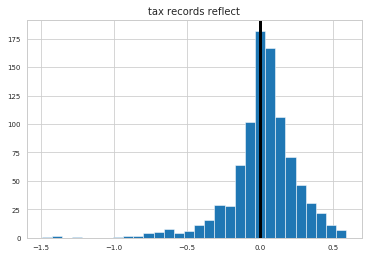

-0.026793233796729227


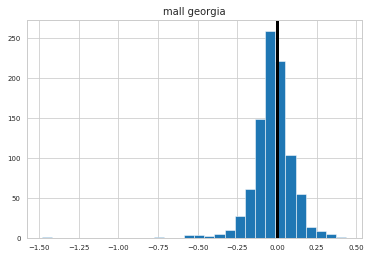

-0.014023883143140882


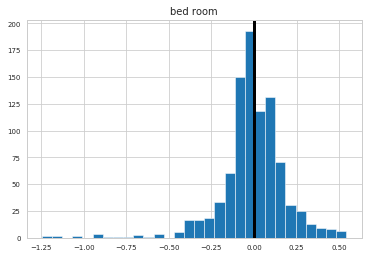

-0.010695310698905466


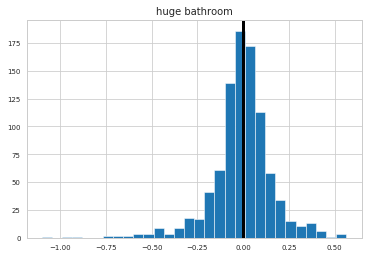

0.0023291857246649636


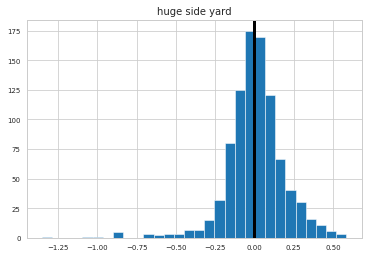

0.04889417188501046


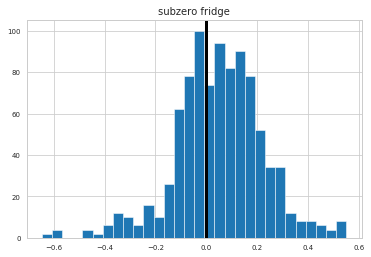

-0.008913098189258135


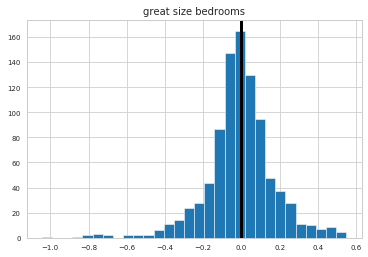

0.01461845523126669


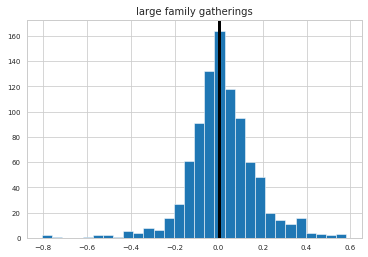

-0.05770659270759769


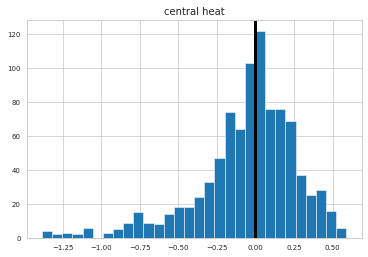

0.0025006748184502113


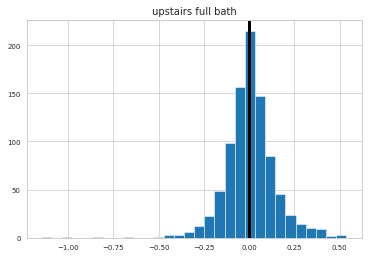

0.01501048495494959


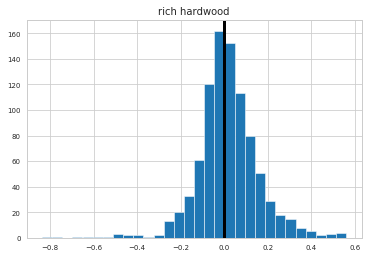

-0.01566633141884275


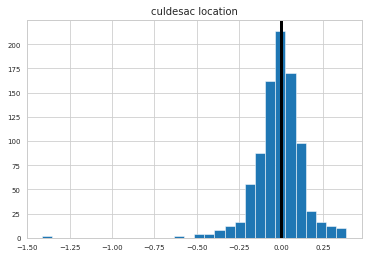

0.027722366471912147


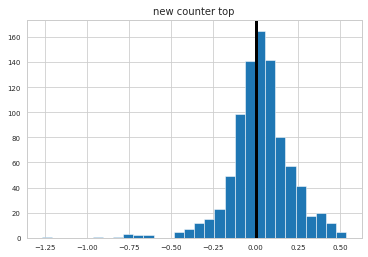

0.06254417787012186


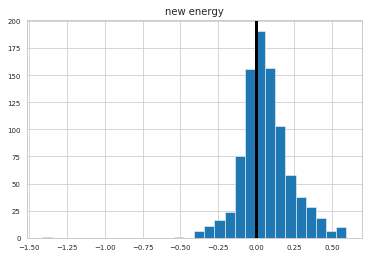

-0.009937910872048959


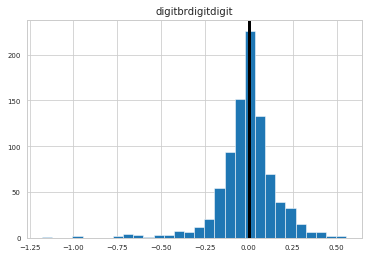

0.002869021535511106


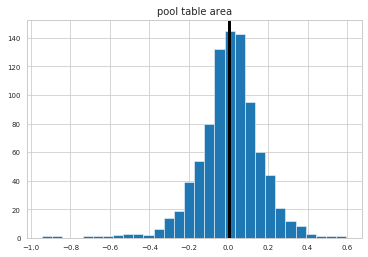

-0.010023547324392444


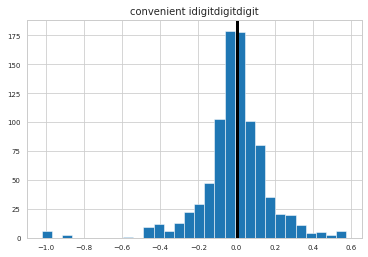

-0.014676624704661441


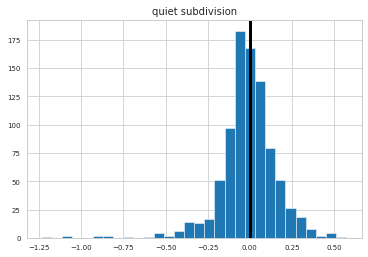

0.013027941818457466


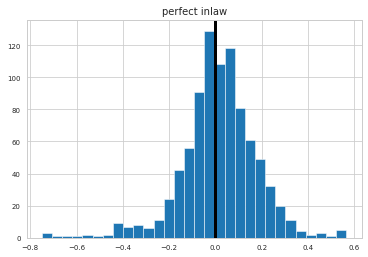

-0.005796103339740342


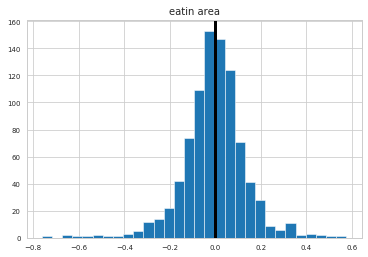

0.02885801332496224


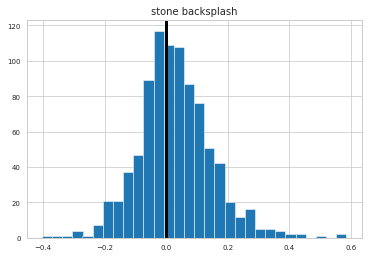

0.01230174961058384


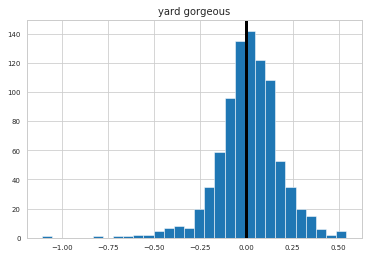

-0.022828623975825905


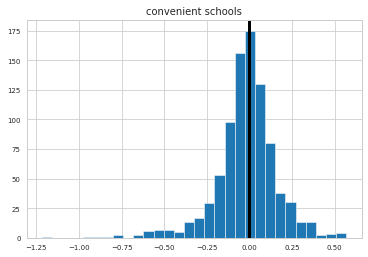

-0.0016160264383825748


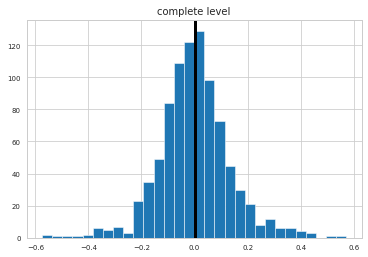

-0.003349336461839169


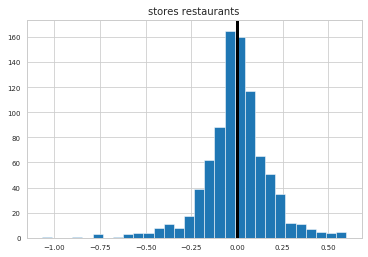

0.027171089047241727


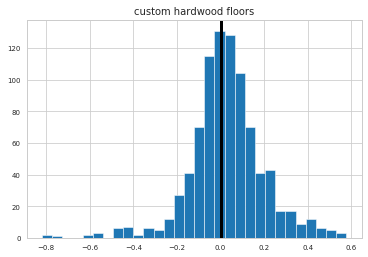

0.012043116939116982


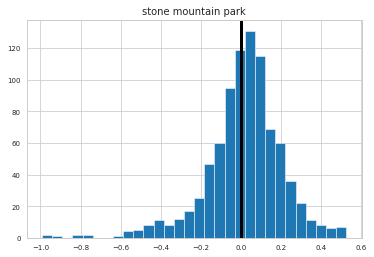

-0.016652217415414085


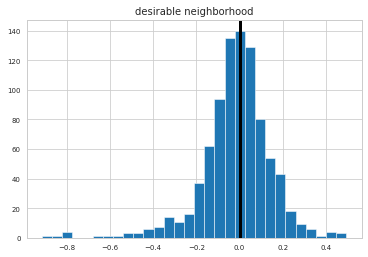

0.02851491021713061


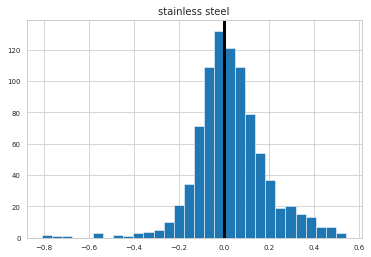

0.004201088443058331


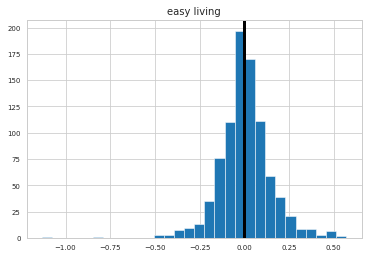

0.05610011906796424


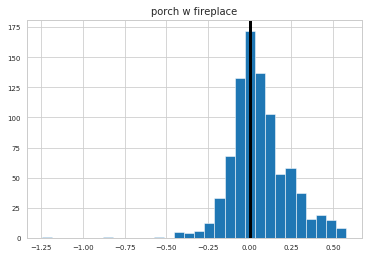

-0.012761957320349775


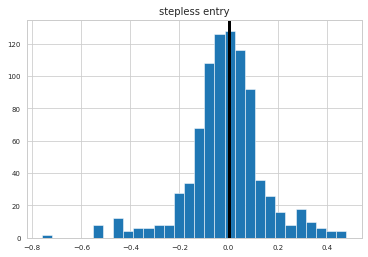

0.0718348443354774


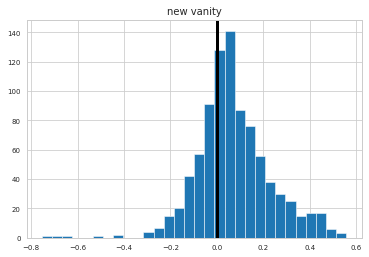

-0.0006159563807464839


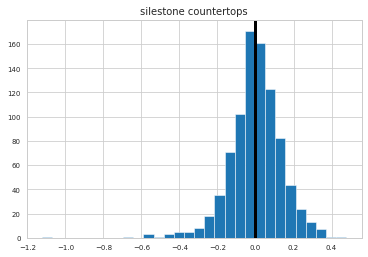

0.05923562637240032


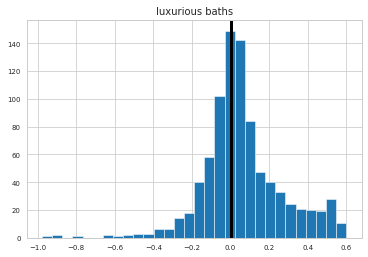

-0.003148196473884136


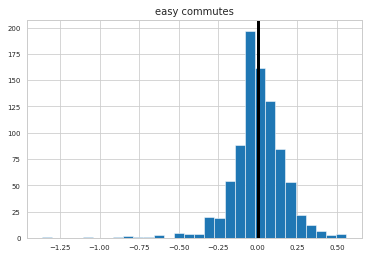

0.0005485118499334764


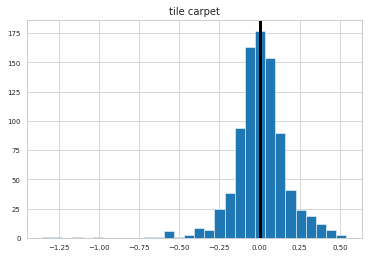

0.0007569857108684442


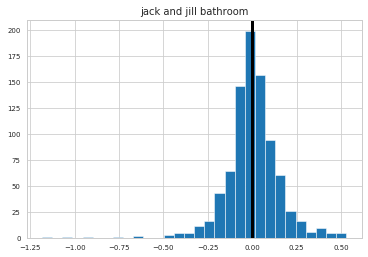

0.002887524045727886


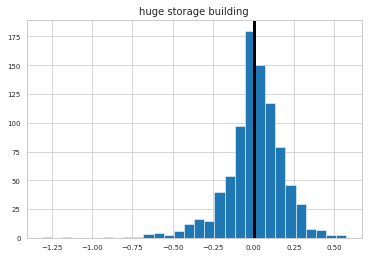

-0.013178115278943518


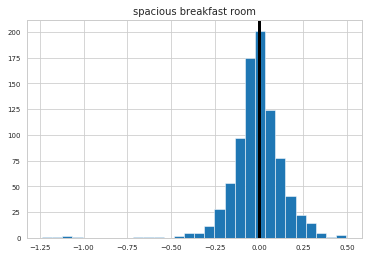

-0.018261374403311534


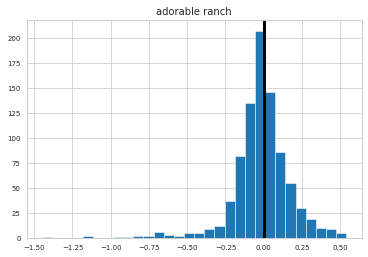

-0.004396898605775155


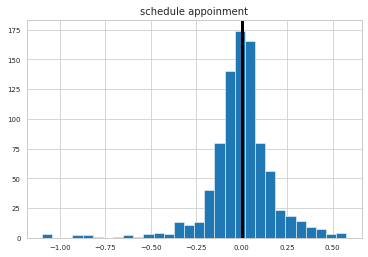

7.543262111514818e-05


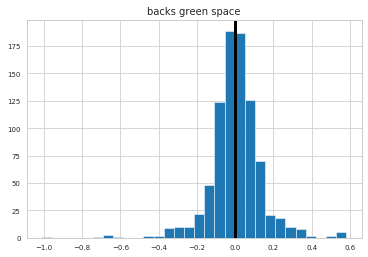

-0.0009439998706041523


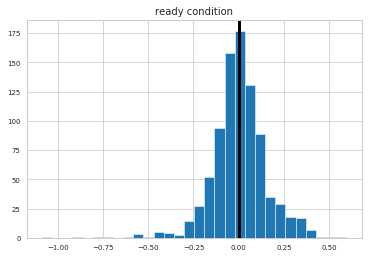

0.00013065152399957658


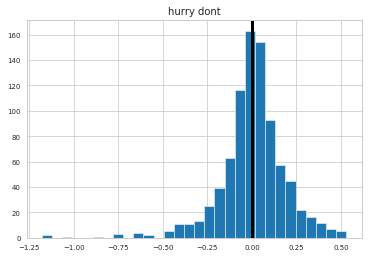

-0.02535191345412418


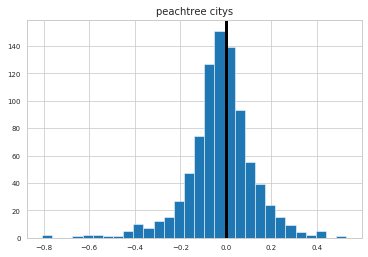

0.019804882266317464


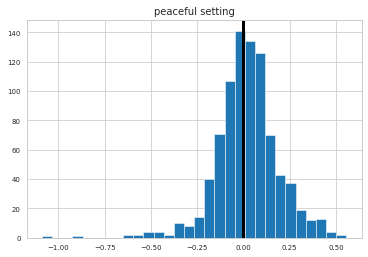

0.022697435457115868


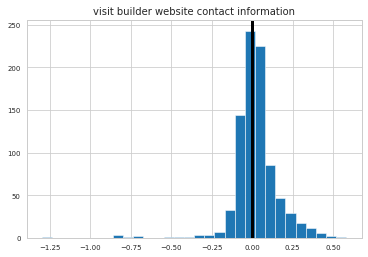

0.012008998167358525


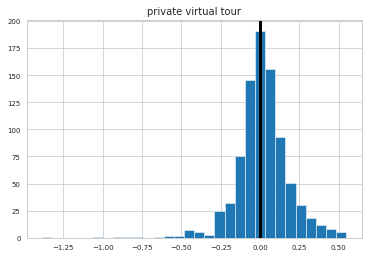

-0.01487711530636493


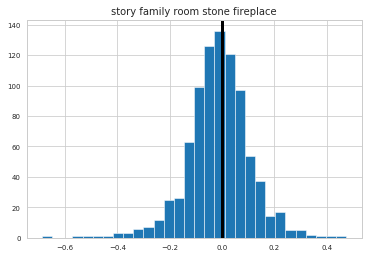

-0.020940820001390716


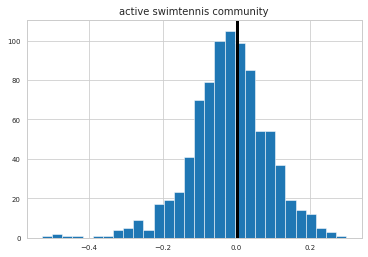

-0.018220121406940095


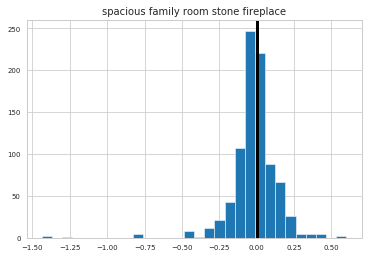

0.021106820038870388


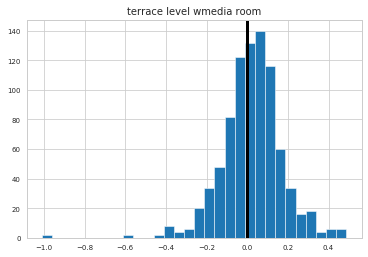

-0.007368123038792305


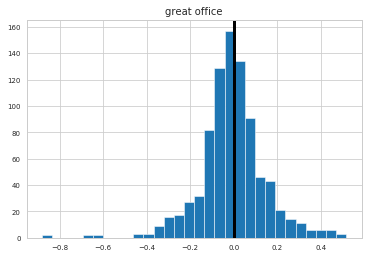

0.01104031640456885


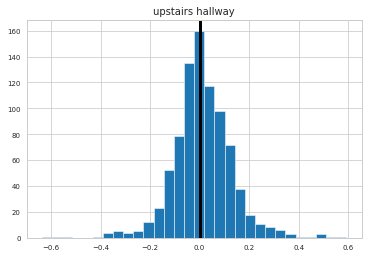

-0.0006538454156317775


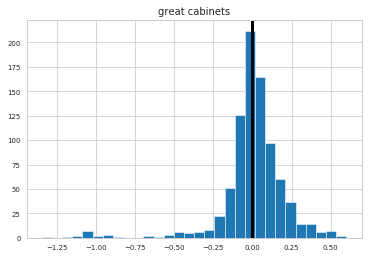

0.030087635950012046


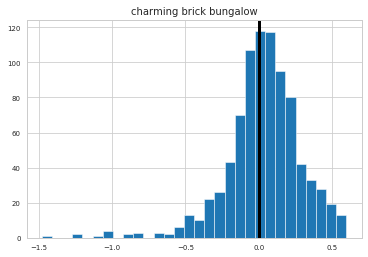

-0.12536436340797896


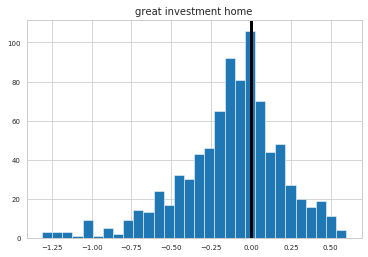

0.0031441140815143464


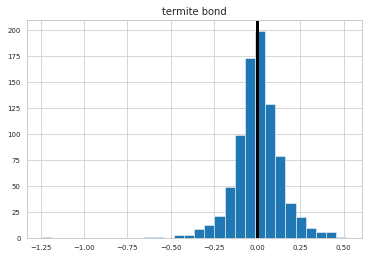

-0.019648141879034974


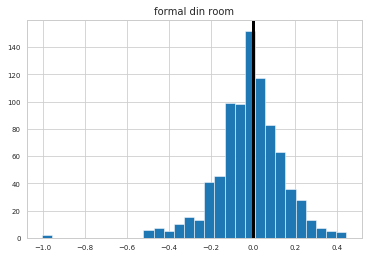

-0.010620065557514644


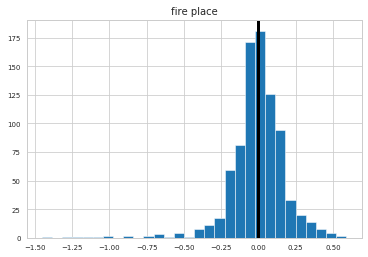

-0.013101312219065507


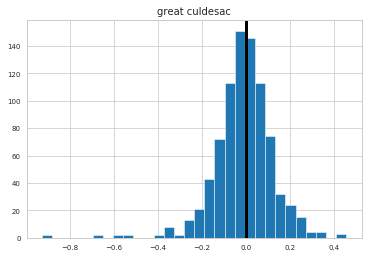

0.009123372556665248


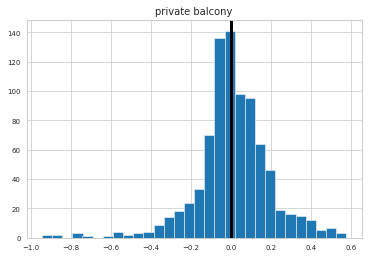

0.018548236710076226


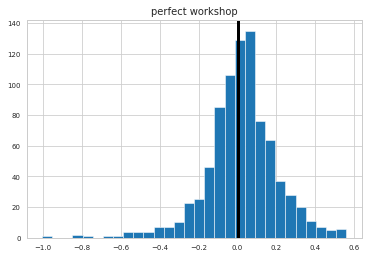

-0.008147028018891117


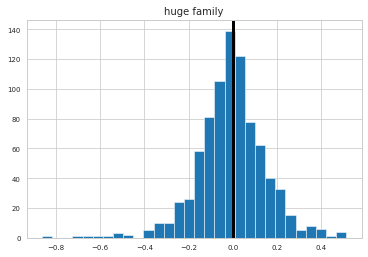

0.015551068520713947


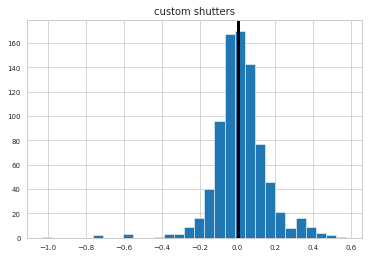

-0.034883138546356524


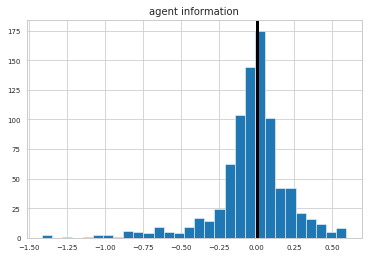

0.025774696097842477


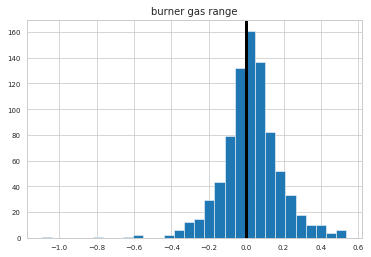

0.02991930871746434


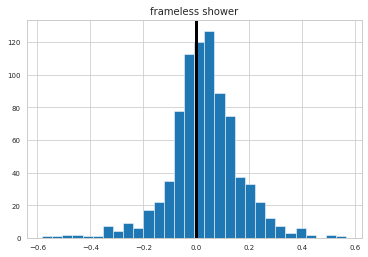

-0.006980674179058352


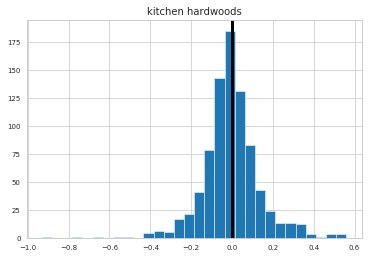

0.010088527270469659


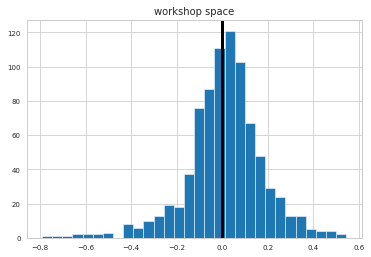

0.002921458934809736


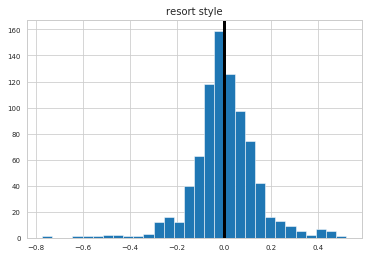

0.016140289307681802


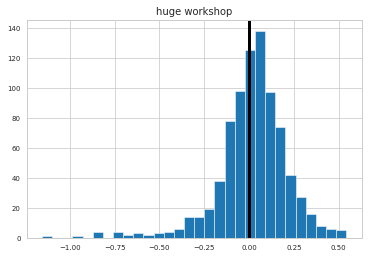

-0.020128030038624813


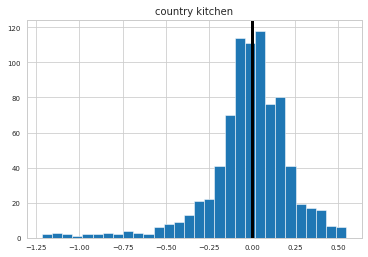

0.0028218057008025516


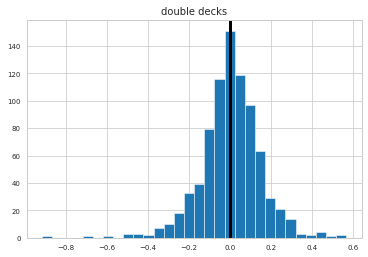

0.008316544661512734


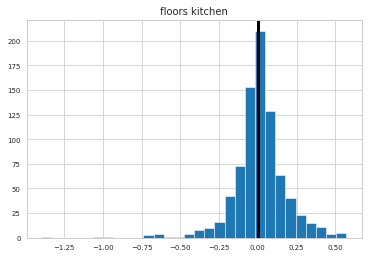

0.031364729379229656


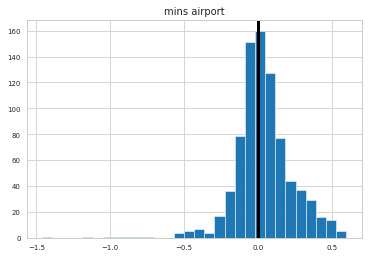

-0.00789108175835666


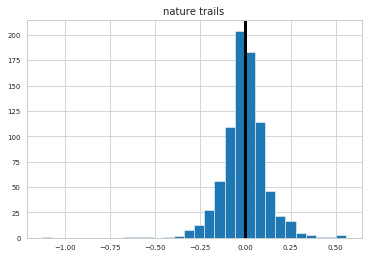

-0.022960871195679515


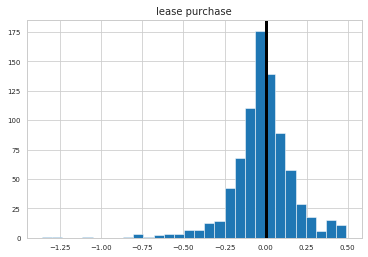

-0.006922213897027948


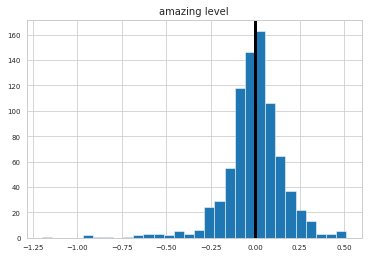

-0.005957427334836724


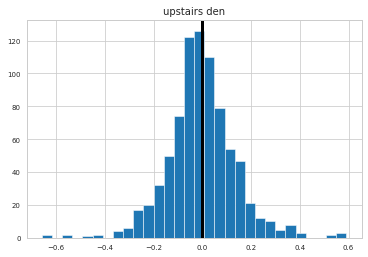

0.005477403933704678


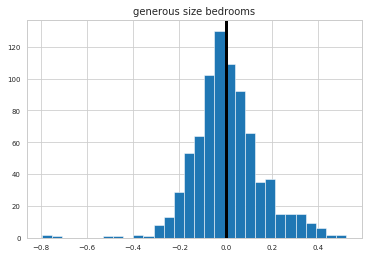

-0.0001914106227465777


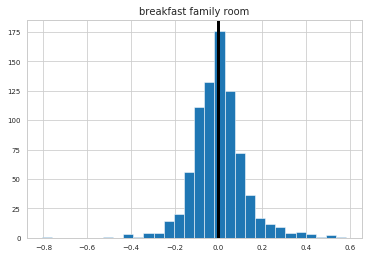

-0.005878687134739869


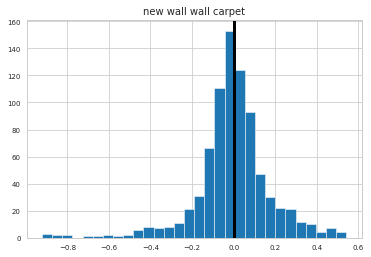

0.0052114303605393965


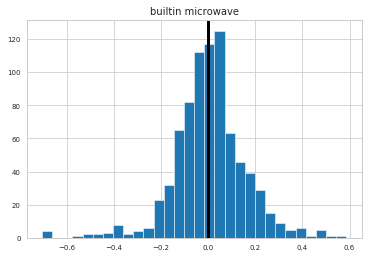

0.024932586299192608


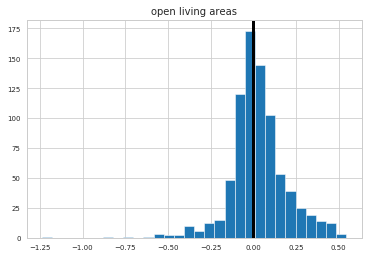

0.00224637584839834


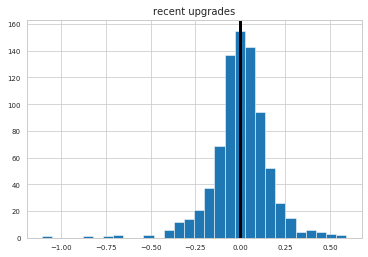

-0.0035244199772492013


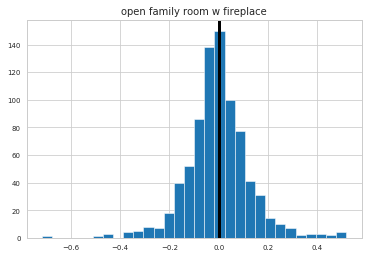

-0.024893373025219878


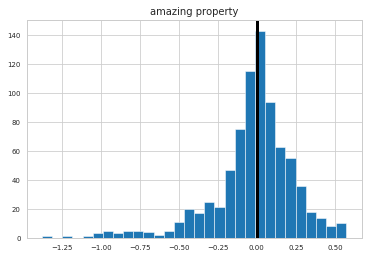

0.012281124642092845


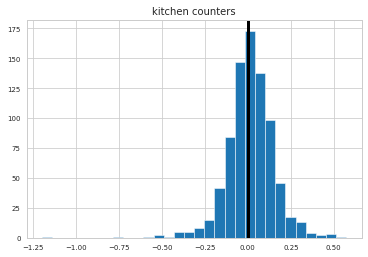

0.004333591139727916


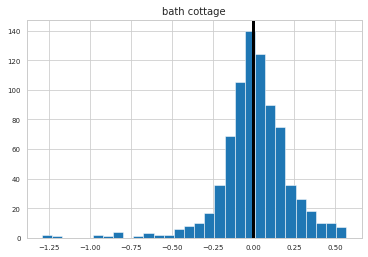

0.010330685519225051


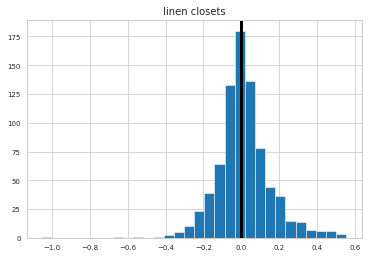

-0.0016150800480007142


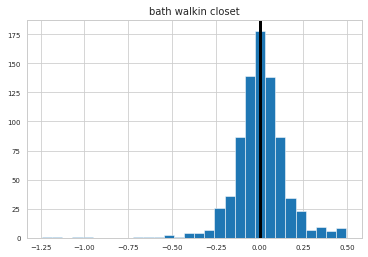

0.0054562632688087975


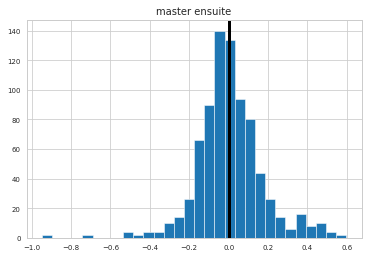

-0.1521763761950612


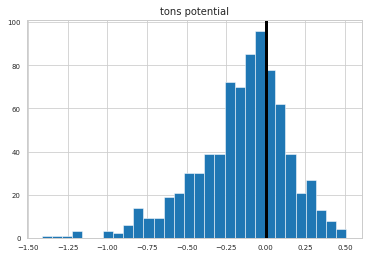

0.015209296391087306


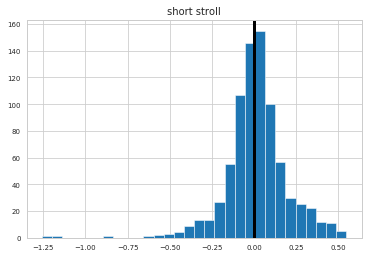

-0.001970725557525312


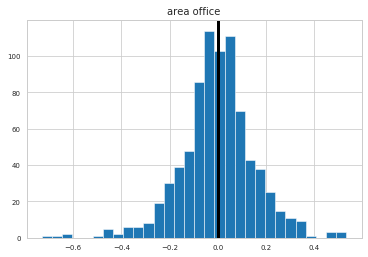

-0.06070230676053368


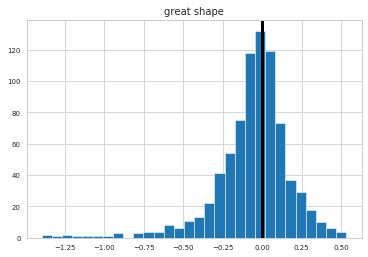

0.04224139040028157


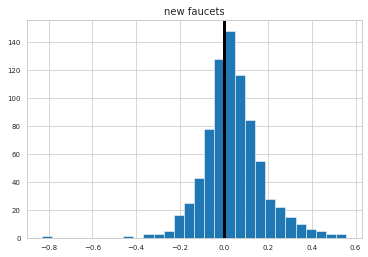

-0.007269282658889114


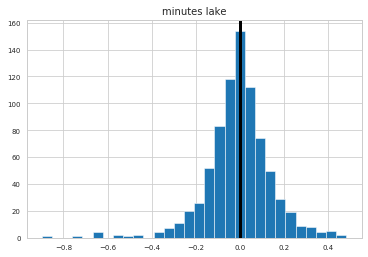

0.06757051861298224


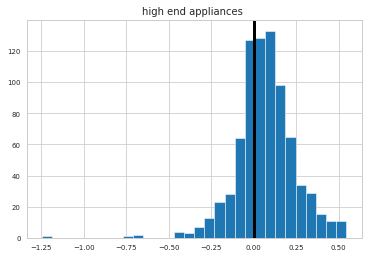

0.04358568619044485


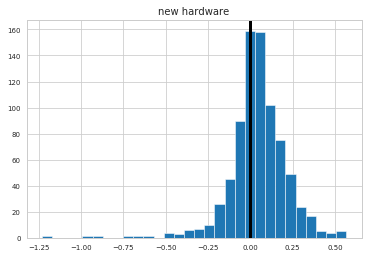

0.007133532039481674


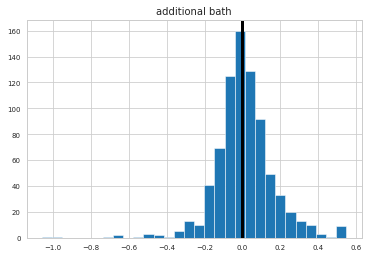

0.023148114448610948


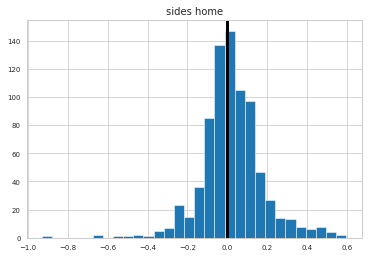

0.0009740938586738769


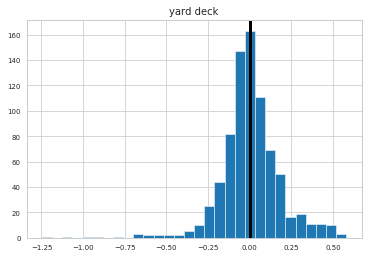

0.04206382858236818


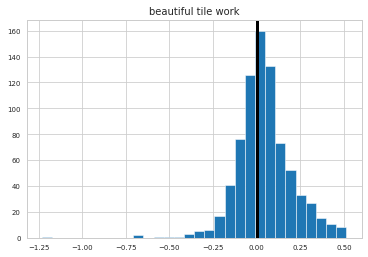

0.006372392713404507


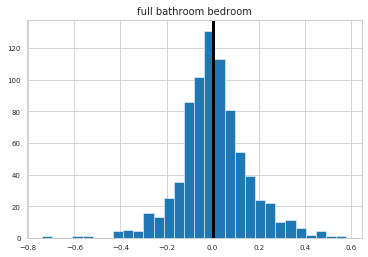

0.007729578939657072


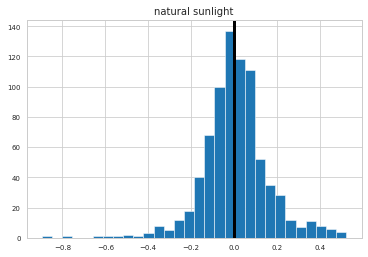

-0.01241757948327123


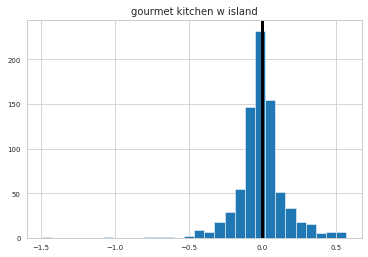

0.012704126076392852


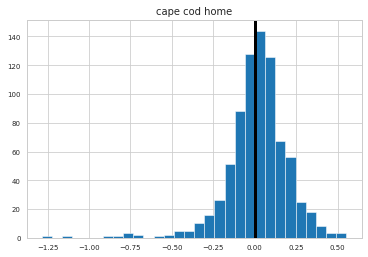

0.03802093657836124


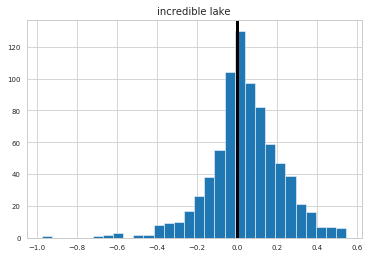

-0.00011393149970613411


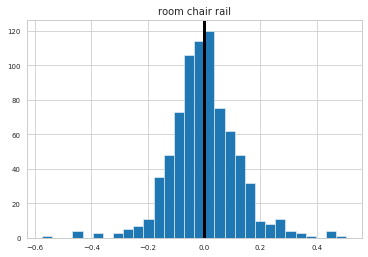

-0.005064981986322637


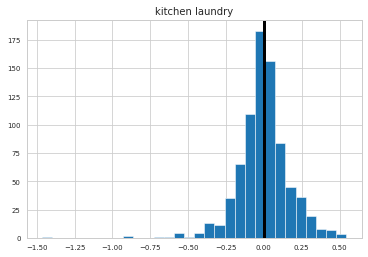

-0.00777409716398107


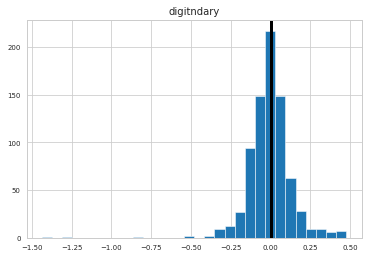

0.014699411046436746


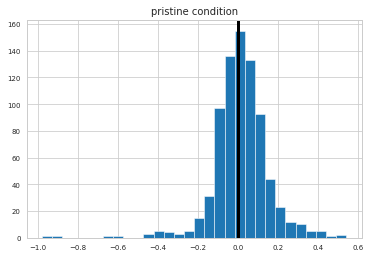

0.03135792940462827


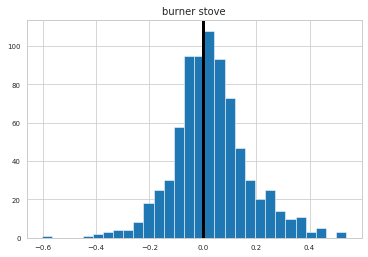

0.013303584151794026


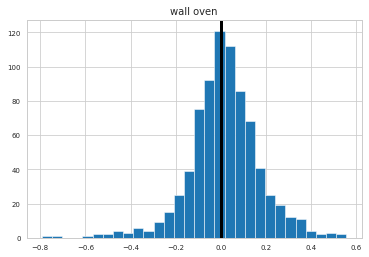

-0.01045020735135922


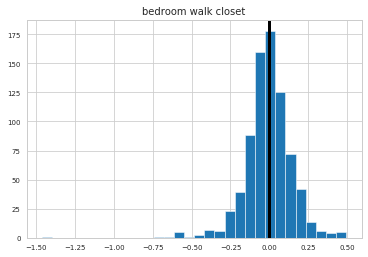

0.0032338361757760625


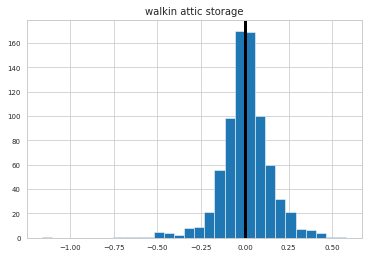

0.004268757422852608


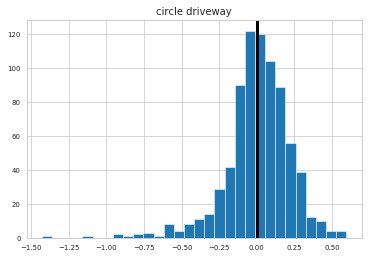

-0.009585901906713733


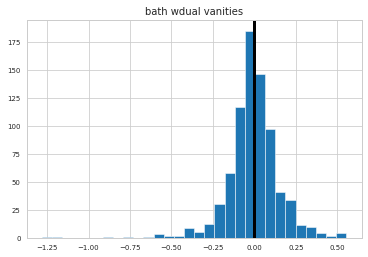

-0.0058932683562855585


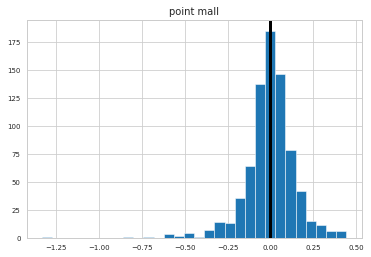

0.01870622656806569


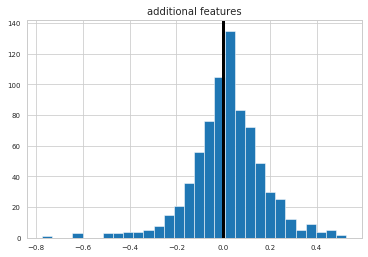

0.0020065182893406384


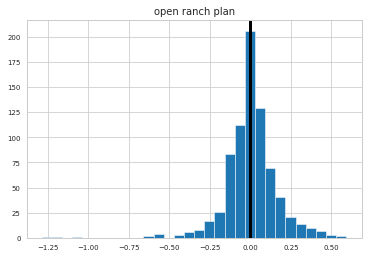

-0.023718594695136472


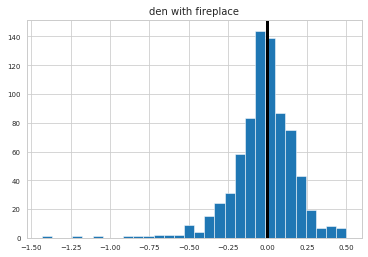

0.0008976410477935532


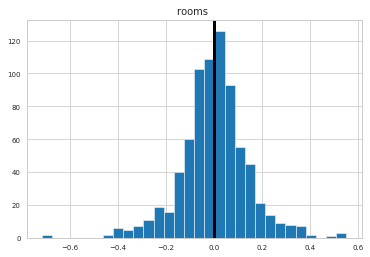

0.02737878011386376


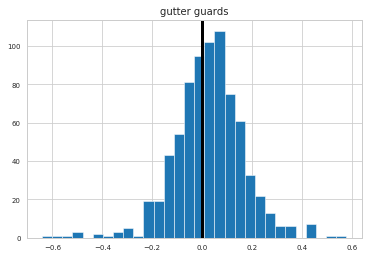

-0.15927906170965664


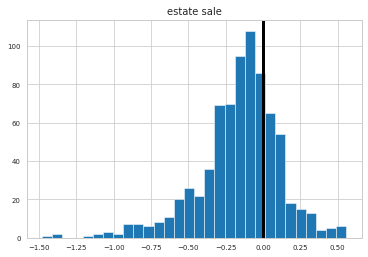

0.008695633276483134


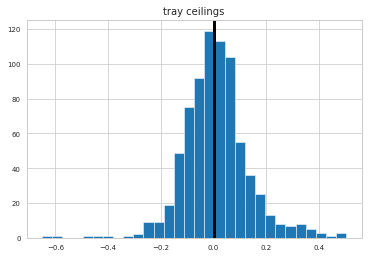

-0.00935478920851996


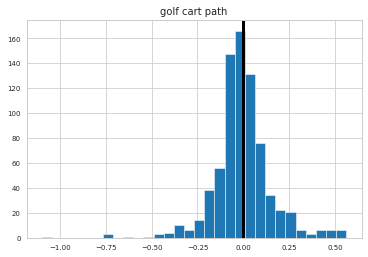

0.008387013012478123


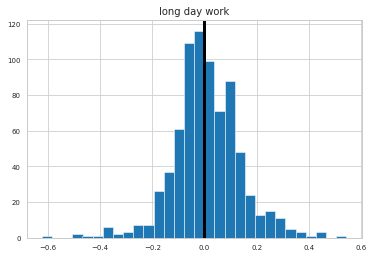

0.02284666056820225


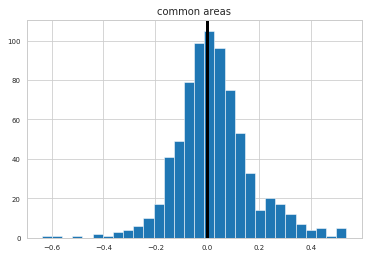

-0.009762560194304522


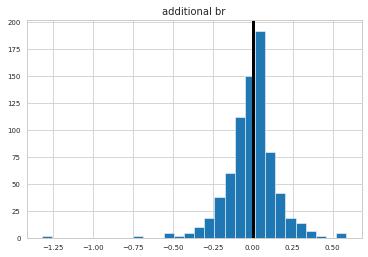

-0.0199703948190396


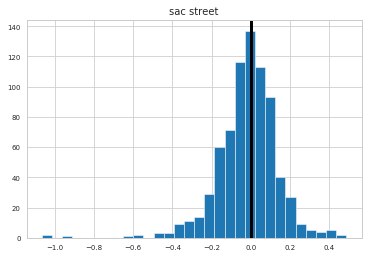

-0.01487369132692063


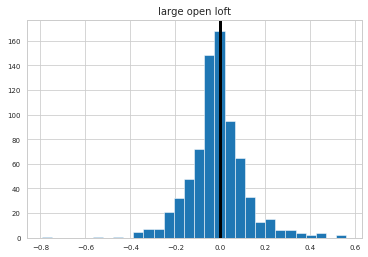

-0.00883853936279822


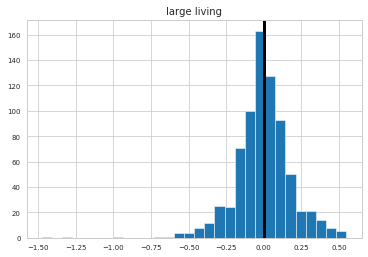

-0.01275851347439198


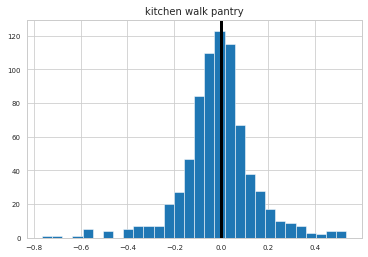

0.013027792562822996


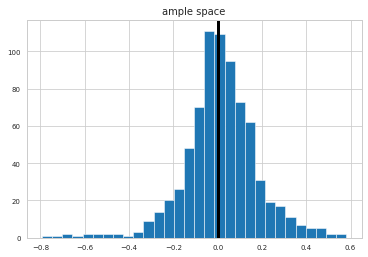

0.013925240519154492


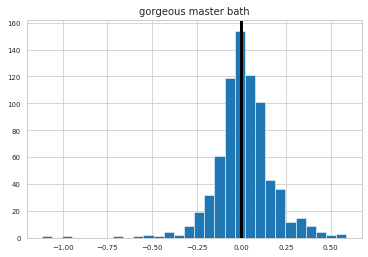

-0.01162828047438348


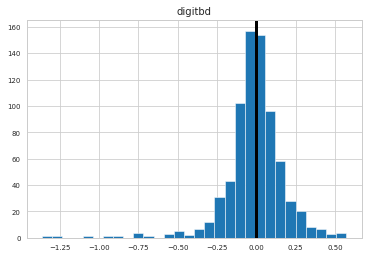

0.06583296816644334


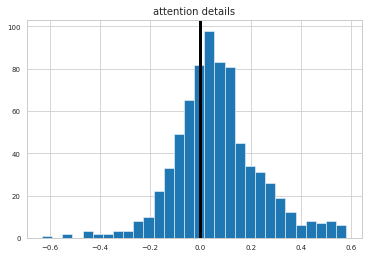

-0.0052937578197954785


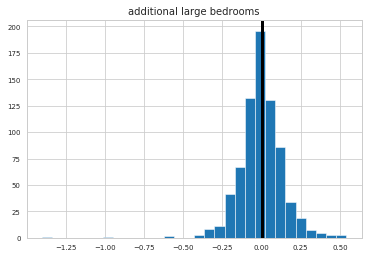

0.020166990804224325


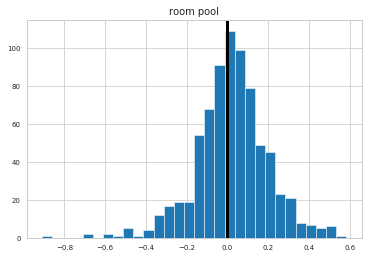

-0.005632273587791505


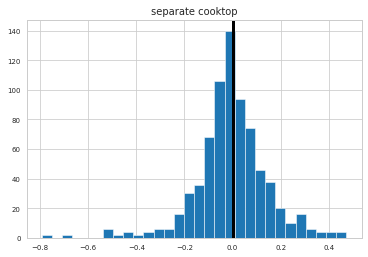

-0.0006870567038100925


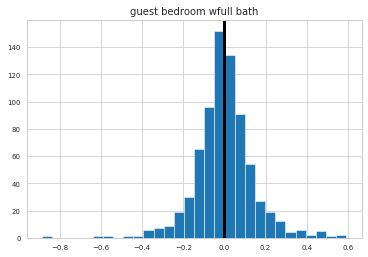

0.016131040443769826


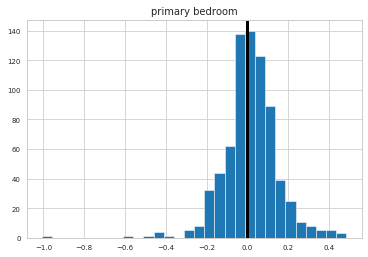

0.002735707789864485


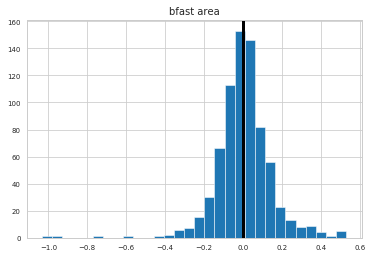

-0.007290038874635442


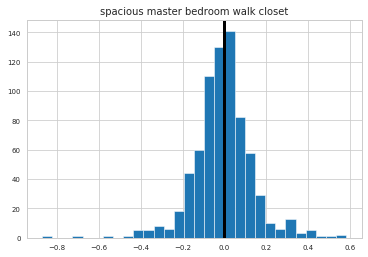

-0.012994252972963881


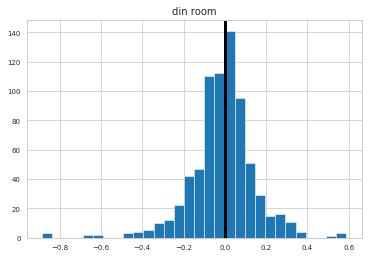

-0.007155375418900384


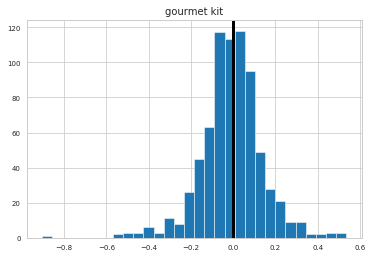

-0.016174360122499863


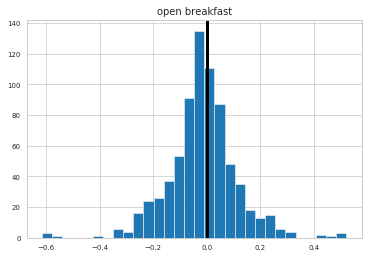

0.0077523809431681015


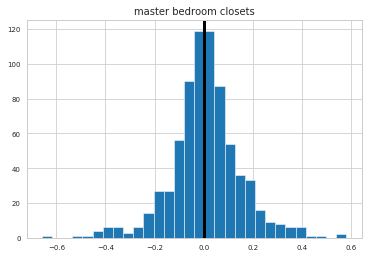

-0.017815515398933515


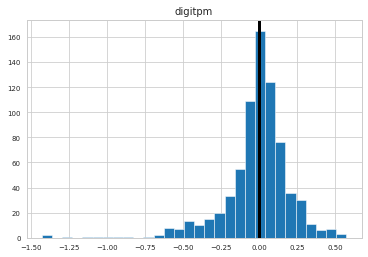

-0.15525976636980807


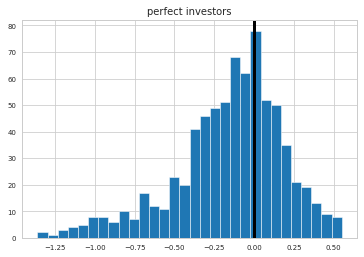

-0.005431999470927335


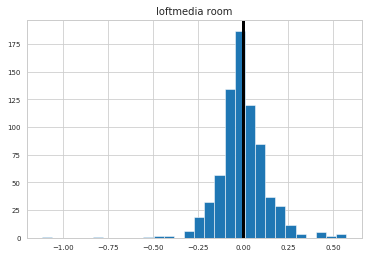

0.0961266888872623


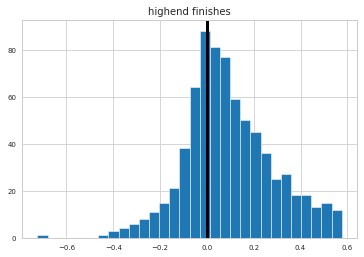

0.006844211340454055


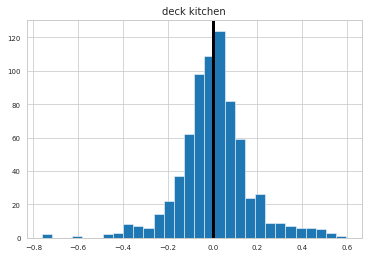

0.008488170434004351


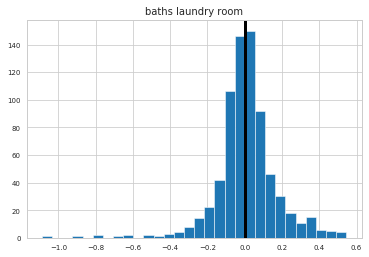

-0.008183066500260709


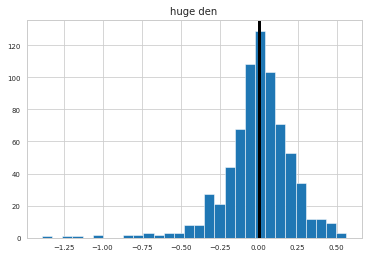

-0.008875704554470157


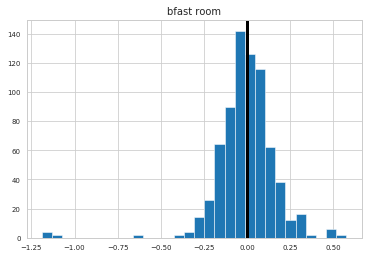

-0.009500214700346283


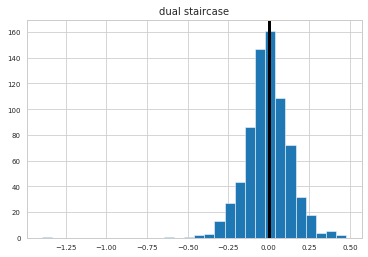

0.009207875188345874


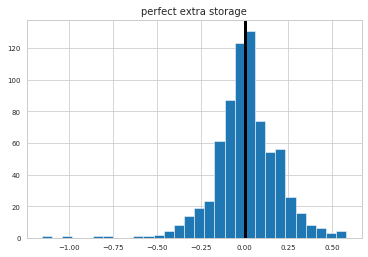

-0.01068448224903451


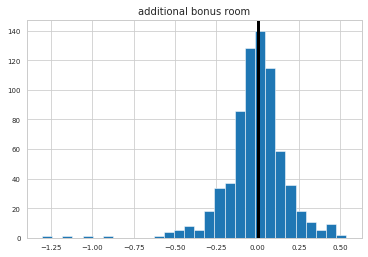

-0.05359582830349912


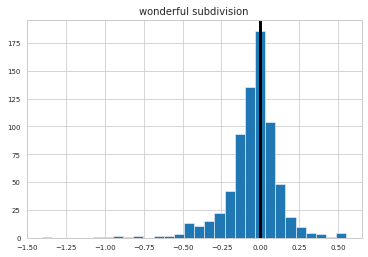

-0.002758184456576401


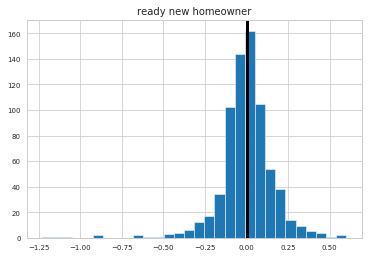

0.01714741432583885


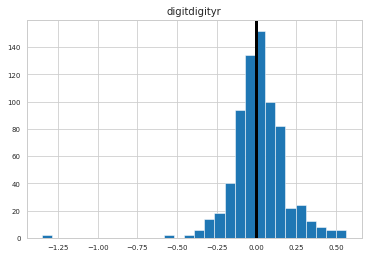

0.014911795058785917


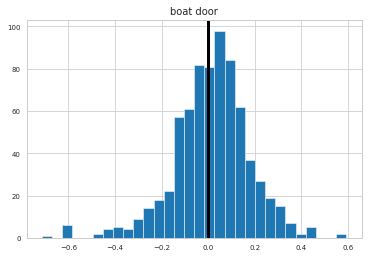

0.020522333849879205


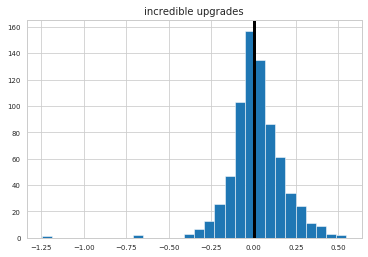

0.00444391810662645


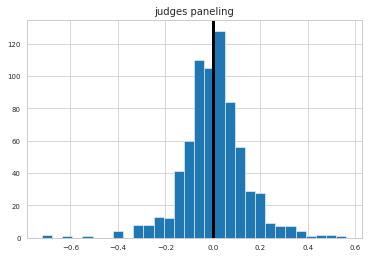

0.017426716914200037


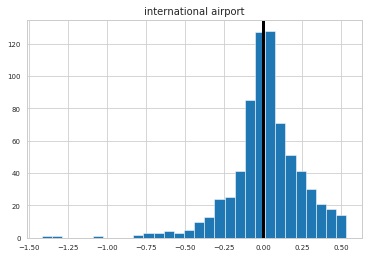

-0.021670909089648083


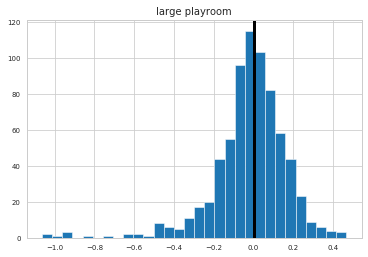

0.01619047710653119


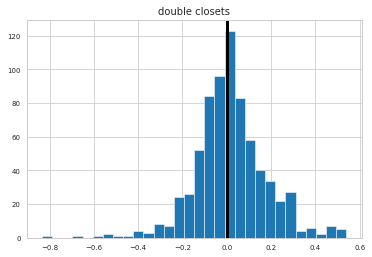

-0.0060367120208801445


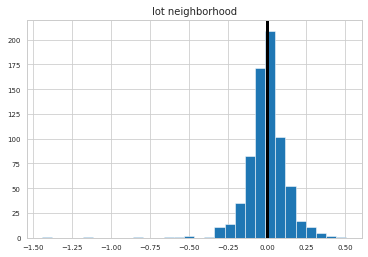

0.00023856075670847552


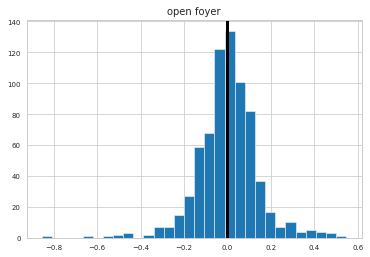

0.07397976068827994


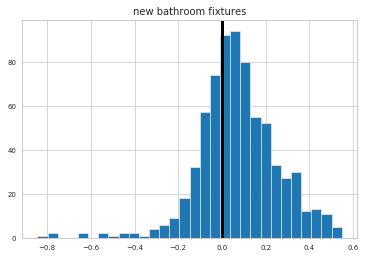

0.019000417789500214


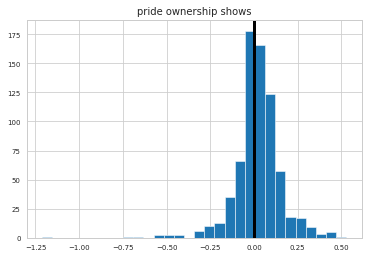

-0.009775950837338208


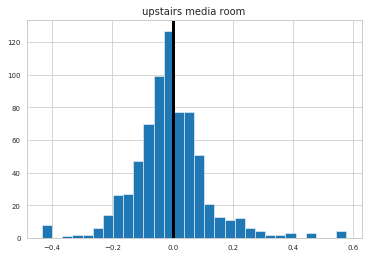

-0.005933004788475948


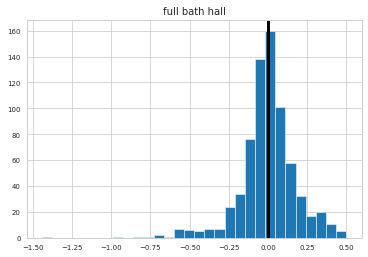

-0.002516205450261609


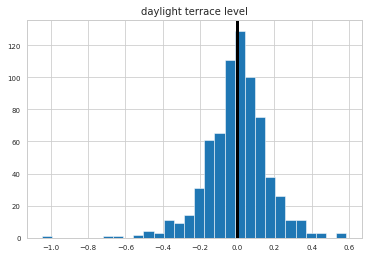

0.04046848805254113


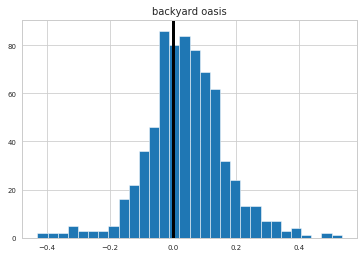

-0.02130789095452566


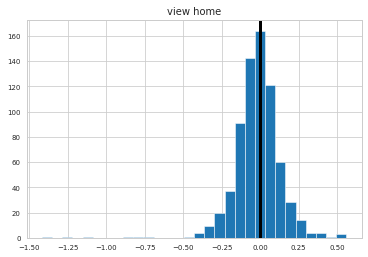

-0.0009255132125940871


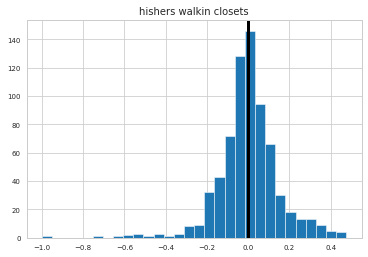

0.009427427032244792


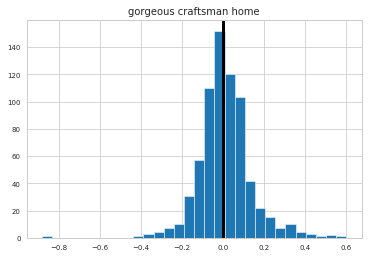

-0.007609067184845354


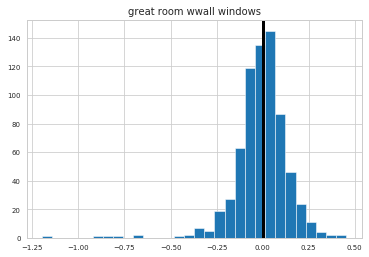

0.02427534095246624


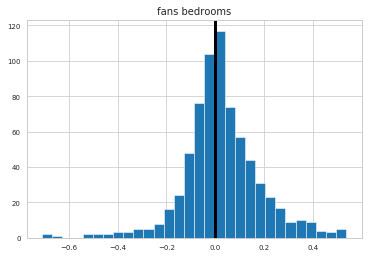

0.006699227891158461


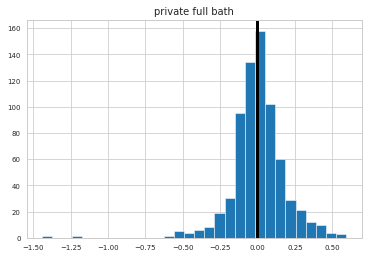

-0.10258616531208735


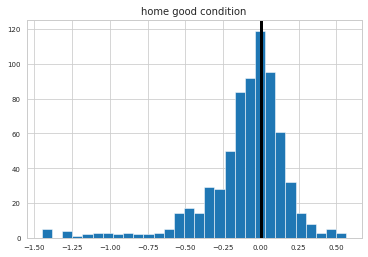

0.035266305107020356


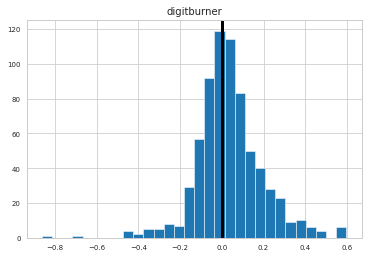

0.00315590675273955


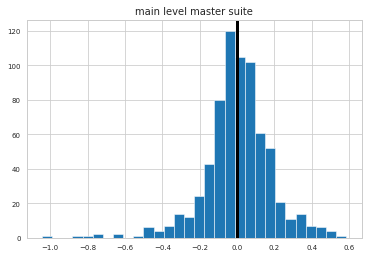

-0.007992676308499995


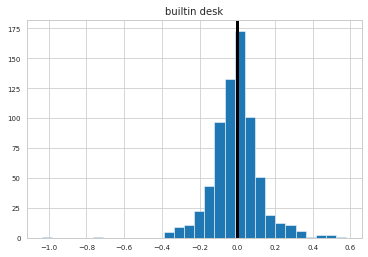

0.07144237071935783


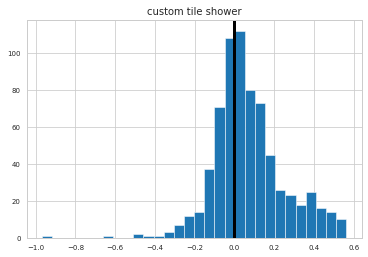

0.003413448454110948


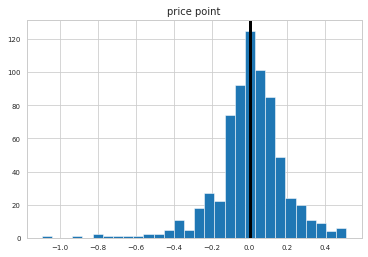

0.009584561218700997


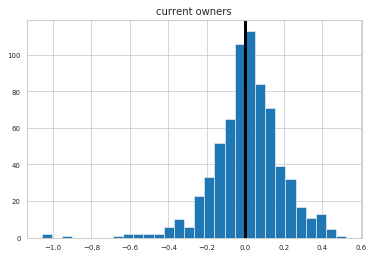

0.008307009541246467


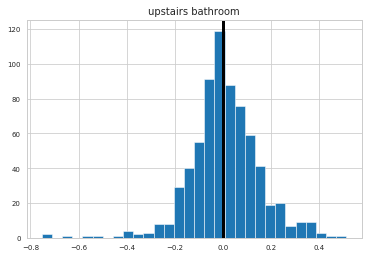

-0.00338285792912558


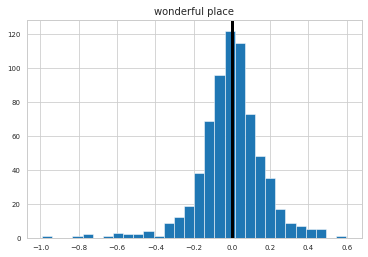

-0.012991020455778884


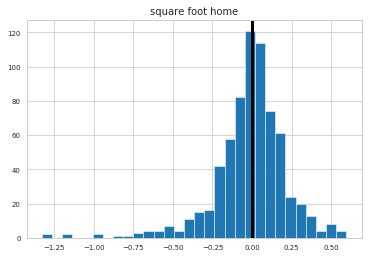

0.07255708082945228


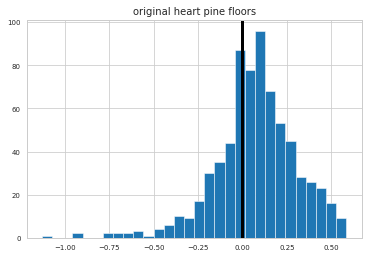

-0.005260334352264314


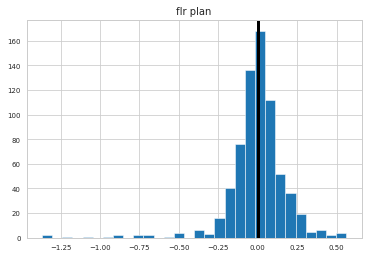

0.004568930211937384


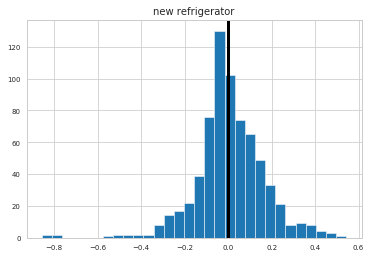

0.05694128923847359


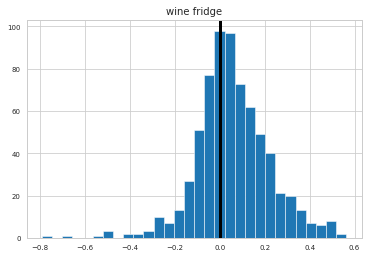

0.09047332128029423


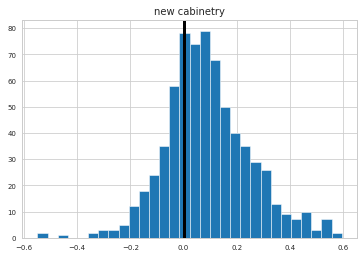

-0.006340500308564362


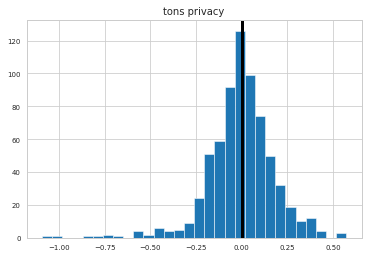

-0.005727360443903872


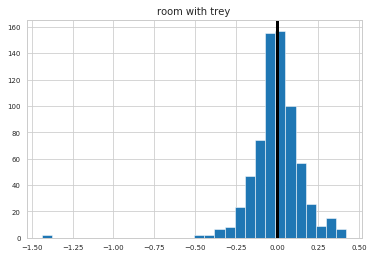

-0.24880348934578464


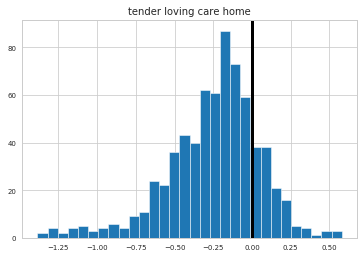

-0.0038596599699554134


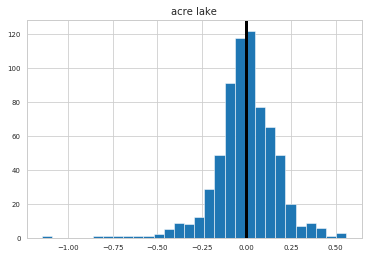

-0.025550805652479625


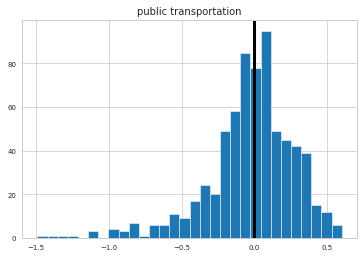

-0.005969552385465328


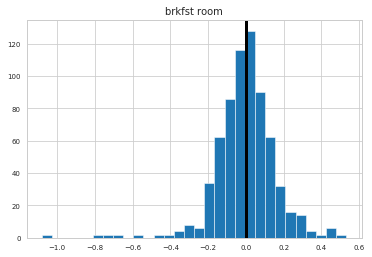

-0.005415768322769593


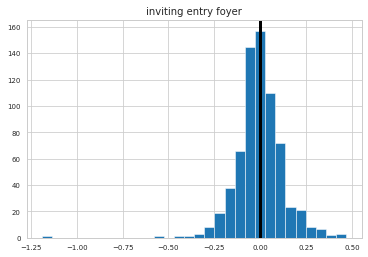

-0.008618606548896793


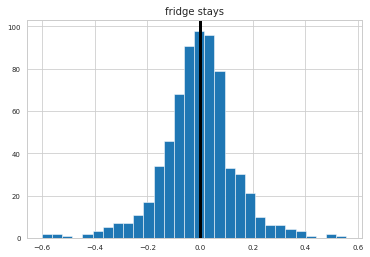

-0.013902676089064694


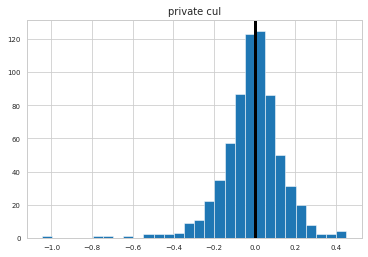

-0.01179631485293931


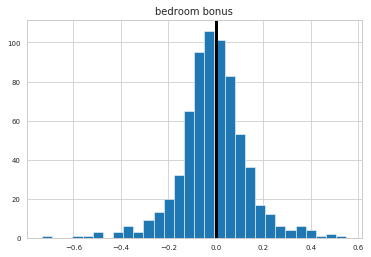

-0.15888396366447918


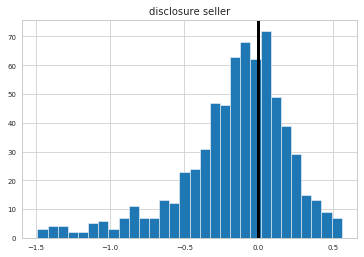

0.0033449956624575813


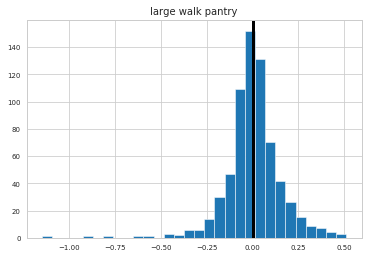

0.004739318005461021


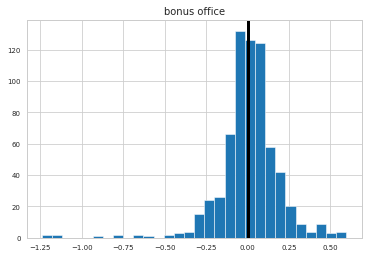

0.01750494040858288


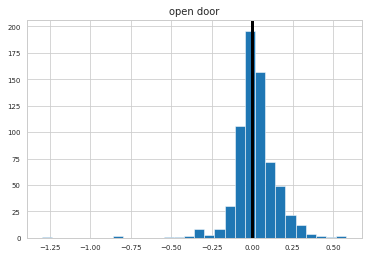

0.032002072562151235


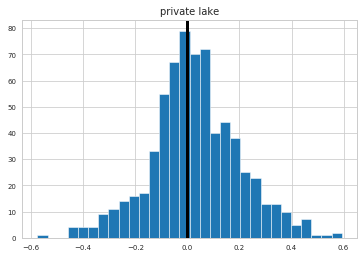

0.035763062284161574


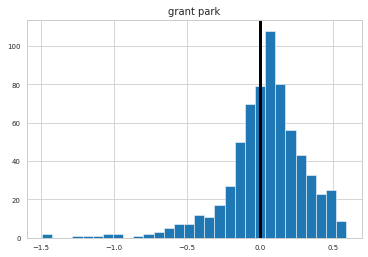

-0.05206263229859344


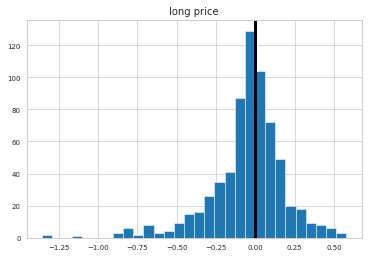

0.032594221413477474


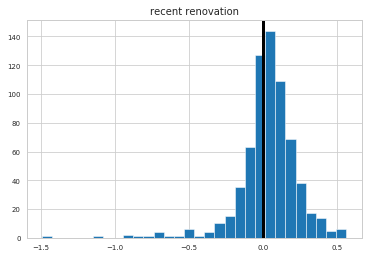

-0.005033250983646039


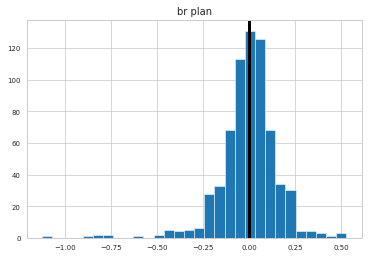

-0.0038535058308523085


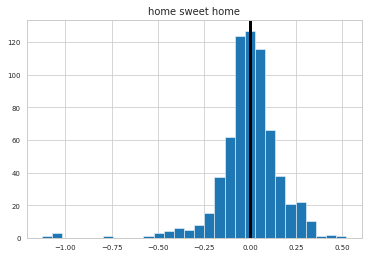

-0.006005496118262572


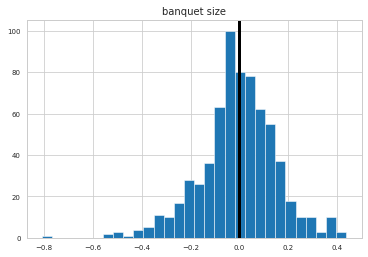

-0.00322431948937032


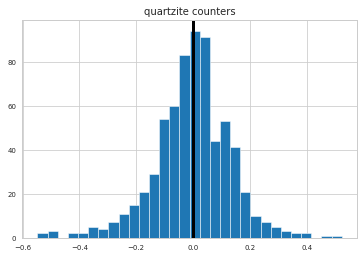

0.023457212246958393


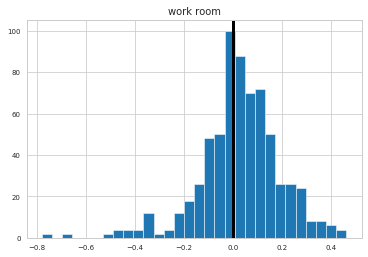

0.03799989856598759


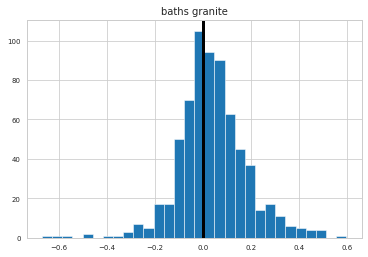

0.006964683778385621


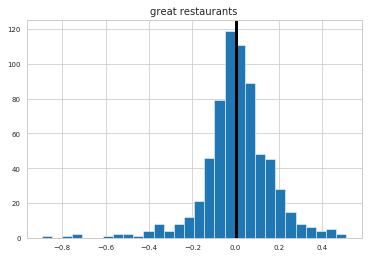

0.02273455743271925


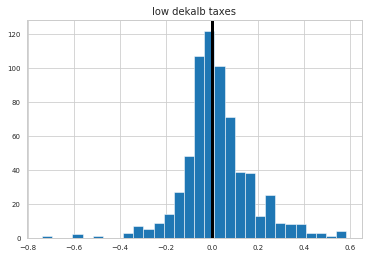

0.004903754308996133


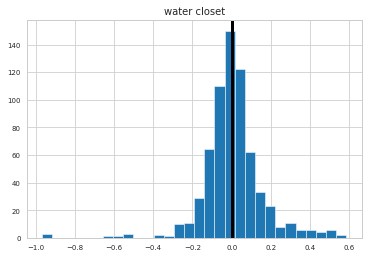

-0.0038997343474279187


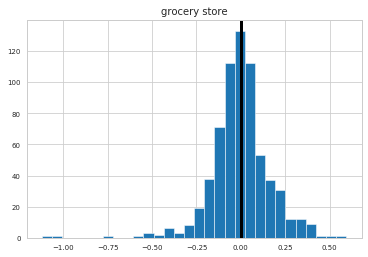

0.011027970097613294


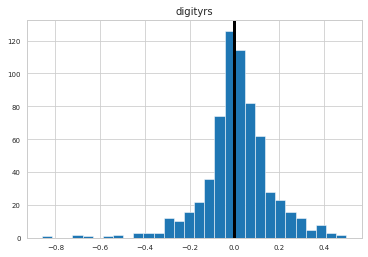

0.03085115952457152


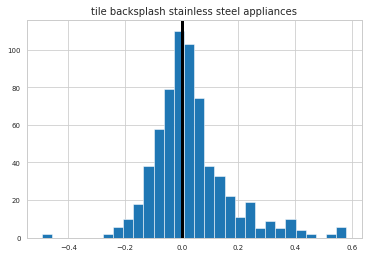

-0.00715553707074793


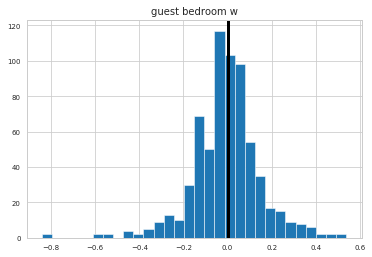

-0.006742346516391457


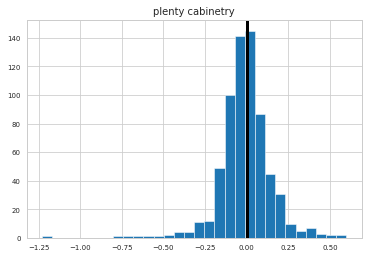

-0.020935736541267354


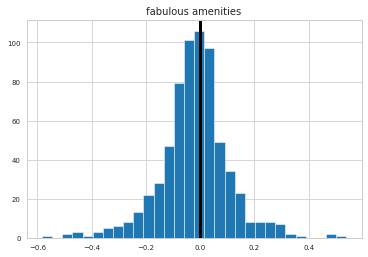

0.06459569610682811


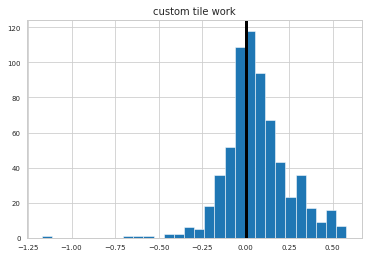

0.041501251539039385


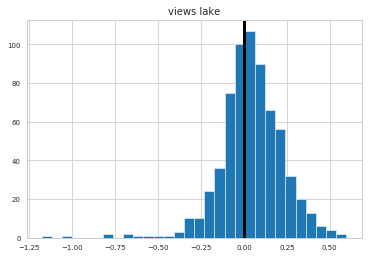

0.002972405971645179


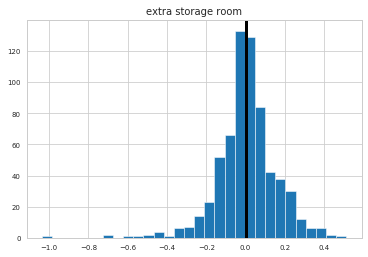

0.02956785888319767


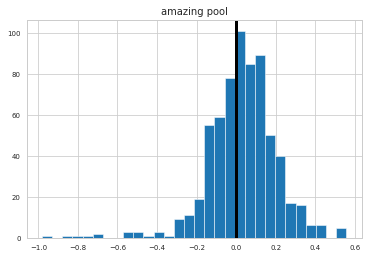

0.059764229581411844


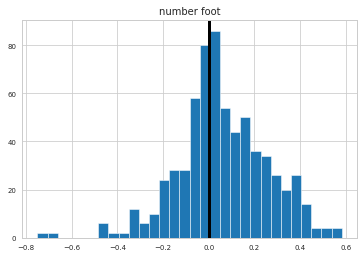

0.023795626480477932


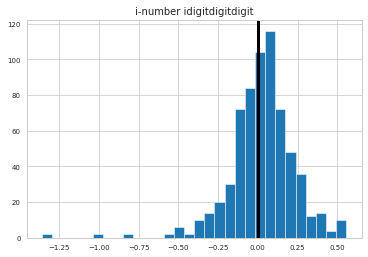

-0.004887250046902856


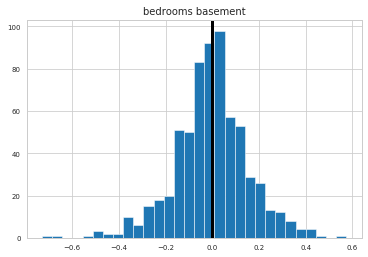

-0.007858774253578256


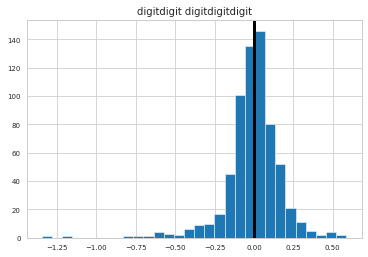

0.013126779981142797


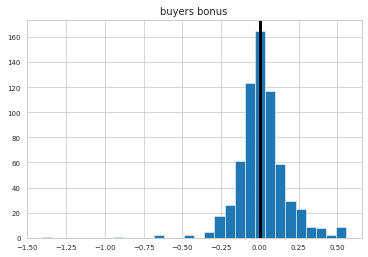

0.009965648761467993


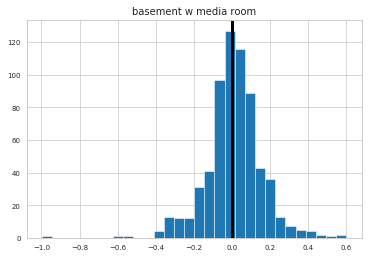

0.010598861182365638


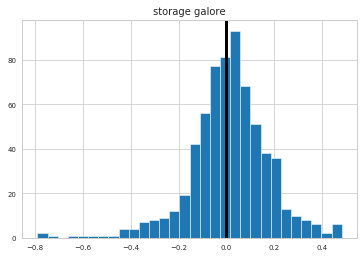

-0.01085921133873341


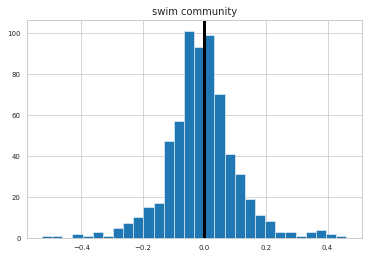

0.019014055796036537


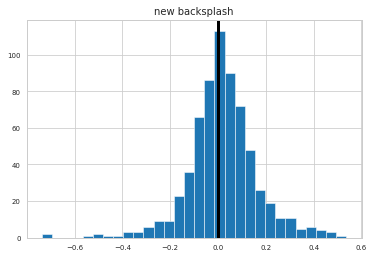

-0.010326871650730918


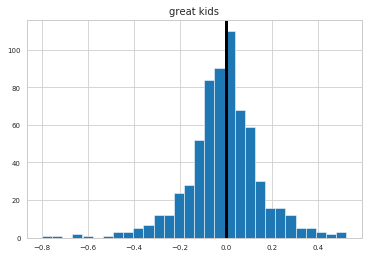

0.003101372553651404


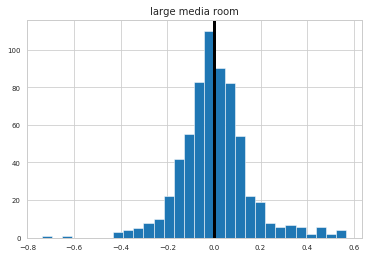

-0.0029272408891520907


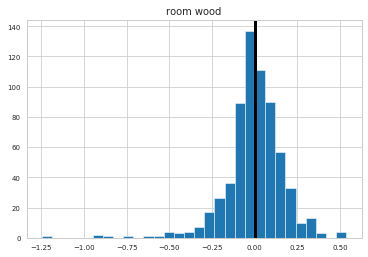

-0.005527260732600284


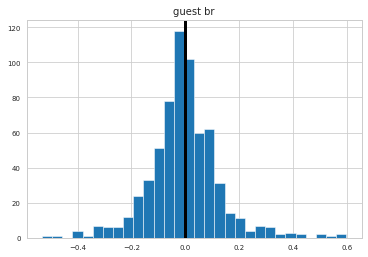

-0.023659655632066064


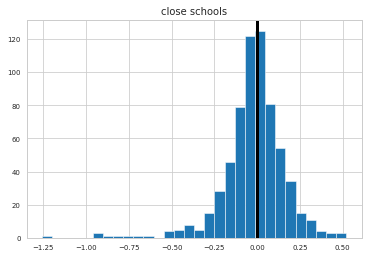

-0.08958916547311611


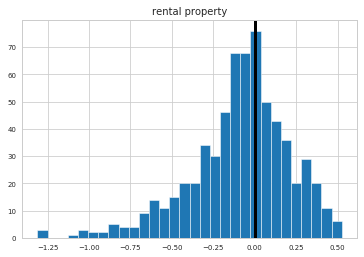

0.0412367883568876


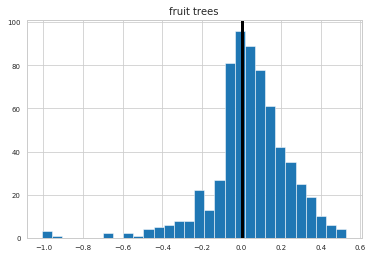

0.0032654738874228406


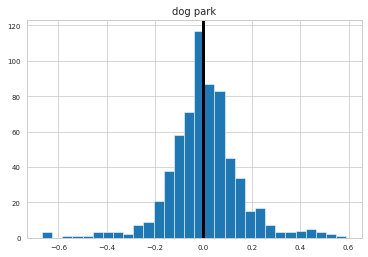

-0.02197879606723091


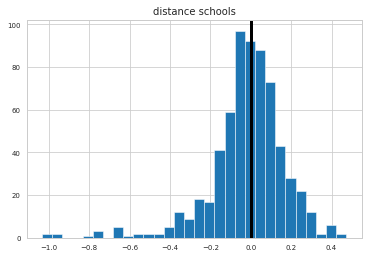

0.010875423029666735


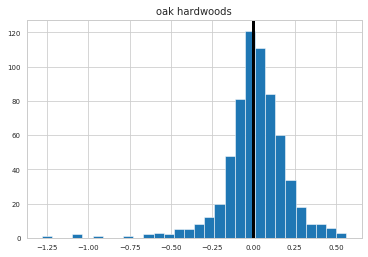

0.026660930814604755


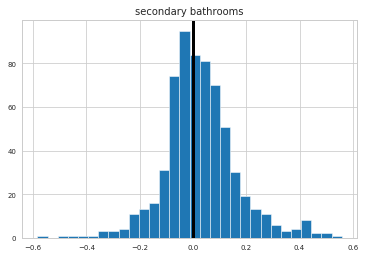

-0.005382986214290614


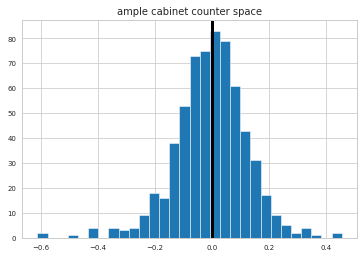

-0.004330768230313472


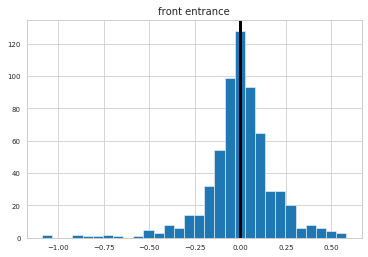

0.04700962780304782


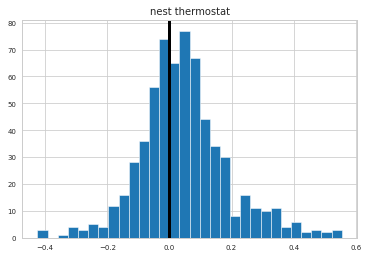

0.02904997609098287


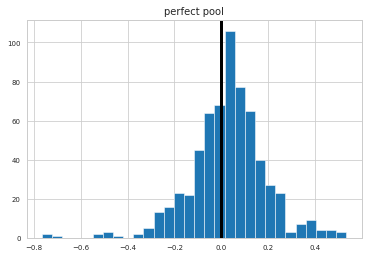

0.009030249561853259


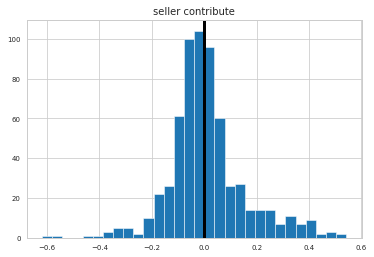

0.012647069582479544


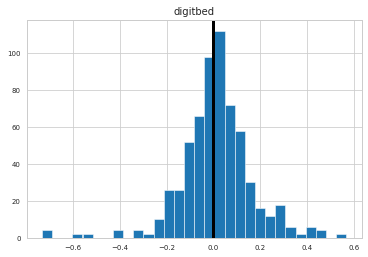

0.0023346903735604885


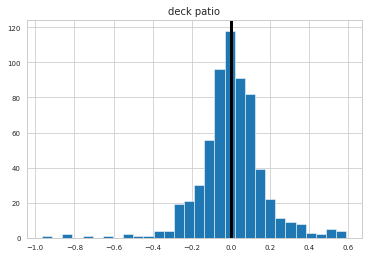

-0.023108308057096832


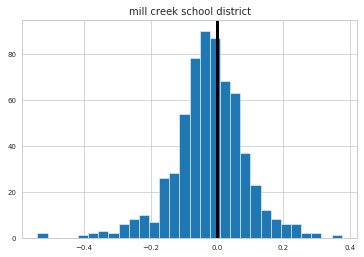

0.07646671745603105


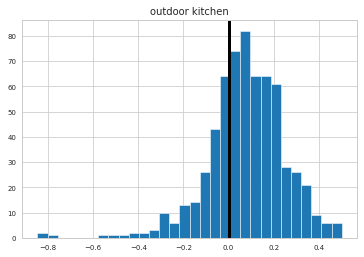

0.005552298201489941


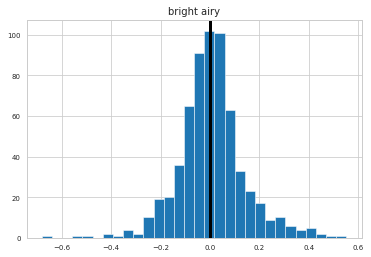

-0.012505839871535527


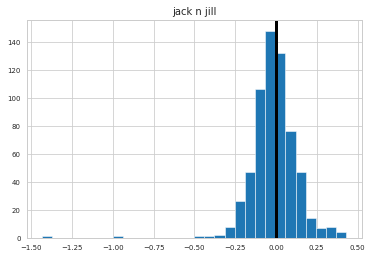

0.05103734349774763


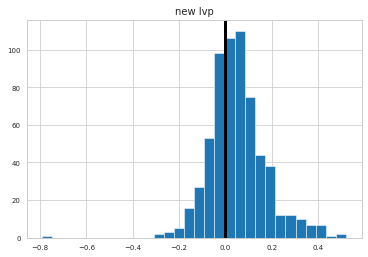

0.02288374044504182


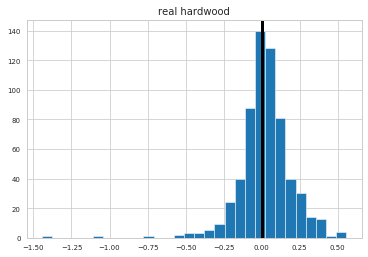

0.0006120515112111398


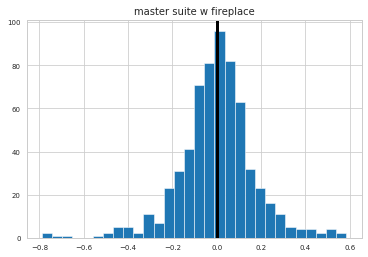

-0.00267497786686026


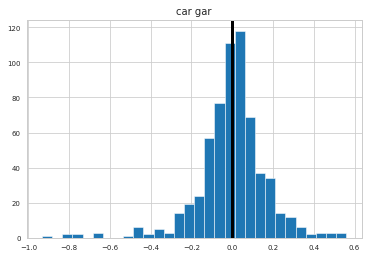

0.03301456884398835


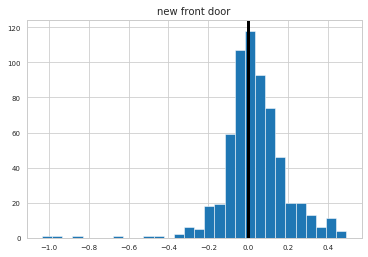

0.009520525150534857


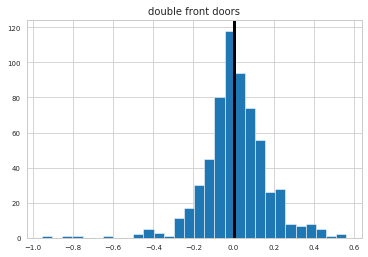

0.019287331818025957


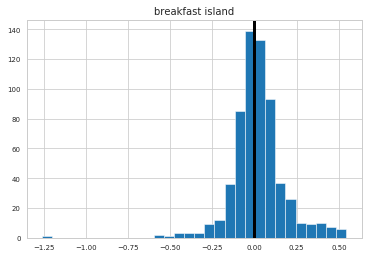

-0.0001267583072431728


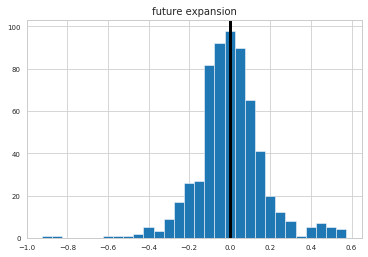

0.01299339938405676


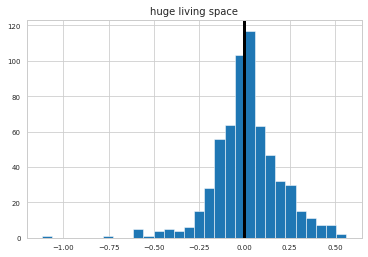

0.01976328537098281


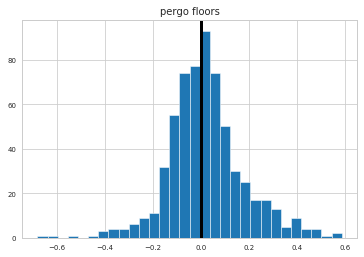

0.0053412387637672585


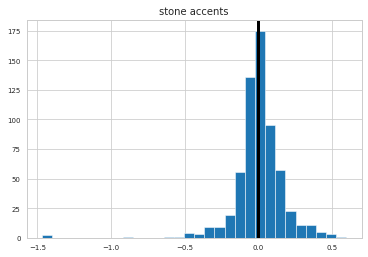

0.005956917515119006


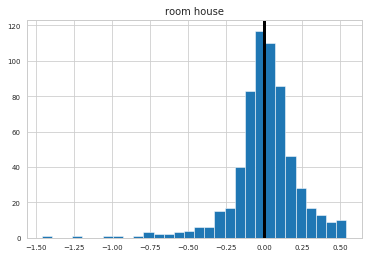

0.03352159208748486


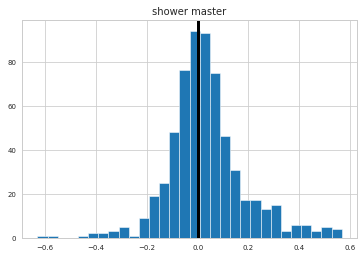

0.045068889827237904


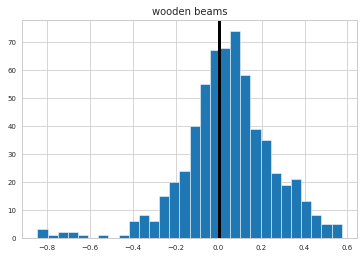

0.002038345725205104


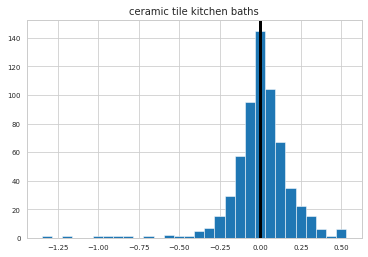

0.03568017999481252


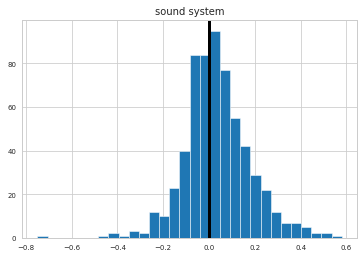

-0.023849301679519652


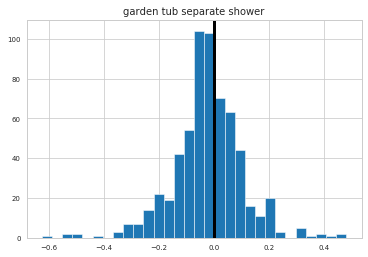

0.0321519111101215


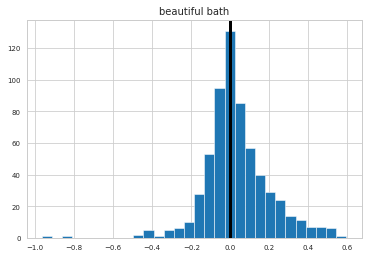

-0.020269704754585966


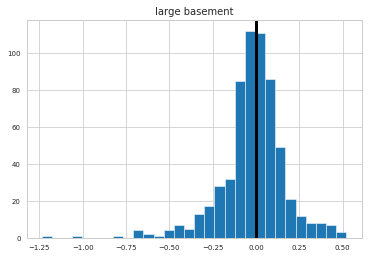

-0.012669306059804956


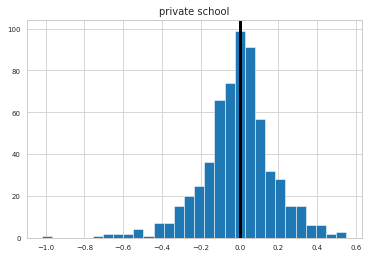

0.028993023380924604


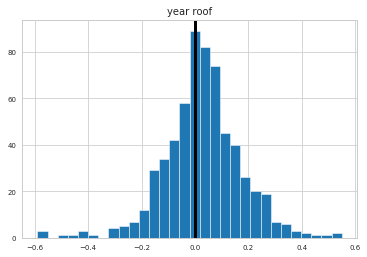

-0.02650651519611978


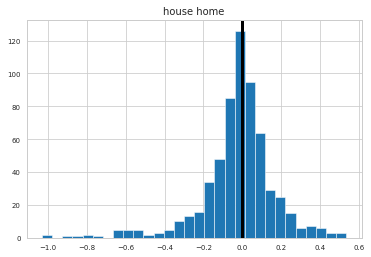

-0.005642049386486225


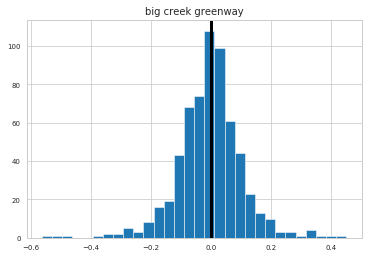

0.0013922073488004925


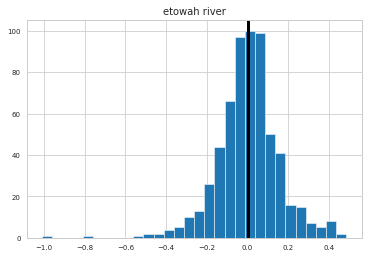

0.026928227695505267


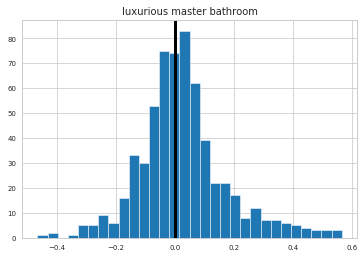

0.006777881442212251


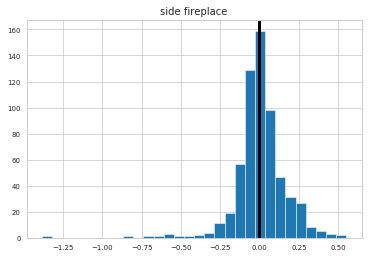

0.04506740206772665


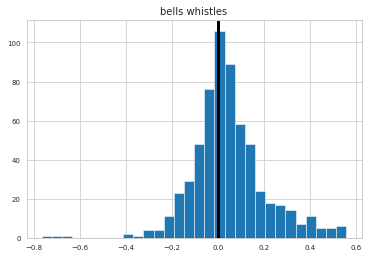

-0.0069479790554745294


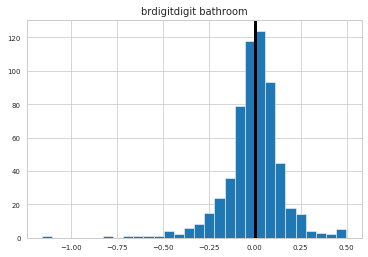

-0.009564715706415232


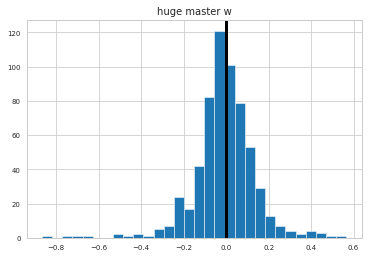

-0.011137807393337924


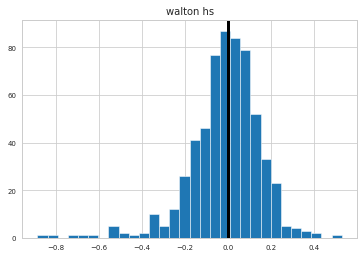

0.013930987714674988


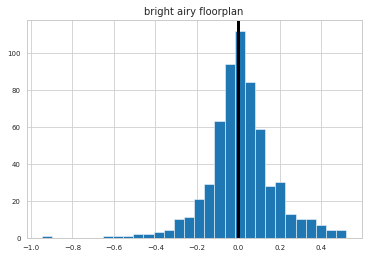

0.0008499402787257722


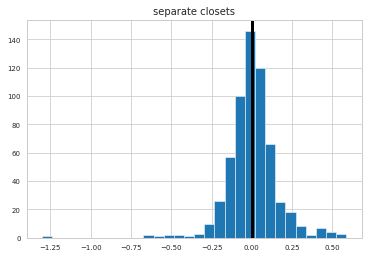

0.038597233052985576


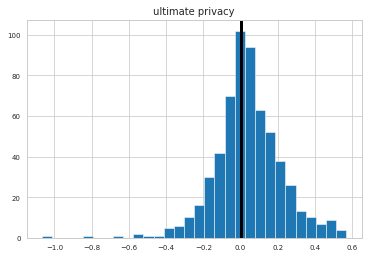

0.05963993642590886


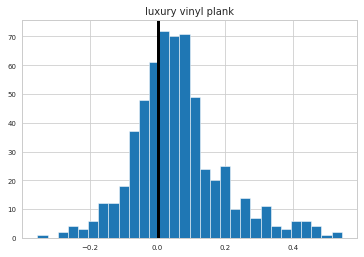

-0.0032096928782304347


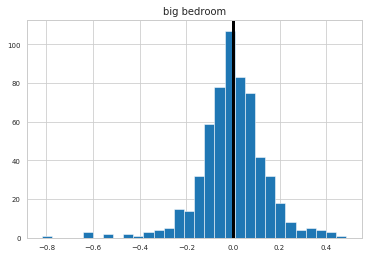

0.01180898031693379


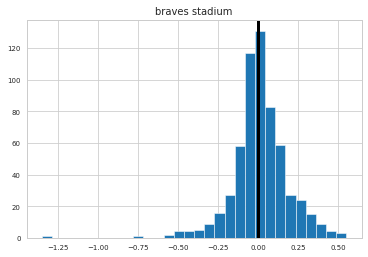

-0.01399908653106212


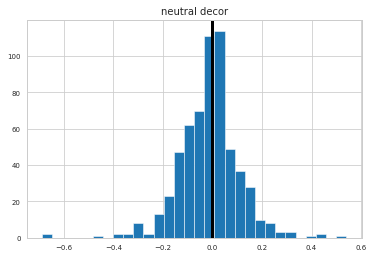

0.024373614469653526


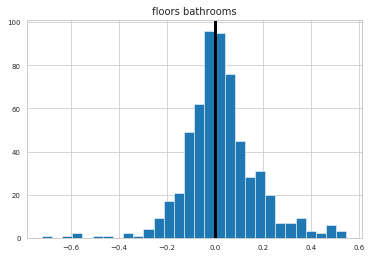

0.02099975868317422


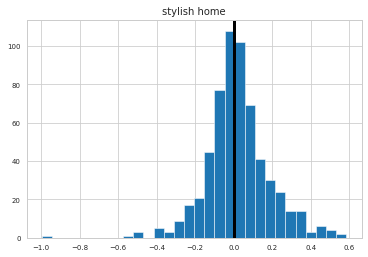

0.040904668258196726


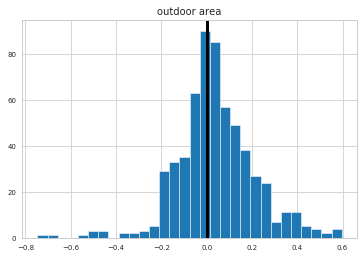

-0.00397849130450665


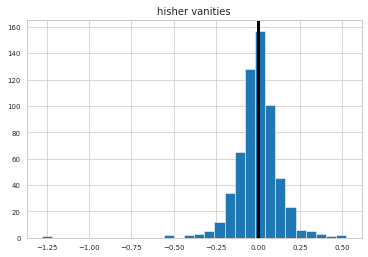

-0.0038849822271512778


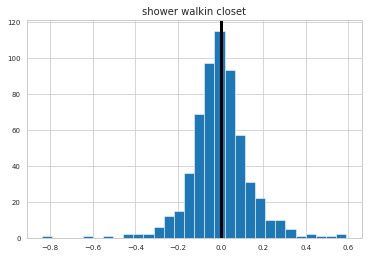

-0.0570654852440411


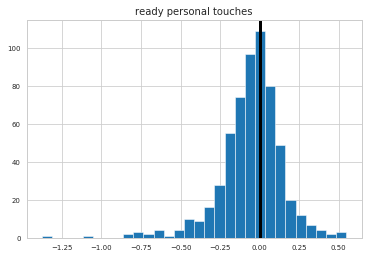

0.00843464791706354


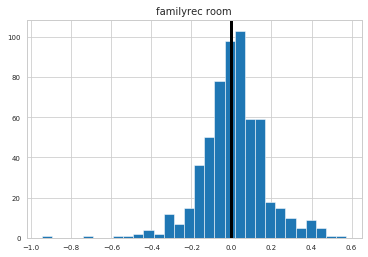

-0.009777180528315017


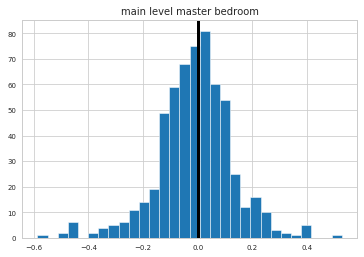

-0.001619100388391992


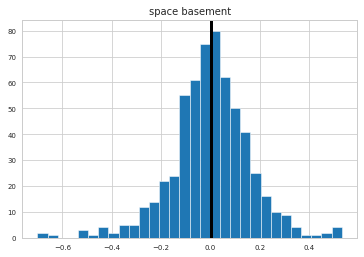

0.03109272977132348


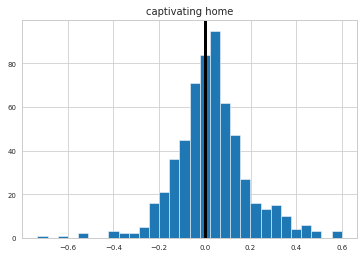

0.00730814364025966


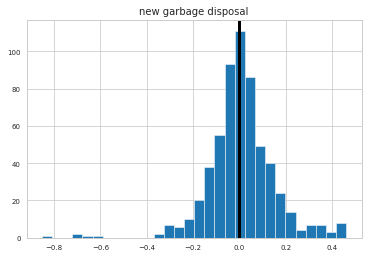

-0.009693809364027065


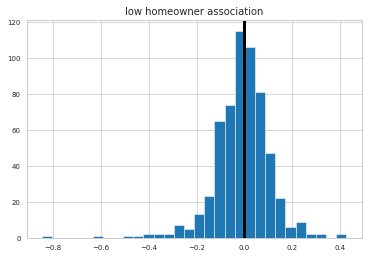

-2.539503375602441e-05


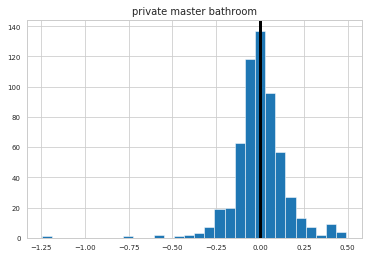

-0.014693466790300798


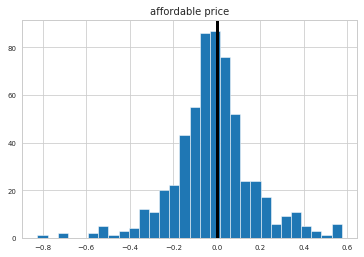

0.014692897146120182


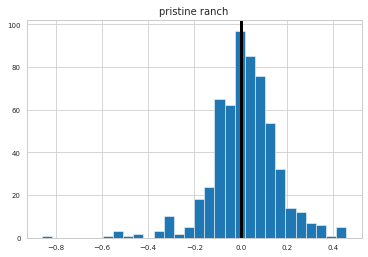

-0.025230836657653466


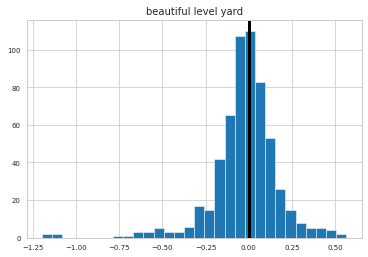

-0.009051731023453132


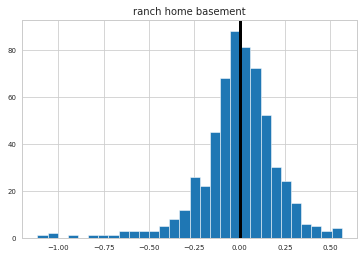

-0.015002192203582516


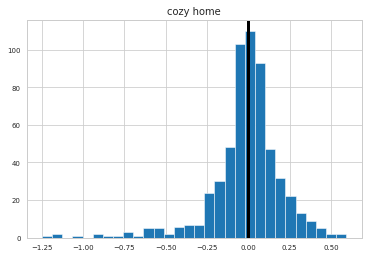

-0.003862080911459349


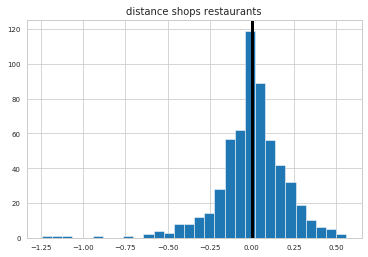

-0.007375618927684838


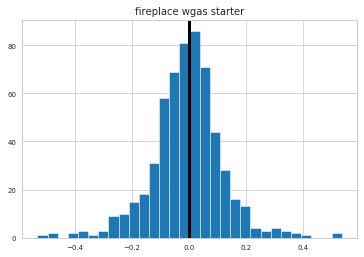

0.005625388689211333


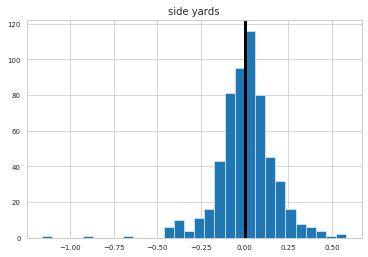

0.016271473901636194


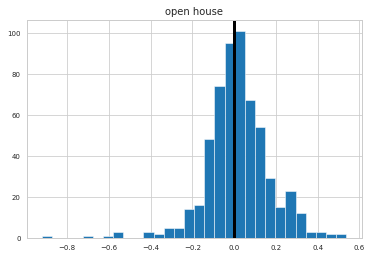

-0.027374869693660986


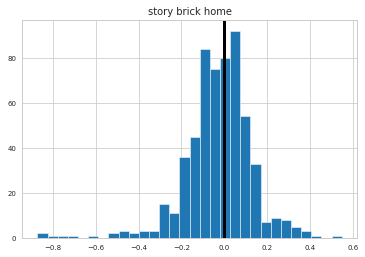

0.14169505635536553


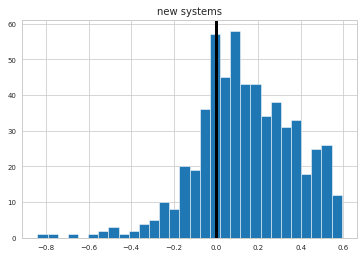

0.017936283482467143


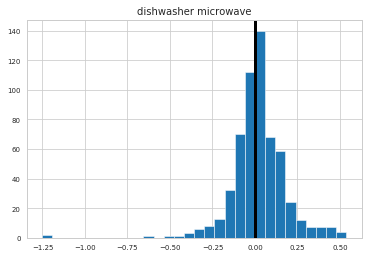

0.017195890022058243


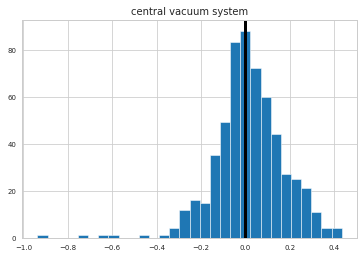

-0.011276291259867075


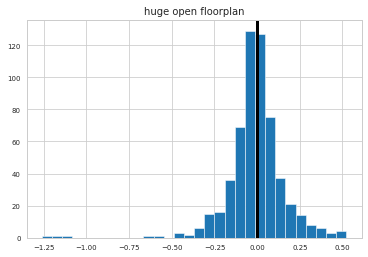

0.011383262212877832


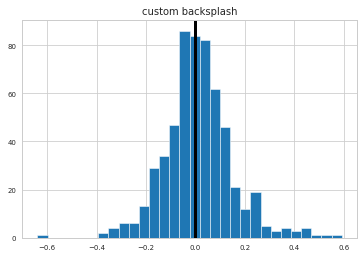

0.005884794178490791


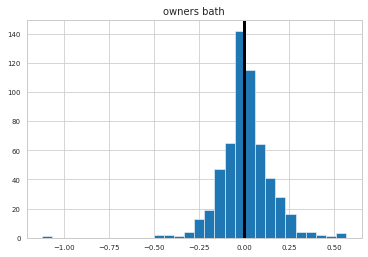

-0.015731730377499777


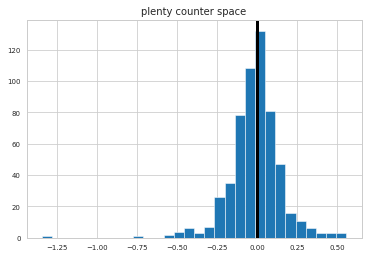

-0.014699480155321795


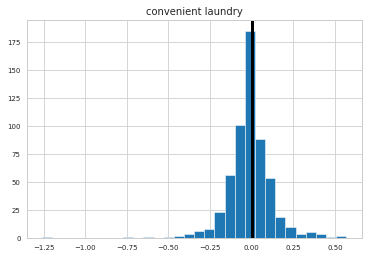

-0.014775331519254406


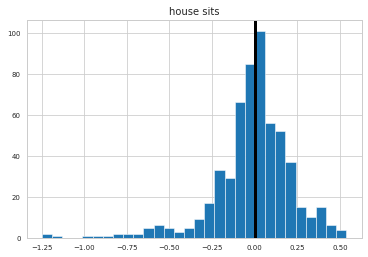

-0.0028667005216642984


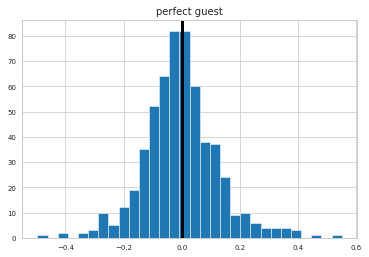

0.025673182482526518


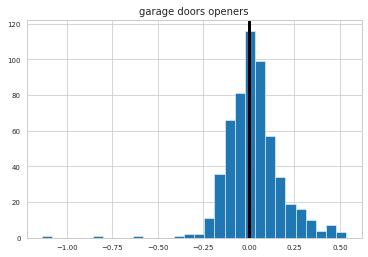

0.007911570171501354


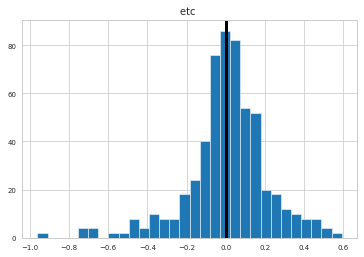

-0.008370025127279027


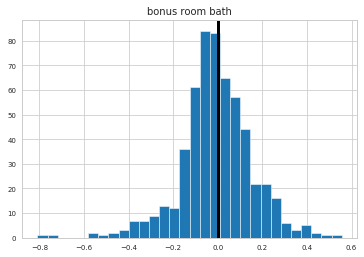

0.047691788046537675


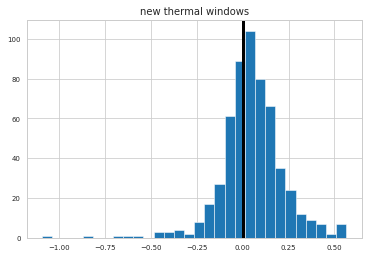

0.0023691919272556534


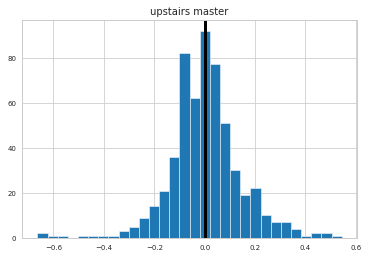

-0.0035590631415893946


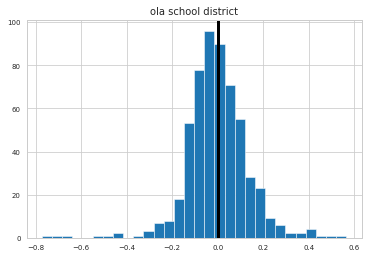

0.006753335045667105


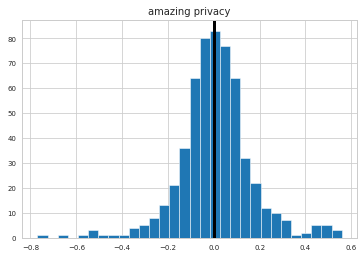

-0.02142399045317546


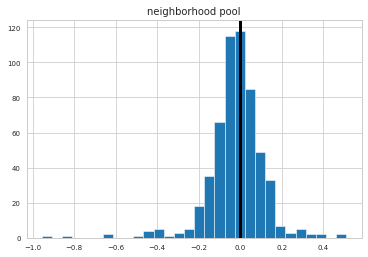

0.01186589014564885


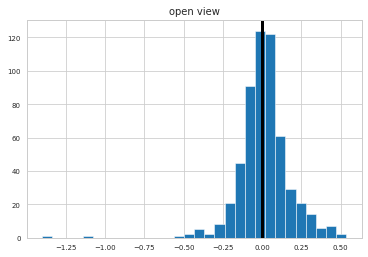

-0.012036278127917455


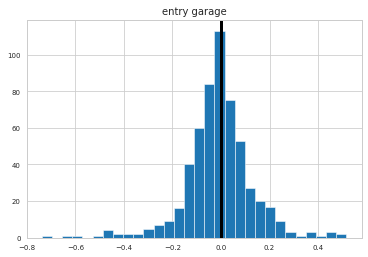

0.043262420688044055


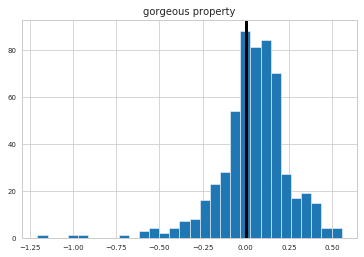

0.05763604230077226


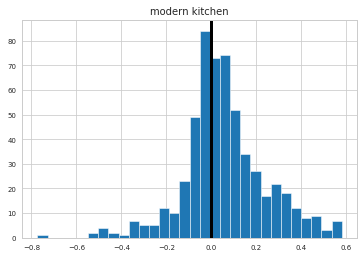

0.0065757418127347115


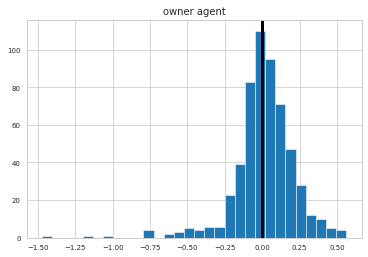

0.008231322727985766


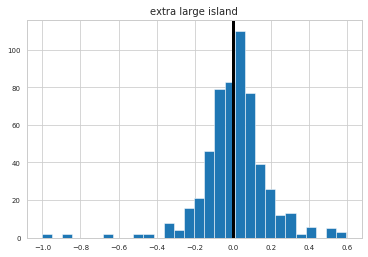

-0.031085020283284158


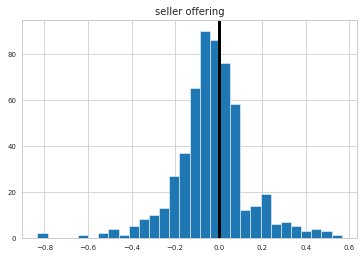

-0.008545026019607013


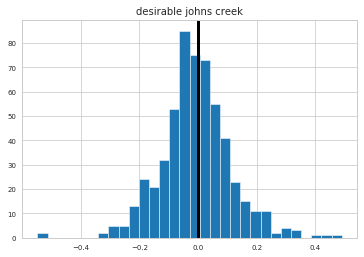

-0.008806118780684508


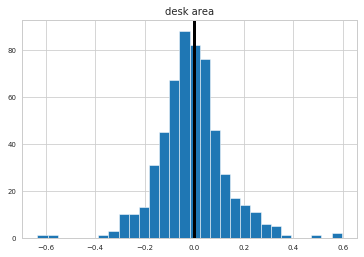

-0.0031514614768240554


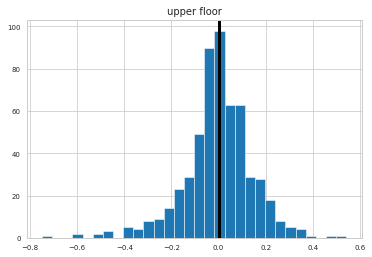

-0.01306058628187232


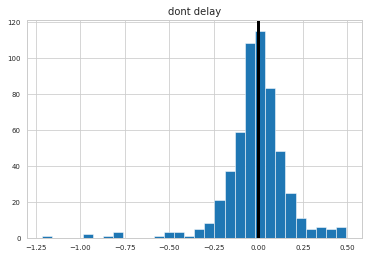

0.032411668576909275


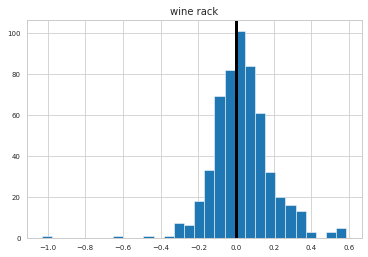

-0.0036599259940487444


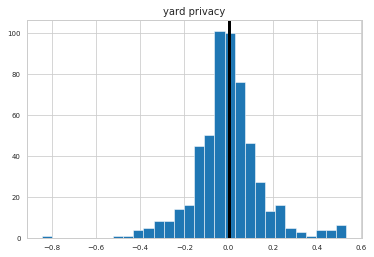

0.039072081381407366


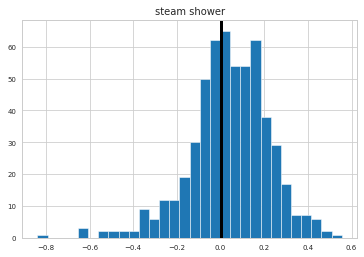

0.08598372817532972


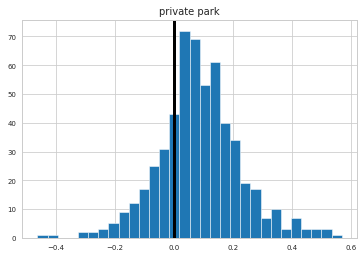

-0.0019360648962415412


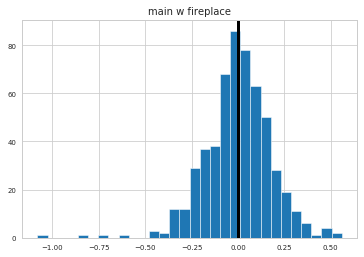

-0.008792509340458932


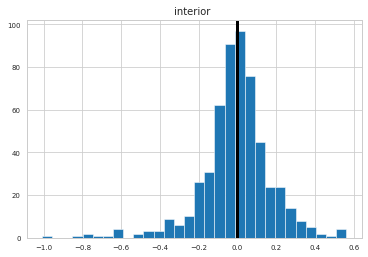

-0.044448584976369616


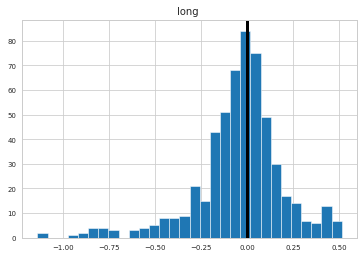

-0.005024096542198192


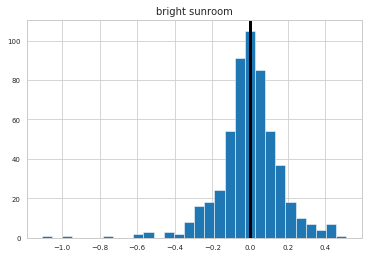

0.001873898317123532


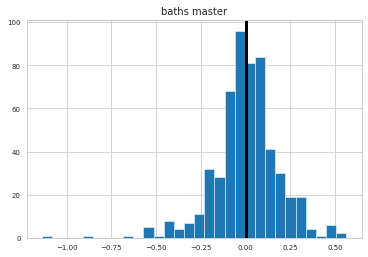

-0.01903592683308709


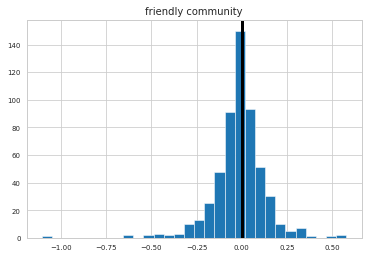

-0.005241988459737244


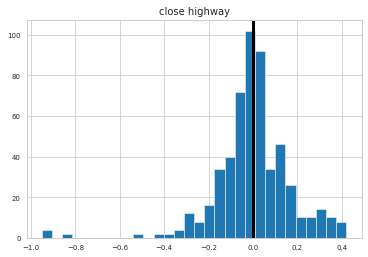

-0.002347689504618506


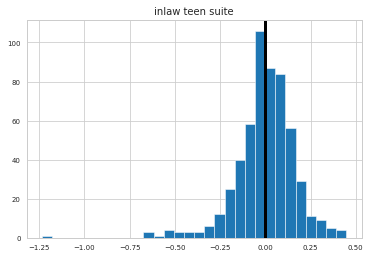

0.018699606705422877


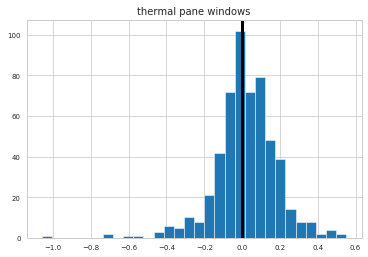

0.023582201849866345


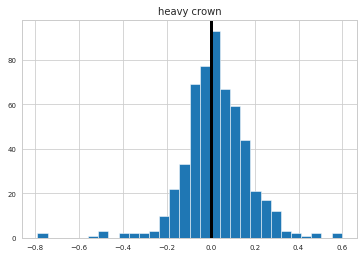

-0.22075666837142743


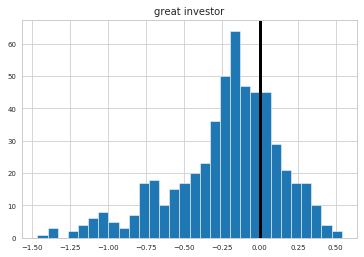

0.03128636603732831


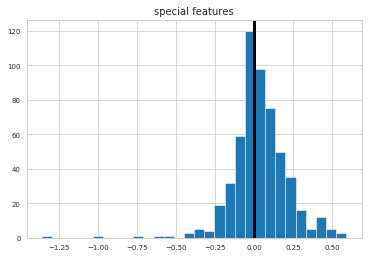

0.0035354894191636666


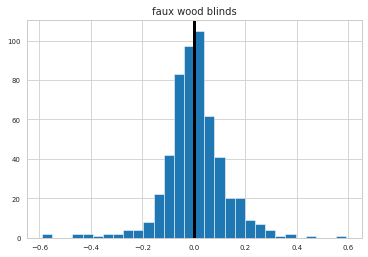

-0.0914246090170932


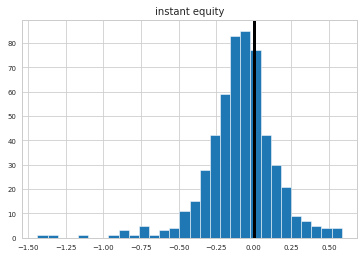

-0.012270019359956185


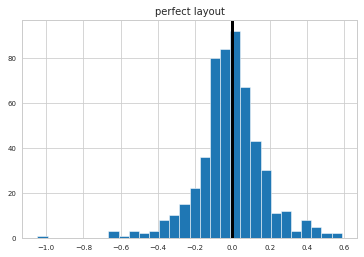

0.07374842907515412


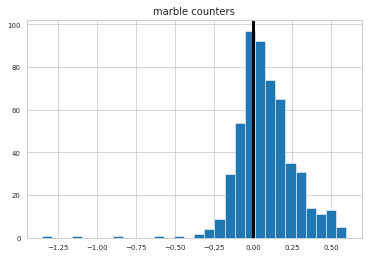

-0.010853345654381083


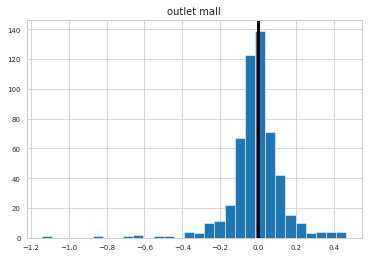

0.06099540966053954


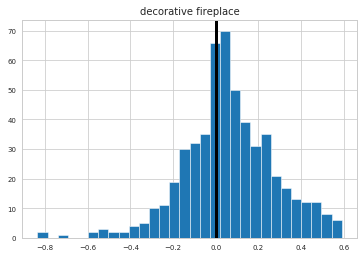

0.019943213189499105


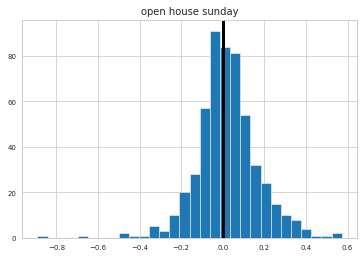

0.009190704541318283


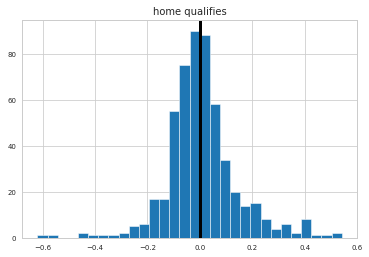

-0.014601006308753828


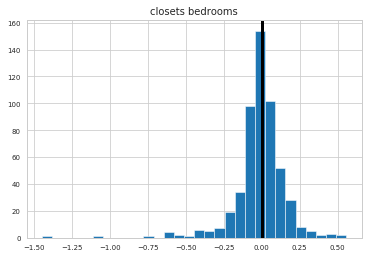

0.002523704281937635


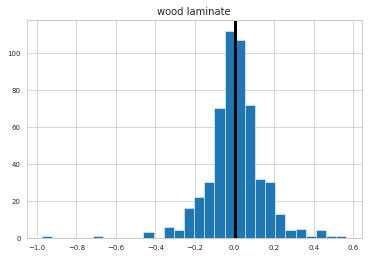

-0.01754707662945906


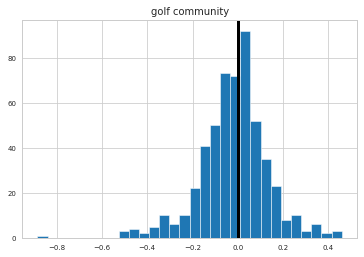

0.0222756843271186


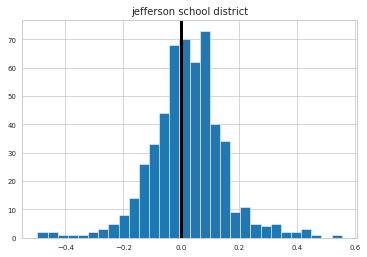

0.022221987805631793


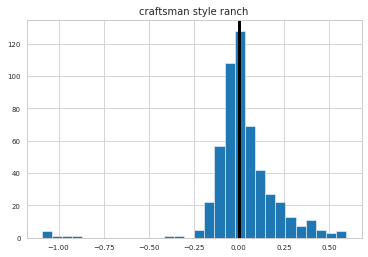

0.003365234041810464


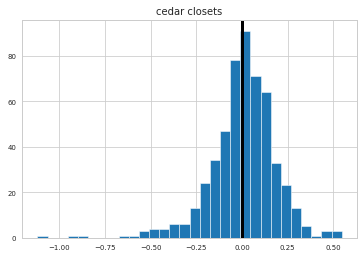

0.021243187063002086


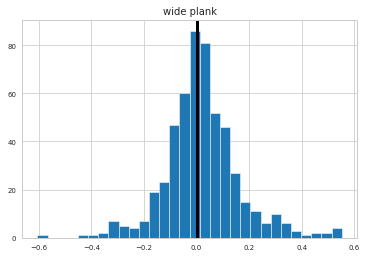

0.0016065457221610586


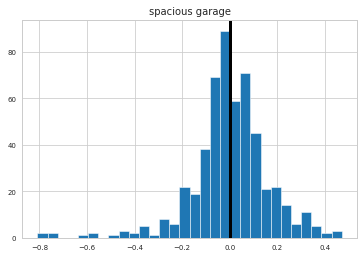

0.0013604856604789758


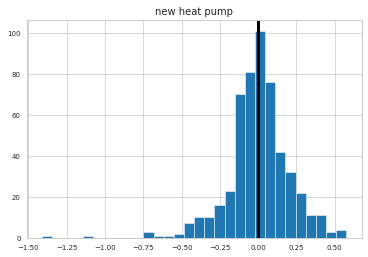

0.0014346854074259348


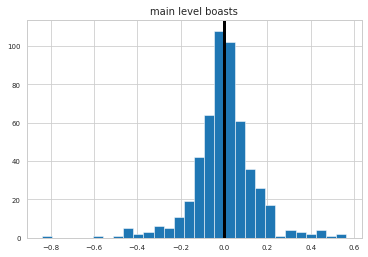

0.007605460063315606


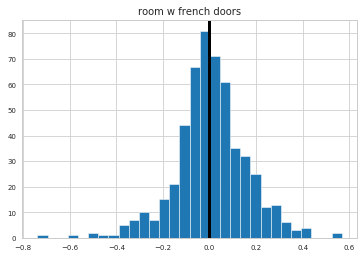

-0.01421357992841152


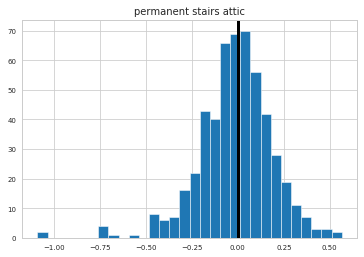

0.033914705591770046


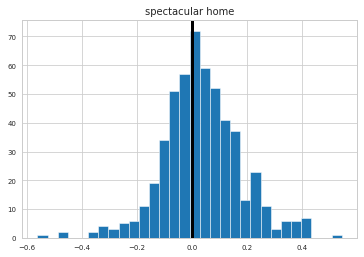

0.006660339640488306


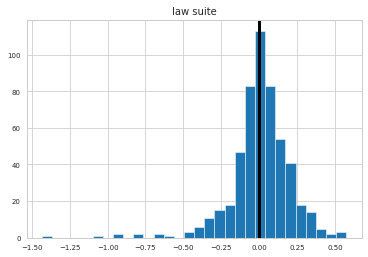

-0.010783435028901965


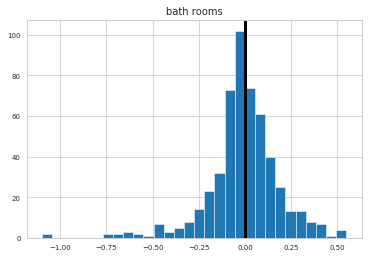

0.015143677225126695


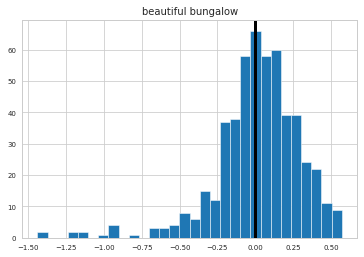

0.019496270434107843


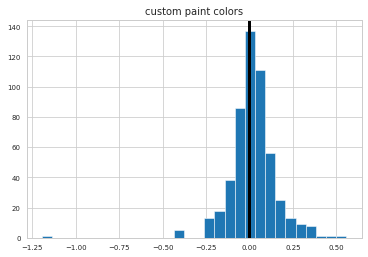

-0.005600979990775569


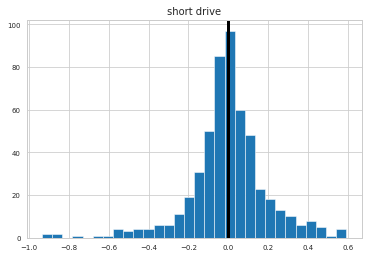

-0.009780513873399503


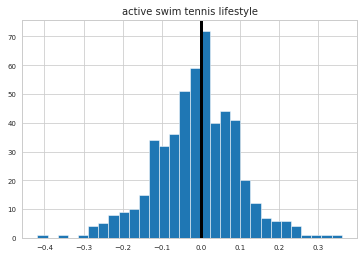

-0.0038482214661782464


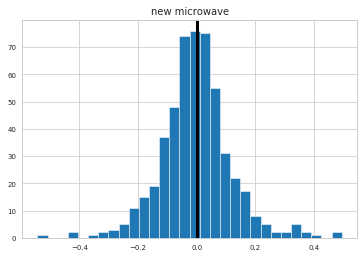

-0.0062577014955641115


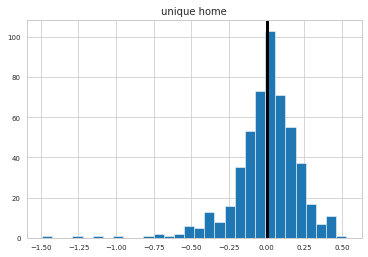

0.021541415296455715


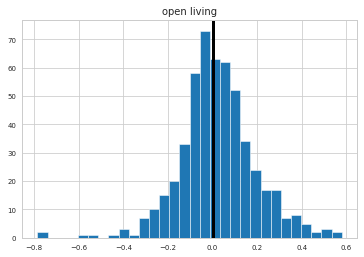

0.04169080591077708


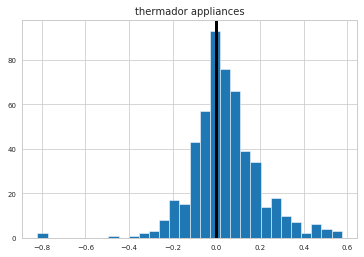

-0.02615343969982234


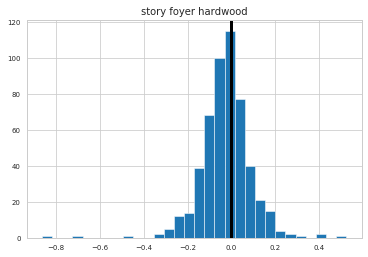

-0.004219489565391935


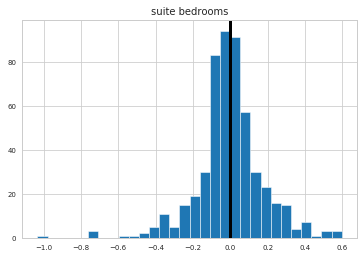

-0.003975168197394292


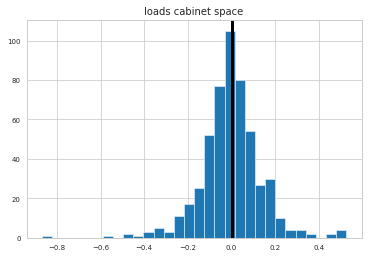

-0.015171776027036815


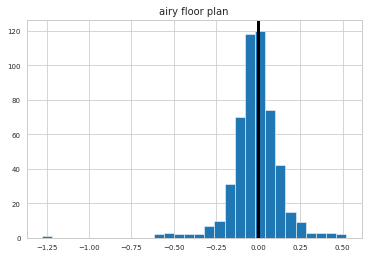

-0.03594727219099926


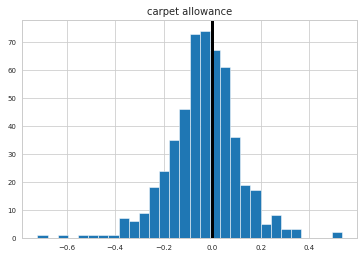

0.018111271579362775


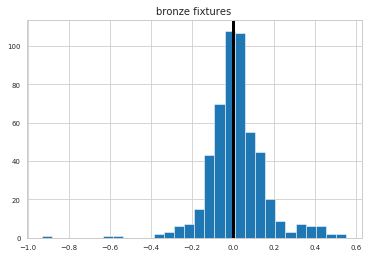

0.015578582812550822


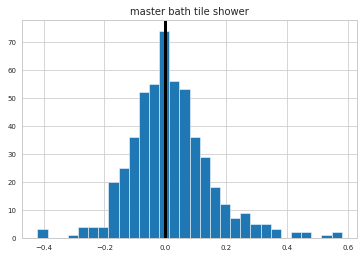

-0.01243188124296407


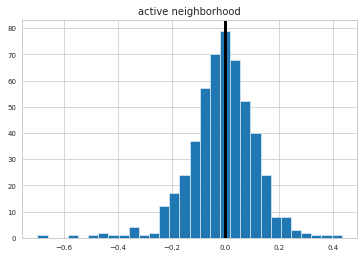

-0.00664802580678941


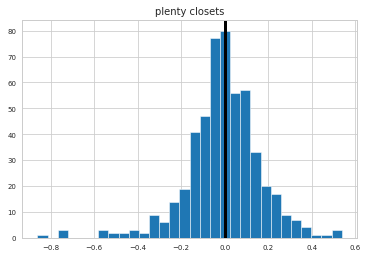

0.0037668487634470345


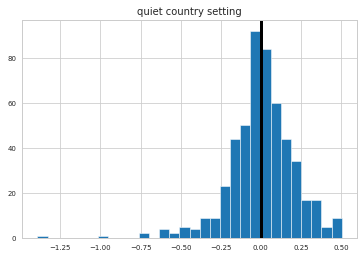

0.03950105376013157


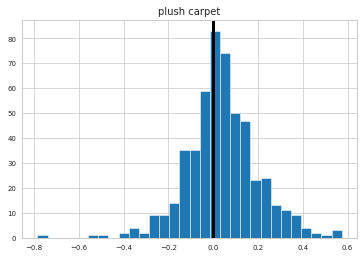

0.011840178527251484


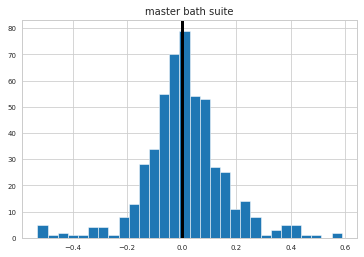

-0.025594653700900145


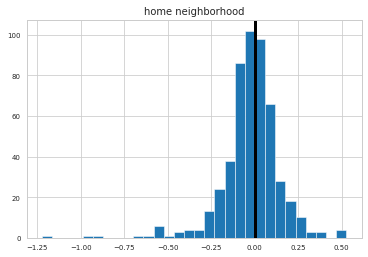

-0.00836542879138001


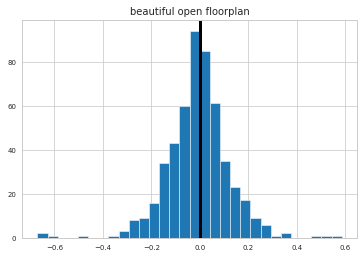

0.008416479690628972


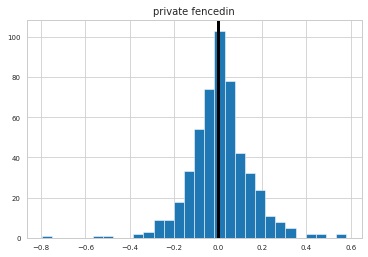

0.010733122088721566


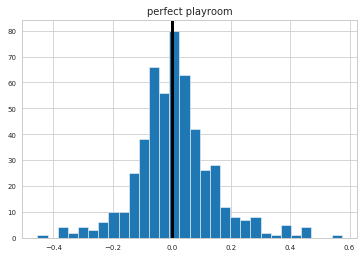

0.0390967437696465


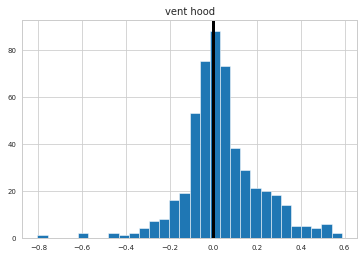

0.018979911852732324


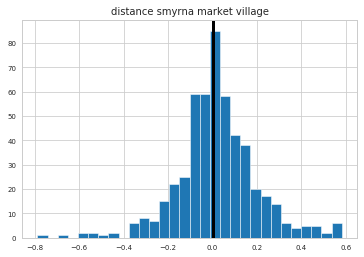

-0.026464241835716246


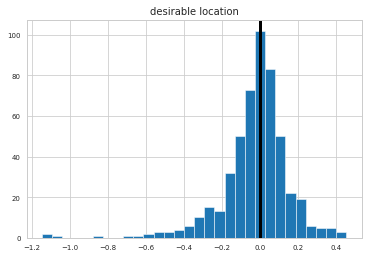

-0.01796073909712578


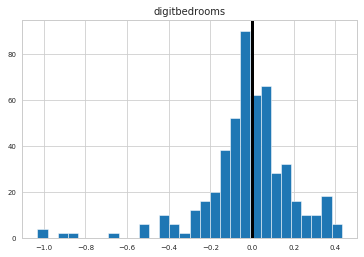

0.04137044278008592


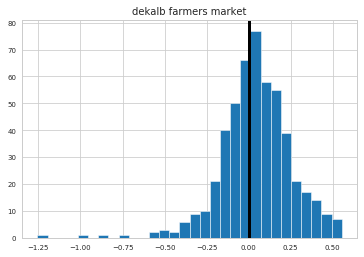

0.014489308572486058


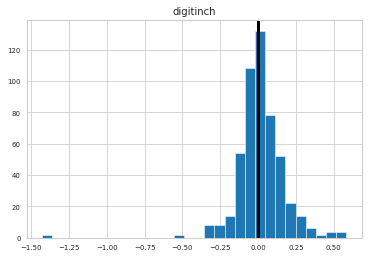

-0.12898695556429116


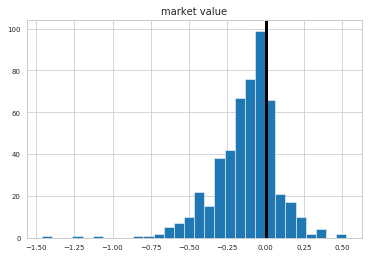

0.0199452880080039


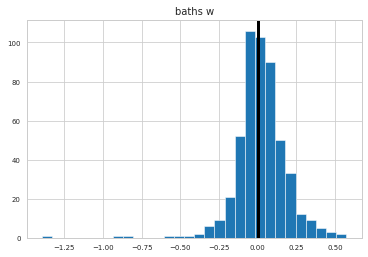

-0.057140409185145846


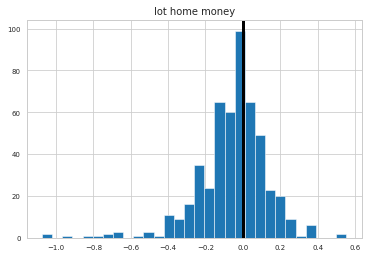

-0.017108453275898796


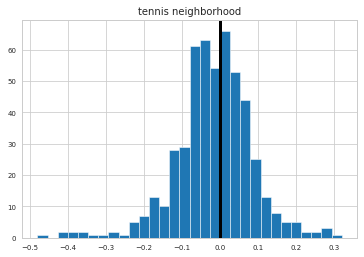

0.022927758216286474


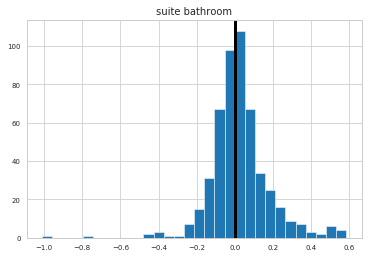

0.002228617423901702


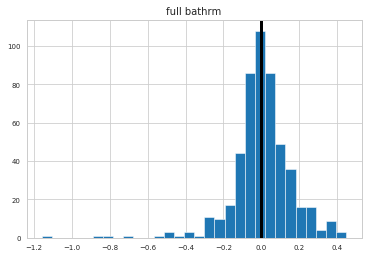

0.007158489126468068


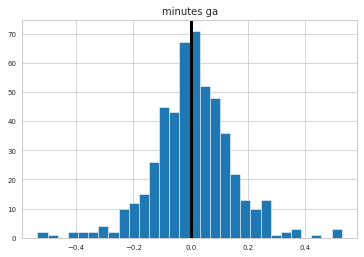

0.028053788943784512


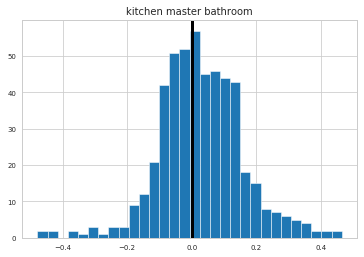

0.058911867906792724


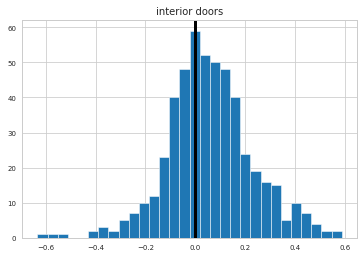

0.029455776694328726


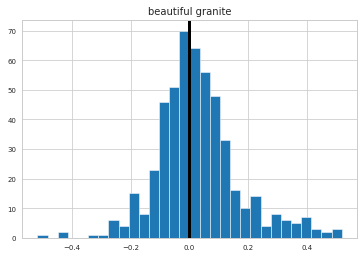

0.011397869041001154


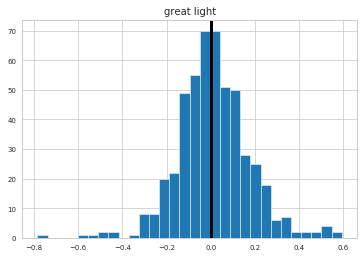

-0.001159956449946559


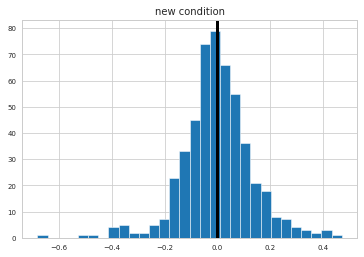

0.11349746480430306


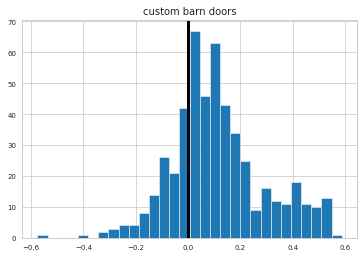

0.0592811383029225


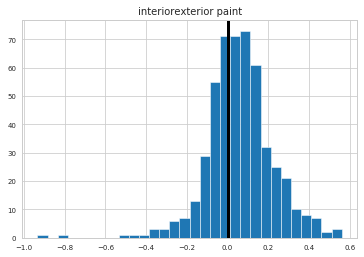

-0.018122047812567394


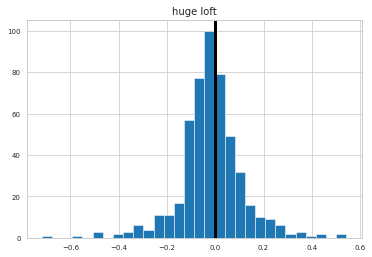

0.015921633190455513


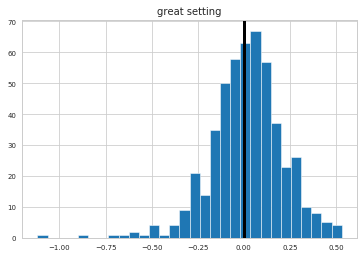

-0.014602541690190858


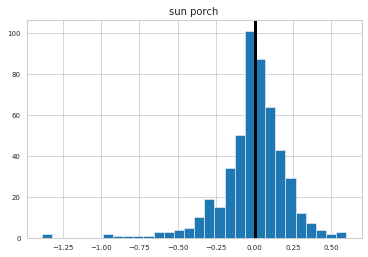

-0.017869315433017337


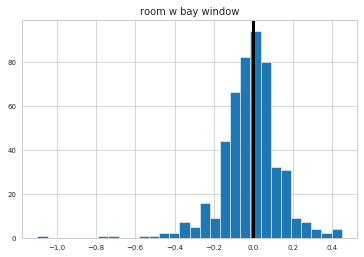

0.01475391416452751


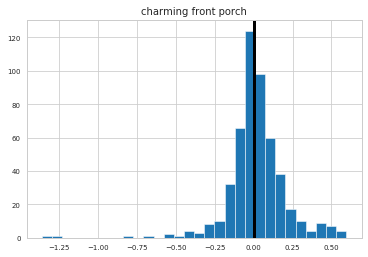

0.000280274785124341


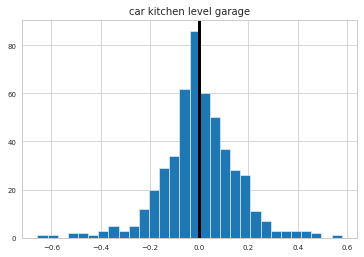

0.0010852979280069092


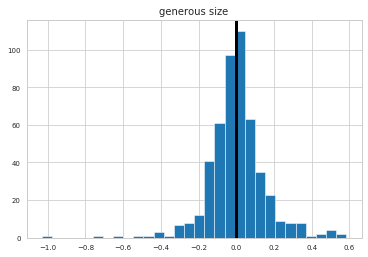

-0.020191675769225793


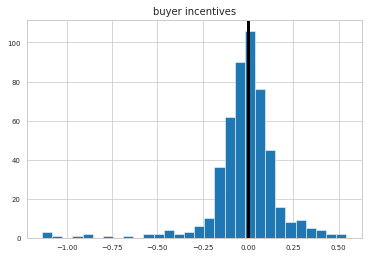

0.0773922700789839


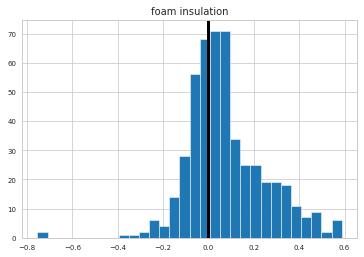

0.005191427272152959


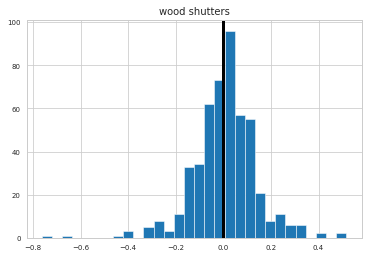

0.029964900377099063


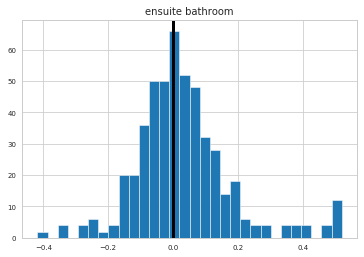

0.020434421973457524


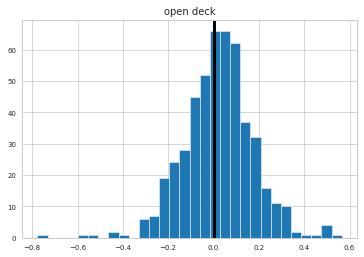

0.0174601406529235


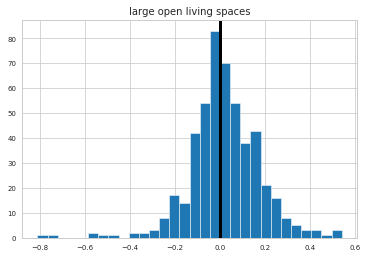

-0.01682541315883902


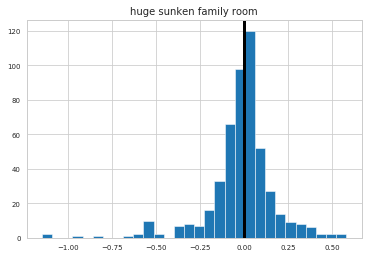

0.05167557543818391


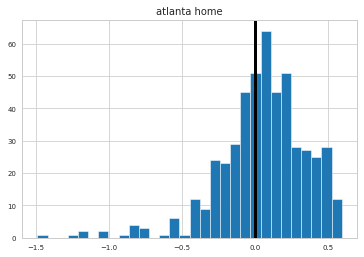

-0.024380904560270235


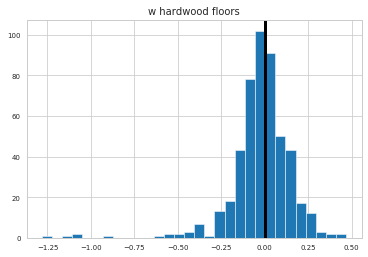

0.023743936981923005


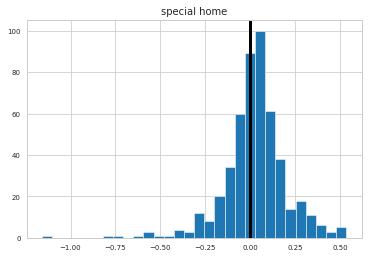

-0.016203941499008032


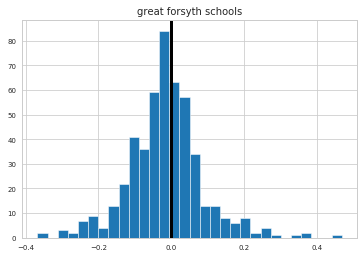

0.0008177944400792665


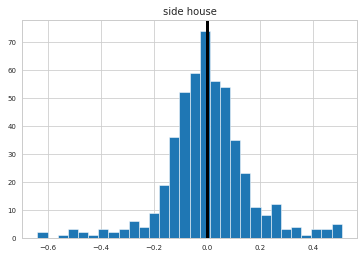

0.002426746021407778


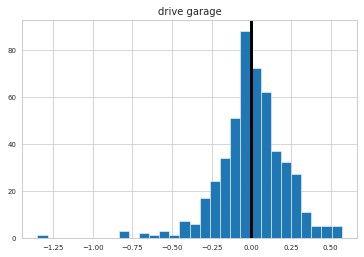

-0.024887479765001115


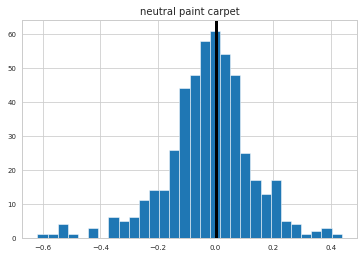

-0.009093932774735896


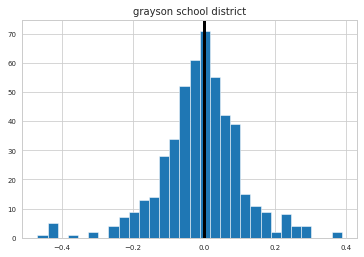

0.042577990342513694


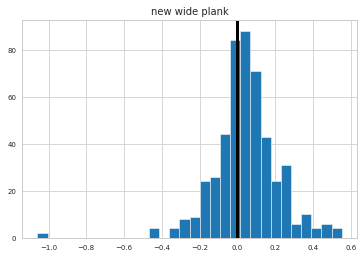

0.03861016813463953


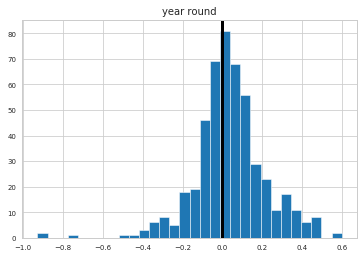

0.008198818314397434


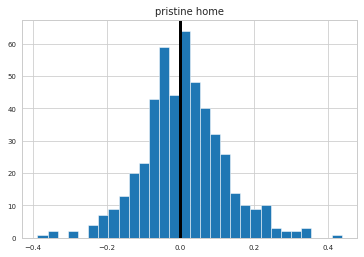

0.03669047218666033


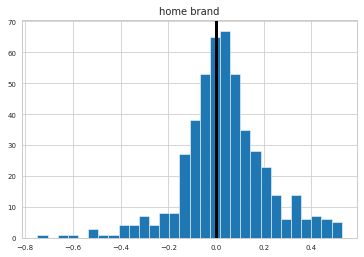

0.03614377938812172


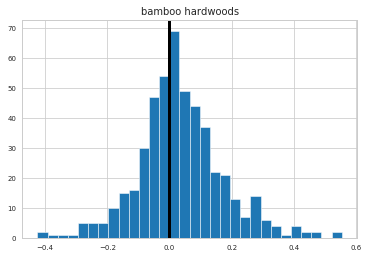

0.019396635652240365


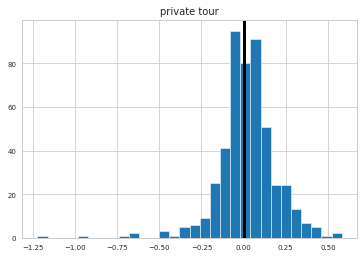

-0.013269511342678692


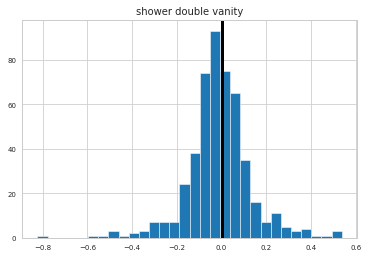

0.004123534998255867


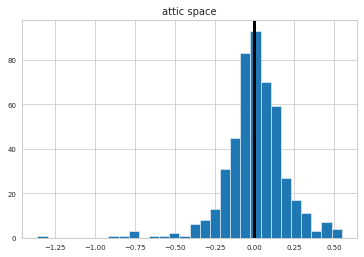

0.007717643437619999


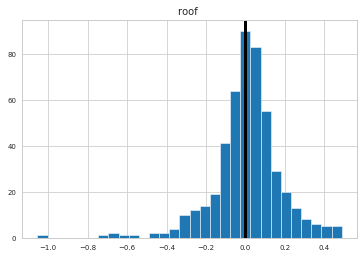

0.05891749414998459


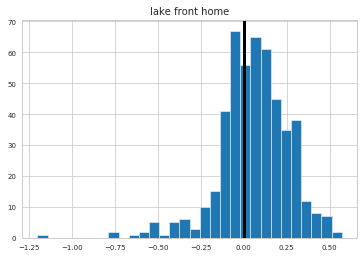

0.03251684849584831


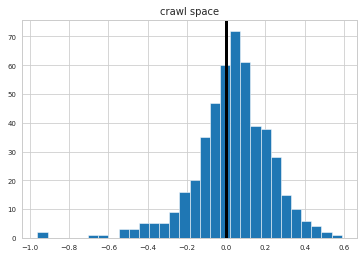

0.0010118987800593958


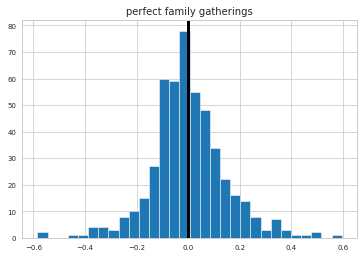

-0.01123098162483452


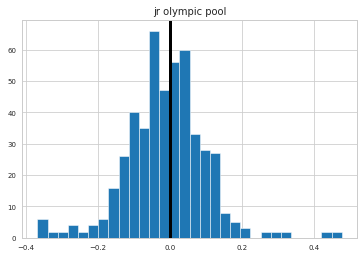

0.014824414667291001


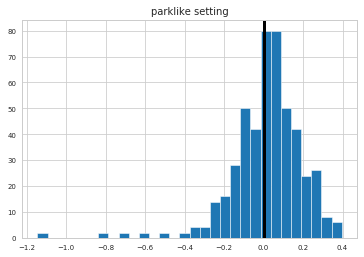

0.04533761842884546


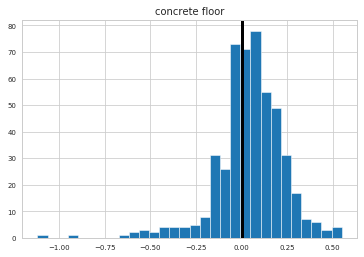

0.06361595258108046


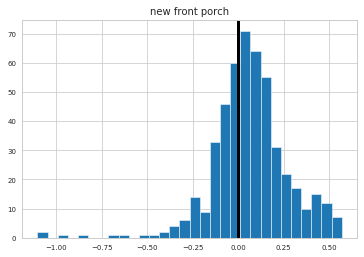

0.009564160120798113


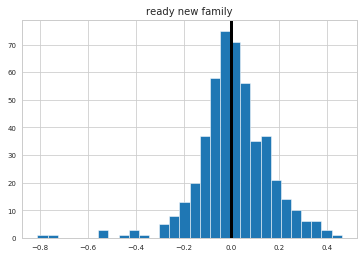

0.0501909834392559


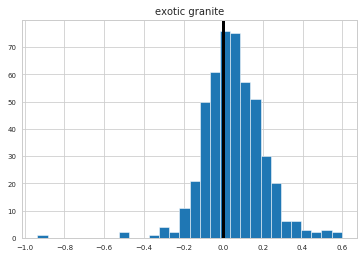

0.01061719340542127


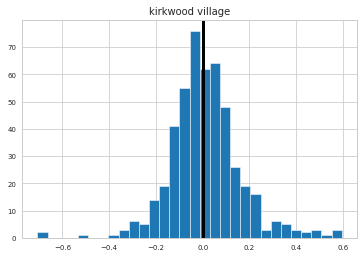

-0.006934241223162838


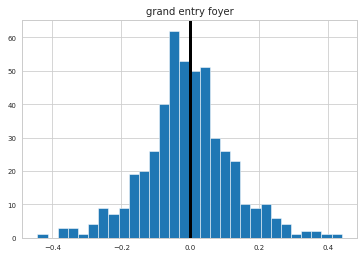

0.016366645309213945


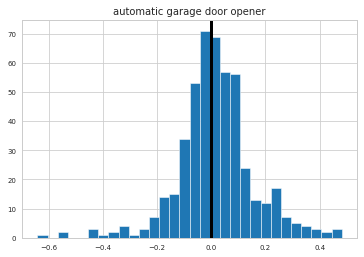

-0.007873930137987971


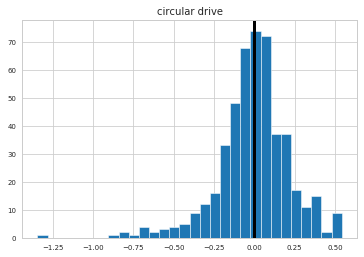

0.0333903840966438


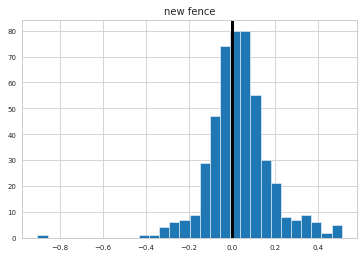

-0.02295243646622224


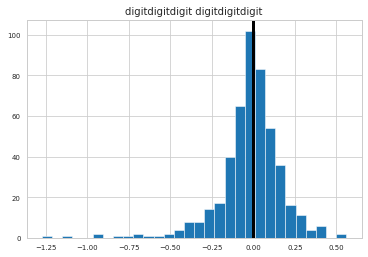

-0.0420582243226747


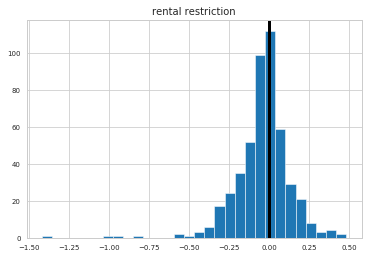

0.020368304171218415


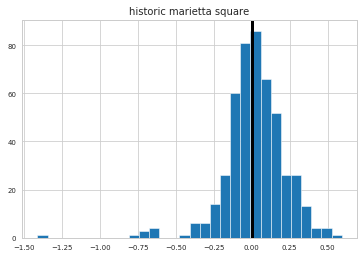

0.023983143602918918


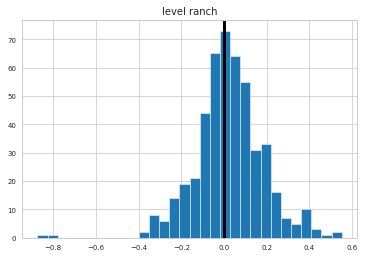

0.014211705585159362


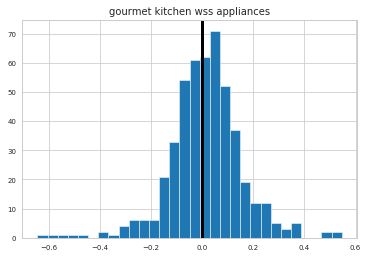

0.012548762123678399


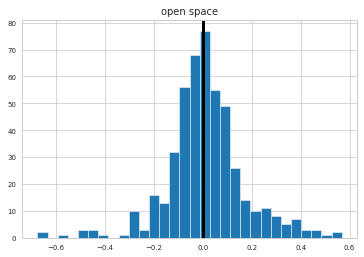

0.007475443375299649


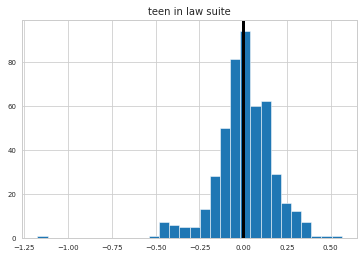

0.0336463801505403


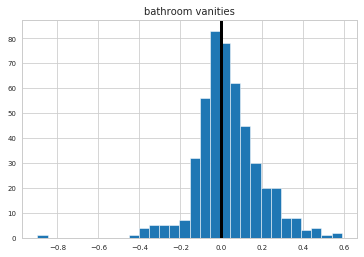

0.0023392925393521183


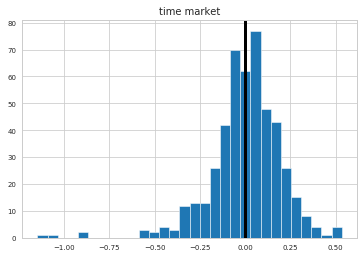

0.0036471879631617215


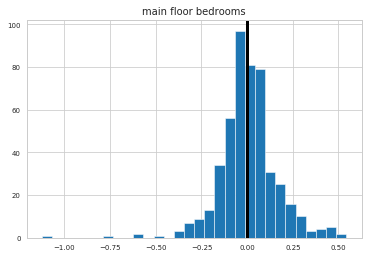

0.04256941865768775


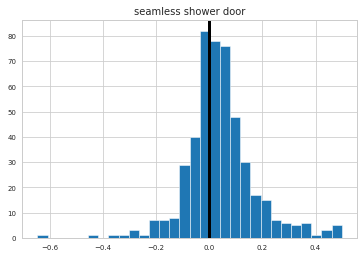

-0.012741606877444196


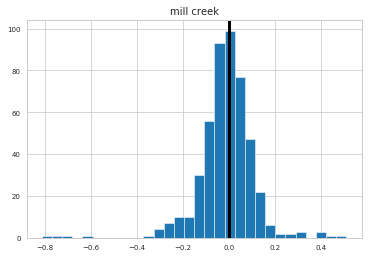

0.08981580195108697


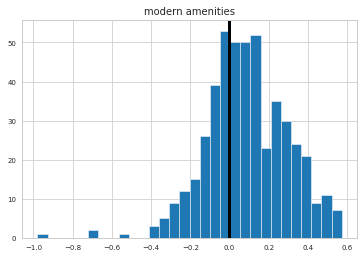

-0.006173634143611259


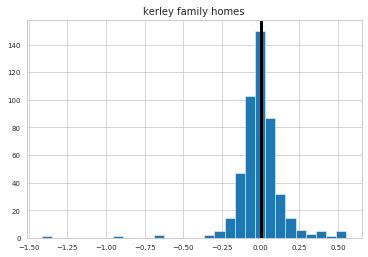

0.013642746403414912


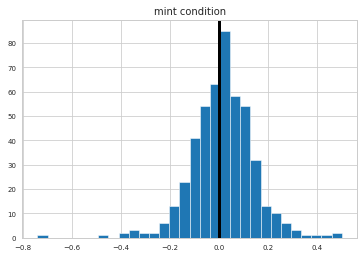

-0.017946361441528697


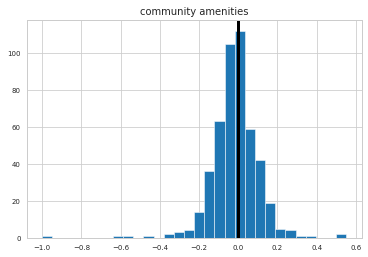

0.0005174686191863872


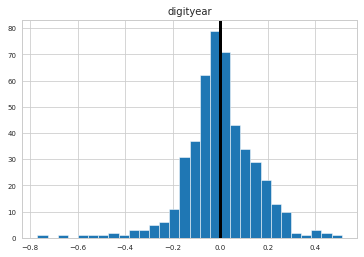

0.02420247689771428


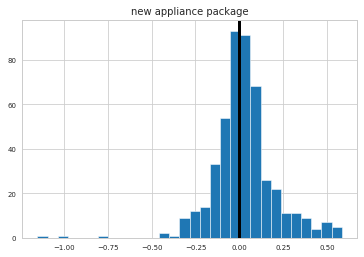

-0.012730504592408926


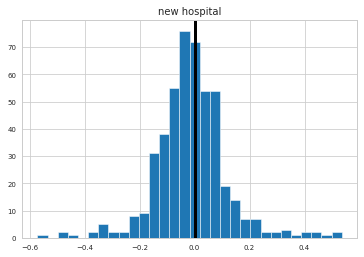

0.003521213838574446


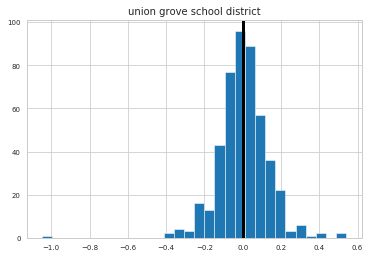

0.016478880426429855


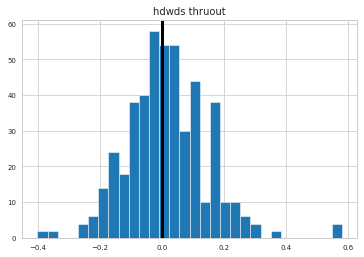

0.012378195369543807


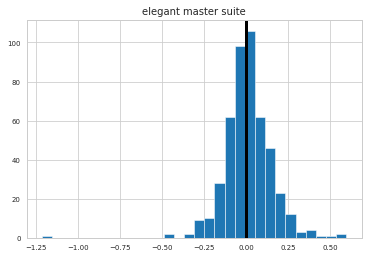

-0.022672255983601636


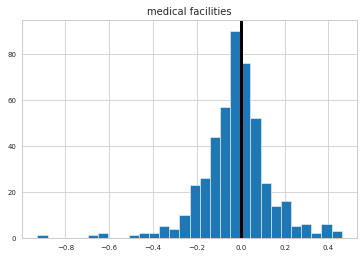

0.010135756405909874


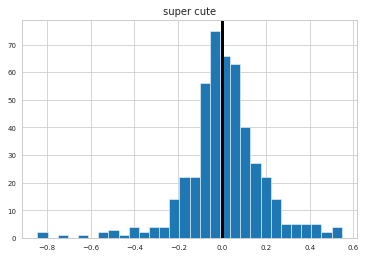

0.038071891281000976


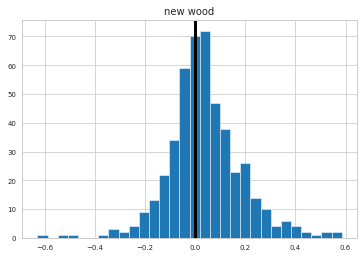

0.009413960320289244


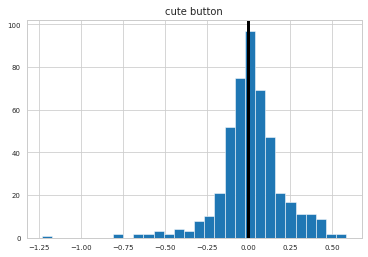

0.005054617681972931


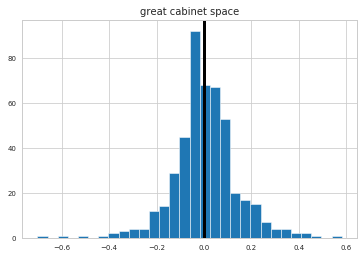

0.024015857977811587


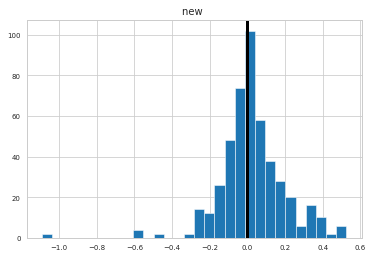

0.046508454266996666


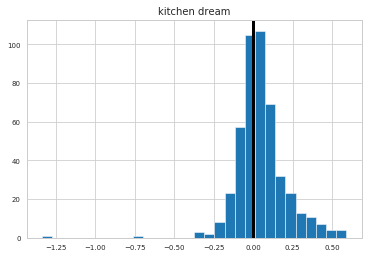

0.05906603272606996


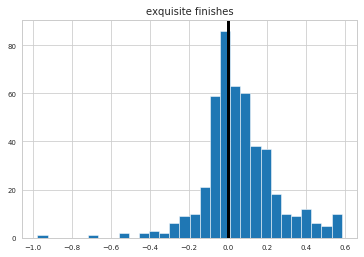

0.003265515663019162


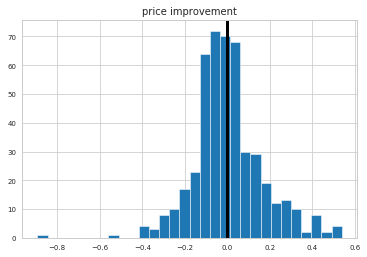

-0.001103316469424433


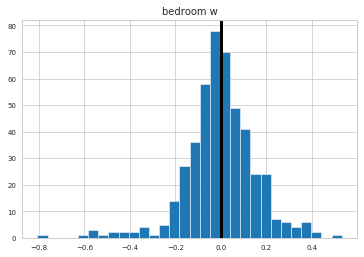

-0.005440887260393281


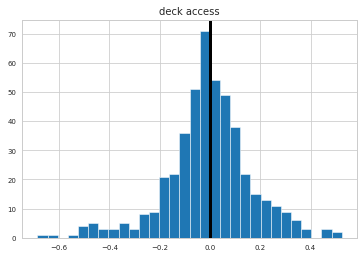

-0.012292419676025006


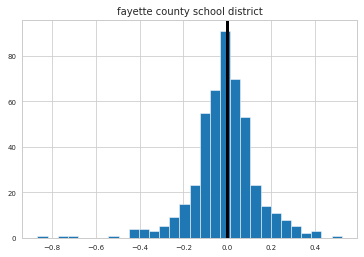

0.008439631337005196


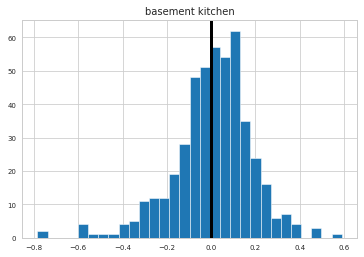

-0.020076409451655706


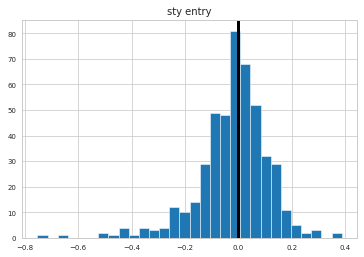

0.012897098061918818


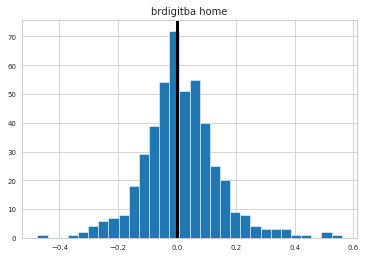

-0.013712336374676164


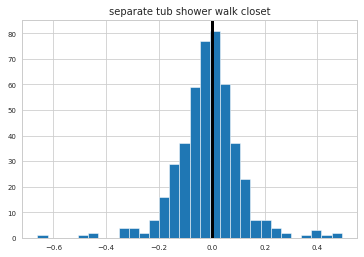

-0.006177631813821502


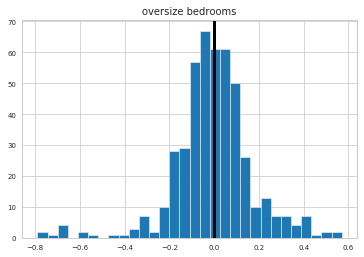

0.0031285686980446962


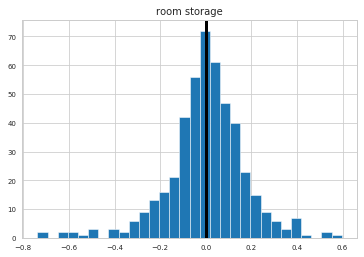

0.0003621649209937167


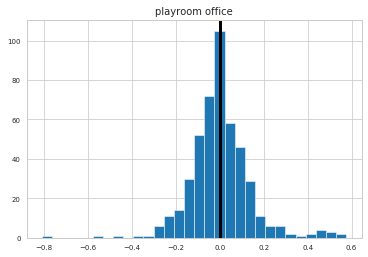

-0.0035783497255308817


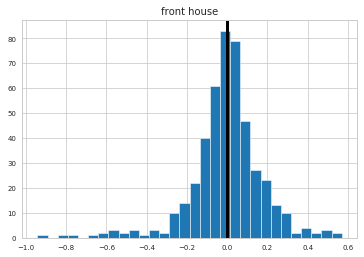

-0.002582325054389838


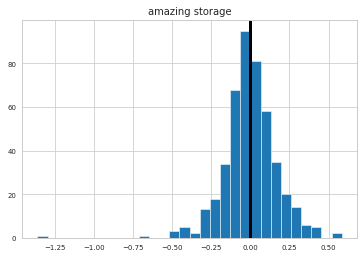

-0.024983709958940937


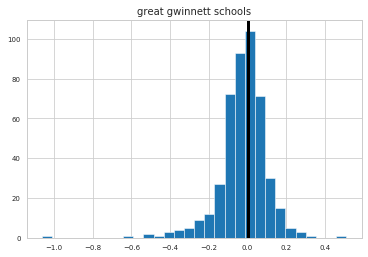

0.040421908340150366


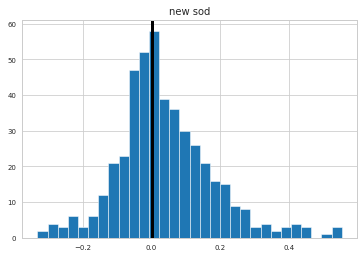

0.05536541406420714


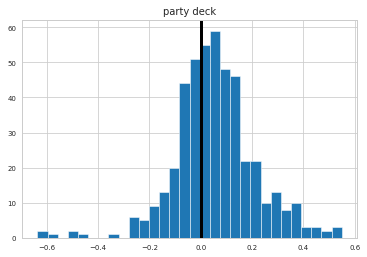

-0.028026439677039185


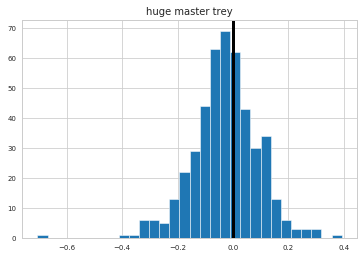

0.01788810135894785


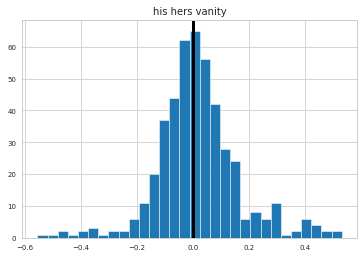

-0.011110268028085438


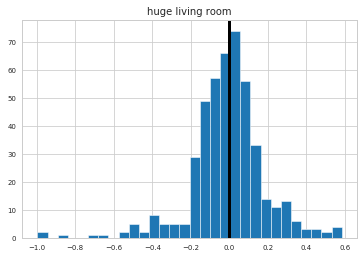

0.03811902114211822


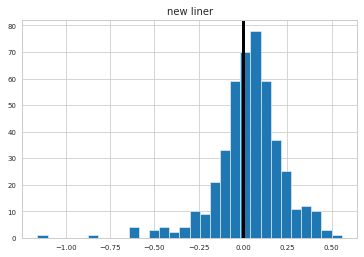

-0.003496191486655392


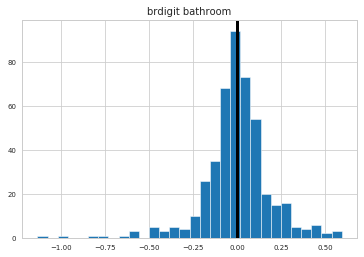

-0.018198102988521172


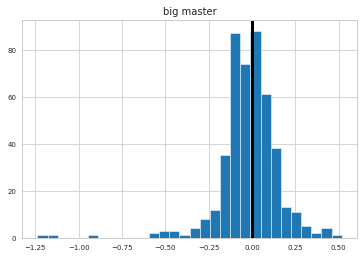

-0.033359875411767256


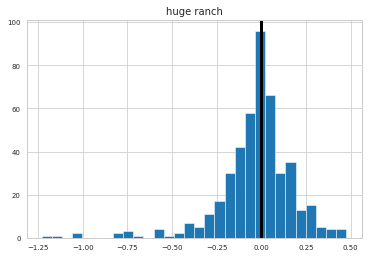

-0.01793046844802663


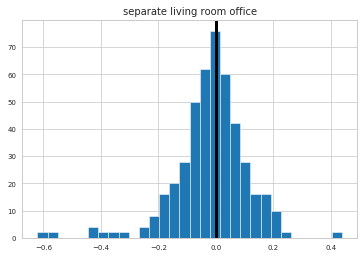

-0.02962434895704945


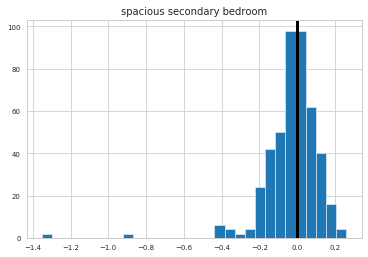

-0.012438036983145632


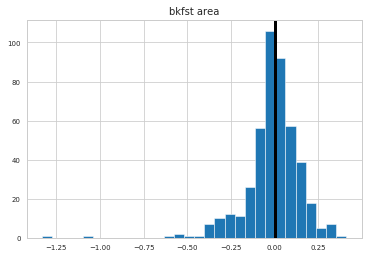

0.014991102880839956


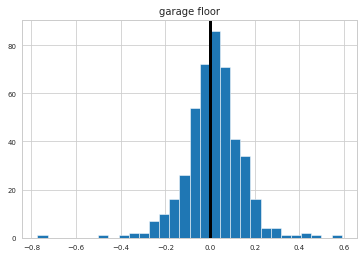

-0.028338287735049122


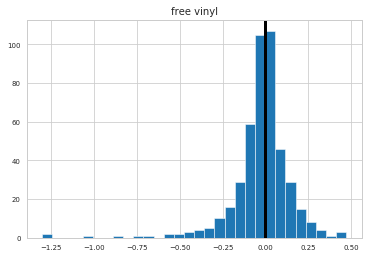

-0.016531289750648052


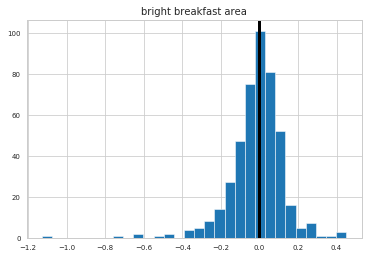

0.026215839917688093


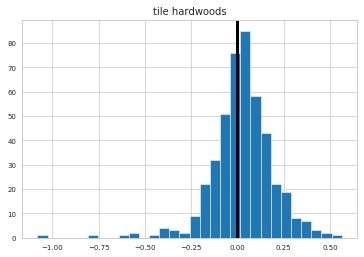

-0.006180403011495038


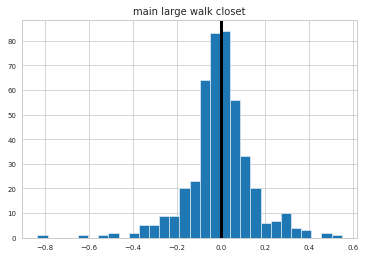

-0.0016590356657805196


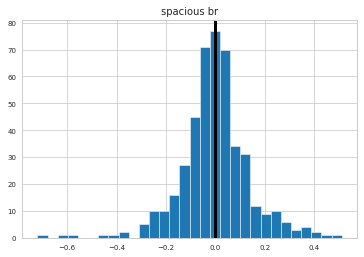

-0.02243639638847443


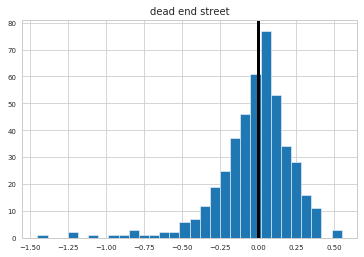

0.026516115311739717


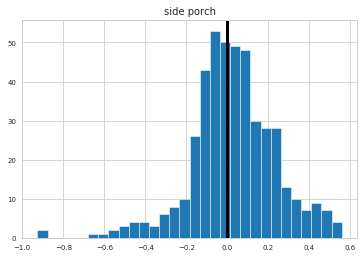

-0.0045834891605957455


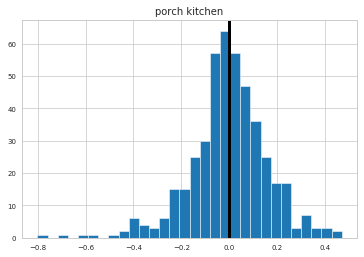

0.0337963340755289


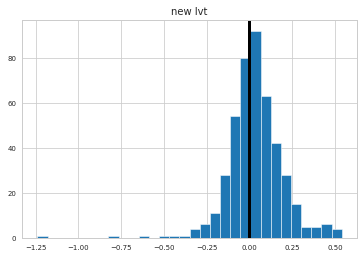

-0.0004930354345781689


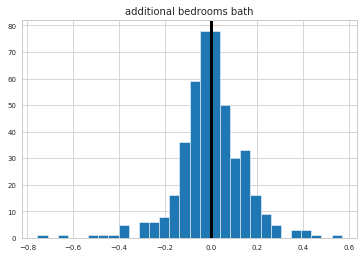

-0.006840011546880442


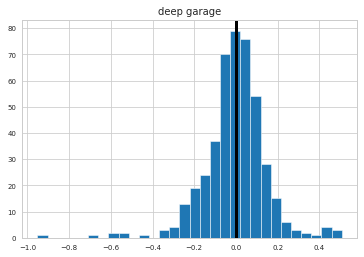

9.671893876816995e-05


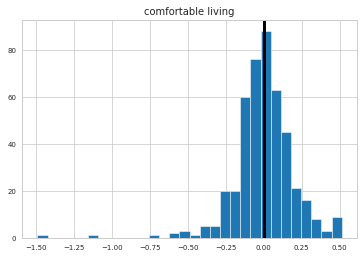

-0.013195208780813605


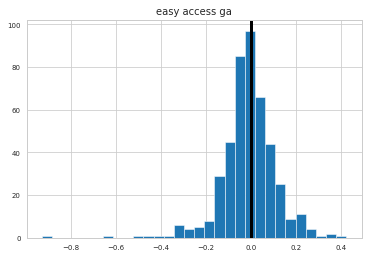

-0.009898279164570874


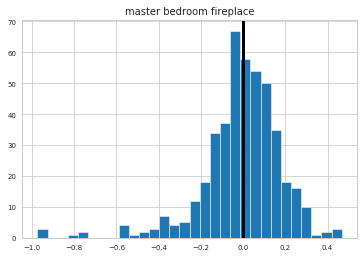

-0.02092732327542517


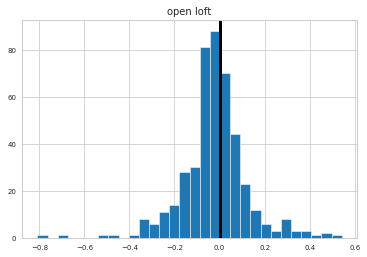

-0.01667415561276471


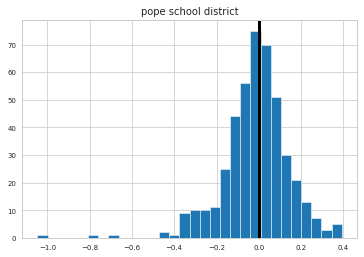

-0.008283206971757903


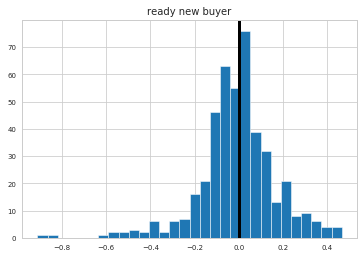

-0.0011865210740805107


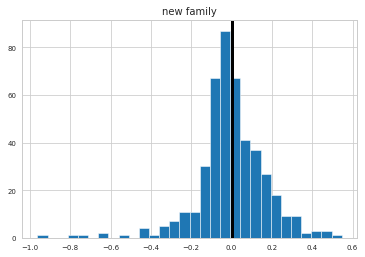

-0.022017706509492665


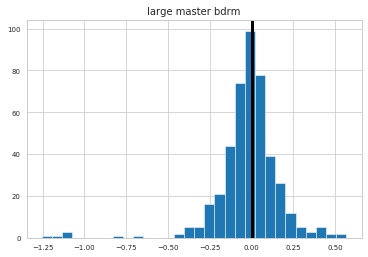

0.00037116741893786714


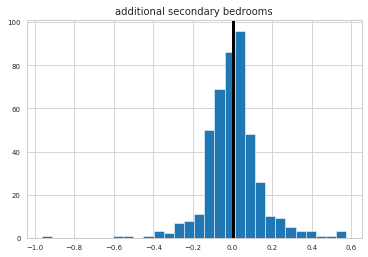

0.05406668218360079


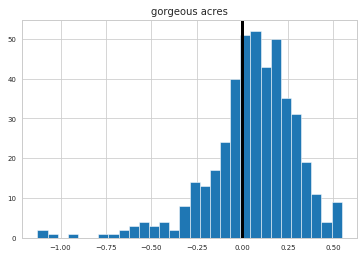

0.01756705622079002


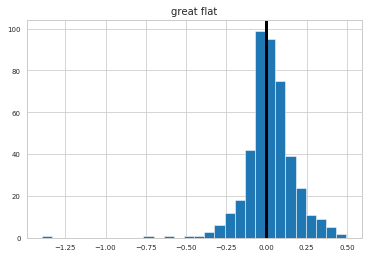

-0.011792180835010425


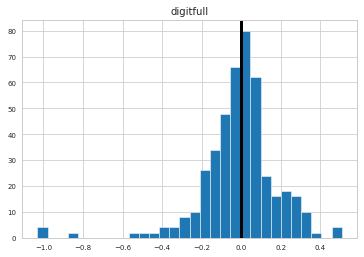

0.06118118235713281


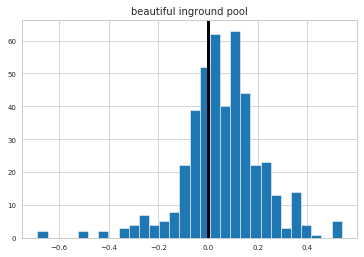

0.048205964726258994


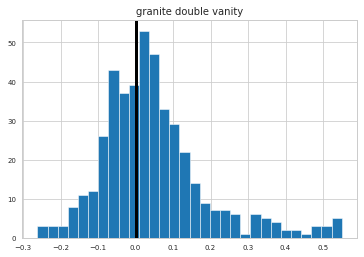

0.033300711971791824


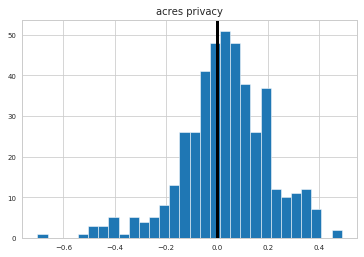

0.004060461931638865


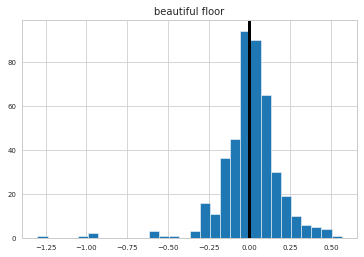

-0.011588559200054508


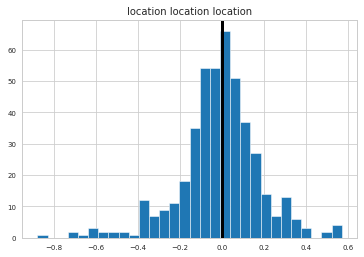

0.007961612800618008


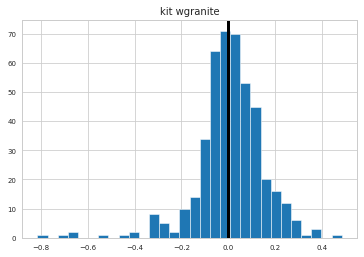

0.01098330088997185


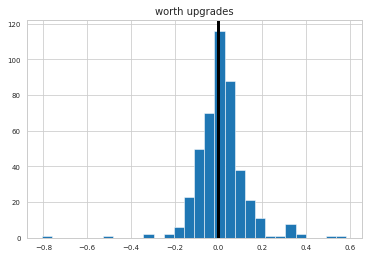

-0.008673070438744488


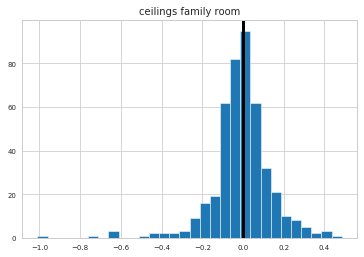

-0.01652098384428132


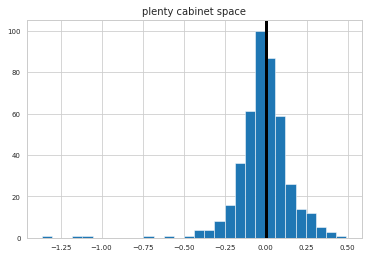

-0.006618565428023718


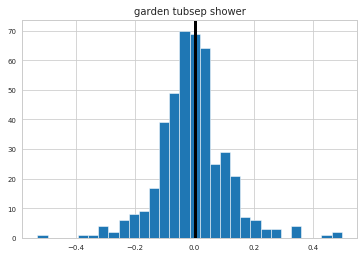

0.025618086960214115


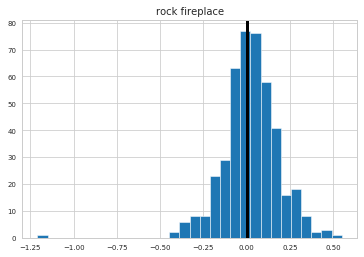

-0.01556228511567797


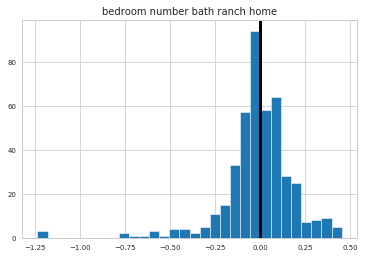

0.028826842971484922


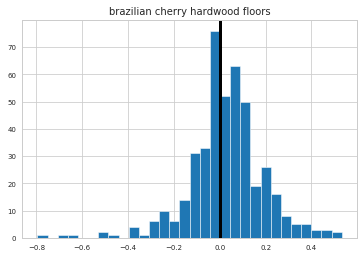

0.003481010687188064


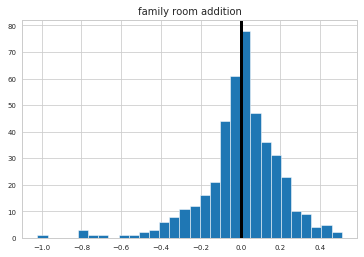

-0.0007963010602097192


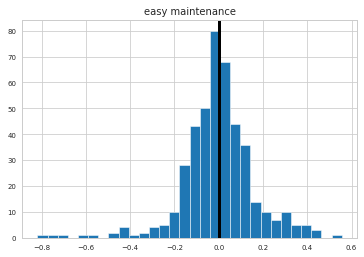

0.005037026947780283


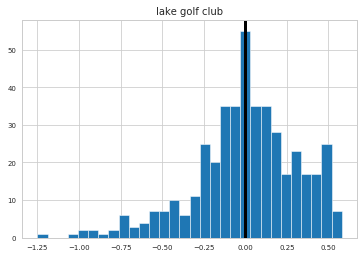

-0.003308816648105499


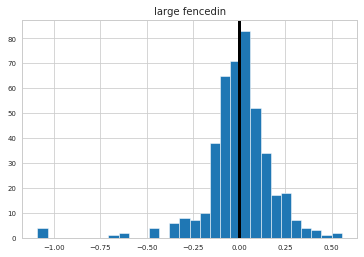

0.017140202143438876


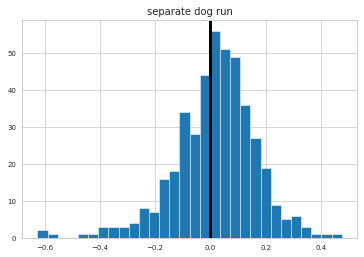

-0.009781162445908992


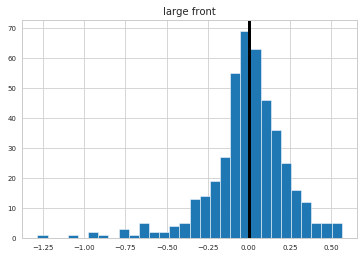

-0.019683987835210737


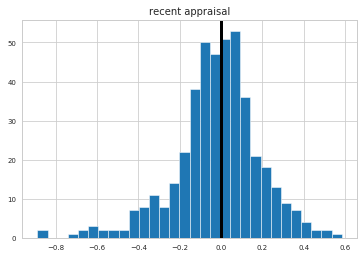

-0.0045885045447606


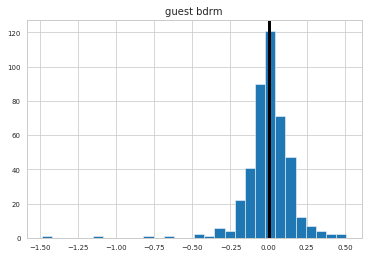

0.10415759225435464


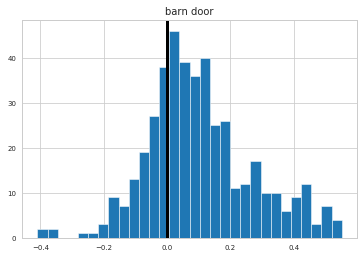

-0.009465971717291442


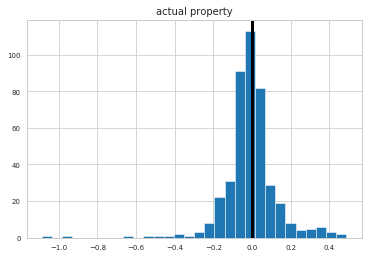

0.012425572454244856


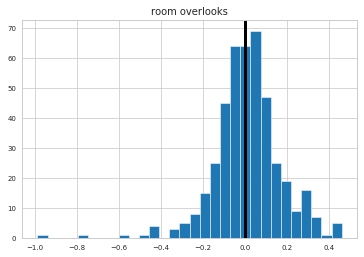

0.01752658745997327


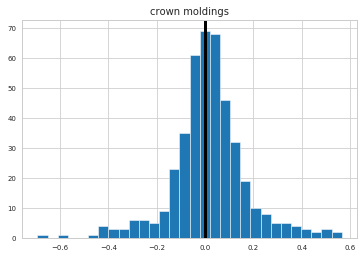

0.04977609813512894


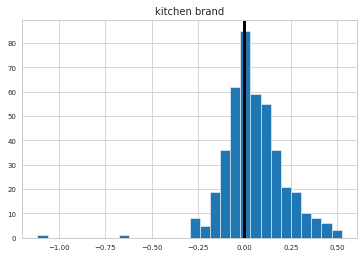

-0.009443511230616356


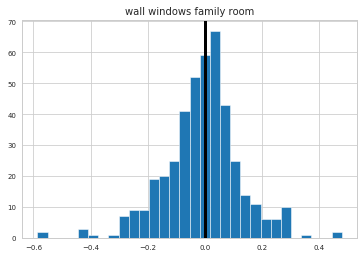

0.00266823715355994


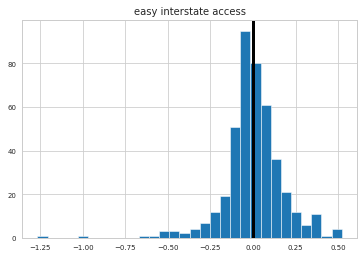

0.015602707621152725


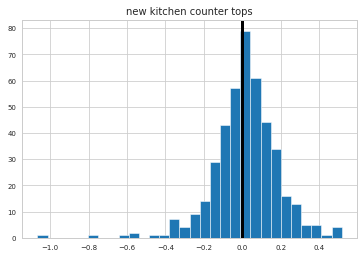

0.009908742162672212


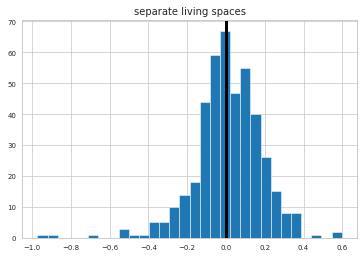

0.009814605991770654


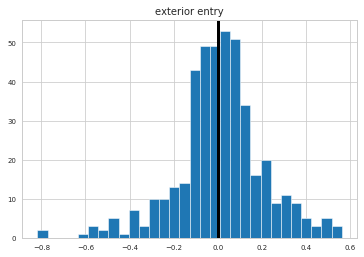

0.0006558198435020994


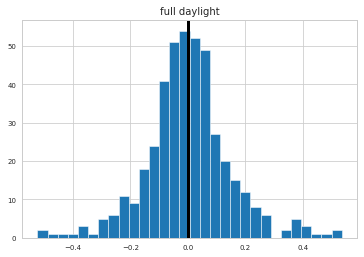

-0.019069127341528696


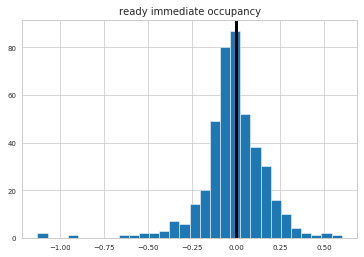

0.010402714802015453


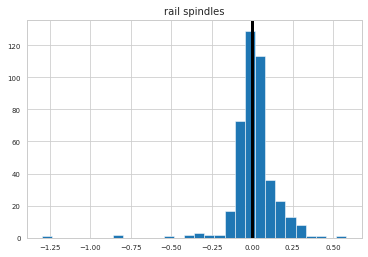

0.028628104679071294


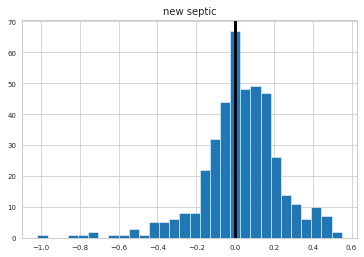

0.020079803761092457


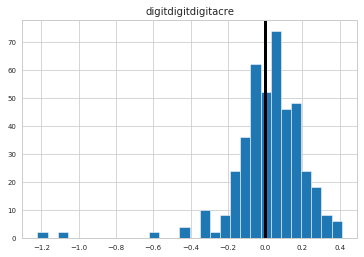

0.005086802709124991


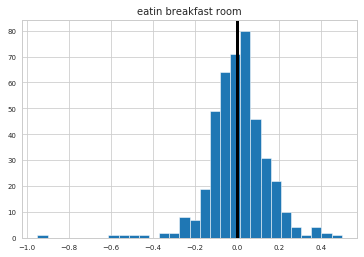

-0.01748891563203719


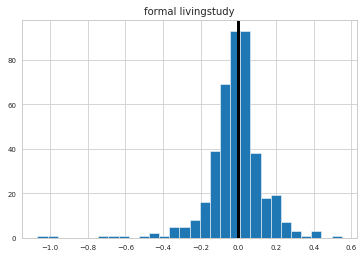

0.02710981205140648


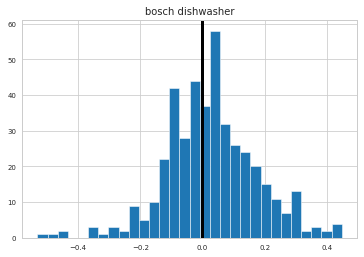

0.00188514530067591


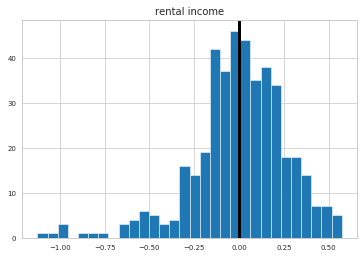

0.023771400915063443


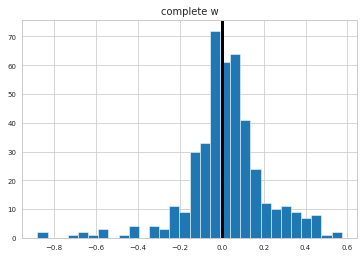

0.041590365631414244


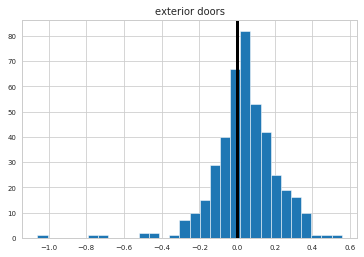

0.037041572346693946


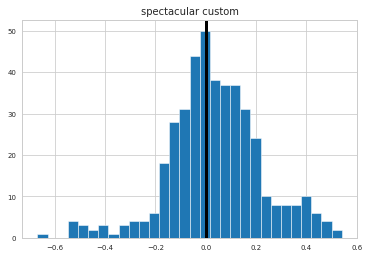

0.025018337355198324


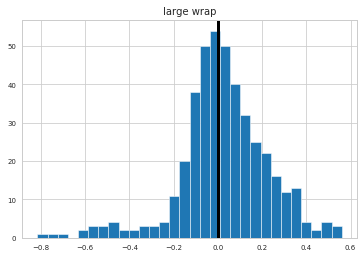

0.0002714558314735201


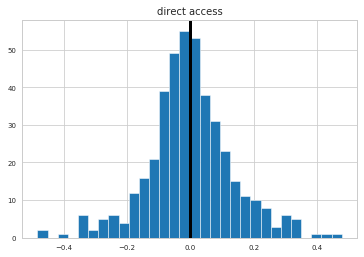

0.0030946008860615122


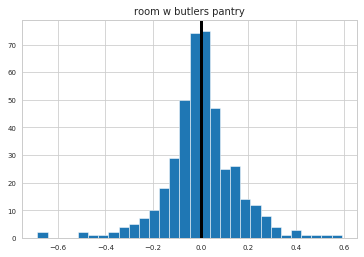

0.0039484697270700374


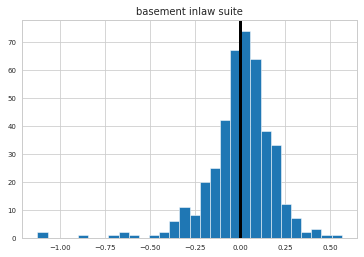

0.031297973256338776


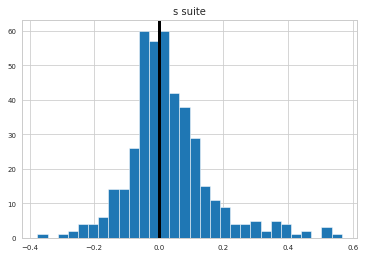

-0.0039443620010497496


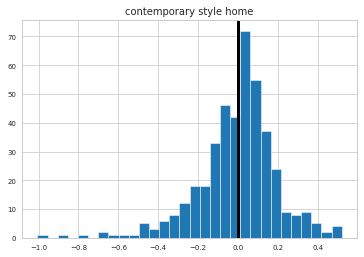

0.011027494991087535


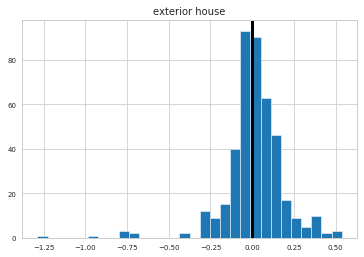

-0.008721826647361696


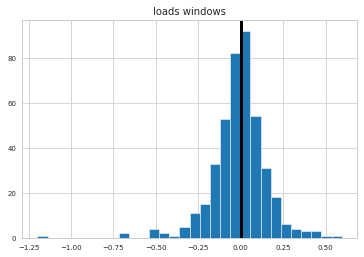

-0.03591376004928169


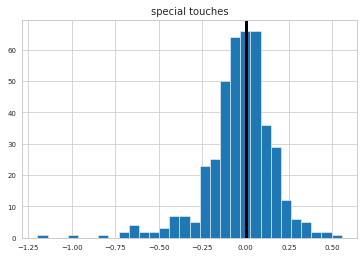

0.0016044581293975194


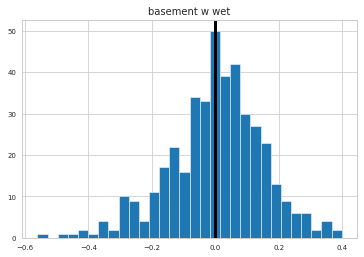

0.051291030497861066


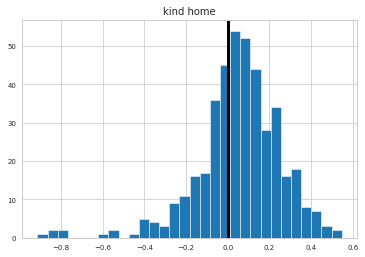

0.005412757651028245


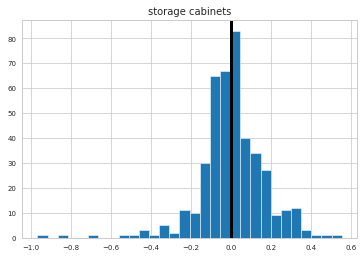

0.023011156123143417


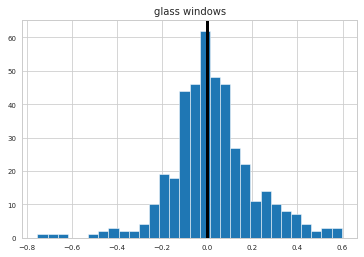

-0.00662509072492755


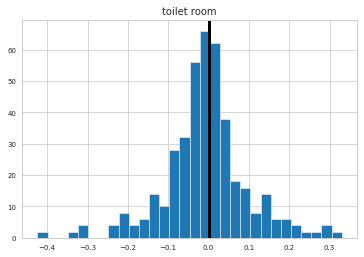

0.07615861126975579


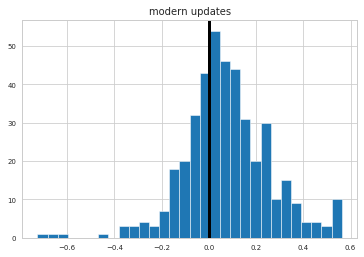

0.03146686748175597


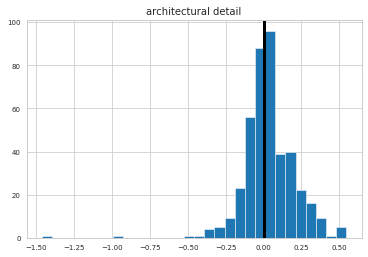

0.03574030442077337


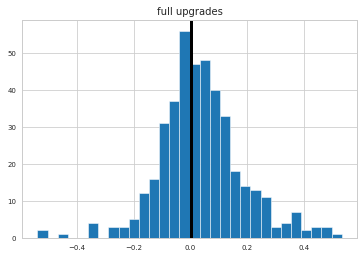

-0.013092634778645893


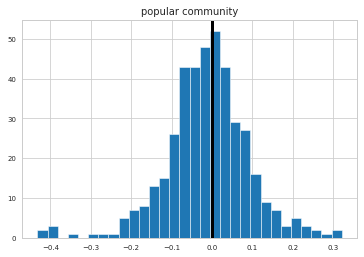

-0.005250925004402602


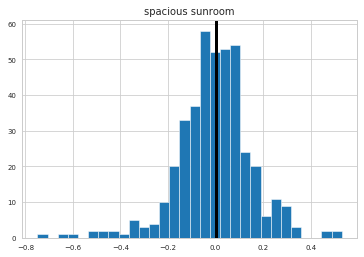

0.007096382176733982


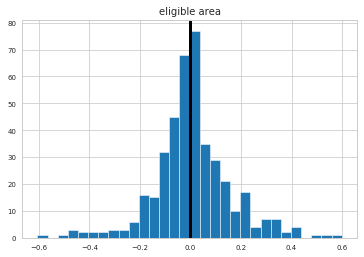

0.012788852410147933


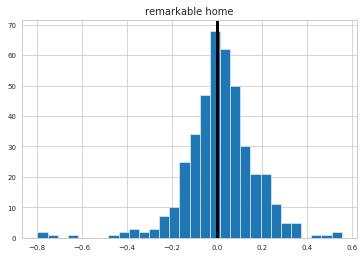

-0.006367113994478179


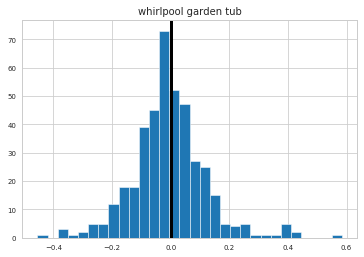

-0.0607843074222574


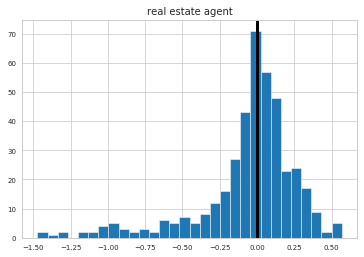

0.0022005246830404048


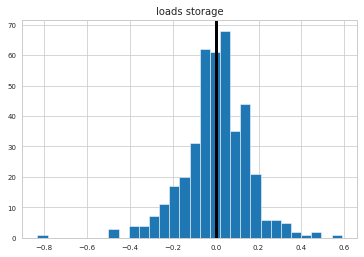

-0.01336894747254886


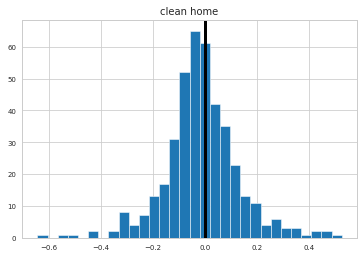

0.020360685553420133


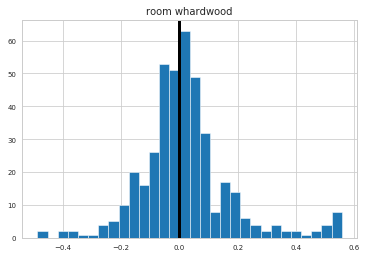

-0.009041342301037938


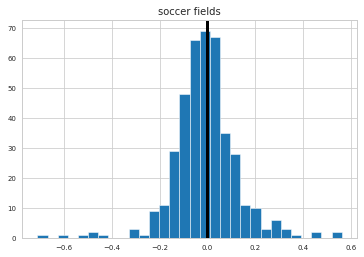

-0.023110129850098762


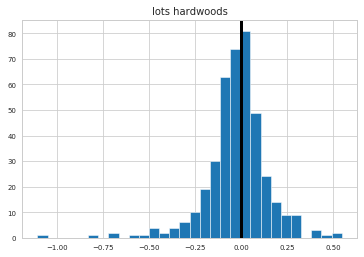

0.008778484713900156


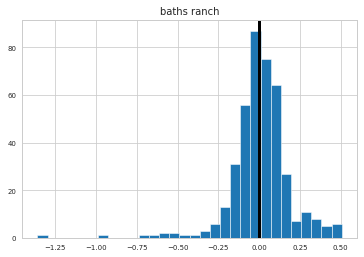

0.0554305421601254


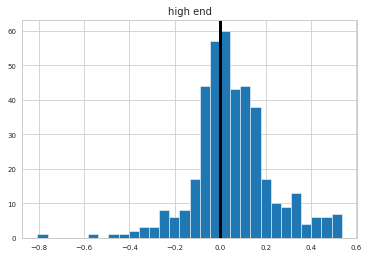

-0.005599630851097924


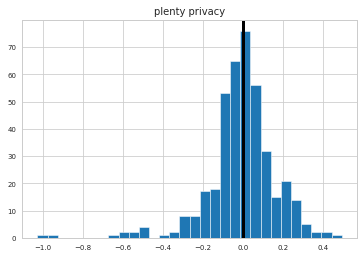

-0.016956751325874545


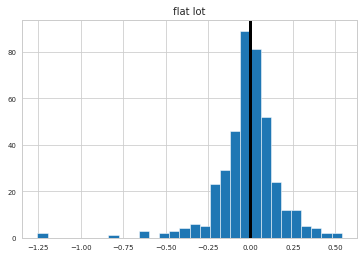

0.013613577899531054


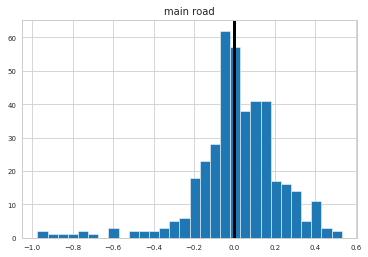

-0.003438559353367073


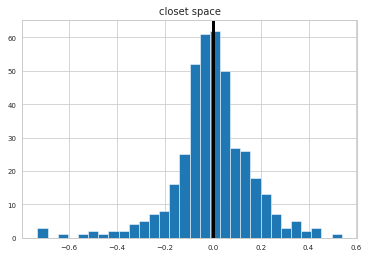

-0.012893071551199465


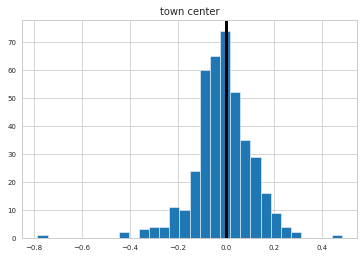

0.00032855113473049695


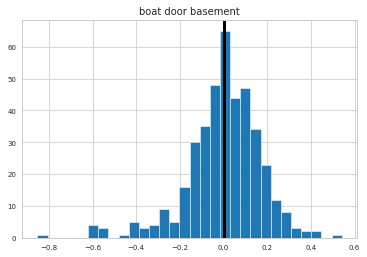

0.036720390551180745


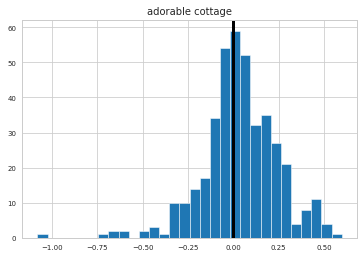

0.010524744280646555


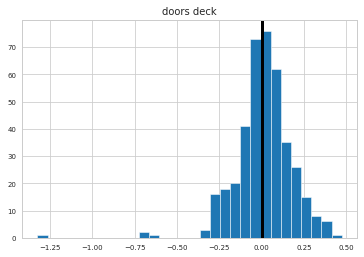

0.017774303133142443


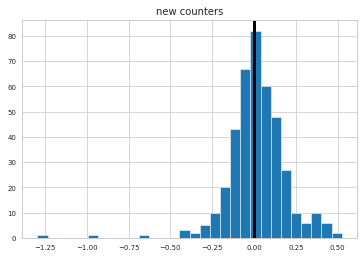

-0.027337598134482978


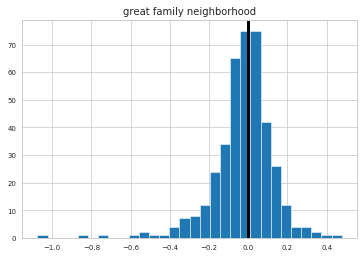

-0.017080882086425494


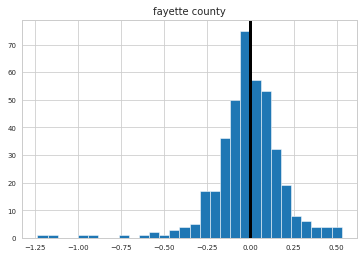

-0.00506323076745505


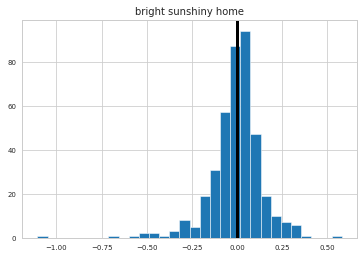

0.06658749920224531


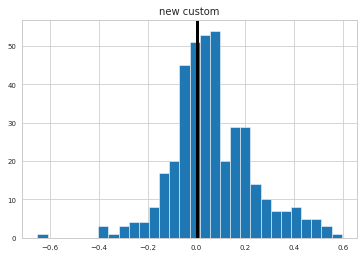

0.04050673441947304


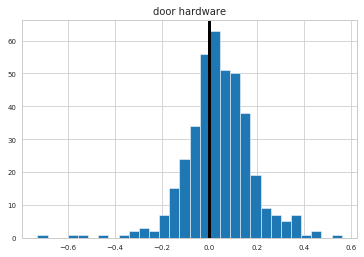

-0.0003375148068011061


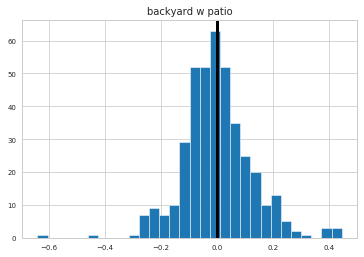

0.027337744000354155


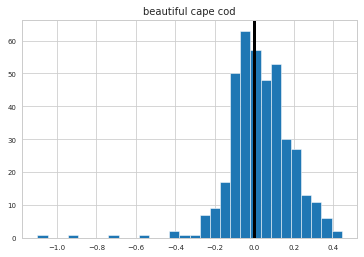

-0.006724995288850167


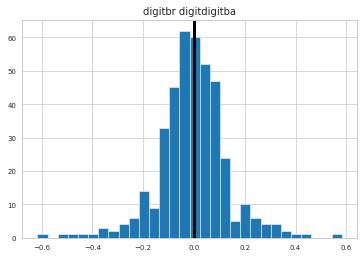

0.004956655156510776


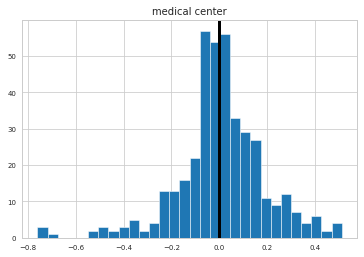

-0.00040245743634362177


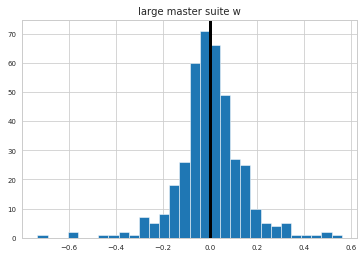

-0.0132396230038691


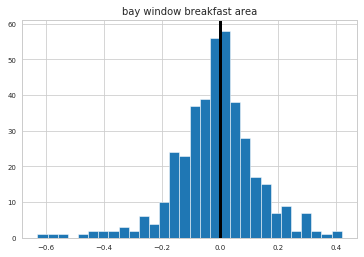

0.001624220931866862


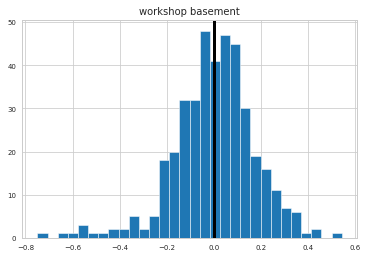

0.012199224810704344


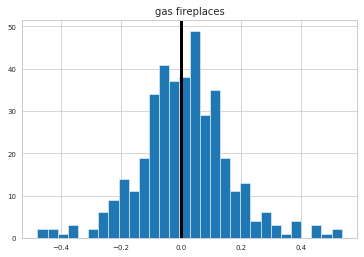

0.007351460844462372


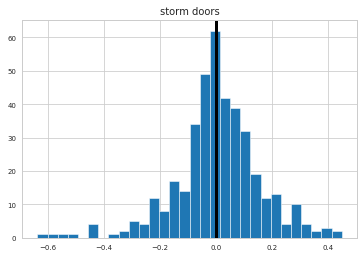

0.005260509415677623


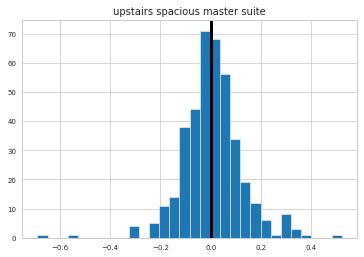

0.010168089009720912


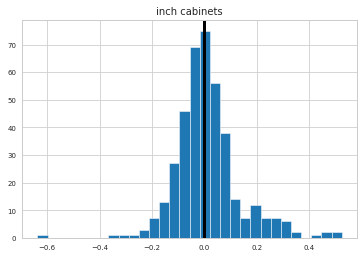

0.05775326367833951


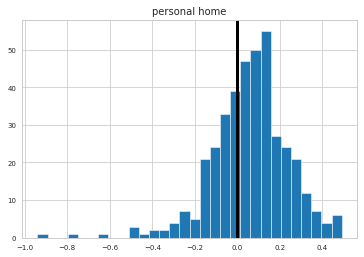

0.029114848972400815


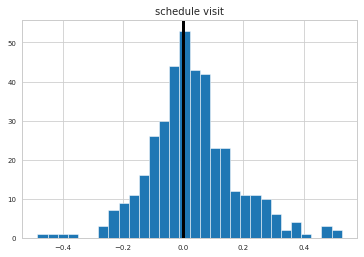

-0.005263622594765254


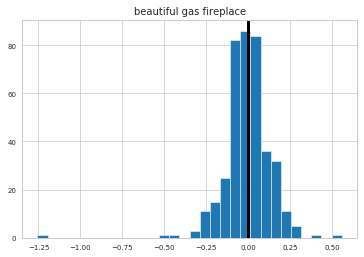

-0.017586094131940056


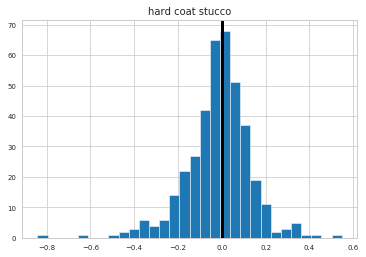

-0.007399032376424978


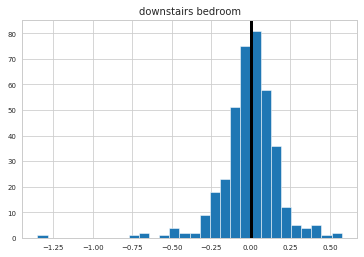

0.05260639239019823


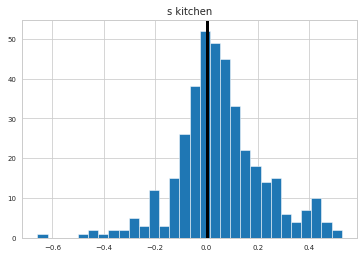

-0.017447688279267813


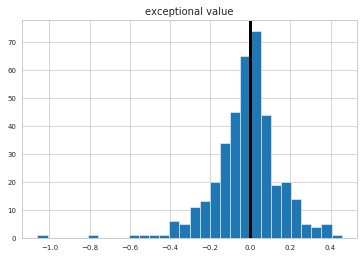

0.030550037890271622


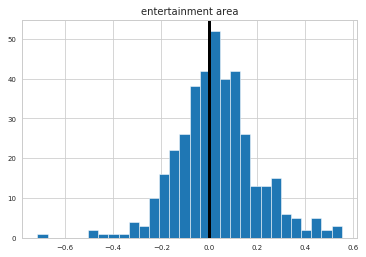

0.01081586346761521


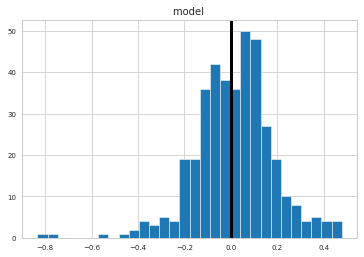

-0.008083076810793607


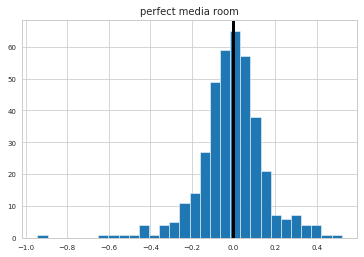

-0.042413649753107324


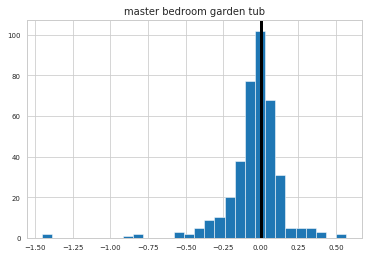

0.029044823249177905


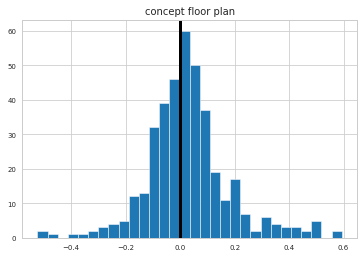

0.008095388090265259


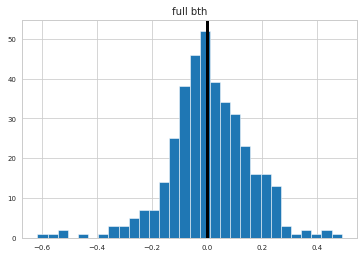

0.017292642629249157


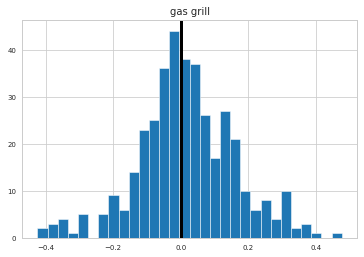

0.014695431516504735


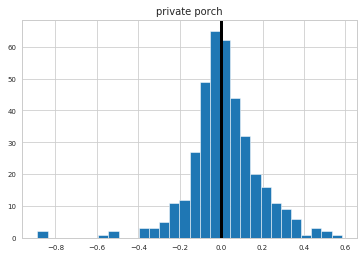

0.013283171317206395


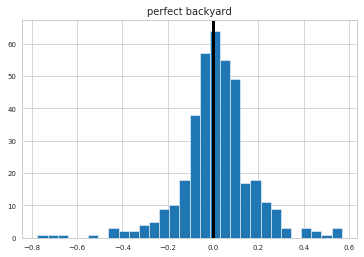

-0.002218766482247965


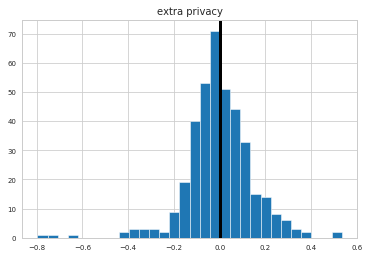

-0.009785594787978464


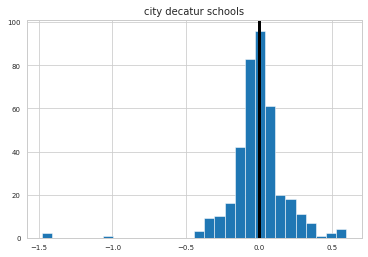

-0.012141736859270776


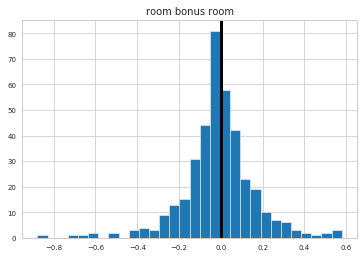

-0.0059232978208417645


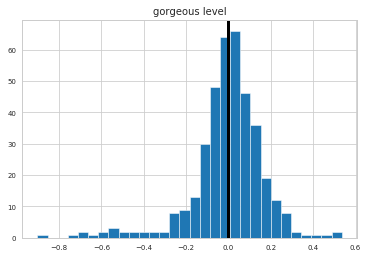

-0.007015253936147148


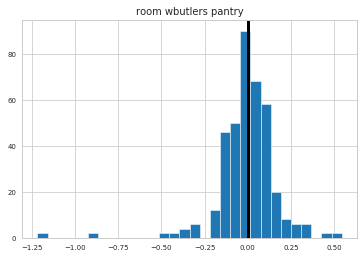

-0.0018573872023667835


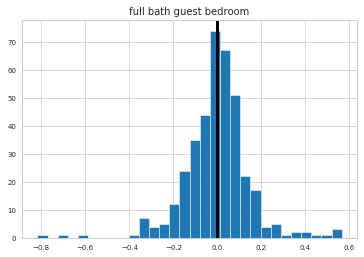

0.010156815618578086


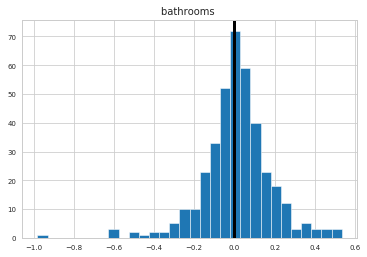

-0.017414619051503776


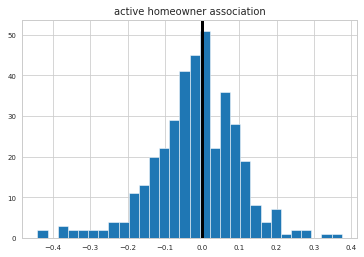

0.023410694686689743


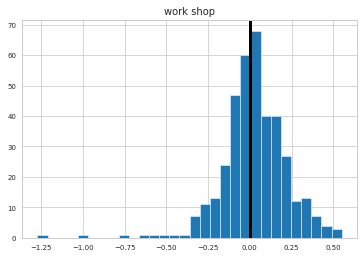

-0.004765564561192962


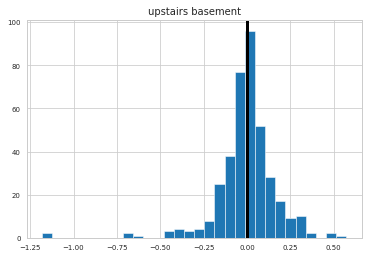

0.1052191606885646


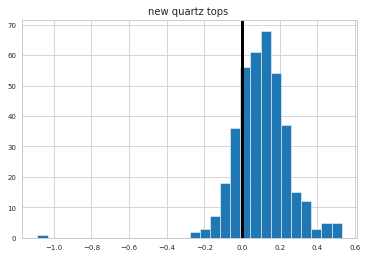

0.03144768775108316


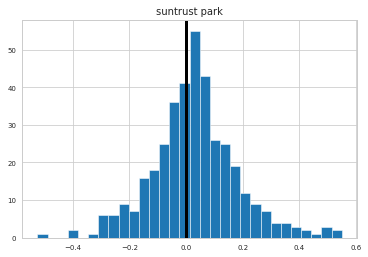

-0.003924572641420589


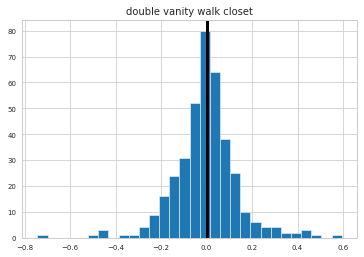

0.023151616433516136


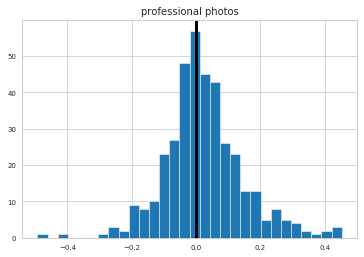

0.006709552172375479


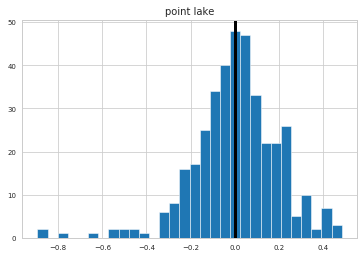

-0.0180571982632482


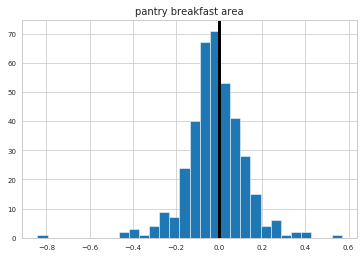

0.01879934851591781


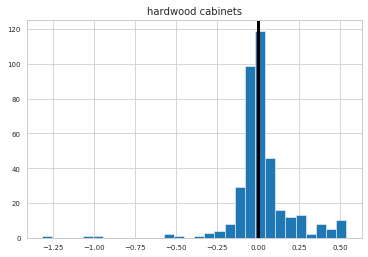

-0.02432176541202748


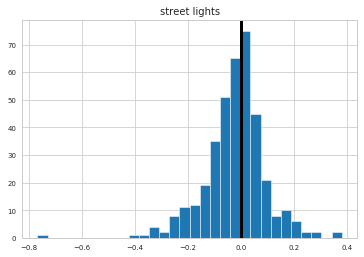

0.05482873962532847


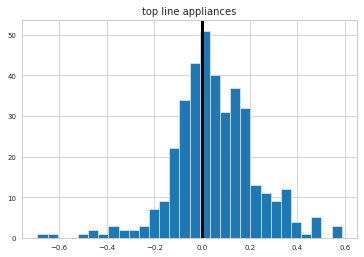

-0.010193423036095068


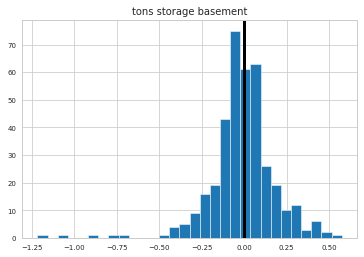

-0.005298863992461679


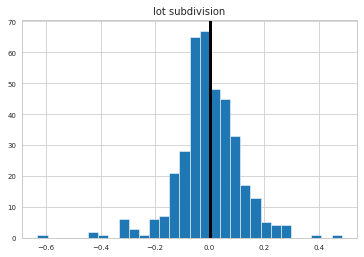

-0.015110061822155473


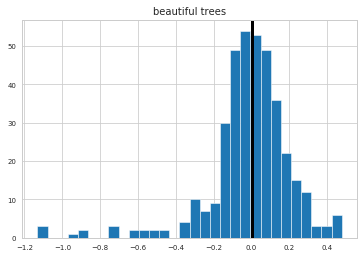

-0.0018977018200745876


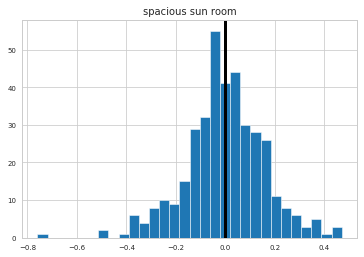

0.0387573827166481


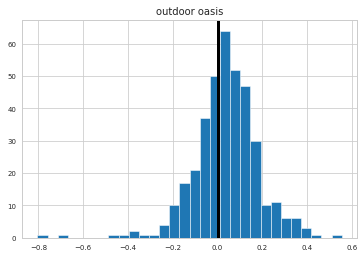

0.039747502887578785


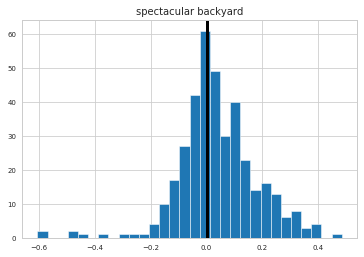

0.028314125153848797


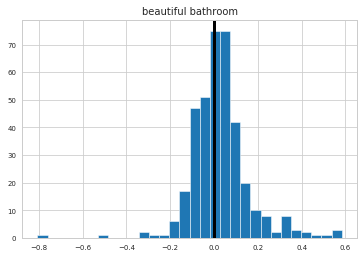

0.04473798441525802


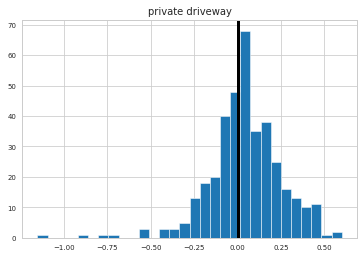

-0.0014794581282336645


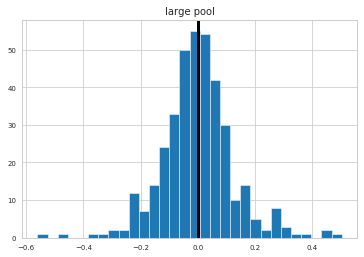

0.007813843953473294


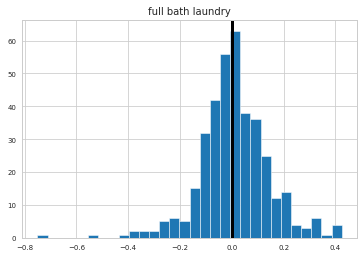

0.022883546237892013


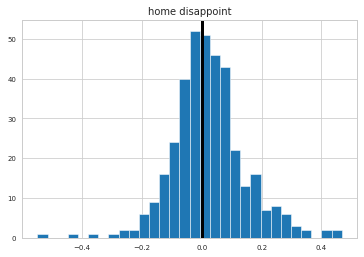

0.025286960916267514


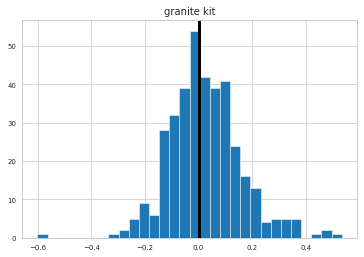

0.0018297314581578164


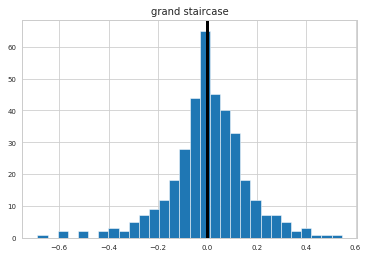

0.017619613613829653


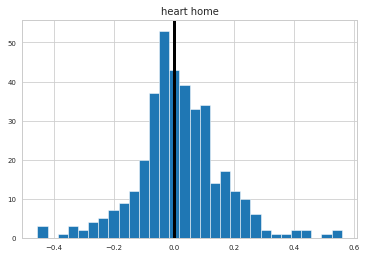

0.006313009123932493


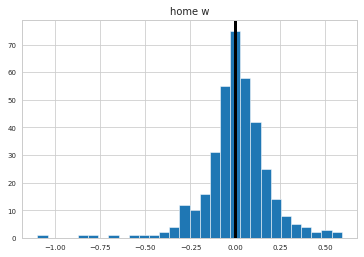

-0.00364766781142587


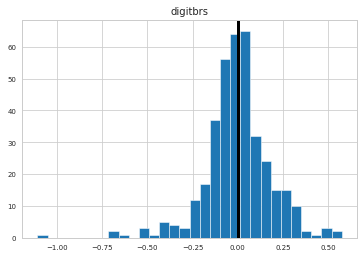

0.020515200037810214


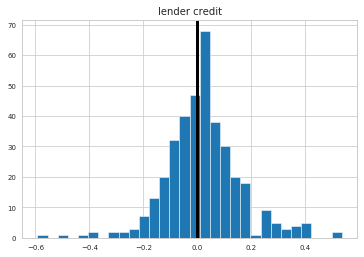

0.011760482551067878


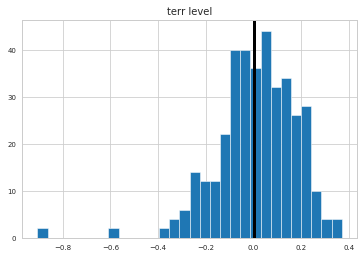

0.023472095711494365


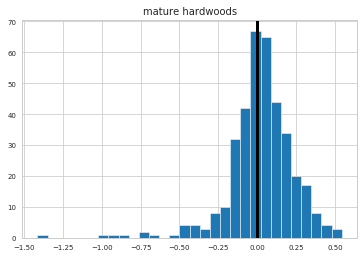

-0.0035066251351484473


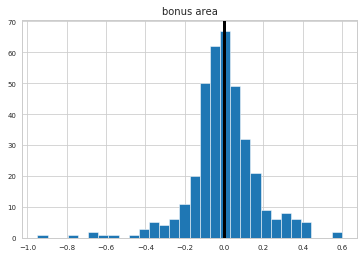

-0.007092804220076686


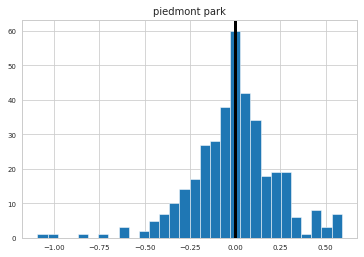

0.008161180719676864


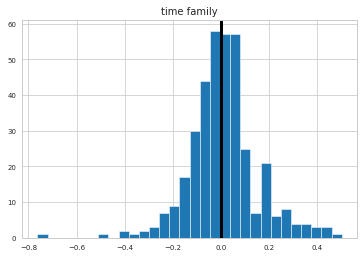

0.027131629850264856


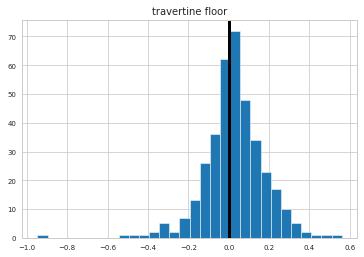

0.0047978226560824126


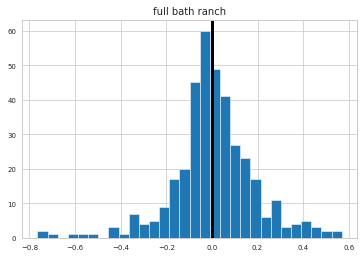

0.013216053667560164


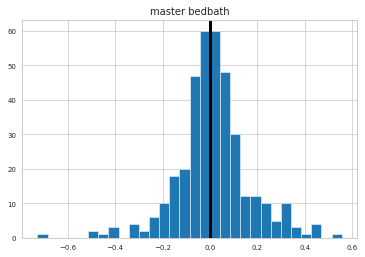

-0.0408555681747555


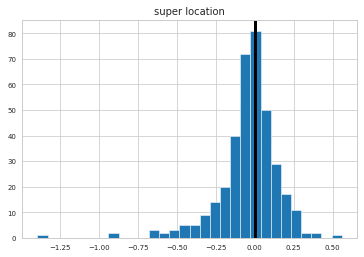

0.008039414942722657


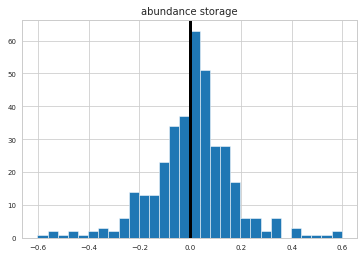

0.0008097642352870878


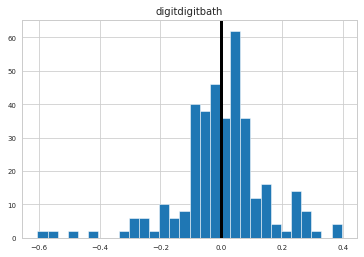

-0.1908185281771862


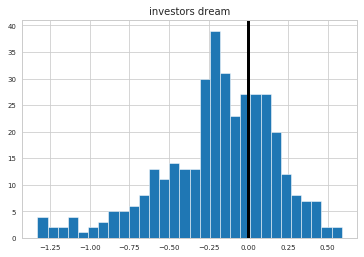

-0.019971907269657314


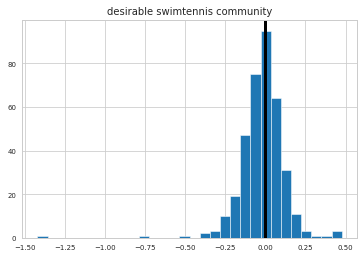

0.08687932513738149


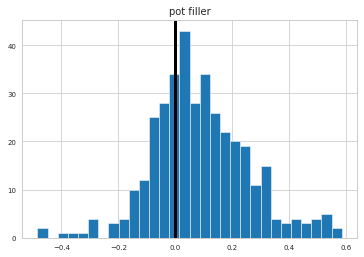

0.01427529357086268


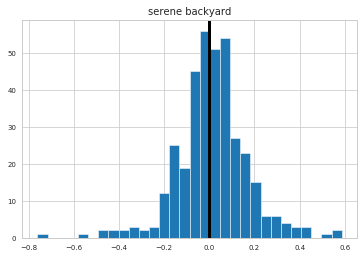

-0.007107644231145769


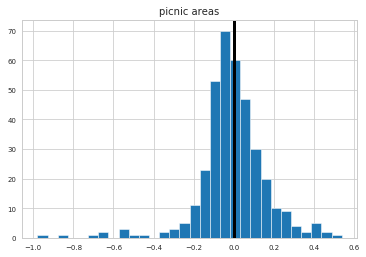

0.036060006223719965


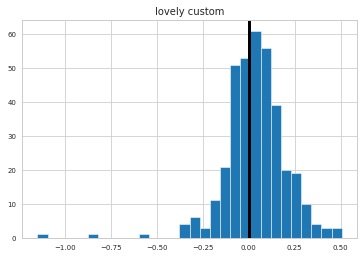

0.0012320567091229104


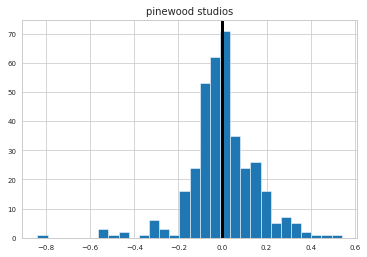

-0.000558668480429964


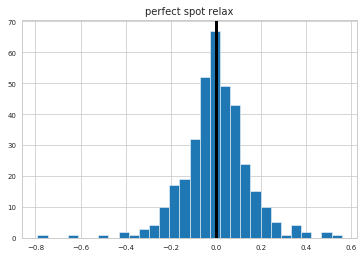

-0.0002586467728219957


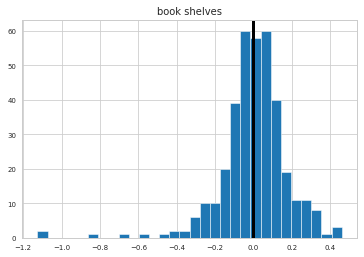

-0.0006655483054135272


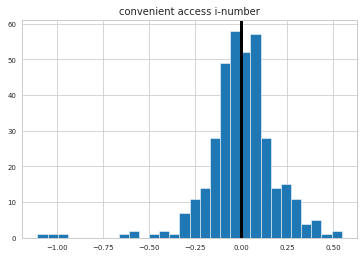

0.002147521485825275


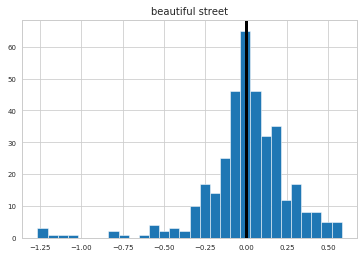

0.0367926828307288


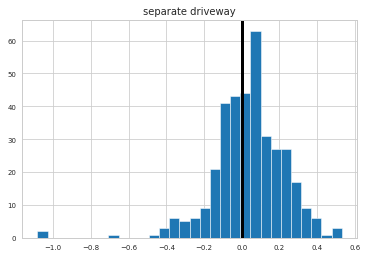

-0.011363793292731654


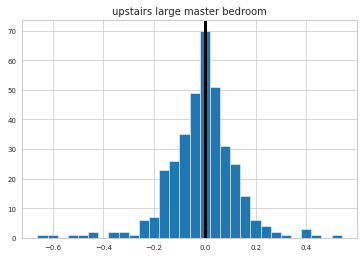

-0.011041978366104535


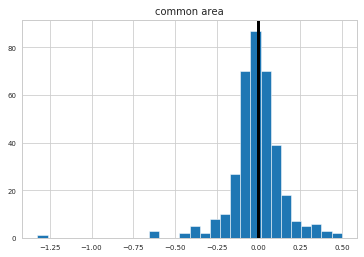

0.0170024092548795


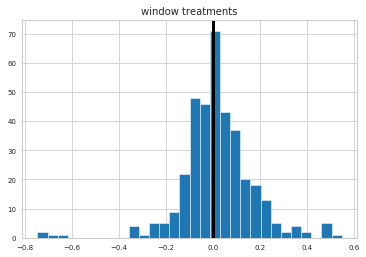

0.0026298749197989197


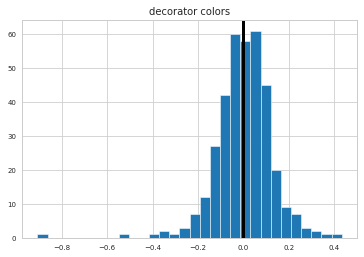

0.007120244924956956


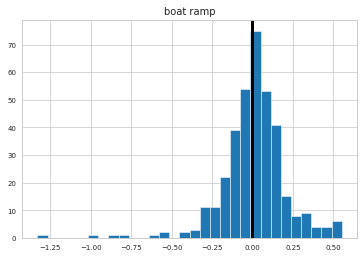

0.027093326678660032


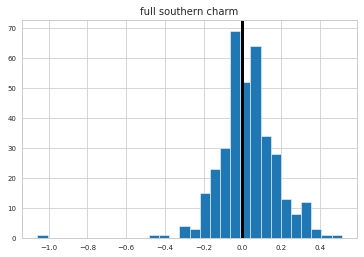

-0.024709705127934068


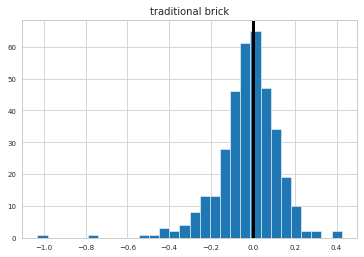

-0.014912185077314278


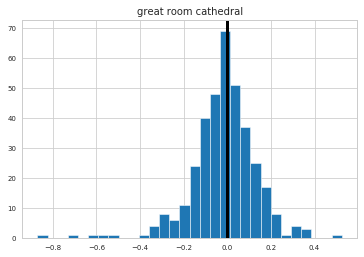

0.01822684913744479


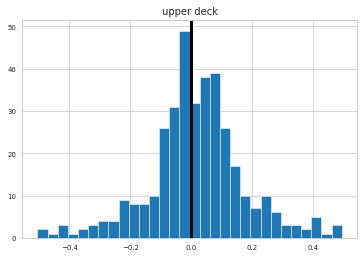

0.028513471160844264


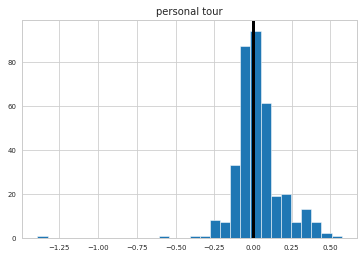

0.021042598404034517


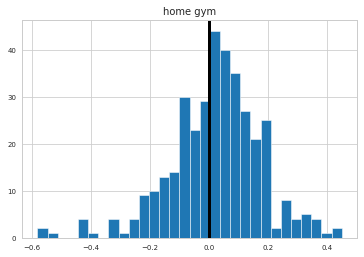

-0.03607831593384286


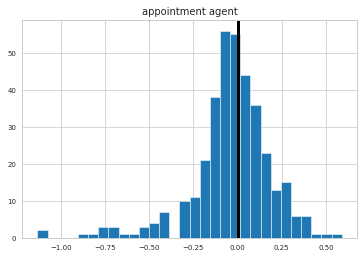

-0.02370985612922136


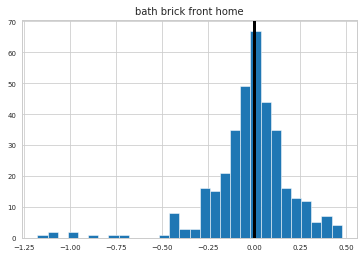

0.007838943049419235


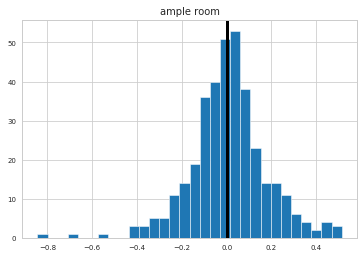

0.08147243772855263


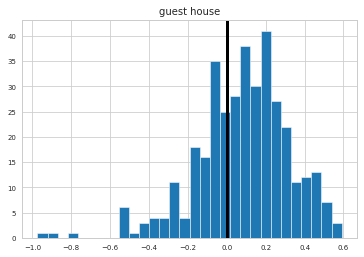

0.04179352863839678


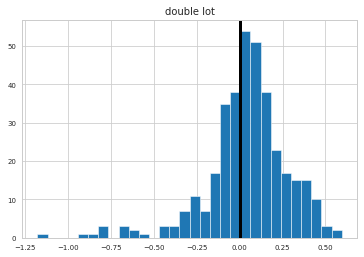

-0.0038685407450002015


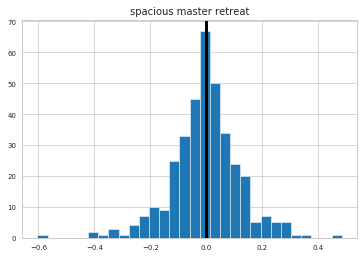

-0.004679040832628592


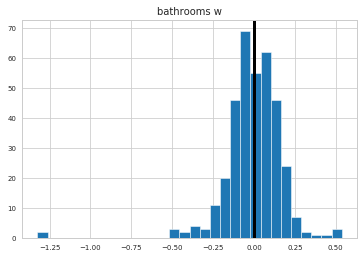

0.02257077324456832


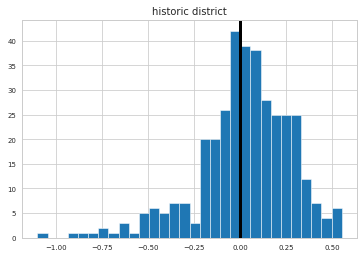

0.059166919570064536


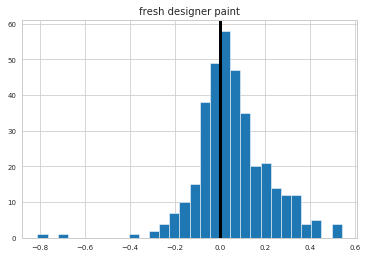

-0.02535504430593628


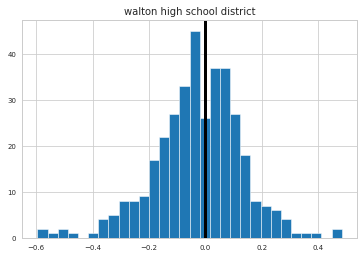

-0.005257338696288013


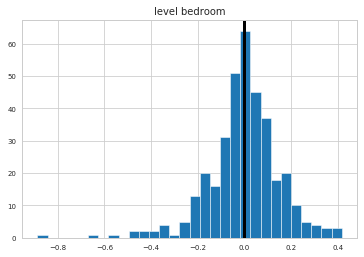

-0.02452511768766909


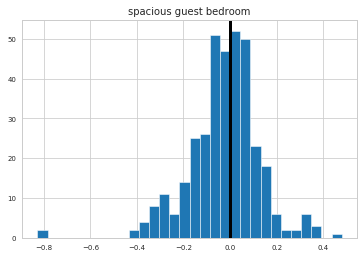

0.005917859577918911


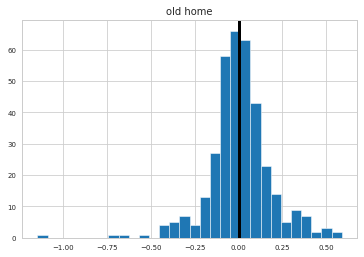

-0.0255874147224932


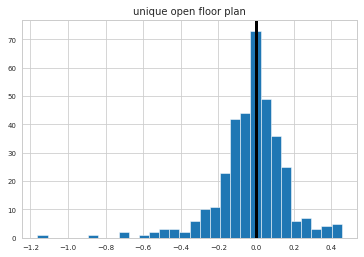

0.0076407901286148225


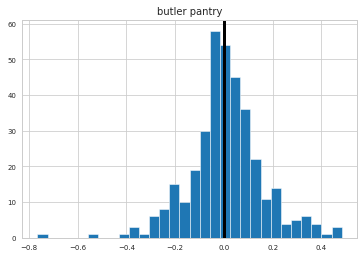

0.04640746185961729


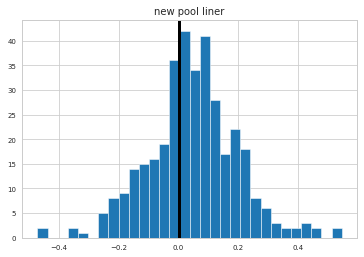

-0.005646120992079404


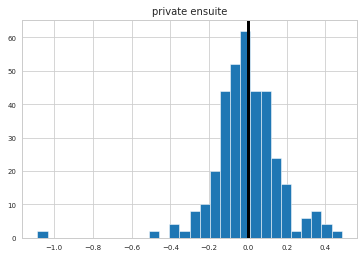

0.029735415952629827


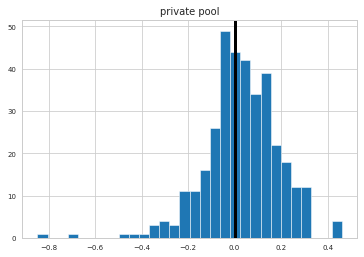

-0.016702690038179667


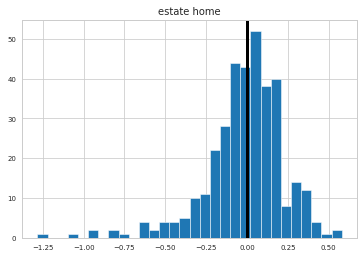

0.03413376717731107


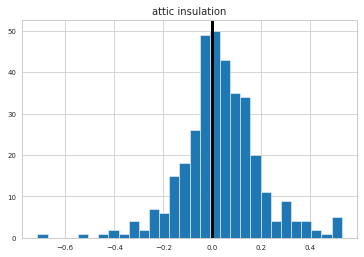

0.010207402049842119


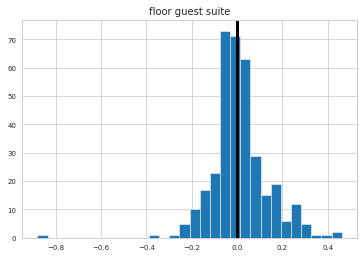

-0.013144426296299317


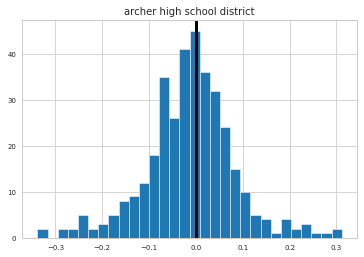

0.026008663616014716


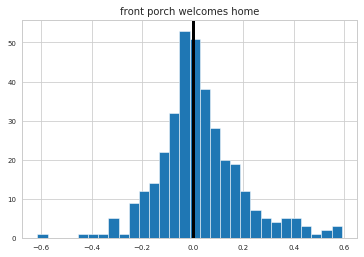

0.0188123791771934


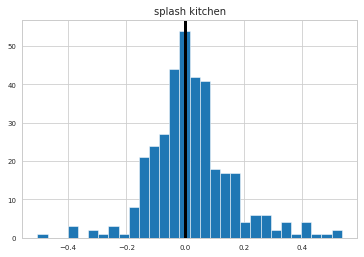

0.10980255294280428


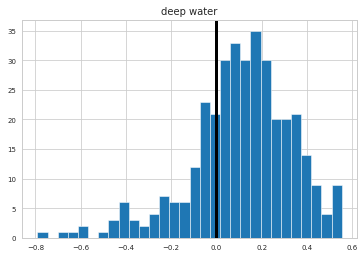

0.0282692541739142


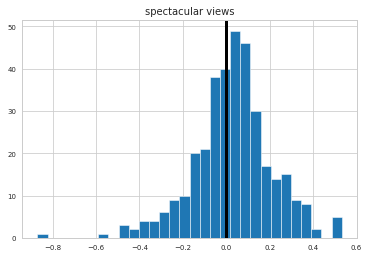

0.019140851485129506


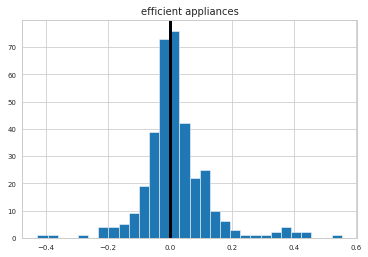

-0.11506309894660774


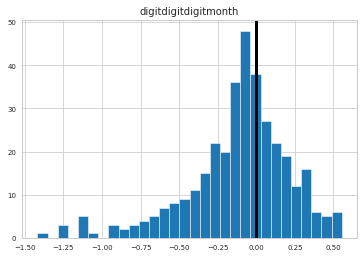

-0.013750259213252817


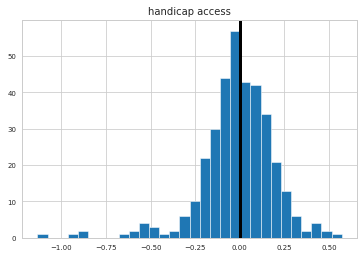

0.023490054550610318


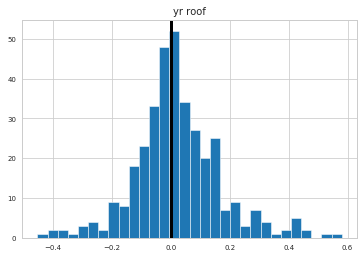

0.002233552600325158


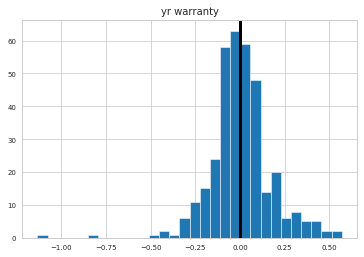

-0.030274779606206694


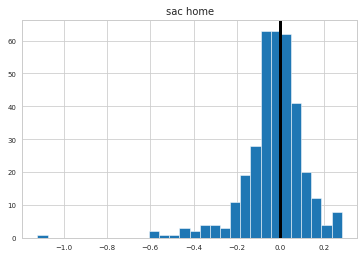

0.03180931657867916


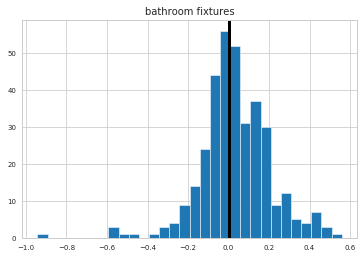

0.003062067235536695


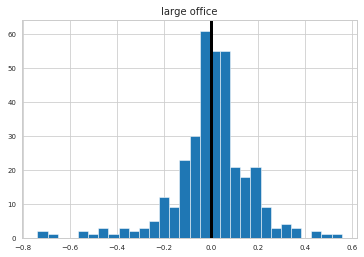

0.018477167516472374


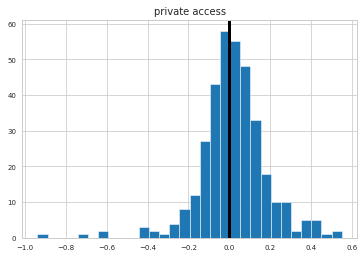

0.002545025920722863


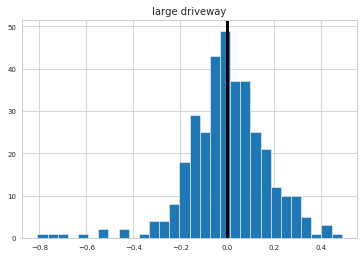

-0.014061673484539508


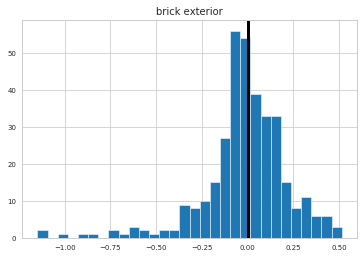

0.052204276684059914


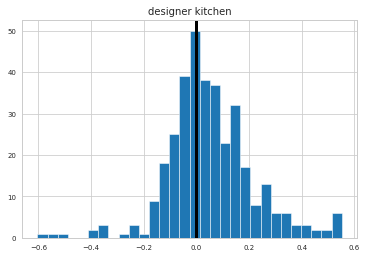

0.0036080165528325366


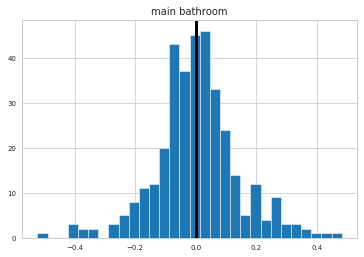

0.02748381054899247


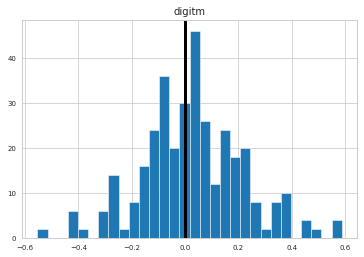

0.1184885046861219


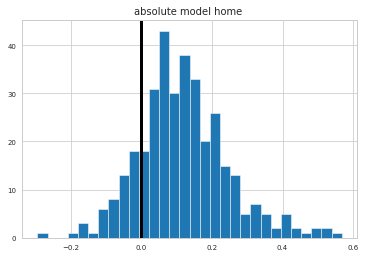

-0.010133434026862283


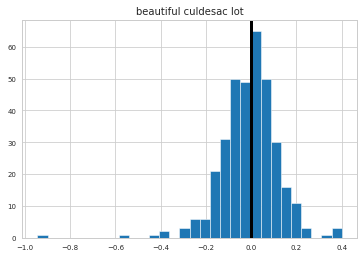

0.015130541399449379


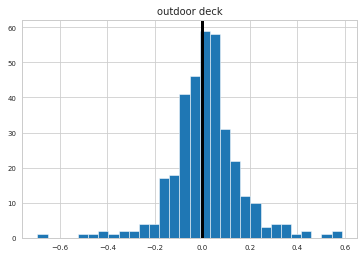

0.0321614284661928


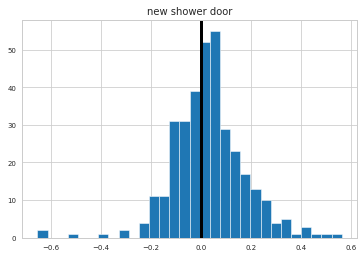

0.01375112915261543


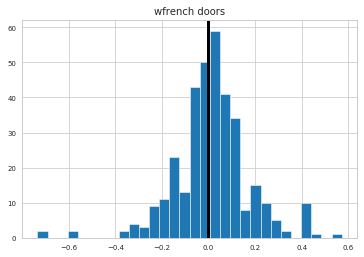

-0.19948395731326873


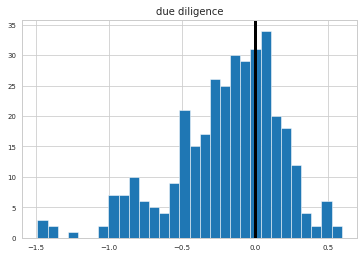

0.01776513729780881


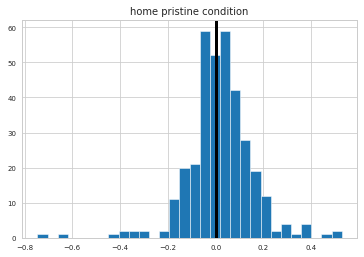

-0.016633295210745556


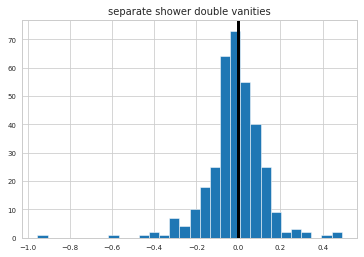

-0.009293442996456493


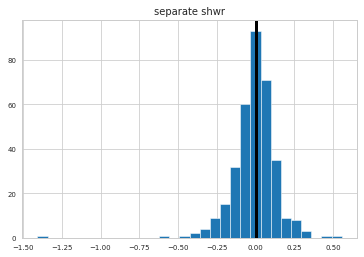

-0.23500805832315919


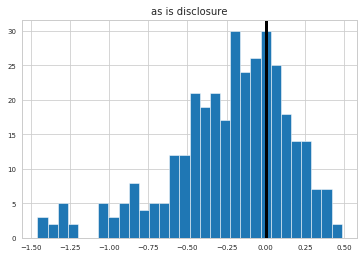

0.00733130938799866


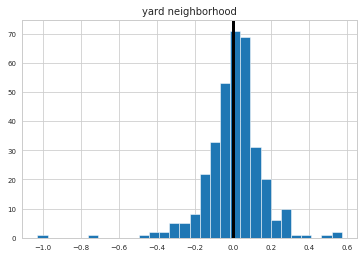

-0.002194857034176493


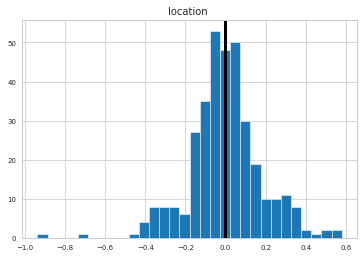

0.011030560425092987


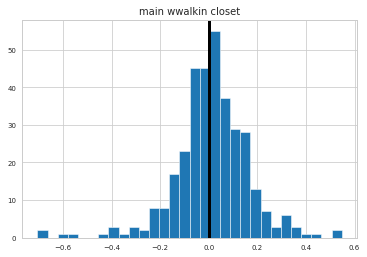

-0.025005702284004713


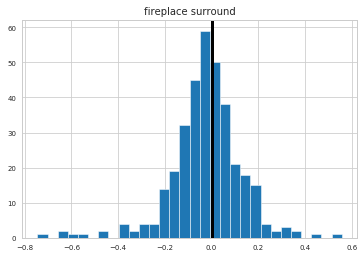

0.002894739364559904


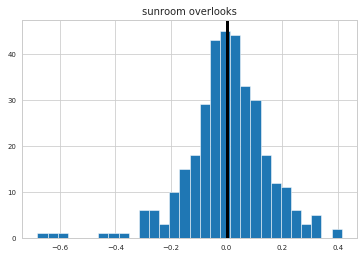

0.01613302690660214


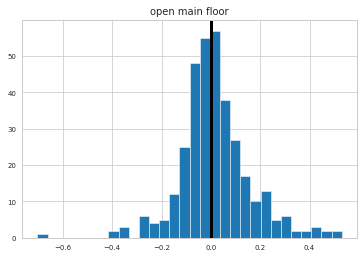

-0.026643623031859454


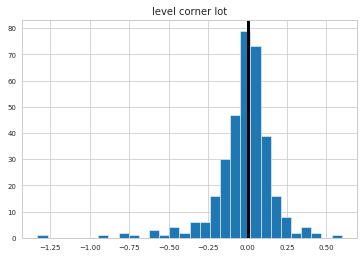

-0.012324993681266177


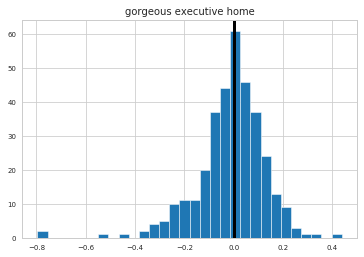

-0.015196556061037732


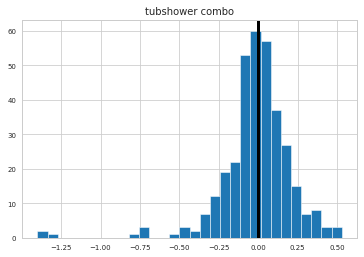

-0.06460401263687982


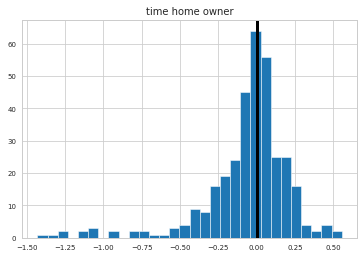

0.01950036596965666


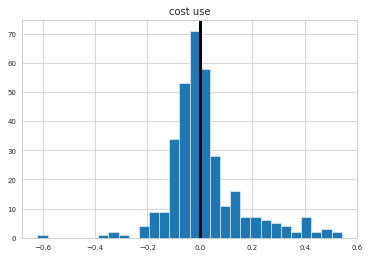

0.010844519542528207


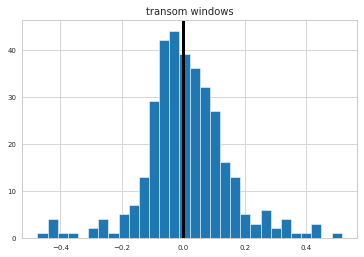

0.03503159760264741


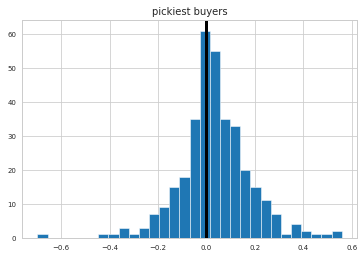

0.0021224241654772325


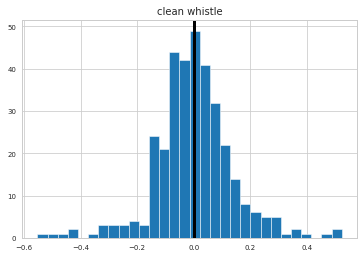

0.01418040532856524


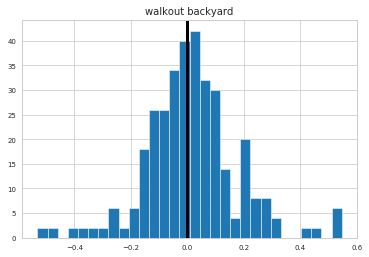

-0.006441765418784099


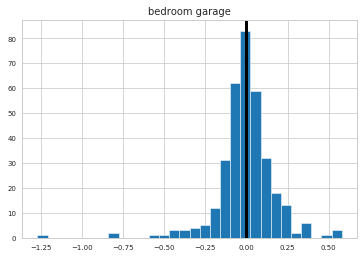

-0.007760811666172283


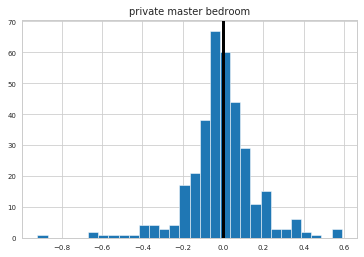

-0.0030440210385294544


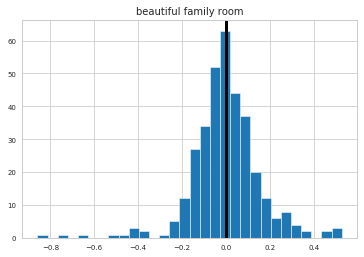

0.004590639967814632


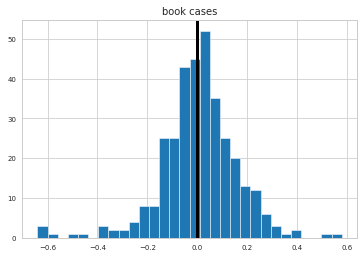

-0.06039374177988521


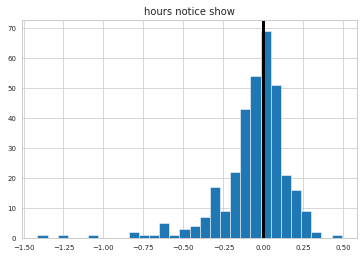

0.06694795636970899


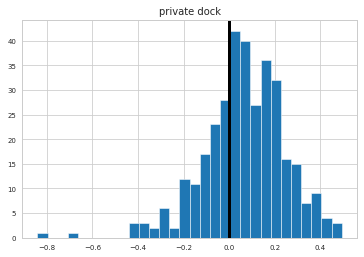

0.0017587353611445426


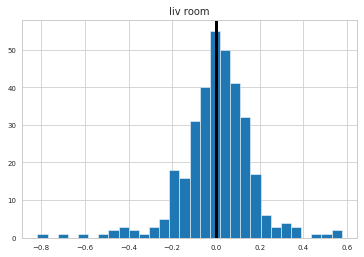

0.17423875789834245


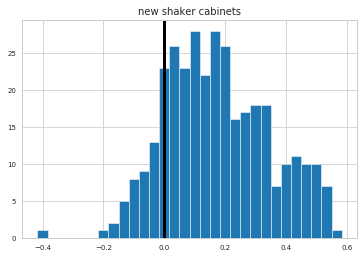

0.0028243530093136396


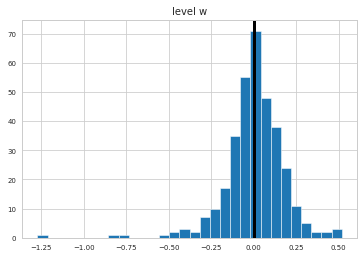

-0.011193244420382324


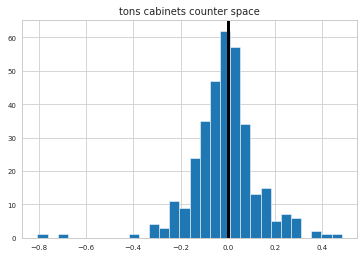

0.006903470599047176


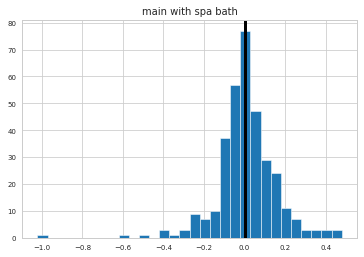

-0.005275980625577539


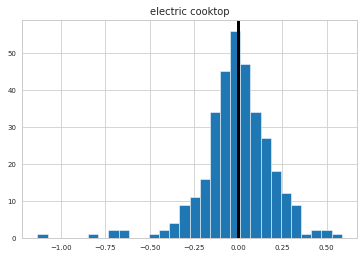

0.0503259128653017


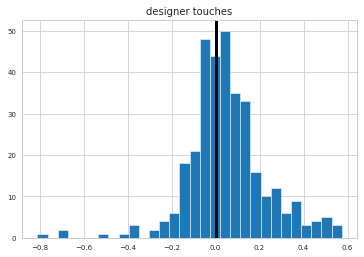

0.05812993384076788


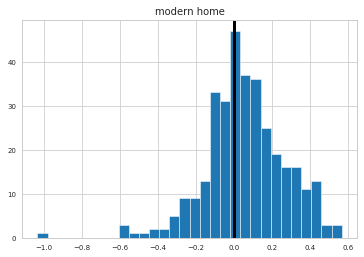

0.007827977788238466


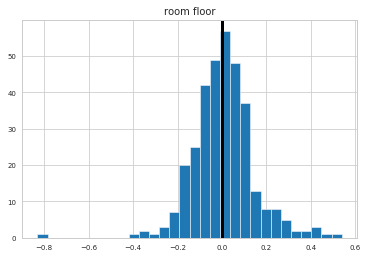

0.02216971281806556


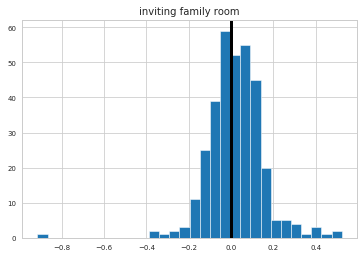

0.004003079759298102


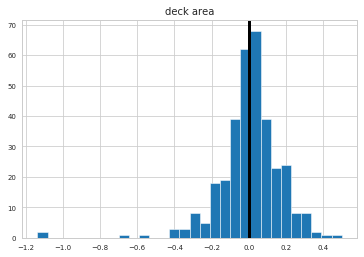

0.009604200437922629


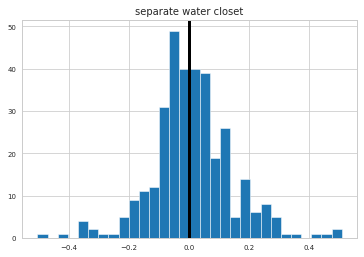

-0.013405930126667987


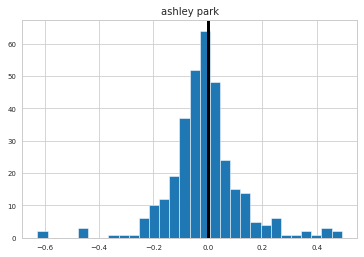

-0.0011098729558927632


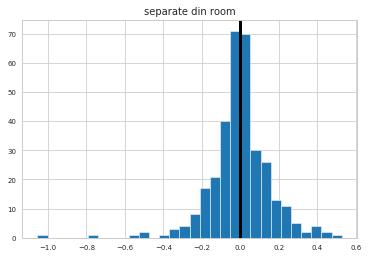

0.06252284801434216


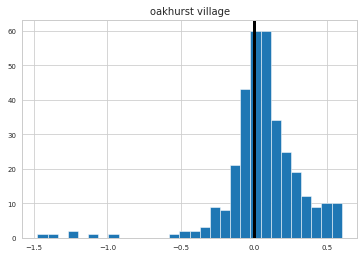

-0.008327854053603546


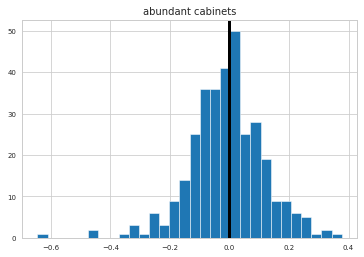

0.002517759819102255


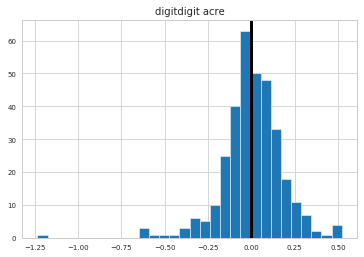

0.0024417323715280512


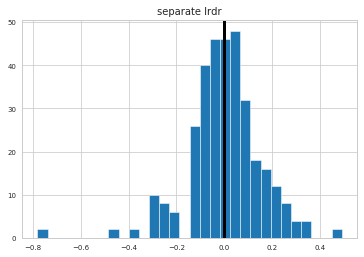

-0.010933432314024336


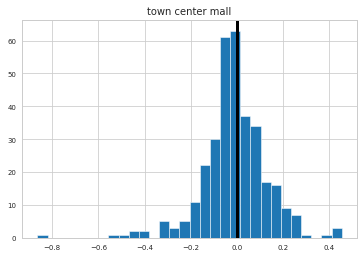

-0.014509215792932621


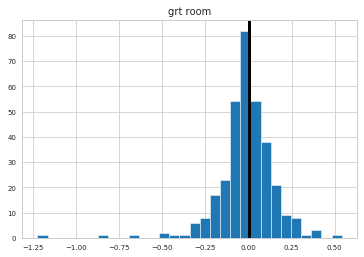

0.012066945604665077


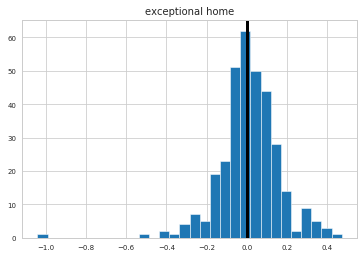

0.008492772245695796


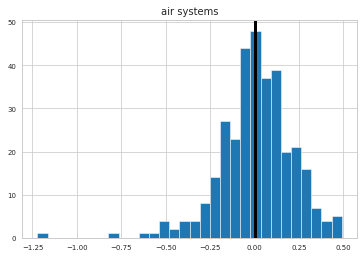

-0.008874705568366913


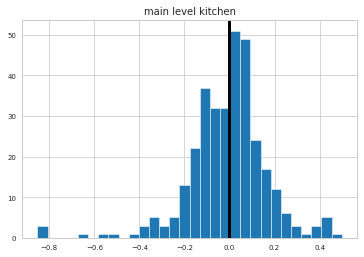

0.008210103360904136


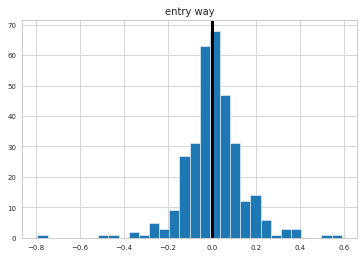

-0.005131799792481506


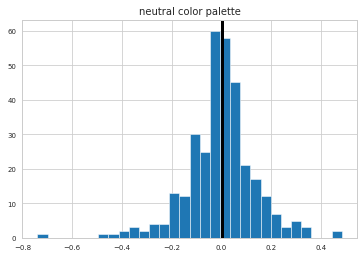

0.006821587049191912


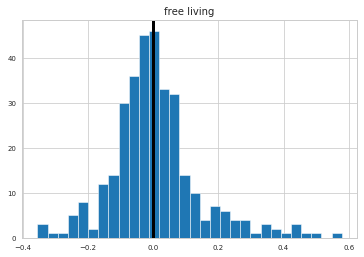

0.02070713050824935


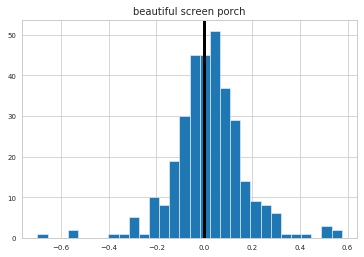

0.030673156759081492


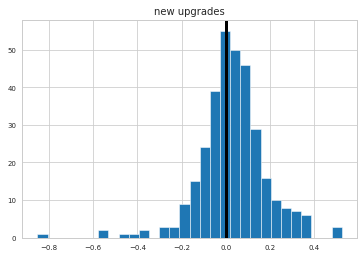

0.03548837884080477


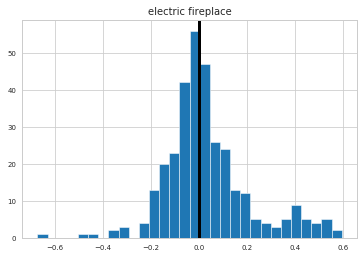

0.03975855282692231


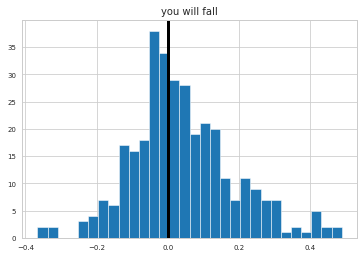

0.028206305449052737


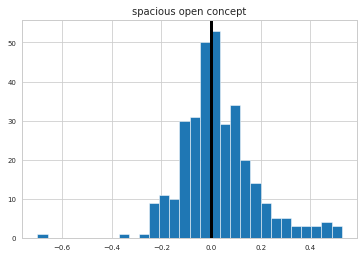

0.025160908485811713


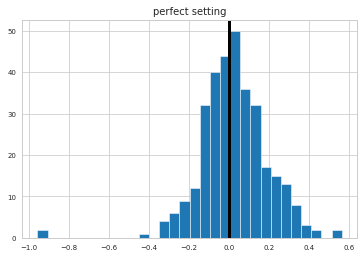

-0.007551750850254838


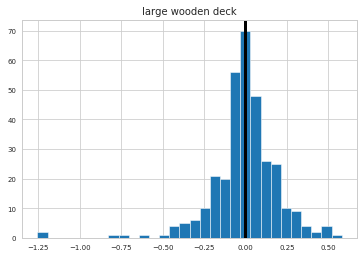

0.018268590282103064


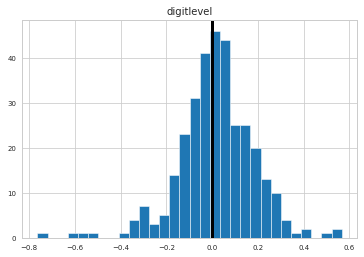

-0.03276106625272783


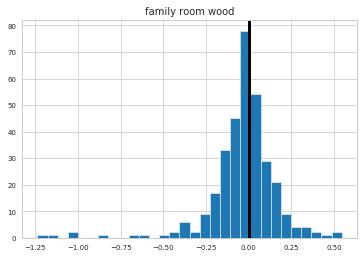

-0.0015661013720525492


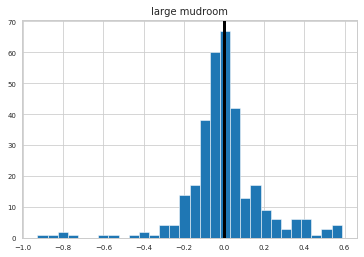

-0.0008730946734584308


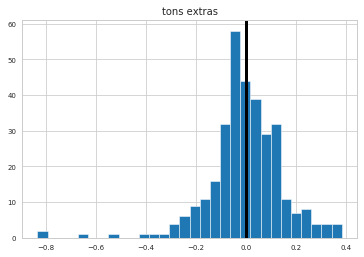

0.06938929565702145


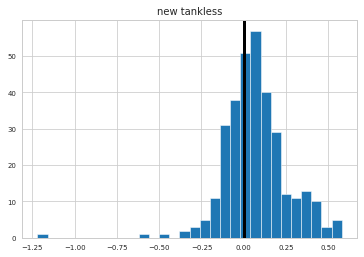

0.02720055657960173


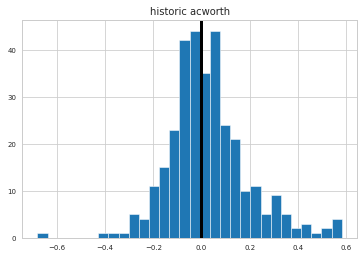

-0.1620613384107372


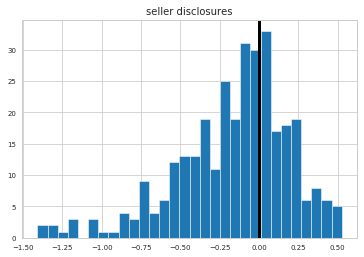

-0.011493567049917075


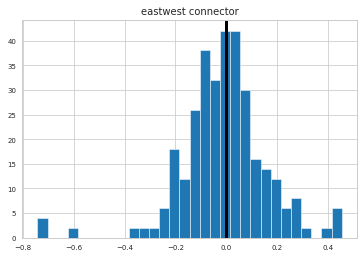

-0.020842560771206237


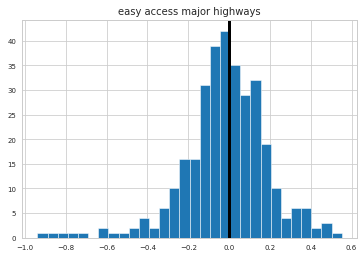

0.0075944307005873435


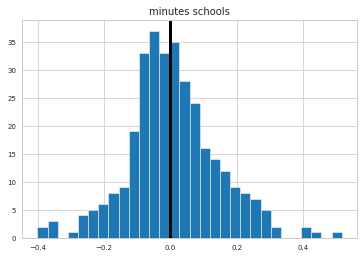

-0.021655068171627618


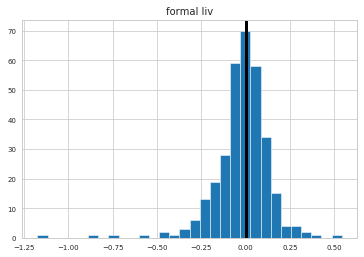

-0.027744543552229432


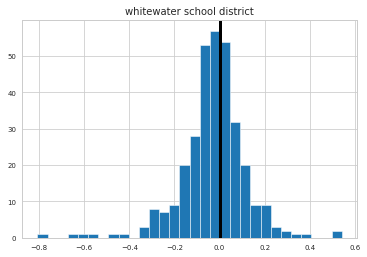

-0.015200313443609491


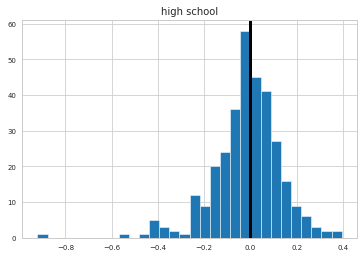

0.025353036452866812


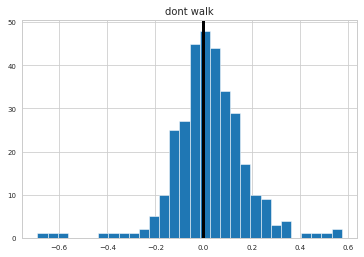

0.05240623493576284


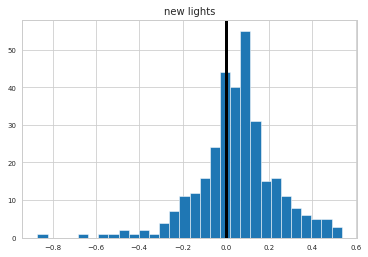

-0.018880022192244713


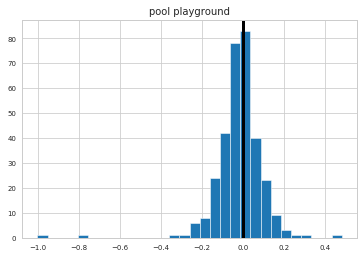

0.006311493809282116


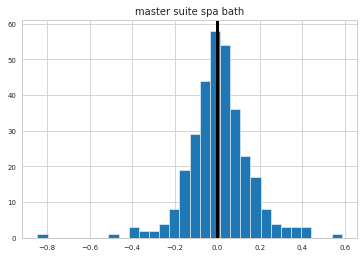

0.021870181916567314


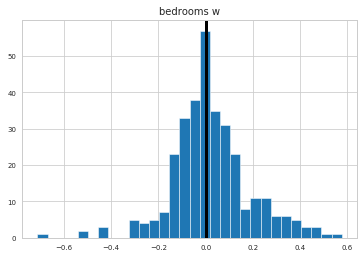

0.009750794788804393


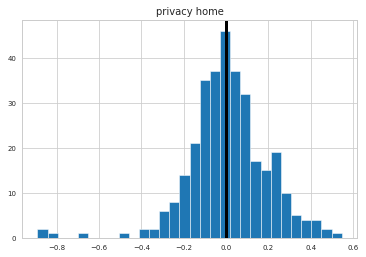

0.0020075165896138937


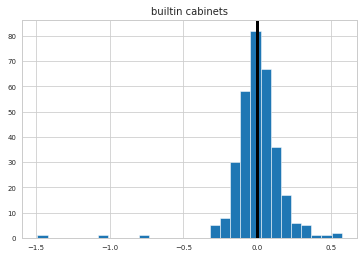

-0.24821297668284528


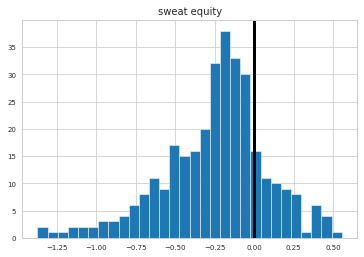

0.002080515280385407


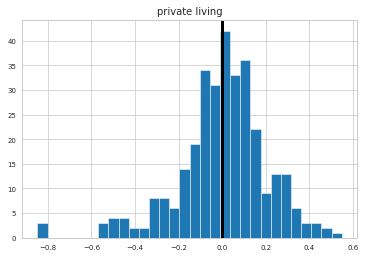

0.0003003522150112625


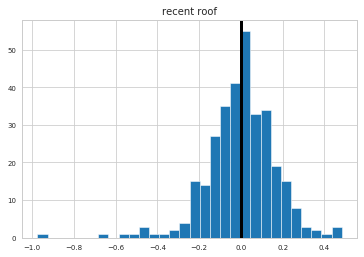

-0.011600000845561117


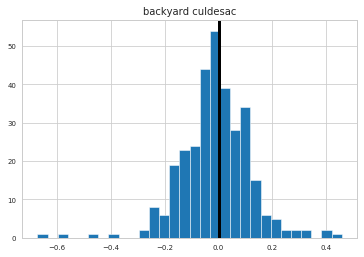

-0.009947645522595291


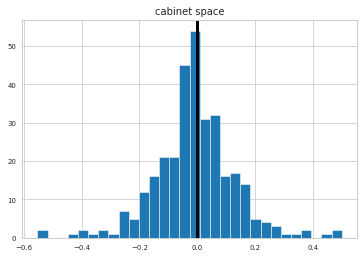

-0.002968014950376552


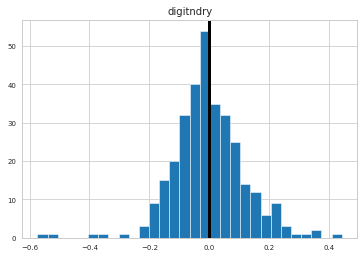

-0.0021693353852084403


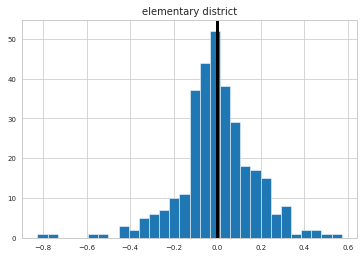

0.06656555670210984


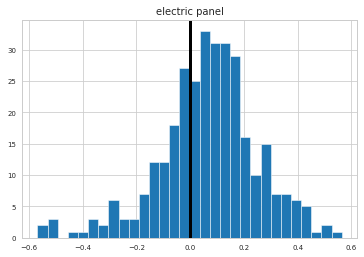

-0.02026210704236827


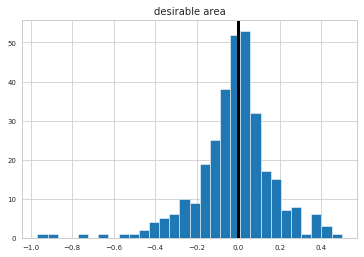

0.05194580551960595


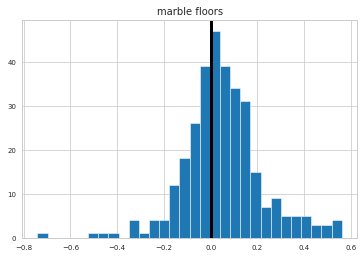

0.0541529257265977


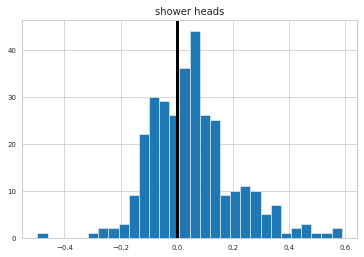

0.010217864086664051


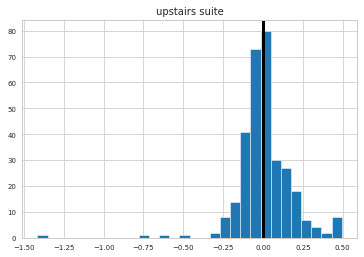

-0.03731971069970973


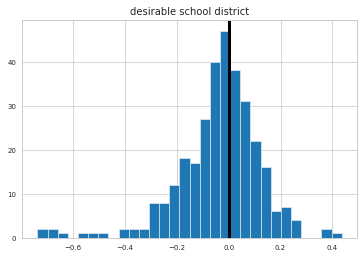

-0.008307835918314592


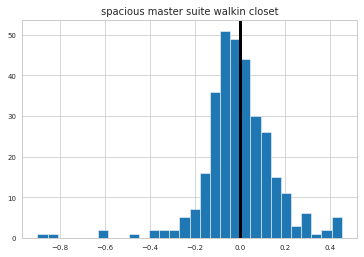

-0.01195618624381862


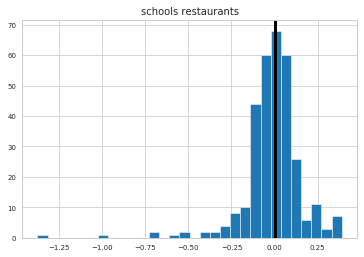

-0.0035386134998459193


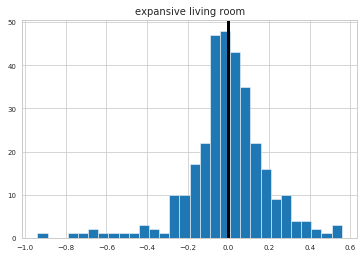

0.027650128127496124


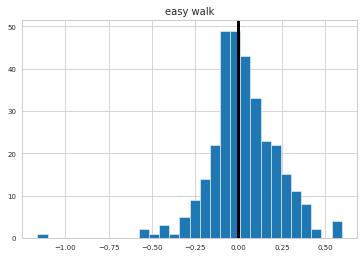

-0.014009652154975738


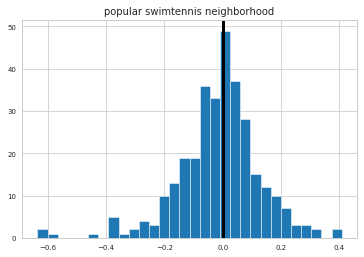

-0.010821032436132893


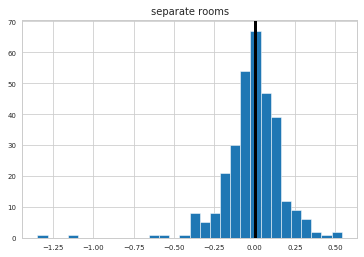

-0.016741114689729185


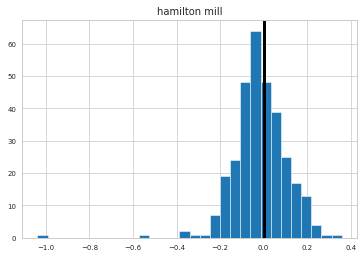

-0.01815596880841141


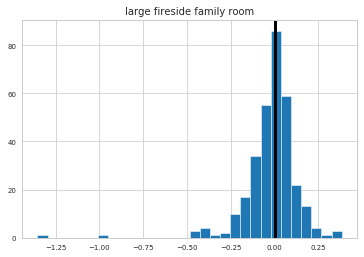

-0.007555436453340719


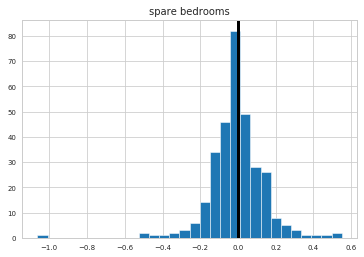

-0.029414464135698825


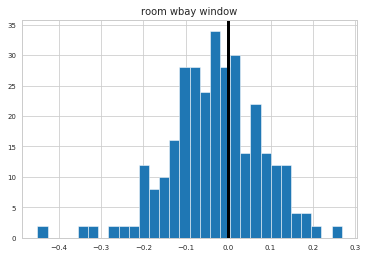

-0.03908192896233208


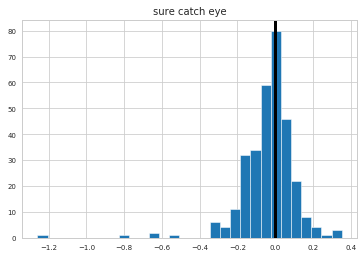

-0.060886721736941735


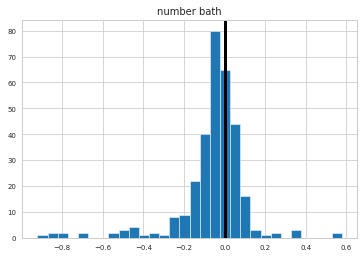

-0.016254910665307154


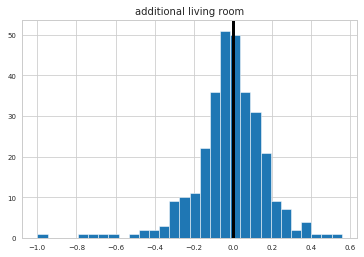

0.003799204879633419


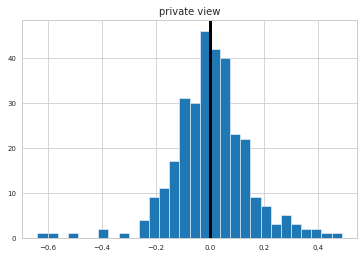

-0.003877112050429263


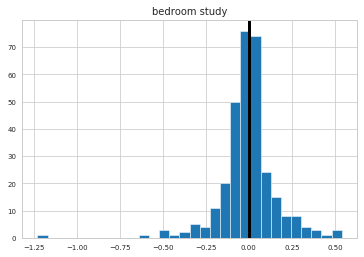

0.009987382387792598


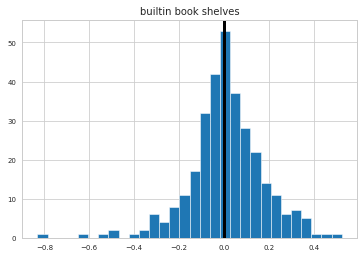

0.04289514962073365


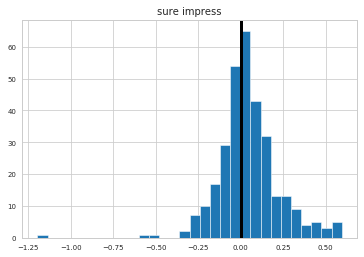

-0.018397356930699577


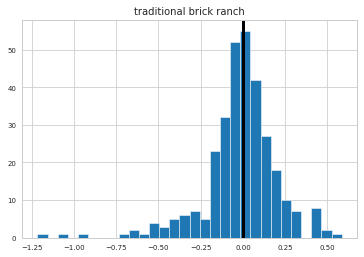

-0.09476345892473083


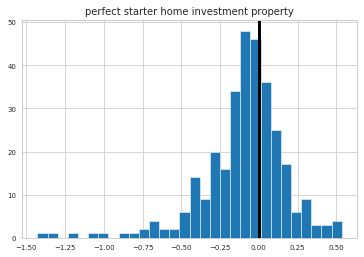

-0.017626082146614618


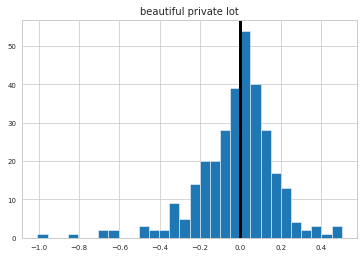

-0.005015740794584612


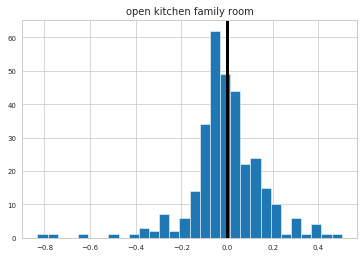

0.03562812867634181


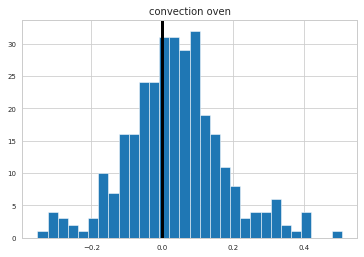

-0.03427189193950992


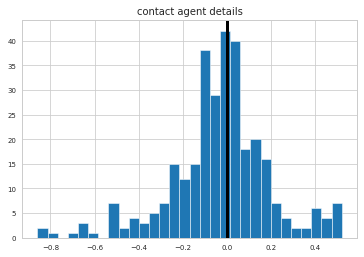

0.04584476816453085


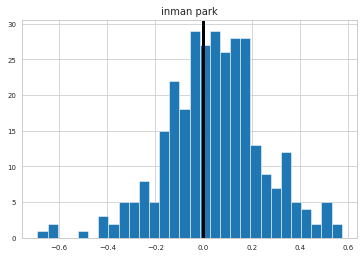

0.04147169383738985


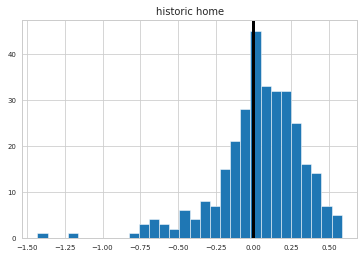

0.005138782258826472


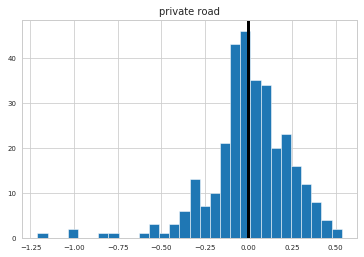

-0.02331728433815079


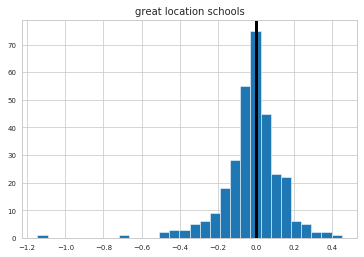

-0.014351791869729366


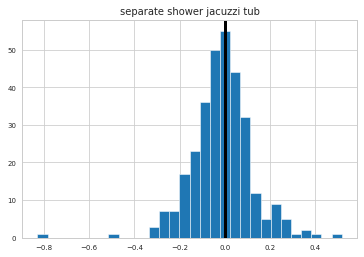

-0.01104792011093065


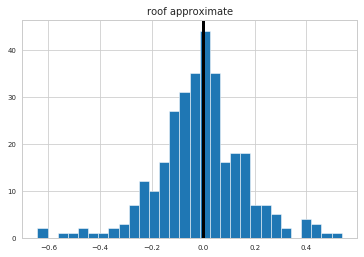

0.022313037941343827


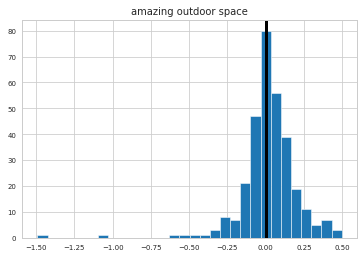

0.0121626700388923


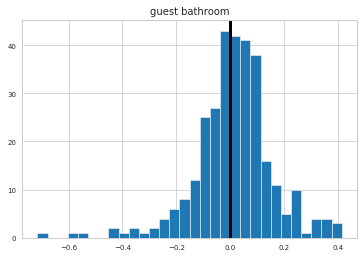

-0.030535087162768586


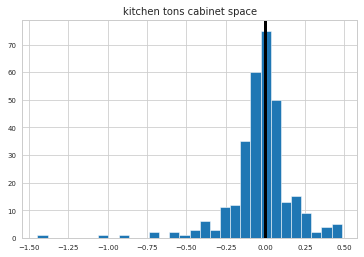

-0.01910151892752657


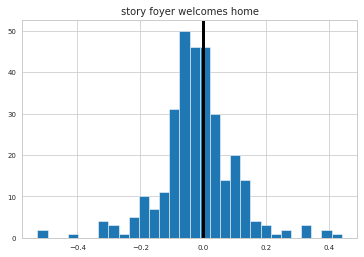

0.05544788012398377


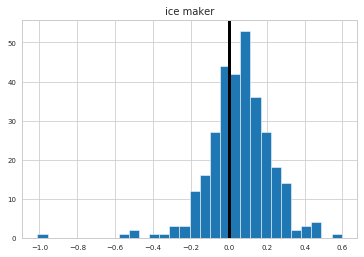

-0.013288647179856734


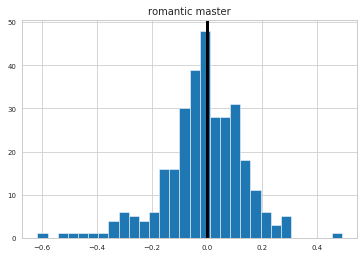

-0.01901238127142105


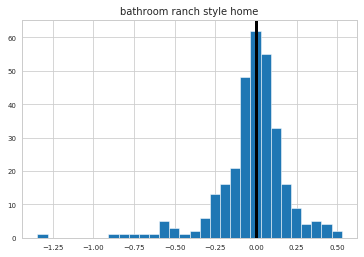

0.052631436104171564


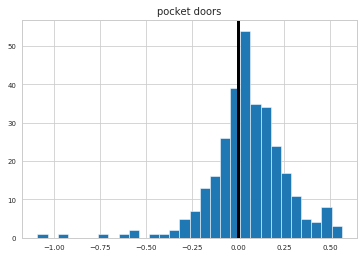

0.022767739505812967


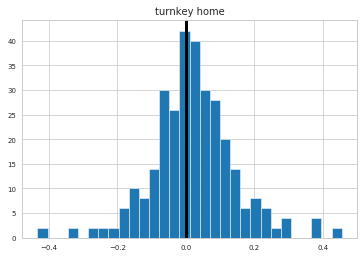

0.011817397139219319


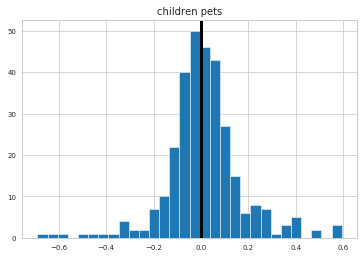

-0.14395495924732507


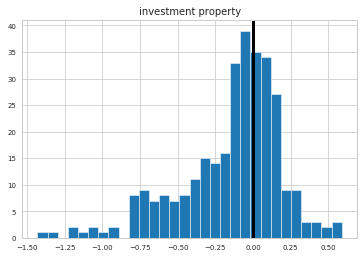

0.04115843299892152


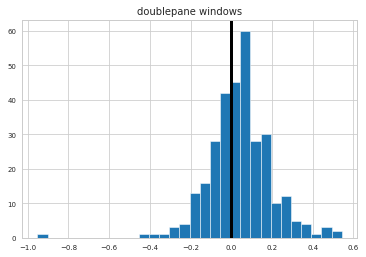

-0.012389647079595797


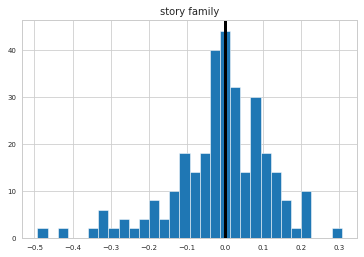

-0.021834973151597534


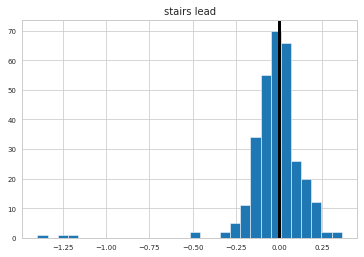

0.015259875083161558


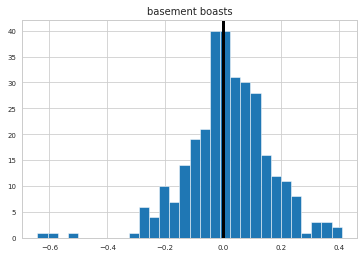

0.002761038030057572


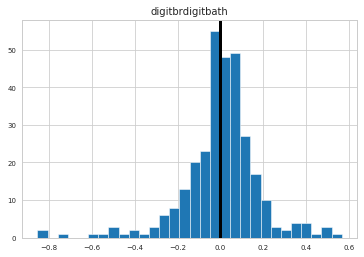

-0.00016866126380750732


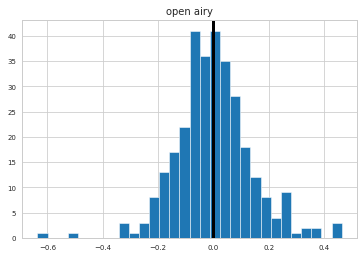

0.03176167328292678


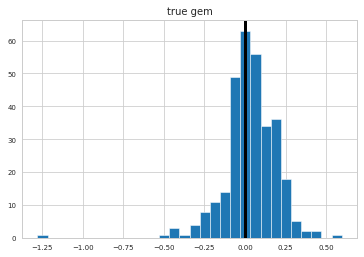

0.0023741128718729188


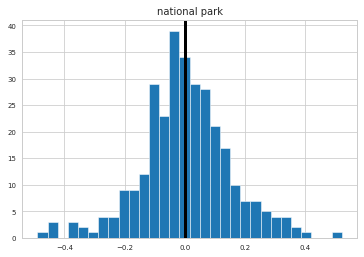

0.039114029020393515


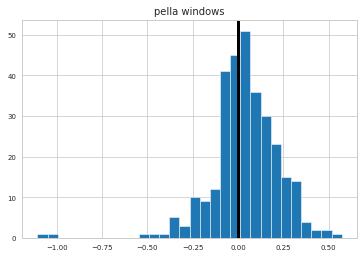

-0.0012012251152316337


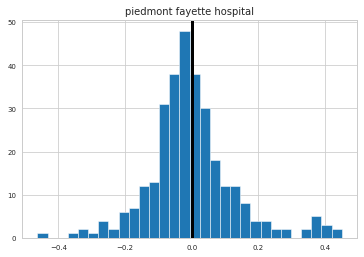

0.008000908569973169


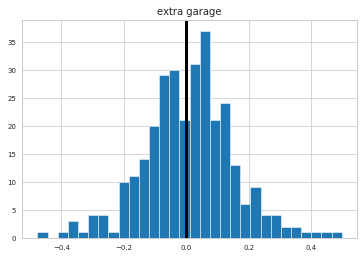

0.030729131371068398


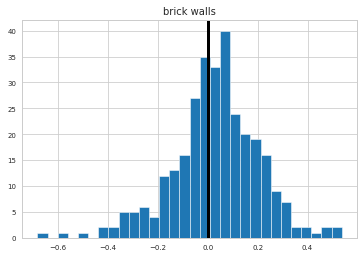

-0.004636465629353433


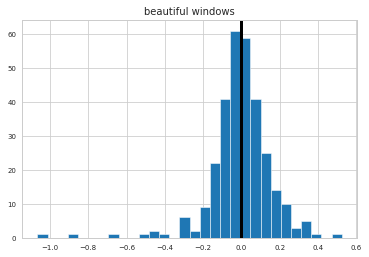

0.00013466894122216637


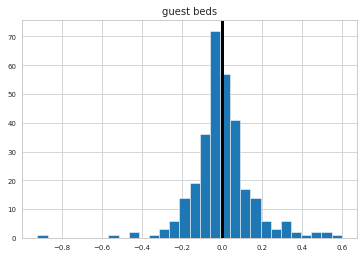

-0.016717811895398792


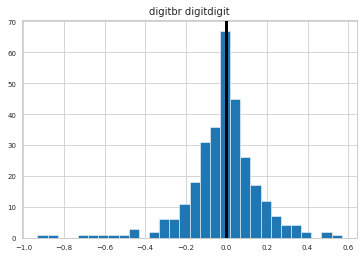

0.014989098939556186


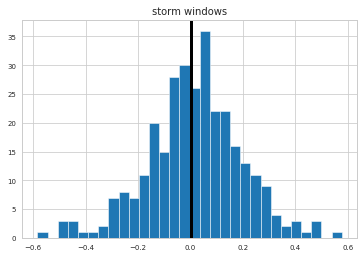

0.0051590382914093


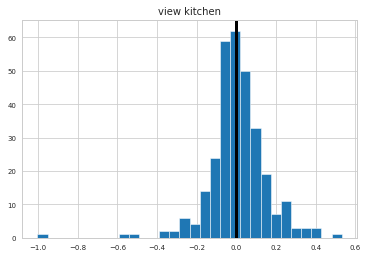

0.014752898436519151


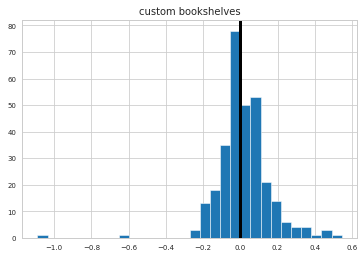

-0.01878928050932262


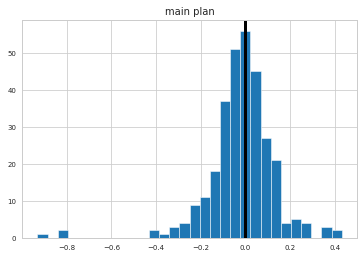

0.007271848943050973


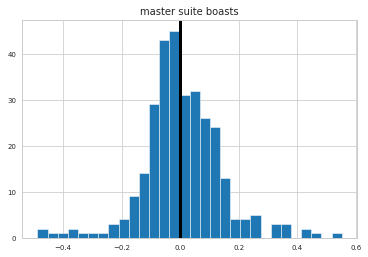

0.08047897622316906


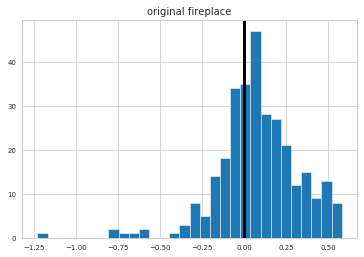

-0.017924405240707247


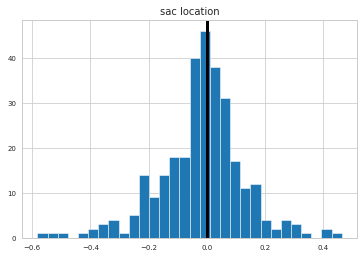

0.022323052845271005


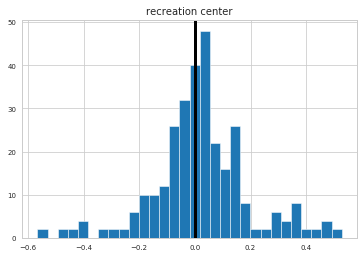

-0.0040356517606598375


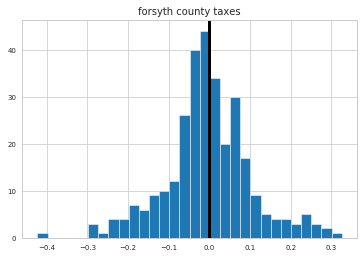

0.011732752524346496


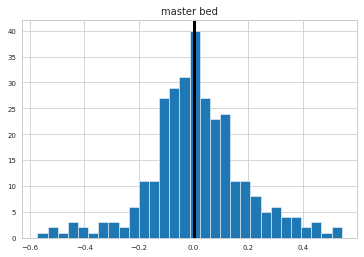

-0.14427414332296243


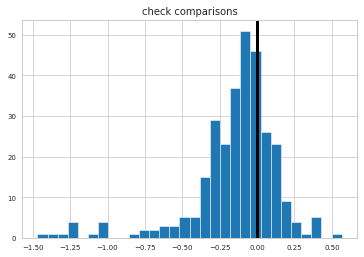

-0.004146017842823177


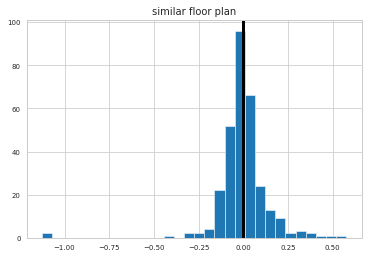

-0.021644257959577994


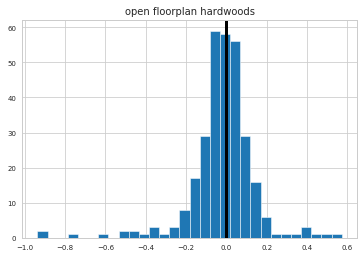

0.023251978690845273


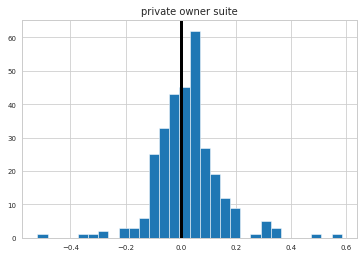

0.0004070804372256181


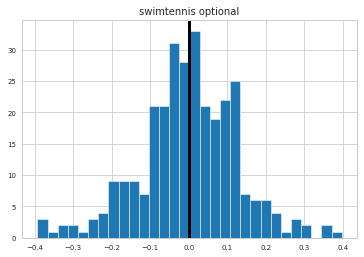

-0.029128576833151655


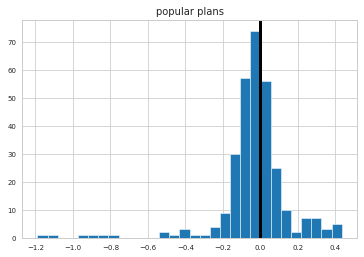

0.023139910355857485


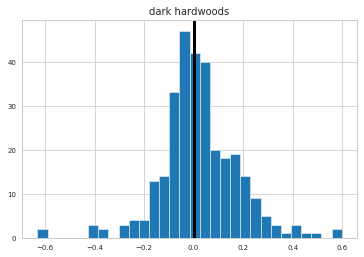

-0.013233198487920095


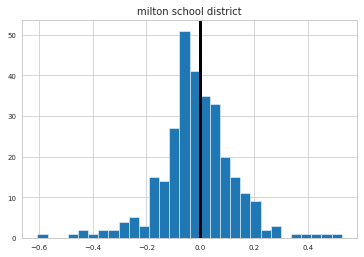

0.01848579120958133


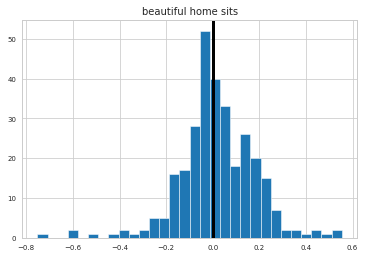

0.0312868475576233


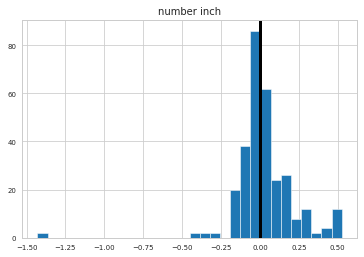

0.04054572259047718


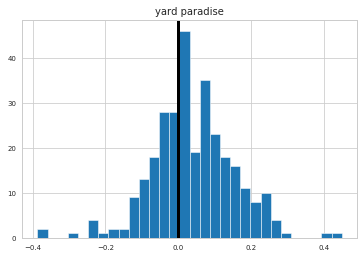

0.08131944413763002


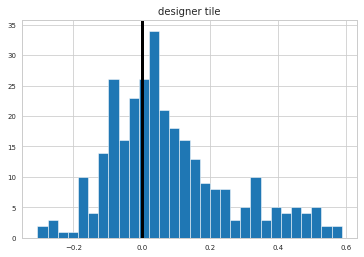

0.054894196518590545


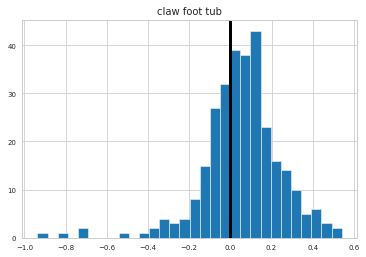

0.07802625432145464


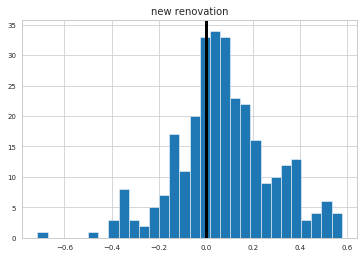

-0.1193882759939289


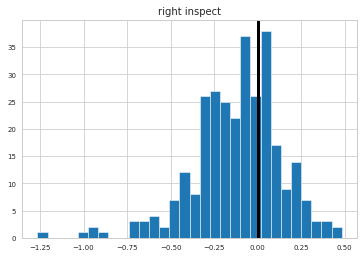

0.0072968980511257785


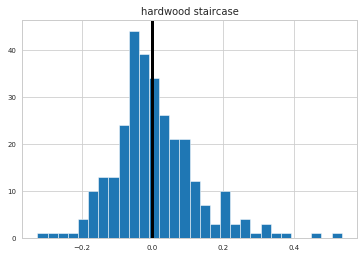

-0.035608621814338076


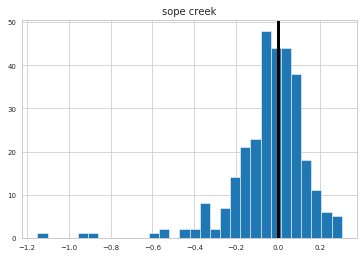

-0.0030674830778345944


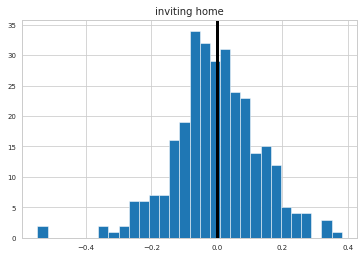

-0.01341781172197485


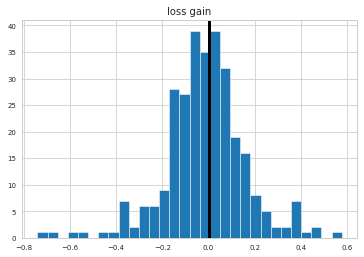

0.02229354143894677


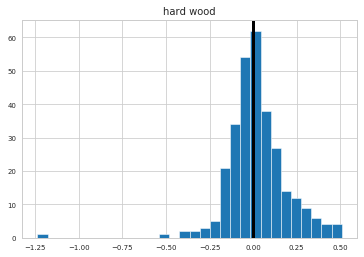

0.0009840232340409406


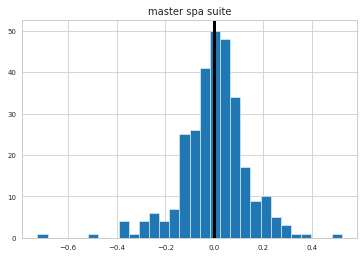

0.018784556424089167


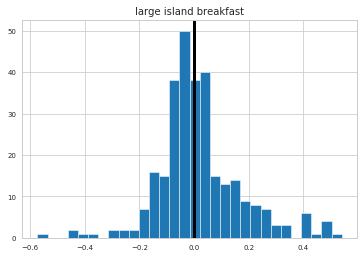

0.008786541695296272


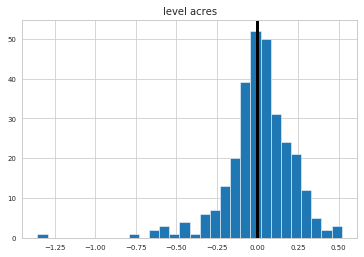

0.007920585078185808


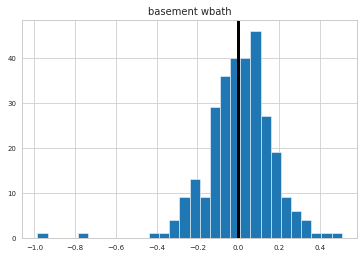

0.011570121900670114


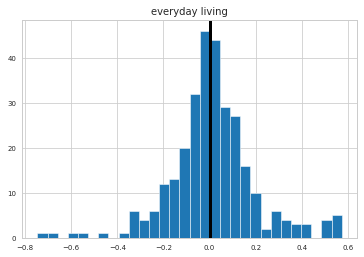

0.016379608828058712


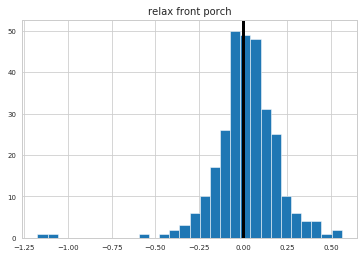

-0.0021473053279681886


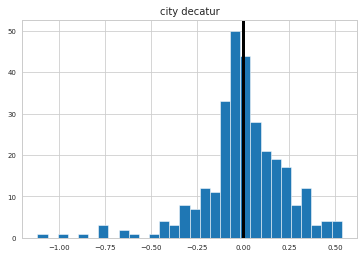

-0.0017641294706026882


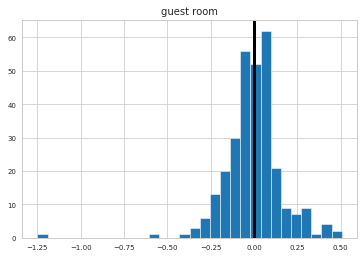

0.002440384689286457


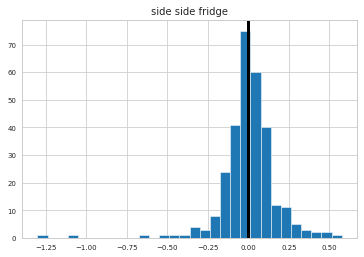

0.08296150990900565


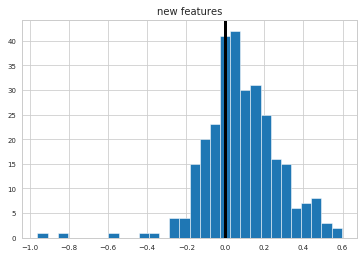

0.017765368945199405


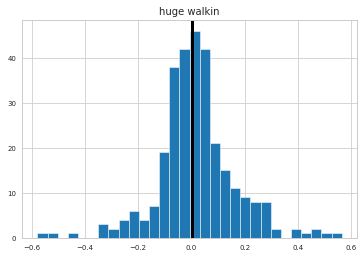

-0.006475369550003989


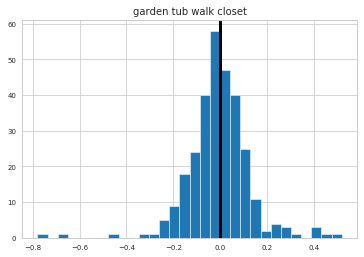

0.008354735958255718


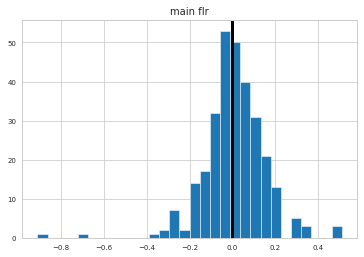

-0.01580470651016111


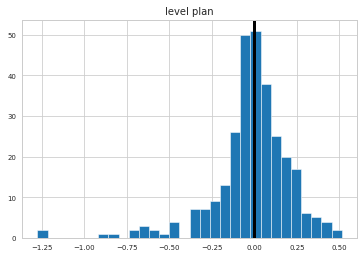

0.0024588684260644913


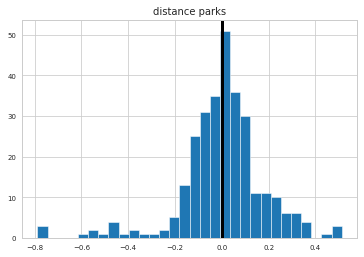

0.003216608987247185


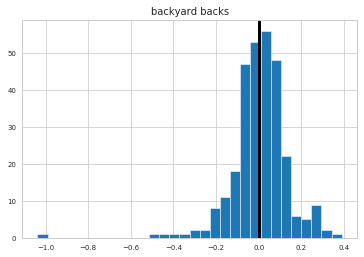

-0.007235850640702381


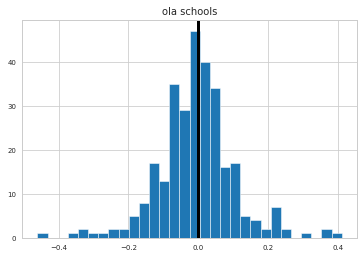

-0.016672276017833058


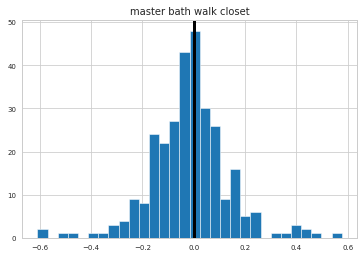

-0.0048503293114338574


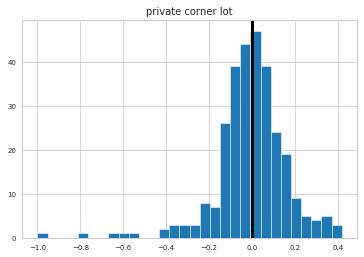

0.013436187360373993


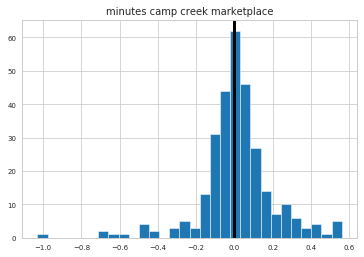

-0.01558276435804227


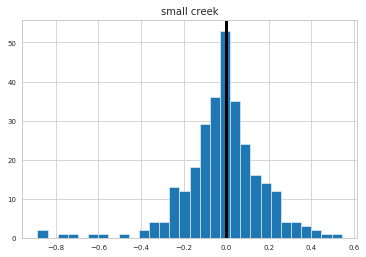

0.010697748727373028


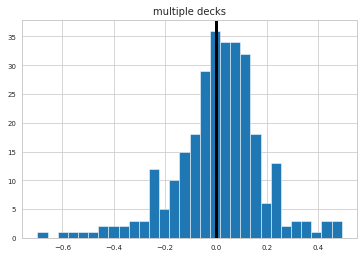

-0.044447587987623396


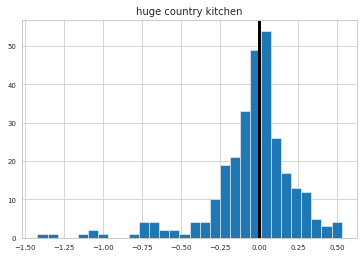

-0.07959586117857761


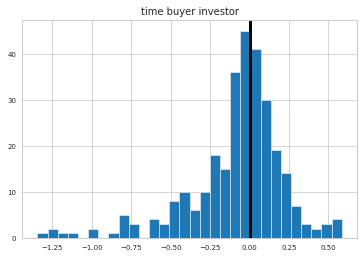

-0.044680460718315246


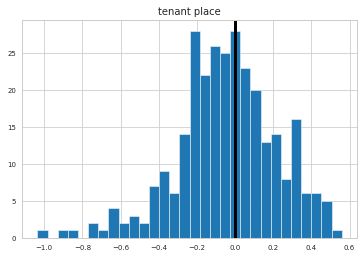

0.01160577875801656


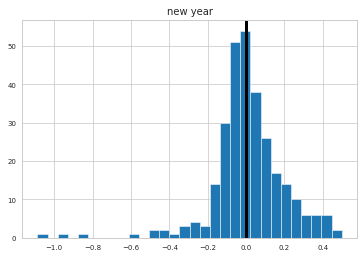

-0.01300921484495225


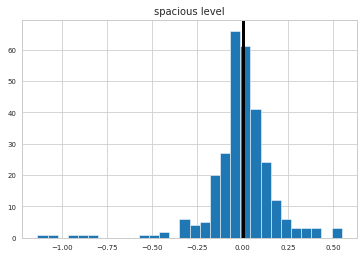

0.0019648340623466525


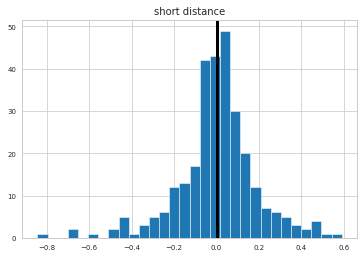

-0.0021369256403166786


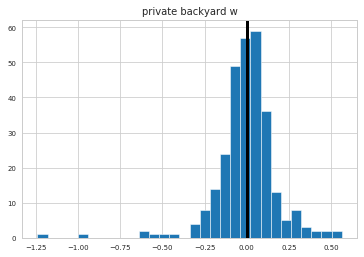

0.15883348467259084


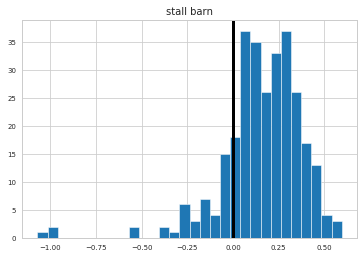

-0.013131337583743562


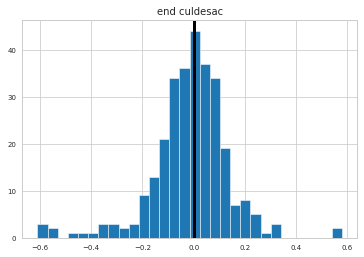

-0.025032262871277


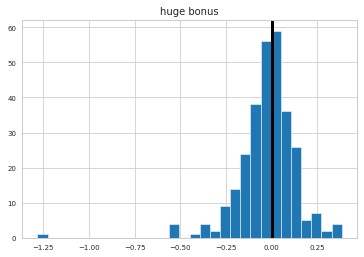

0.0024179221396397905


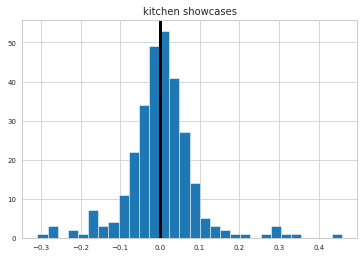

0.018733914421136668


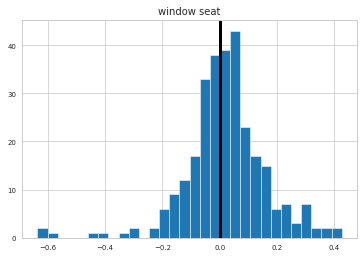

-7.086637341962557e-05


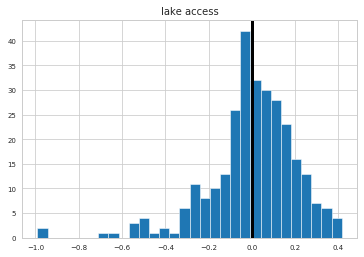

0.006669505792955022


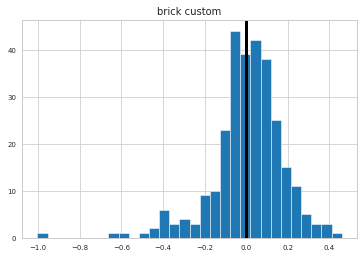

-0.021146629329300056


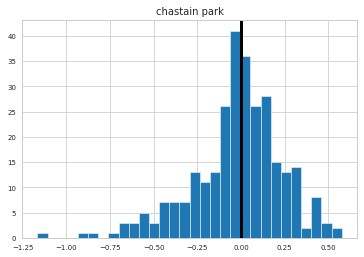

0.06249711358993952


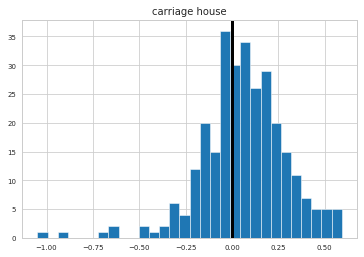

-0.0013615733560966123


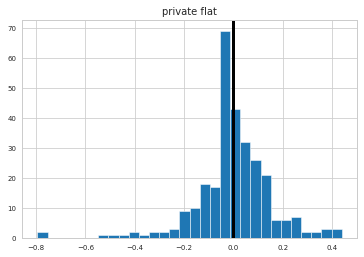

-0.08683828873679404


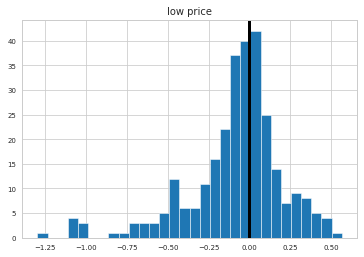

0.013800323122591622


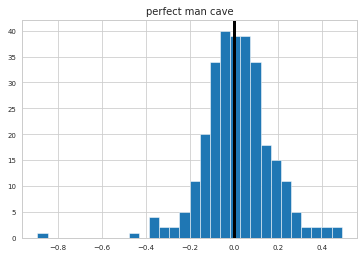

0.03824051233475631


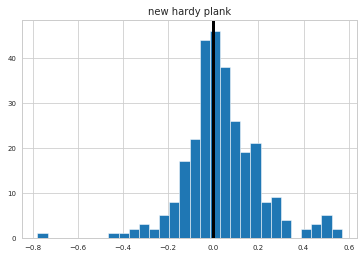

0.007186981453076606


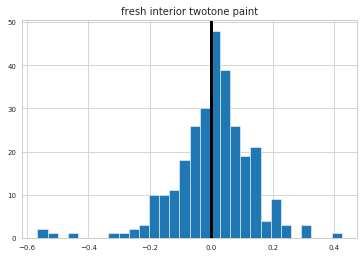

0.0299142253322624


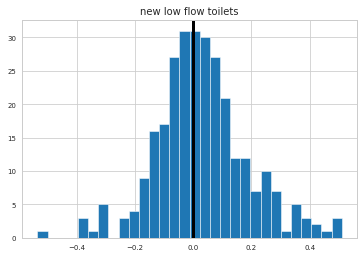

-0.008579730918195139


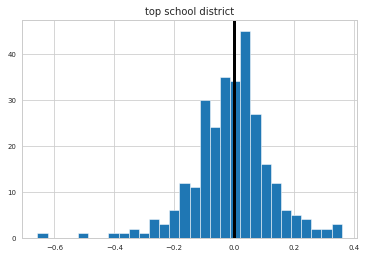

-0.00015224532460468565


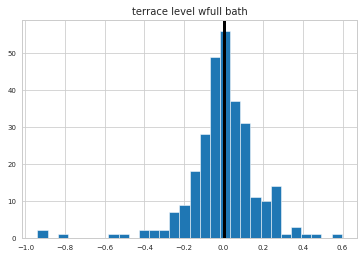

0.026079627750066767


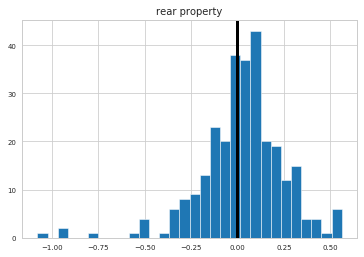

0.022607533957932295


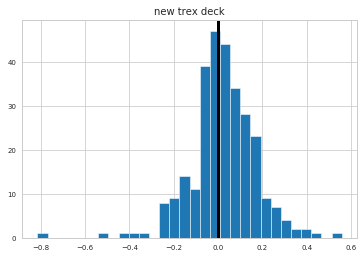

0.0208601386228511


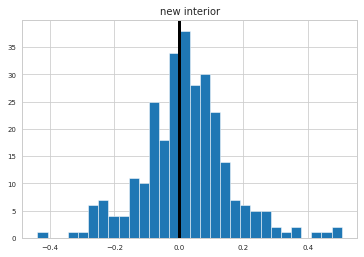

-0.05711077756598221


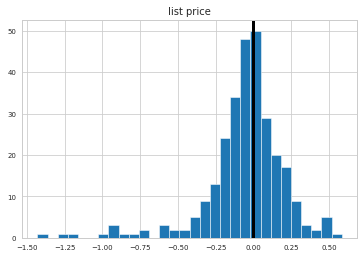

-0.019148295460711753


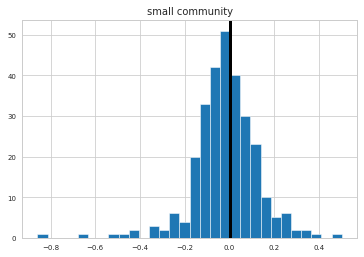

0.01326400147479309


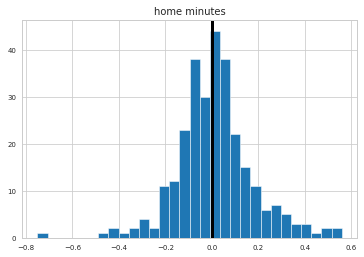

0.040878881239946555


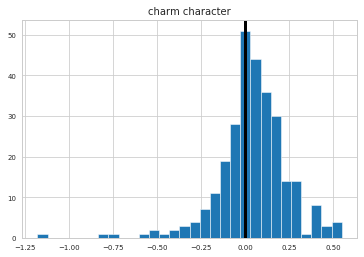

-0.00411098878749695


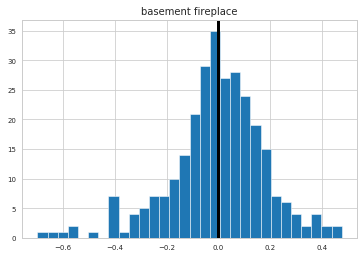

-0.019486047968949028


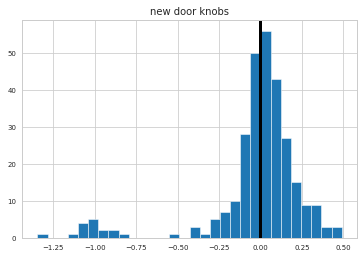

-0.006317063023431993


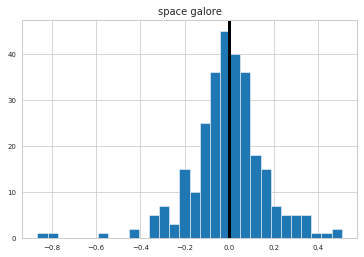

0.059860511324056634


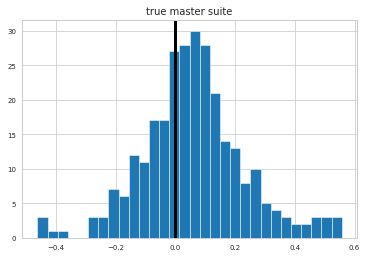

-0.005841136251603855


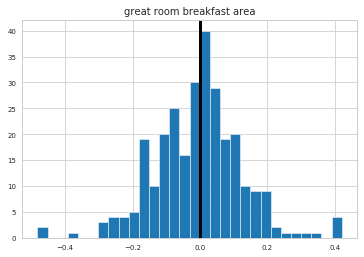

-0.004273149627828518


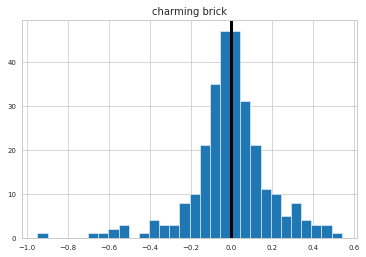

0.07961503158788462


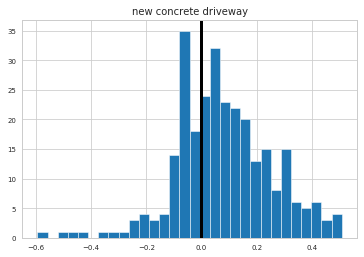

0.010705915525602067


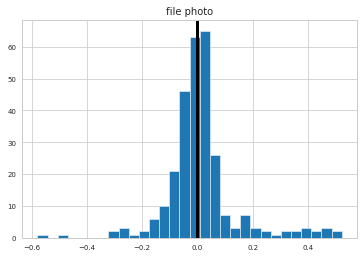

0.02141765585083608


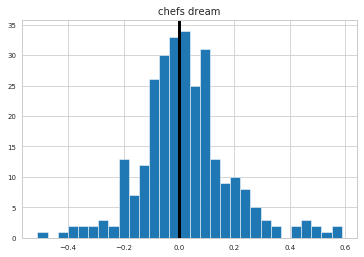

0.010549233671087108


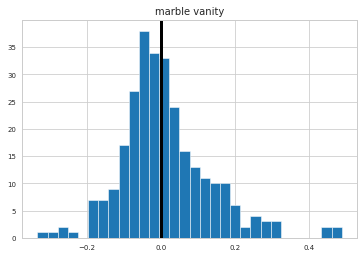

-0.01467484121083643


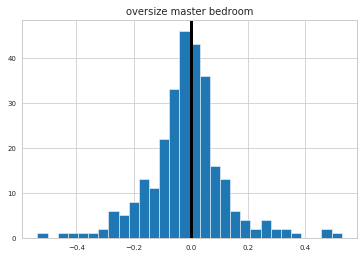

0.004824274221390979


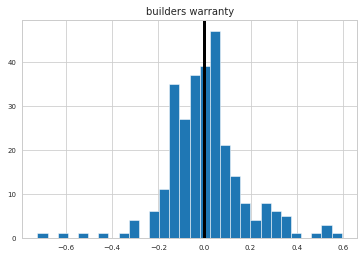

0.01985858766287955


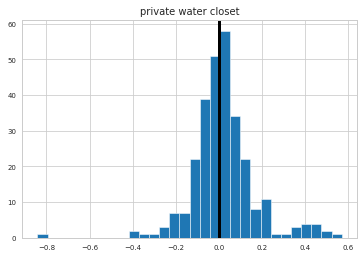

0.009399427511327552


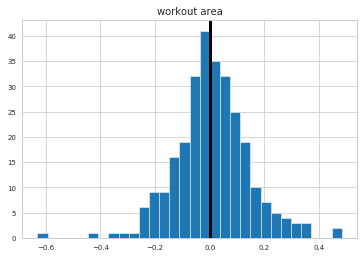

-0.0030089631730710782


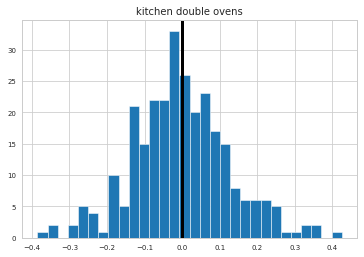

0.01650519240714465


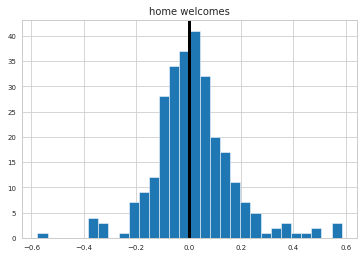

-0.012548764958643715


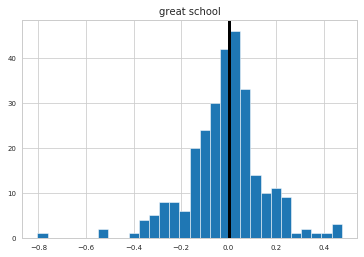

-0.01969883156952958


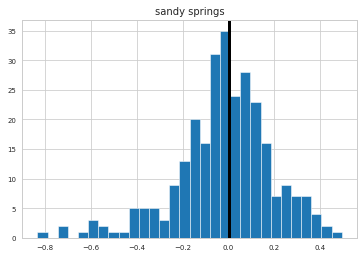

0.01623405866811682


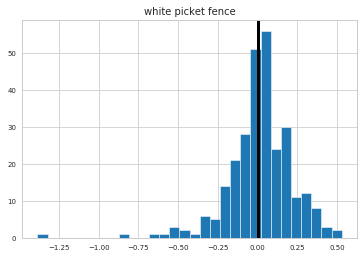

-0.267681461094211


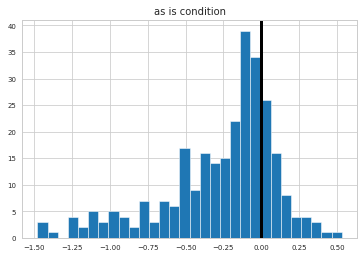

-0.21629043381205945


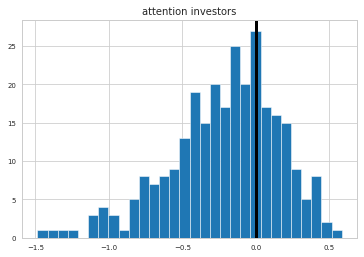

0.022445168856484458


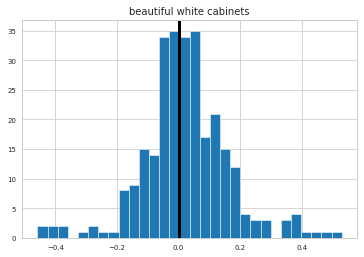

-0.01109177596461408


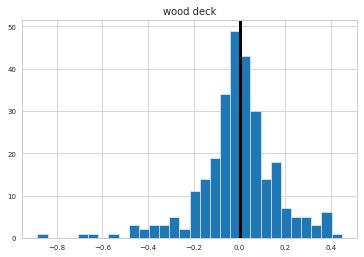

-0.015138184277495957


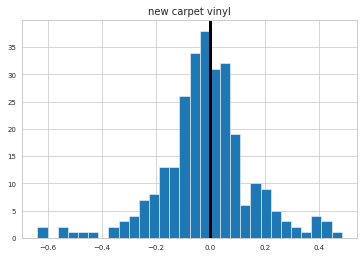

0.0029706851769493088


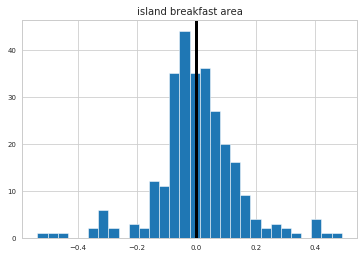

-0.0256358550565185


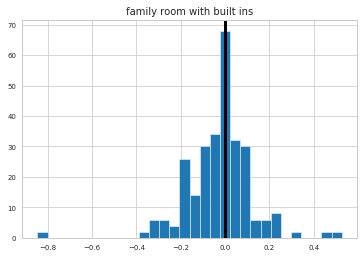

-0.020102887096838138


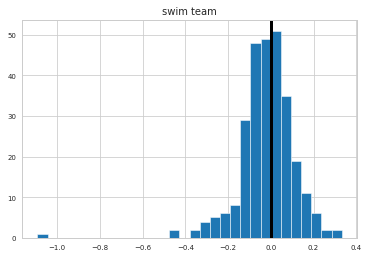

-0.02047987778141561


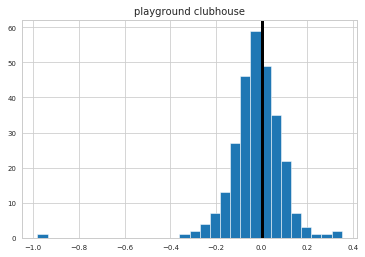

-0.003957194791276659


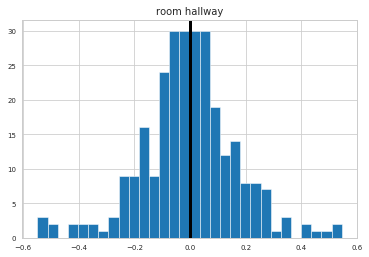

0.014183748708466669


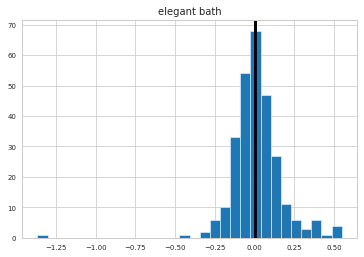

0.01249393450368259


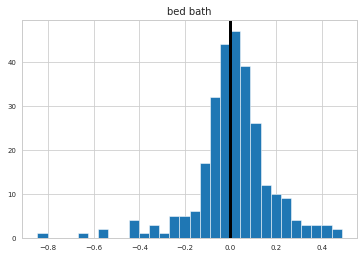

-0.019218029525753404


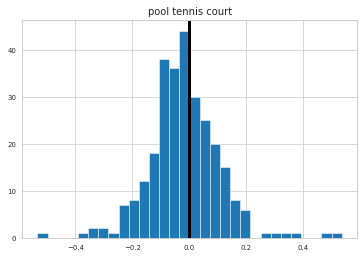

-0.007850702037134309


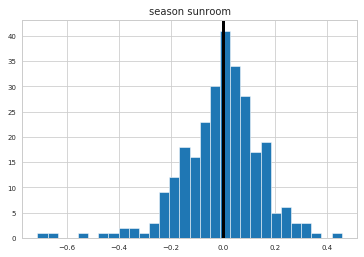

0.036909611703575027


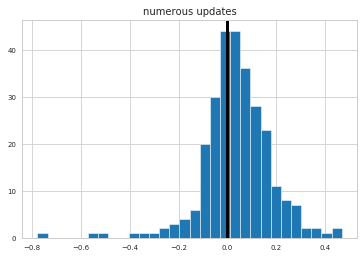

-0.005348301543393379


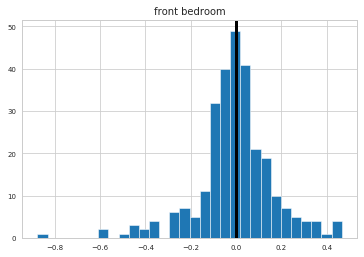

-0.03135347902504246


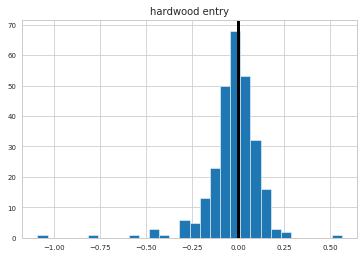

0.0006132059663249955


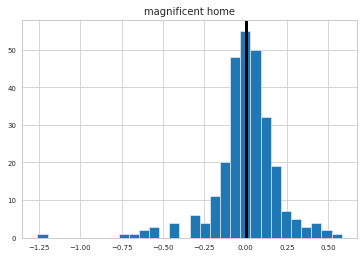

-0.009784227533622201


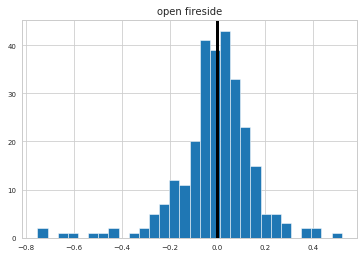

0.0133019514096443


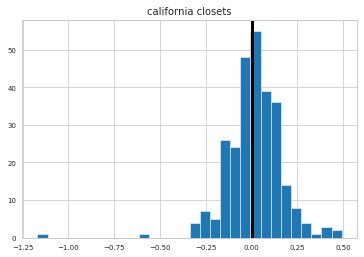

0.015985273831870688


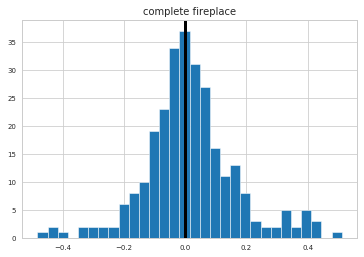

0.0017519249152674844


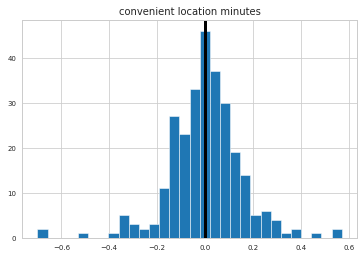

-0.20404569460892522


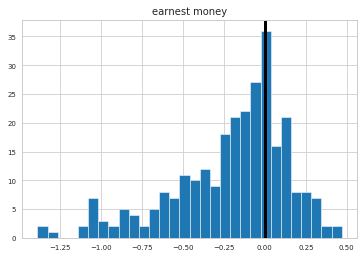

-0.0401497359364319


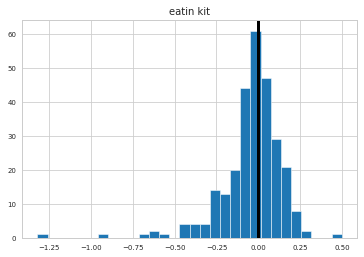

0.004833448007680095


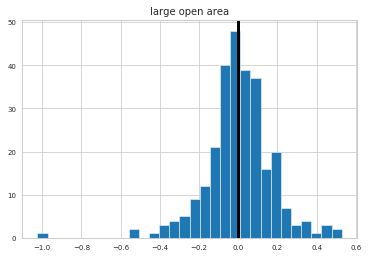

0.021161938421719685


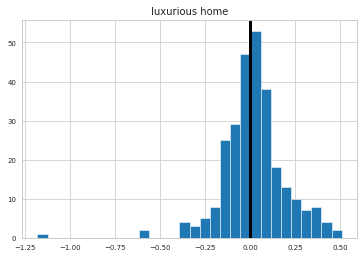

-0.02416101397473053


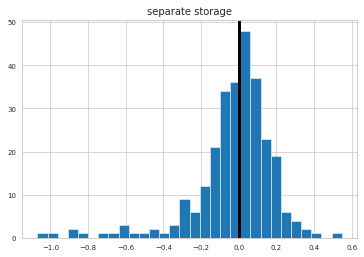

-0.011154908425067922


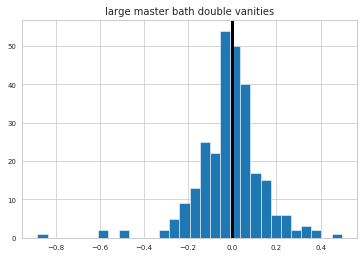

-0.014613178108443571


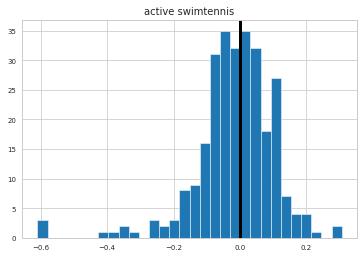

-0.004189099165430535


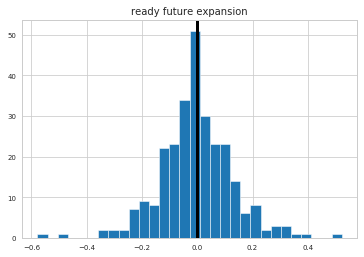

0.017735531887721256


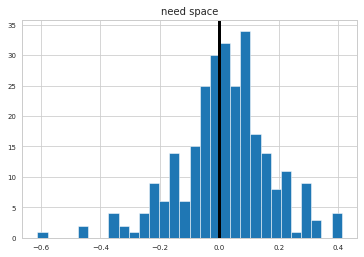

0.017685720201488692


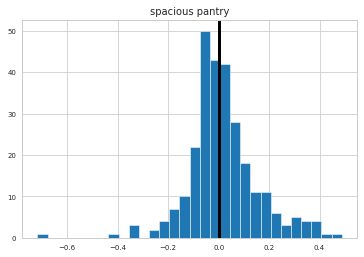

0.01734642192043133


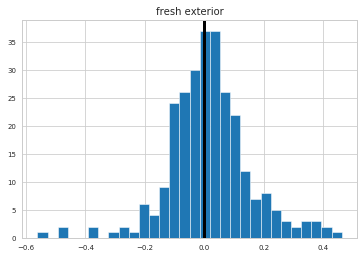

0.0038822691570470544


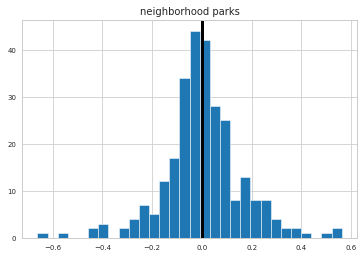

0.009100958790575991


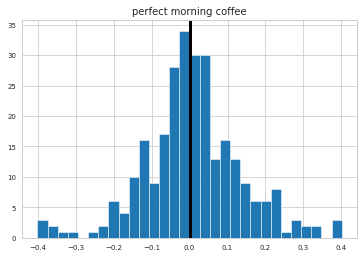

-0.012664546465758863


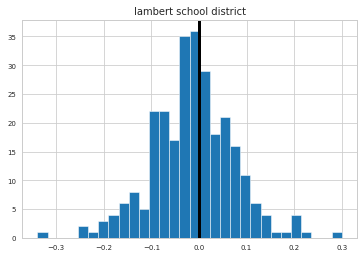

0.03438048758674947


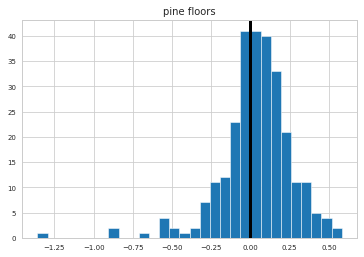

-0.000983440252342644


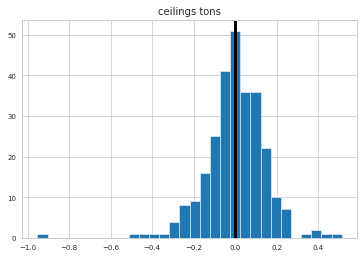

0.01610593881819202


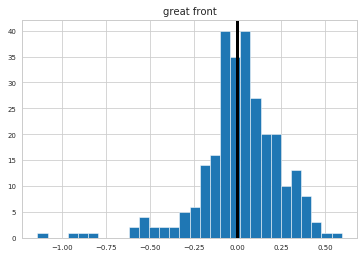

-0.22561624565957147


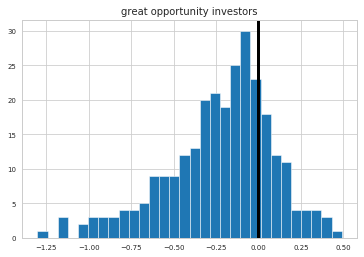

0.007711458466162082


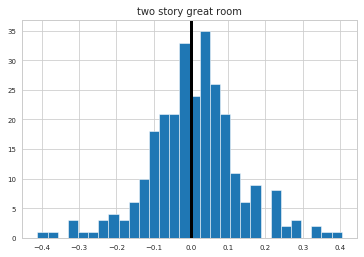

0.026897168300479623


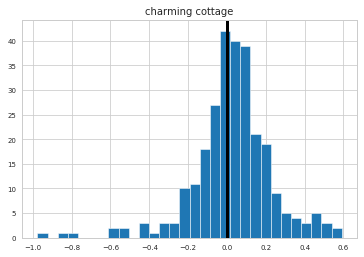

0.01758061374124021


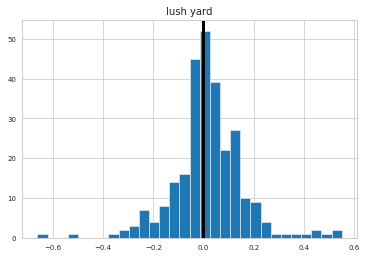

-0.0035696608466336322


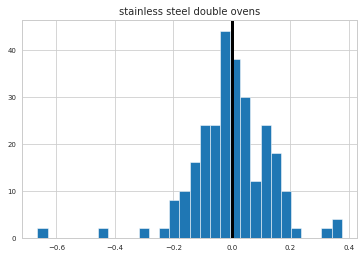

-0.0037504307904573046


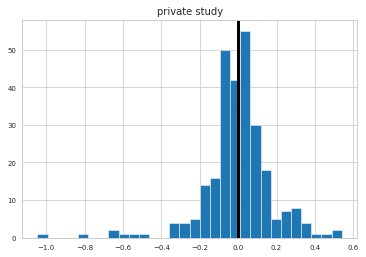

0.008160385465636381


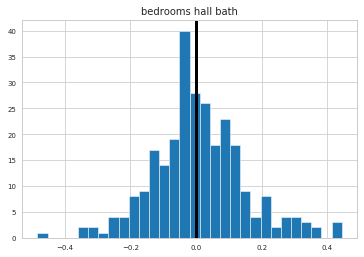

-0.0002962857897415021


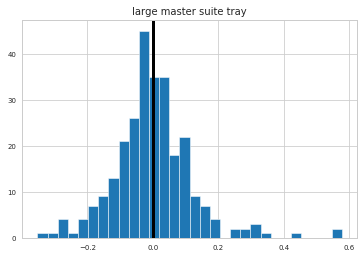

-0.3525032376910738


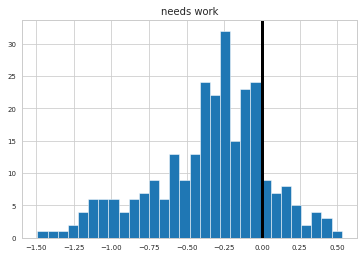

-0.006433145052581042


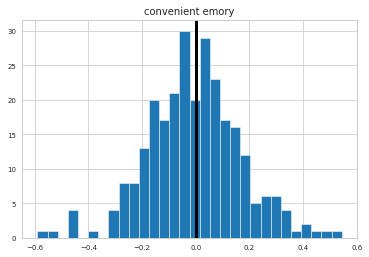

-0.009684539700489292


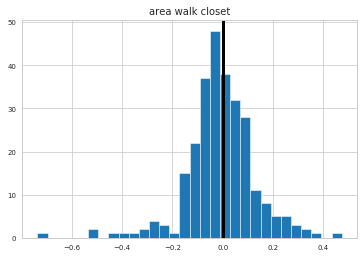

-0.0251764558716922


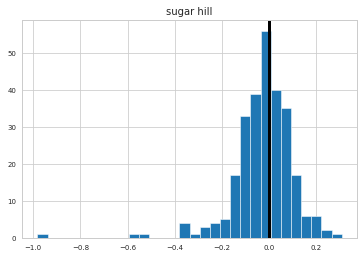

-0.021687987263423525


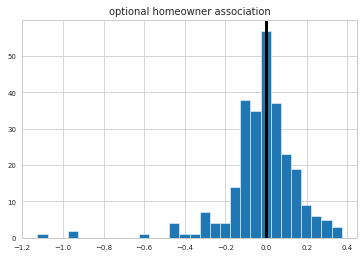

-0.11656234454606547


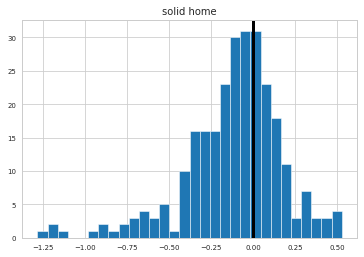

0.043407022510622506


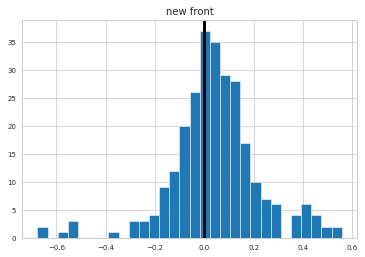

0.021227620192531646


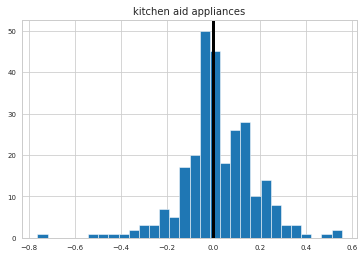

0.03073209319331384


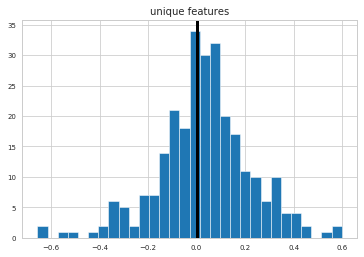

-0.03606758348611008


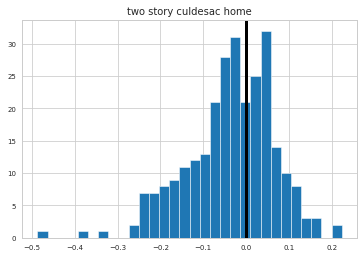

0.03783265000508042


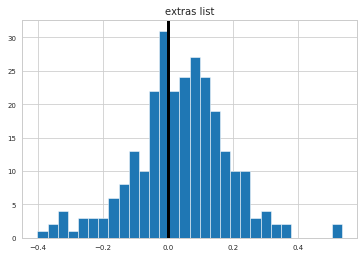

0.0010405741396541522


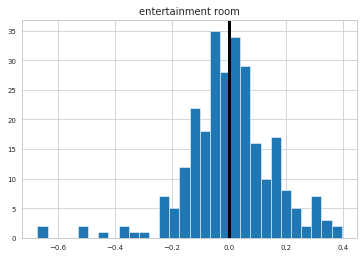

0.045846430127975735


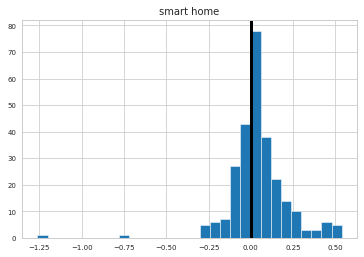

-0.026417778240267014


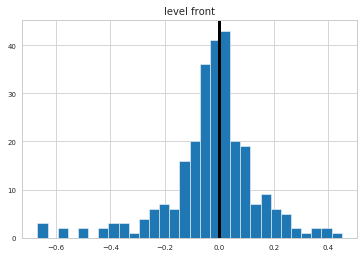

0.02919171079703866


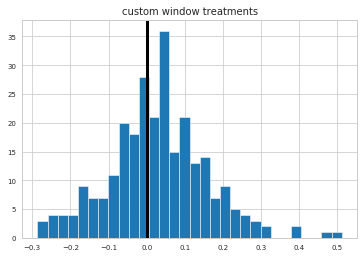

-0.03389787854879625


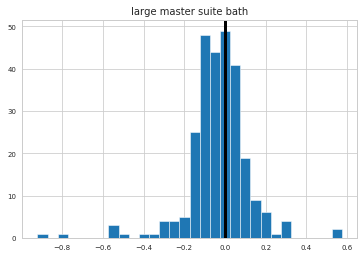

-0.001518379834791647


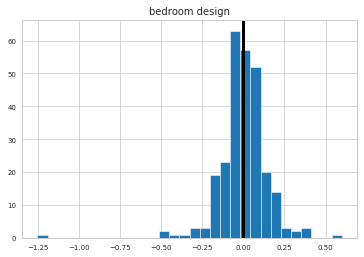

0.03513020997310868


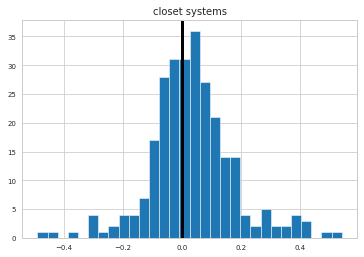

-0.1793277939816953


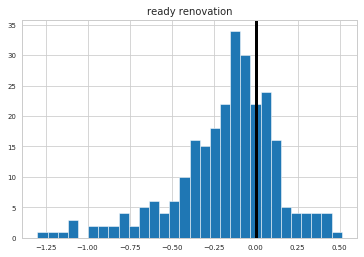

-0.004348027465092533


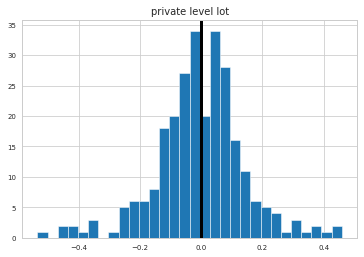

-0.26616851132216274


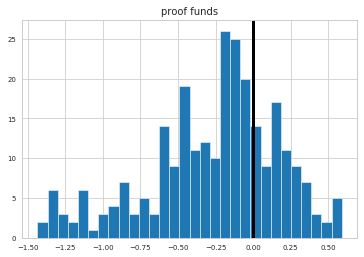

-0.0010253104963471847


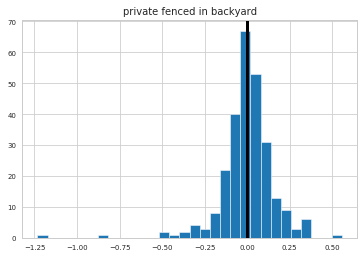

0.005441448047025793


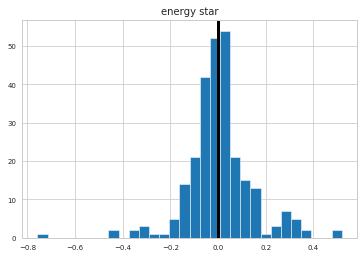

-0.01116279914267139


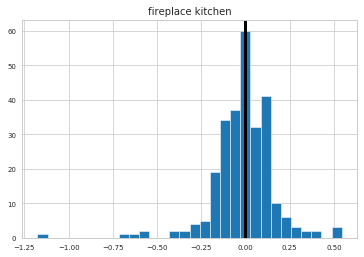

0.005646473885674748


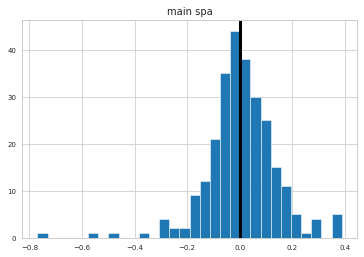

0.004698371105976785


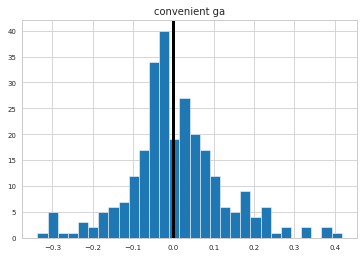

0.004172048870678109


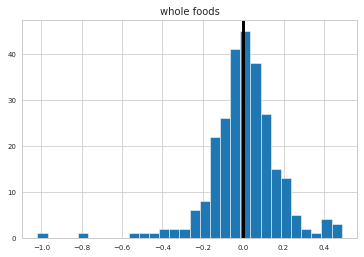

-0.009249416519584086


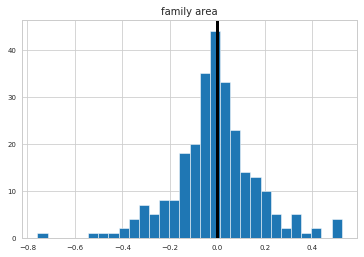

0.009934271015698054


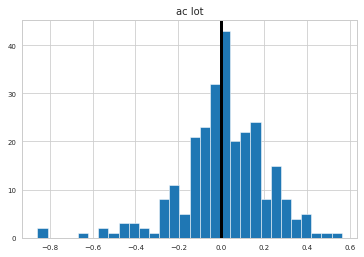

0.0017431522329743293


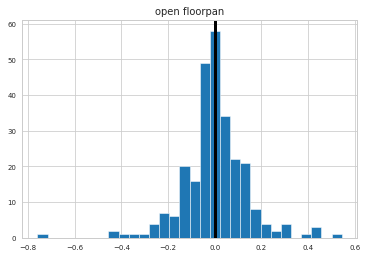

-0.004700603025027444


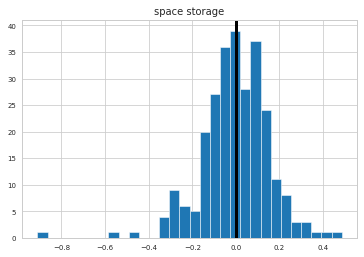

-0.003263688043065011


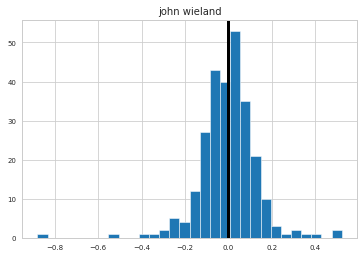

0.01025749264128495


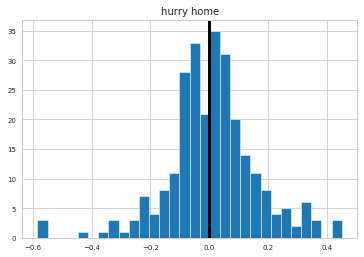

-0.0030769407156890872


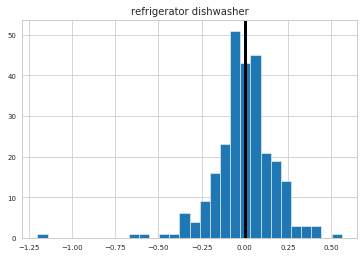

-0.004743576098240703


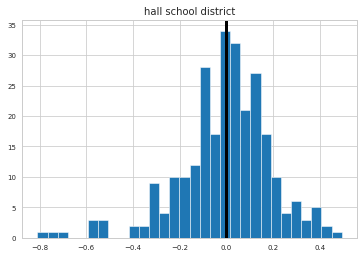

0.03678077592860038


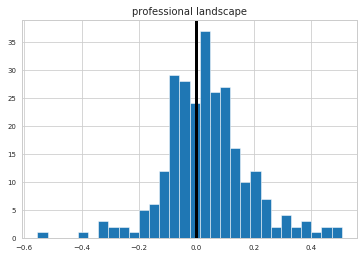

0.026764793564117116


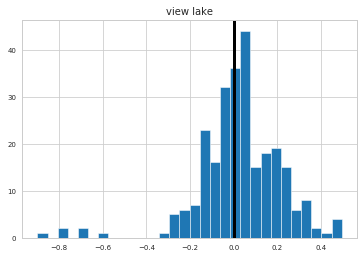

0.0015877331881512672


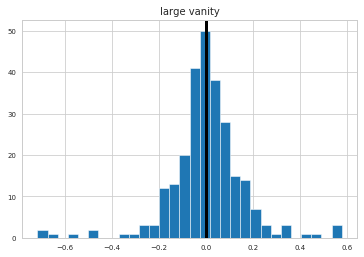

0.0010528326969215392


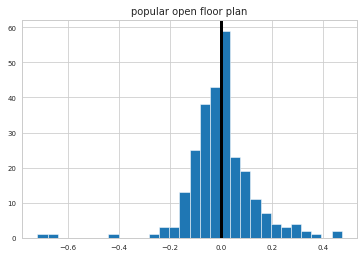

0.054120684685469676


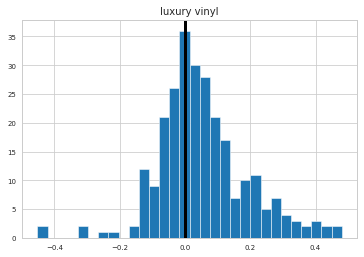

0.04393546334315695


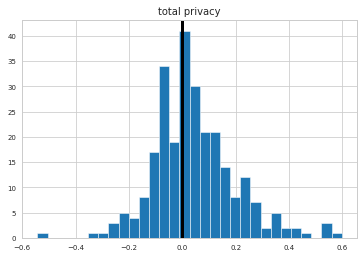

-0.001619184883290547


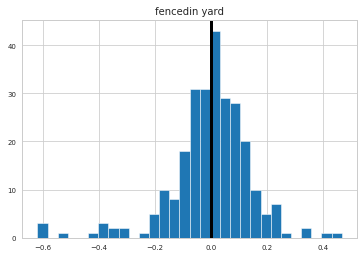

-0.004236600296289


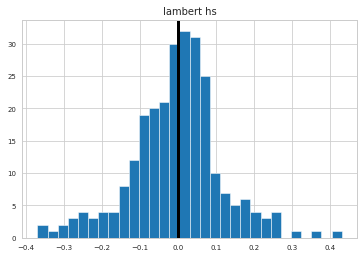

0.007751839993880292


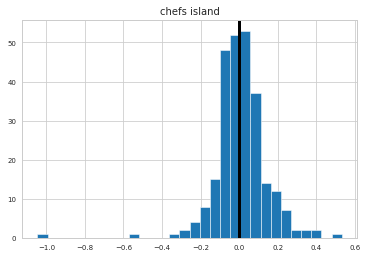

0.029569150510902423


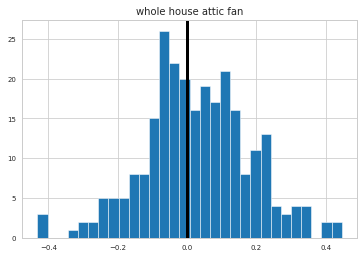

-0.013080673159518108


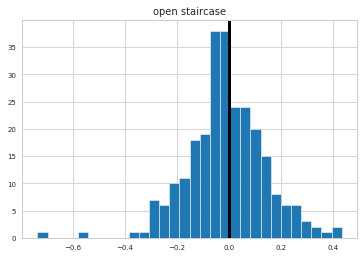

-0.03583959246323359


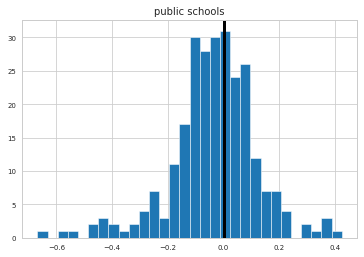

0.03888127111316688


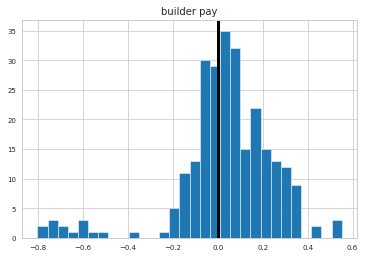

0.01664454837368203


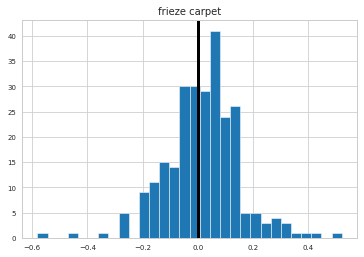

-0.00865662851363849


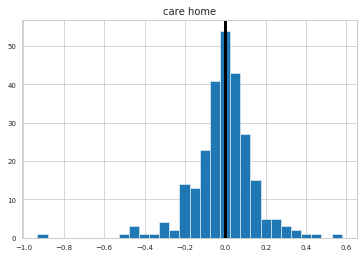

0.01472751703055328


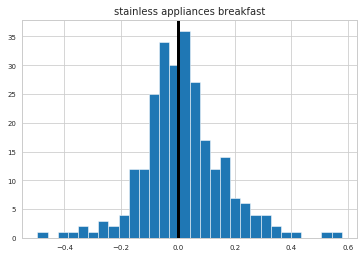

0.006238995061128059


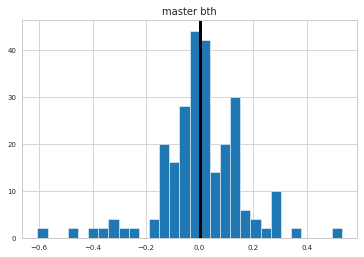

-0.008830739225573694


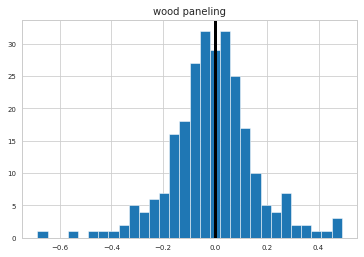

-0.009410797054593726


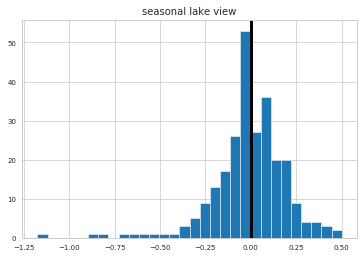

-0.003732559068946719


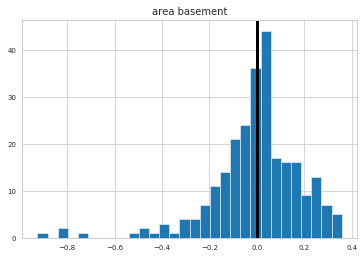

0.031966688400460866


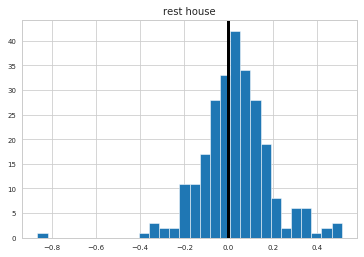

-0.014045502489475795


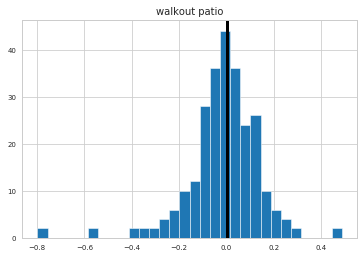

0.008538499938709207


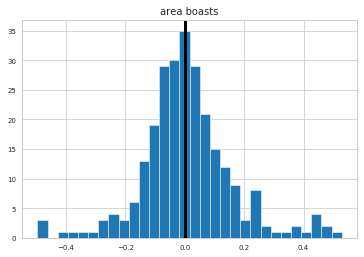

0.002451430350136803


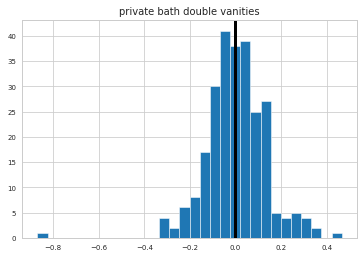

0.01893683676738406


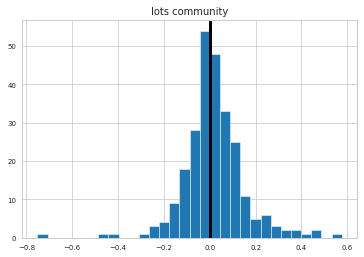

-0.01216057896624158


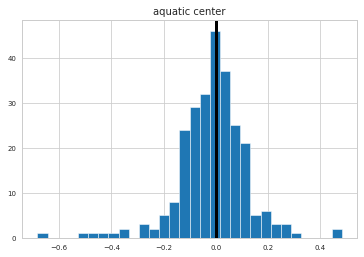

0.047167886237496466


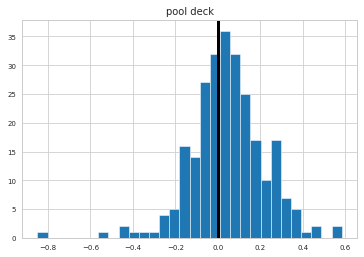

-0.012106816593890665


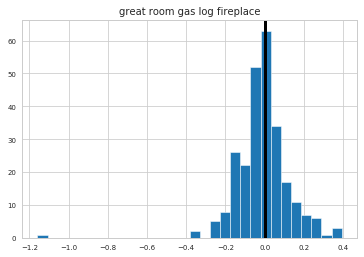

0.015915414965820853


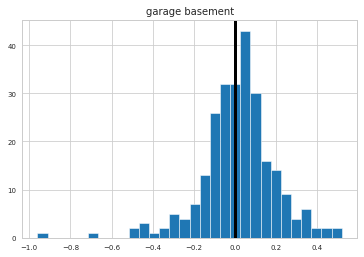

-0.02000151037576769


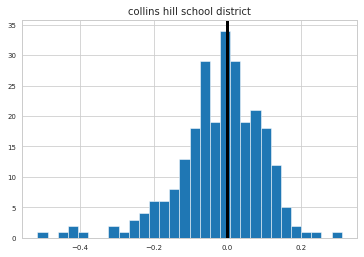

-0.010038749027005243


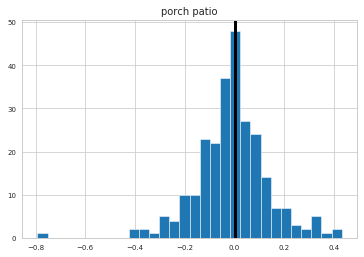

0.014636218626391872


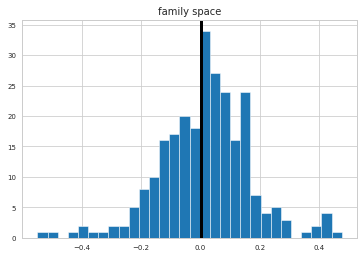

0.00601734759364912


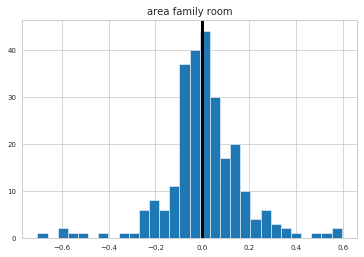

-0.0025587840926079176


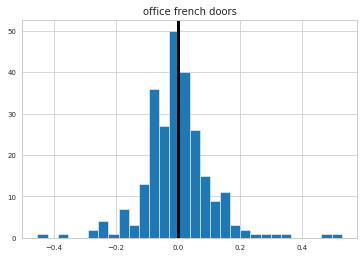

0.005428658652095534


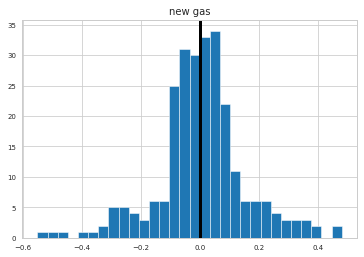

-0.03127839051004072


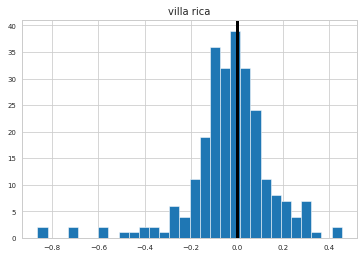

-0.028334951485414848


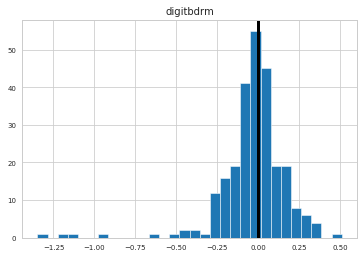

0.002325341354401096


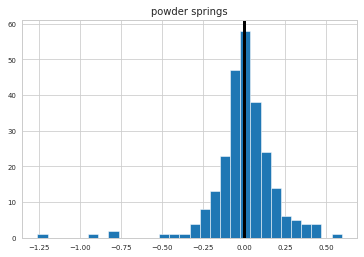

0.033708882947936045


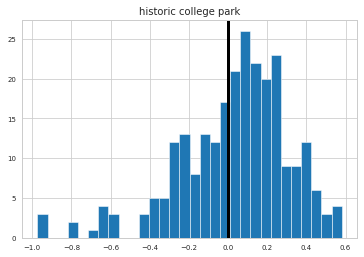

-0.02469815175322119


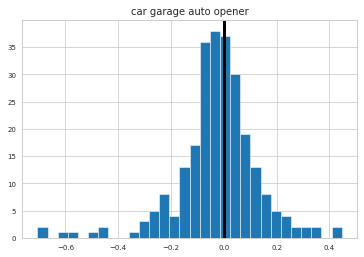

-0.020867409254637433


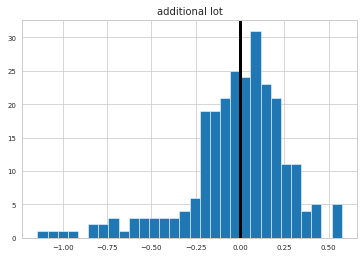

0.01683099503951687


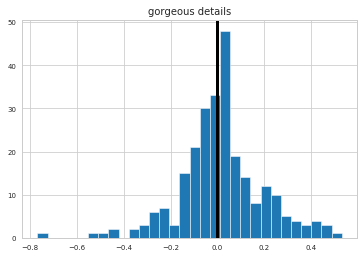

0.059704459990670346


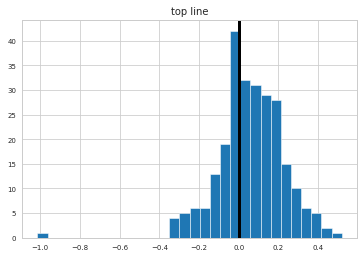

0.006668966347891287


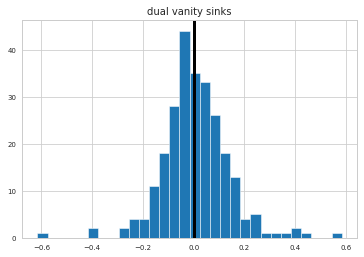

-0.014254889068826979


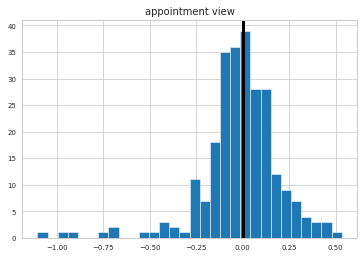

-0.0008175132774855837


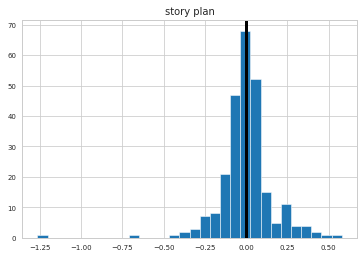

0.014957840795611525


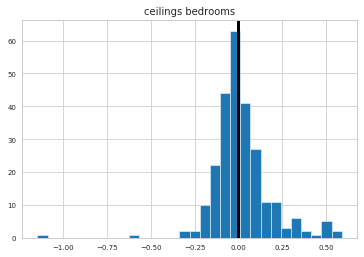

-0.020224570025970823


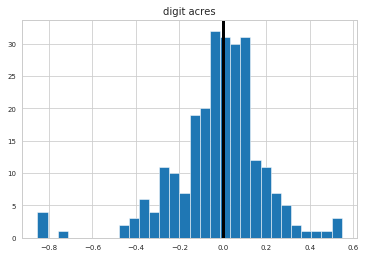

0.10842802171791302


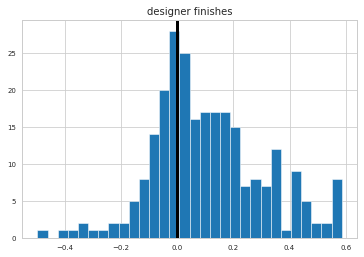

-0.00718093474933032


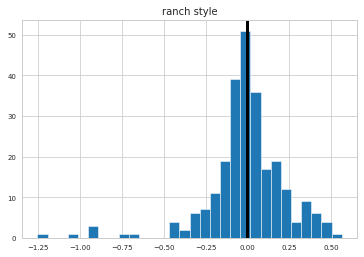

0.07687440757712456


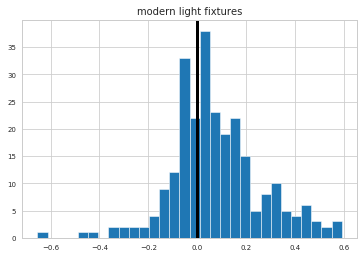

-0.07551248610323931


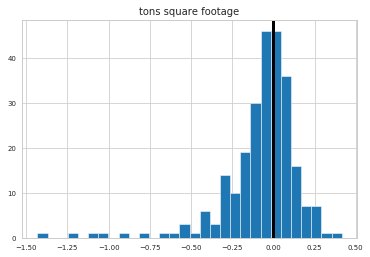

0.0023762597698546977


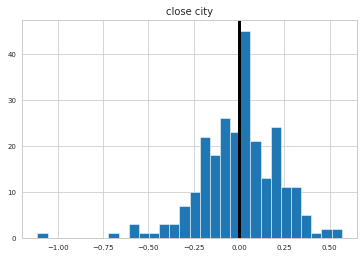

0.02182427431533971


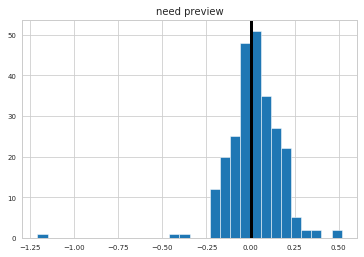

0.049852700241815484


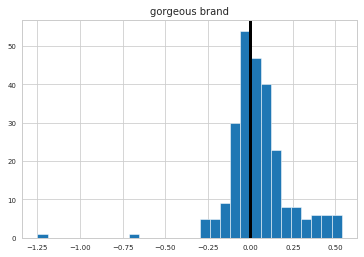

-0.03999333769794607


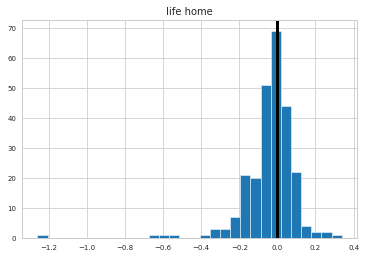

0.0012352377545201318


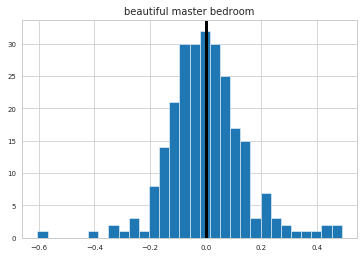

0.011177347512378574


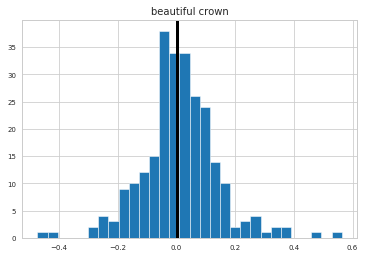

0.0015211444184897707


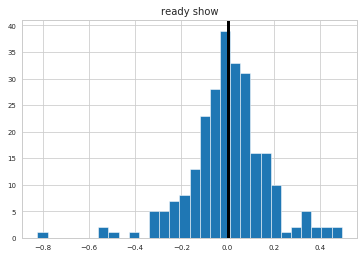

-0.005820403102235617


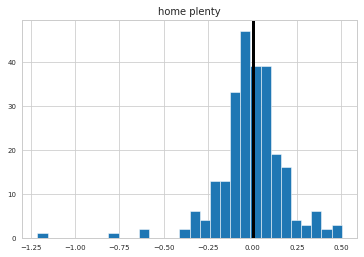

0.021413942503600458


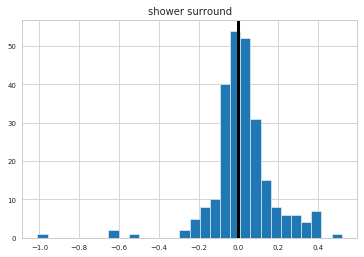

-0.08008203151782595


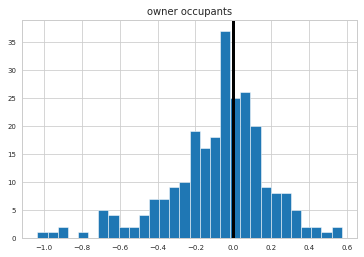

-0.019865627254891723


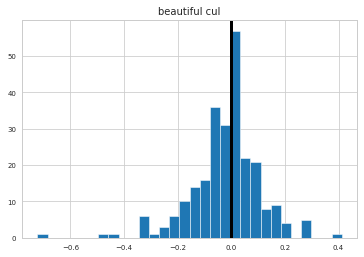

-0.006923286577559201


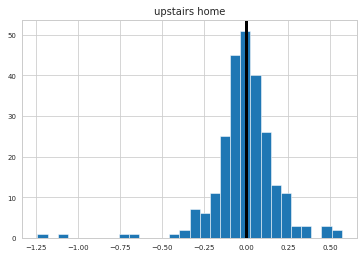

0.037923312028223945


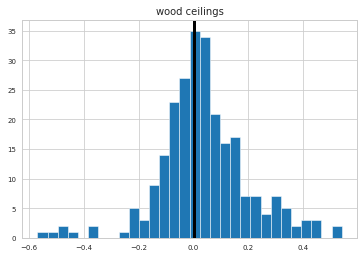

-0.03581959834207881


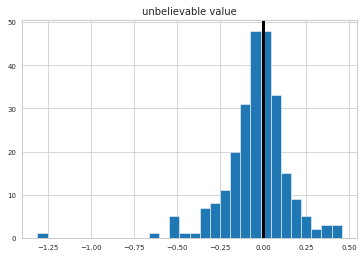

0.012637189612567882


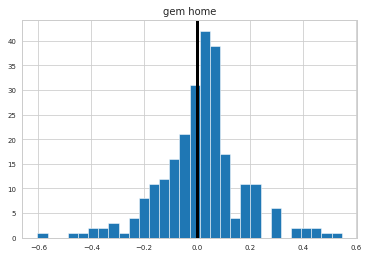

0.01824558452709163


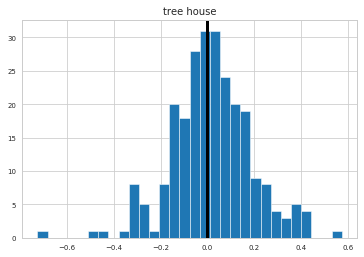

-0.00716862317231755


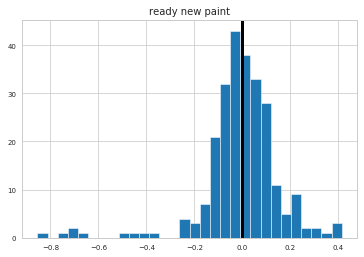

0.004942414475096275


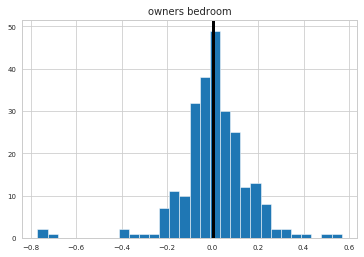

0.05582610939850766


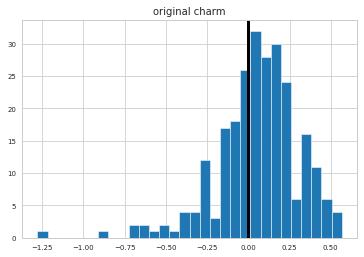

0.019989985698962414


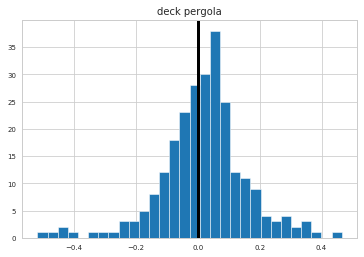

0.03394956120189735


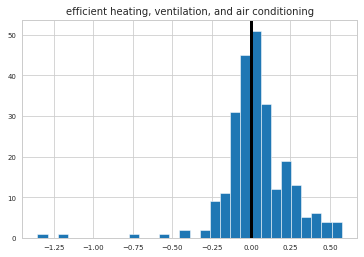

0.0024812941818636233


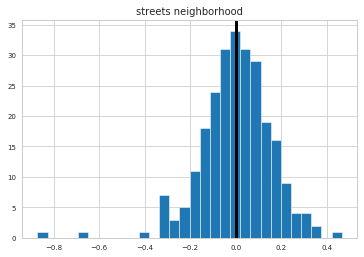

0.016170796878402564


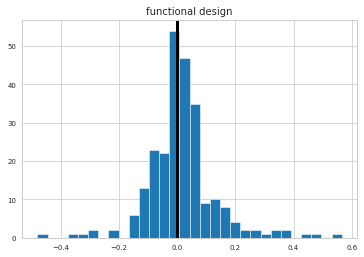

-0.011487232571117265


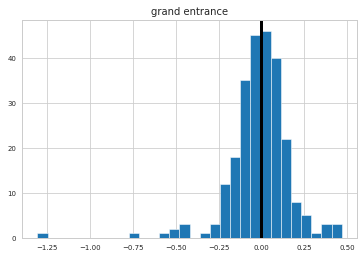

-0.009803055779158501


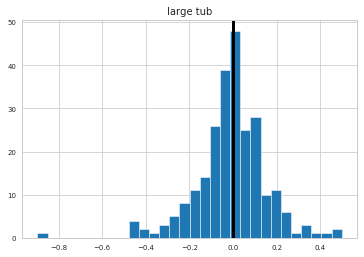

0.0018433448756970448


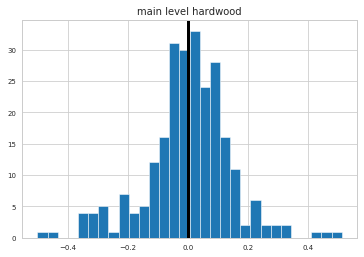

-0.004749972552809354


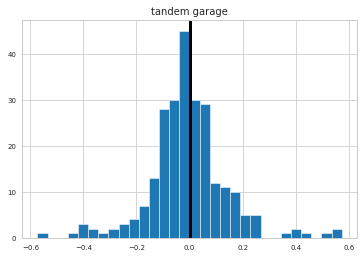

-0.01302776463555938


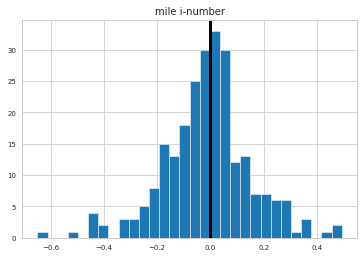

0.048302885974342395


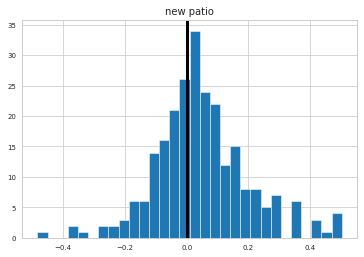

0.0016568714671323641


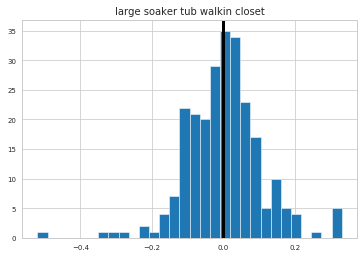

-0.020342829138201783


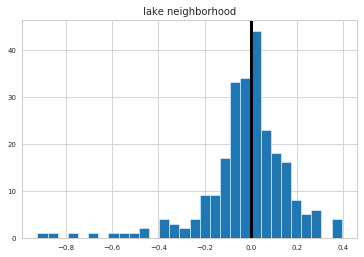

0.025127044567629344


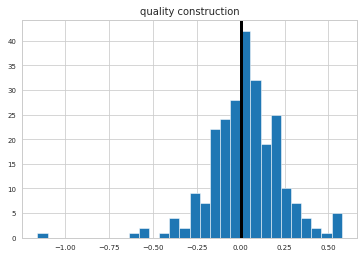

0.02571962038453057


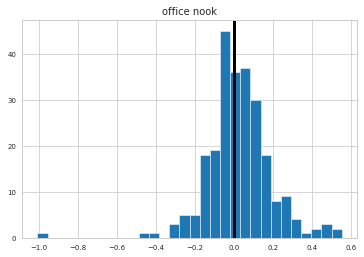

-0.004060263294243342


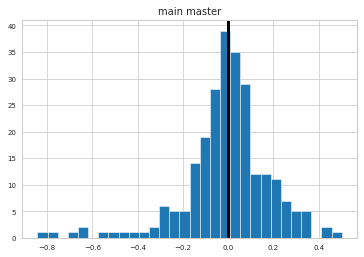

-0.007287749419279978


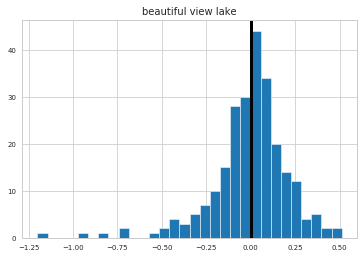

0.005366740470334802


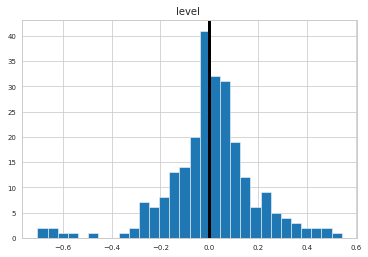

0.049973111235311715


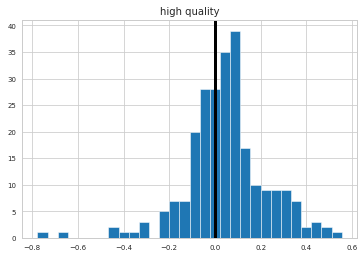

-0.004249669278529429


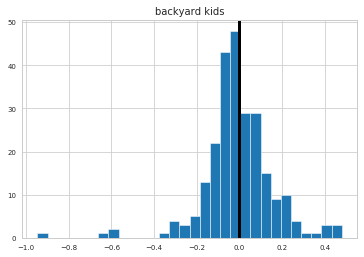

0.023694512319354696


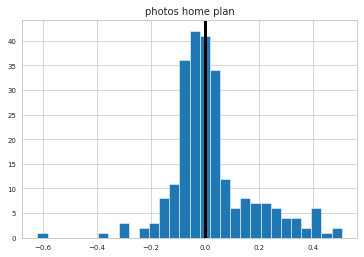

0.01790150681062382


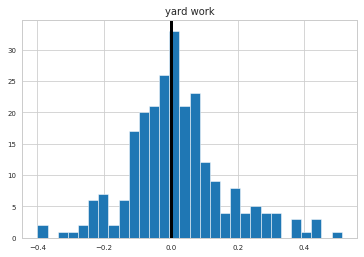

-0.007686342049379915


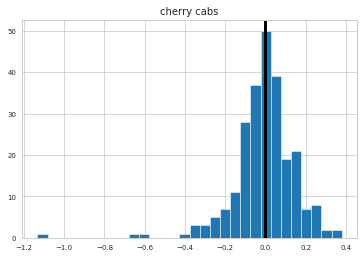

0.012376569598694612


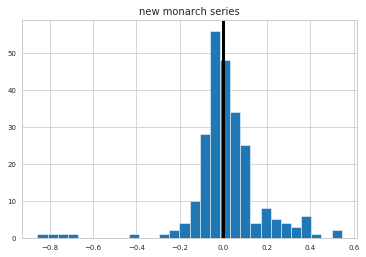

-0.15316686688972783


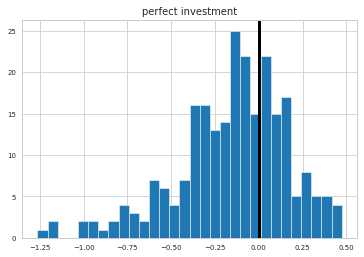

-0.008198430589718576


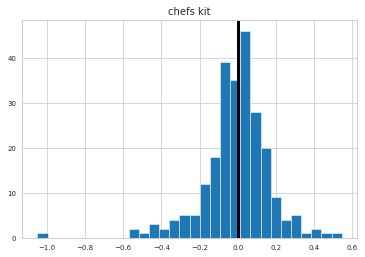

-0.006297503299371879


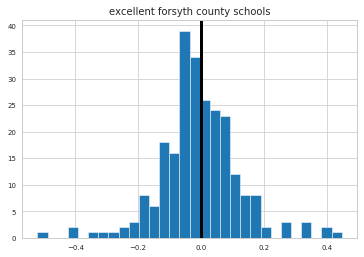

0.010764397911839954


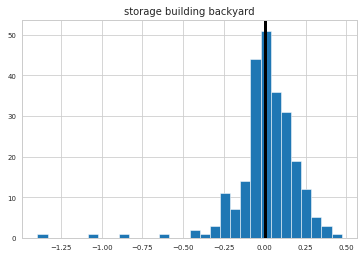

-0.006100148905249664


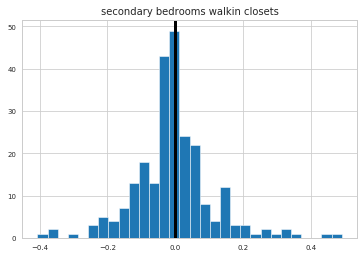

-0.019462793677681257


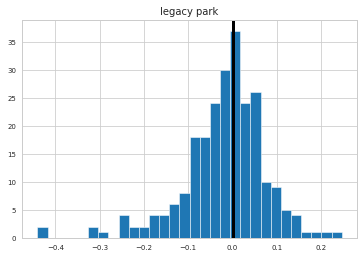

0.010328657443056234


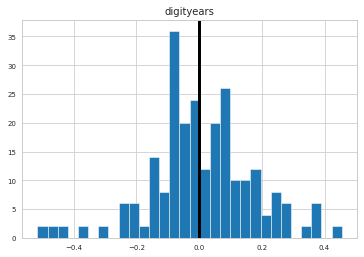

-0.007390670474002901


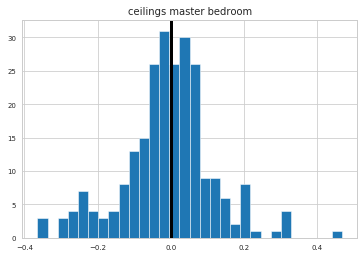

0.011154958746964216


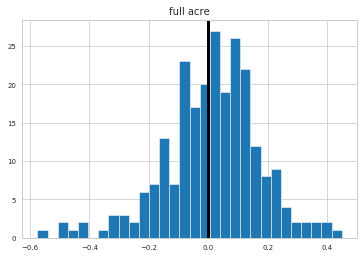

-0.01947695632710899


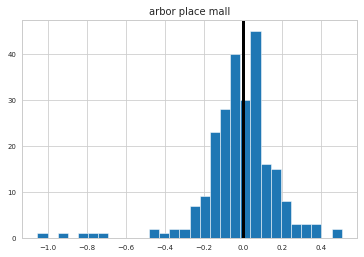

0.013782181682689281


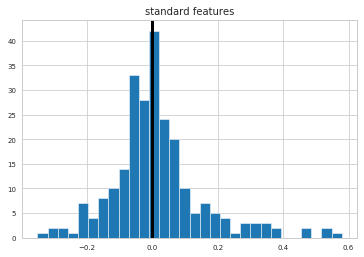

0.01813135189775813


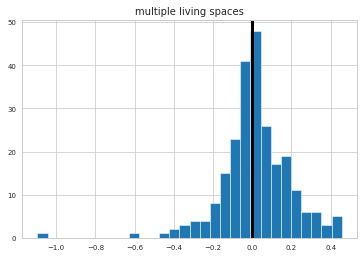

0.04430813168608141


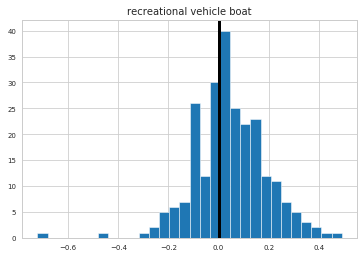

0.08595258883841013


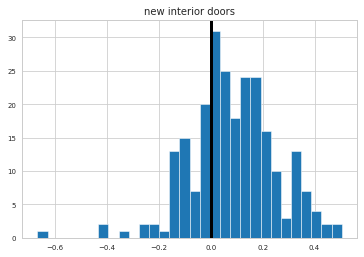

0.012013675656964238


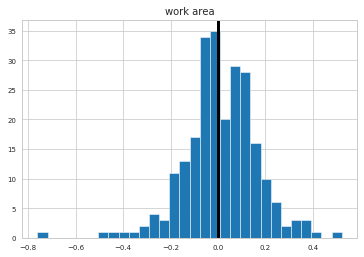

-0.004397966000124963


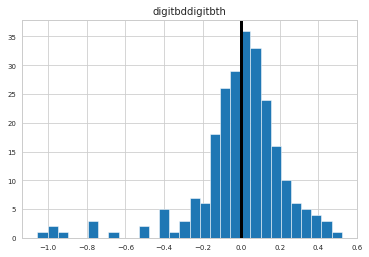

0.08770514678594252


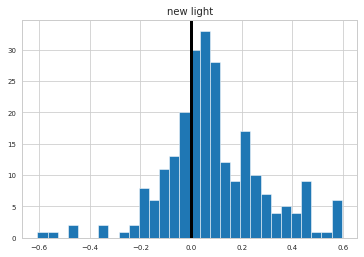

-0.18270769088415248


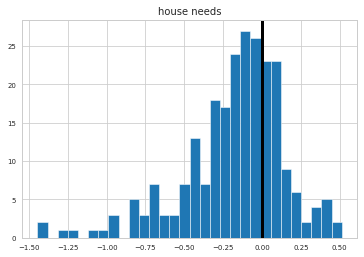

0.03543511719569013


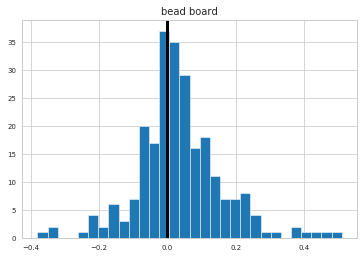

0.0005967486481290369


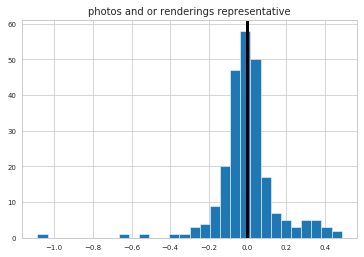

0.03408487994366468


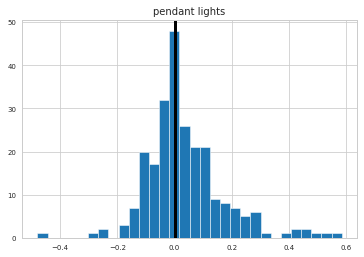

0.005117735973584058


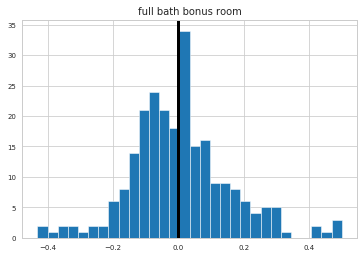

0.05527862770112978


0.02306212749646758


-0.005722136854847423


0.003907533726742528


0.01890375336633886


0.00816493668052795


0.022210662122051993


-0.040483908780613614


0.0017330058629842922


-0.047776748386617315


0.04365954734867743


-0.003195015152017013


0.049349045336256024


-0.006696200786807361


-0.006360291108006071


-0.00424903853946045


-0.0017253203632394808


0.008292466847004614


0.008700303885115359


-0.006504844012118468


0.0034011661208019836


-0.006059135365103581


-0.04335802150636651


0.003791896270074166


-0.02441996553807916


0.0007886429735972122


-0.0125596818407726


0.00719423093043179


-0.022774442716747244


-0.007689972747153181


0.014634107739797073


-0.004818617755814657


0.1294679768799252


-0.013692198264235867


-0.010084021755645241


0.14125067483953224


0.057197612213359644


0.03319428995785708


-0.0005564066610083105


0.05020115056219913


-0.023016937761326406


-0.006633320677022508


0.011332081993060248


-0.008186825246369293


0.021014597957794676


0.010247420823254812


-0.023876515738910378


-0.009135717678891368


0.005346141614016064


-0.030136022925044935


0.03337814425686421


0.021778893768706082


0.006984093293331483


0.053143612704720344


-0.010420721342665005


-0.003775690056880951


0.09474499805589122


0.011202275746128849


-0.021176523189870212


0.0019107266687359503


0.12111012899048337


0.033091343035935666


-0.008125380339123587


-0.023669974739729326


0.0071852703143315926


-0.0030076483706415005


0.036378674161682056


0.0038502301708384936


0.002591675029708304


0.004432342420355878


-0.000820982611542591


0.011083178957686835


0.017231070873427543


-0.021077298416444984


-0.004746930984330328


-0.001961577753958002


0.012244476144644537


0.04587290282231581


0.0036825895770214692


0.007775544449708295


-0.005314864885723758


-0.008629417960489825


0.032395397919441224


0.009606913203750072


0.0029272386219987446


0.01673705886818794


0.019747400327346853


-0.03585723380627626


-0.012591274852240042


0.02493510051316861


-0.011616870439322224


-0.025311571554344804


9.920920450154088e-05


0.05566450337660995


0.0007619129246464325


0.0033159675483904866


-0.021967282298226736


-0.014137519980035115


0.004189506306888935


0.005516123075763512


0.0007497297650711874


-0.01119989809915441


-0.022415093698214483


0.00922880470757038


-0.0042687311542821856


0.005968109666920072


-0.027278191085330545


-0.031070503409577375


0.03971004770884566


0.014178683979305327


-0.005730147431242322


0.009016599194223604


-0.00936403468701357


-0.033819425309097595


0.10097449259498564


0.01307505898771218


0.006021956286182711


-0.009340214090184894


0.016350602435160302


0.0037611040870422744


0.04166368289349674


-0.007130310250810178


-0.017566518170165236


-0.004481193286858266


-0.01579583102198277


0.00550127426314571


0.034344561376711935


0.05841740208563076


0.01176430420220504


0.0038570199480715507


0.09022033694862427


0.04979039880755757


0.041312192648424374


0.012887761160337333


0.021131727961600417


0.03493553912691385


-0.013659031289557023


0.02416766342917987


0.0012128340601707723


6.283727518737635e-05


-0.012681990326179025


-0.010651945264411706


0.08448090034394114


0.01922870425642722


0.00046610112005138156


0.0241542464576276


-0.00879270364374338


-0.009703704808701061


0.0442293373971822


-0.01878416787368539


-0.005802214651828189


0.0019472229256537593


0.012342720931718718


0.007849667954680235


-0.023825450909525495


0.015427484592911957


0.03957678880238667


0.011458505850811564


-0.011842508970685737


0.06899700028008703


-0.015385277257815013


-0.009059241008045985


-0.028552251915688814


-0.04658796511458107


-0.021964712800228665


0.003164118328038412


0.0014909407217541342


0.04084291253507016


0.02099568159299685


0.0025235060327153994


0.011519930681986005


0.02709978325650213


-0.01456301175400087


0.0012898417913271946


-0.006279297809135608


-0.019885220424029352


-0.005905305183498863


-0.0014647916955438816


-0.2885708453128259


0.0037857835405178553


0.010152465401945816


-0.000811609581575159


0.03172951795115395


0.01973939009595871


0.02507098018467843


-0.002324415082099014


-0.00016915884421208545


0.006248590649681615


-0.03689087465426627


-0.016427859905647723


-0.011031403232687222


0.025908760892160796


0.020240978293961397


0.022872528601097848


0.006371920926243118


0.005509883081903427


0.026353511706101736


0.005259764355988039


0.02047909585463008


-0.0007177473602052958


0.027124220522918123


-0.017403743939830782


0.03232180630478056


-0.005044877861239225


-0.010795670900577134


0.021590664181888743


0.012106570885835137


-0.005463715778387486


0.01216124003816293


0.0041111067289654555


0.0088899179628229


-0.016869964407603445


-0.0037711777927657377


0.02640369554336613


-0.003257423338471512


0.008978648554443058


-0.02117361072597826


0.004152773215970751


0.034605131929942065


0.05026257441747179


0.014592044050970318


0.031968438163250984


-3.877635855808385e-05


-0.016723965324353513


0.03733933601788343


0.006730042742643314


0.012088253324122066


0.03177936964985799


0.01424098760830845


-0.007325436235516534


0.016032647540340193


-0.0024083234018643608


-0.02459094433805122


0.021150674711870616


-0.02191705218463278


0.007500123485982985


0.015822993083975626


-0.18772357184322855


8.012777790152632e-05


0.031448666145652754


-0.018000222466551325


0.02003344610073482


0.0066280729162476034


-0.003695047137323585


-0.004502954706191632


0.036479649381909736


0.022270720533487123


0.03401246363338058


-0.005330314105148657


0.008653000071912524


-0.009818614046395367


-0.028531544847740516


0.008874533246761648


0.017677918131578683


-0.004277188415460837


-0.010361472285966648


-0.1254915512877139


-0.07537258757796704


0.02144673218522237


-0.031206094378320656


0.040627009214463425


0.00874394224988115


0.012863250223575696


-0.010718565987298763


0.06375479713560334


0.08858358827481859


-0.18593374712666091


-0.022285344889970256


0.005950917524121622


0.041319075311852506


0.013073962025433549


-0.01791340710449772


0.007850939923653483


0.02855281883962424


-0.012301060774442651


-0.021976915750145508


0.04267408876840423


-0.0014496794607249148


0.014674852768760705


0.027326087054609913


-4.189709338906787e-05


-0.0405801207877223


-0.0026287092377687044


-0.002711256791101034


0.012173347184531865


0.030942671546427932


-0.03908922308228921


0.007698263955058138


0.0010693389707032907


0.006172335347668551


-0.010790047667330528


-0.009093653001952608


-0.02738268418264854


-0.13440827730641974


0.014257412287073135


0.03404374750327615


-0.01686403560627493


0.03495300114416865


0.0022540661676254668


0.0035362591529839397


0.049894863949711654


-0.3578123382917579


-0.011172810395811203


0.01899469585431305


0.06094632233517475


0.09620094135910687


-0.010987960310212904


0.014811253366327205


0.004512886824929167


-0.009505242754618682


-0.009966722218818825


0.023849382693859552


0.017645405044891854


0.05397560437695296


0.009255911523195624


-0.018824277955290965


0.006535826901885401


0.011396030150550077


-0.0028823058154083645


0.0017830350856143653


0.009207525871015629


0.012940461378983466


-0.020342436685917994


-0.019697168610738554


-0.010060993742656508


-0.0069974002272463354


-0.0022648316450621987


-0.016626776951460278


-0.020737665828292378


0.03450968463722007


0.014610019683322761


-0.012288362569348472


-0.04150095449040985


0.021144391031169763


0.052134502948467394


0.0279368315576492


0.005295870537770131


0.033104834632960024


-0.0488013848500291


-0.01727268717212035


0.014109044909330714


-0.013428311824897971


0.02446717596196323


0.0010911852467124375


0.026950277379953053


0.027946350007876857


0.009751270032160506


0.023201446972616675


0.027443487560721045


0.0116948661090775


0.0527662933370347


-0.05158534019268499


-0.011202315022743653


-0.017114169683243568


0.02030887711285551


0.0018157899460106476


-0.017047052435464262


-0.000836096540482978


-0.009195118444927434


-0.0114720604565074


0.007502612803737017


-0.0057884497498989


0.0456428825669149


0.019059251282153713


-0.012316721538587263


-0.022219332340709684


0.04090906006515707


-0.005153116022064212


0.00041057843597435545


-0.018349338835091985


0.009283254422344381


-0.018878512397546954


-0.1821139782883462


0.006622706858082225


-0.009226433691736445


-0.0024118655617033553


3.295951269596041e-05


0.020382780709717524


0.003016375569994712


-0.015036016581460693


-0.03256121249244434


0.06260801597815716


-0.009608159557270141


-0.05651409815462693


-0.02698502343489219


0.007032513089185681


-0.02146372534115999


-0.02925905257477023


-0.042105832733514356


-0.010686151320087772


-0.003954400265758602


-0.3312717536277564


-0.016436143255153014


0.030662476036578158


-0.008522354780462354


0.0597234098305826


-0.0106197133653343


0.0038412907850781768


-0.001584573575379951


-0.02750287198106747


0.007623753672711031


0.03638372810237271


-0.018254601747680264


-0.005048730027043937


0.012207130514574362


0.05290441301415935


-0.02775271395232775


0.017237801570986026


0.011973790604412456


0.01800284257192295


0.006588902676218927


-0.008174877212597331


-0.0061700561614350035


0.022590542981858978


0.05322076148838436


0.008703718146162626


0.0008837784300565177


0.10248187580874378


0.010309687380402758


0.025957416592894158


-0.035617644223764275


0.04163640489060545


0.02403867728801736


0.13448502511509125


0.01703416598071855


0.004130895538065067


-0.011751938441172597


0.03689752503836065


0.02915857856301293


-0.003938661538187847


0.001287762589912215


-0.004215551706594464


-0.005929337580750562


0.016591021324647716


-0.006808385630270207


0.008070247056945182


-0.012771198736718548


2.866353930076745e-05


0.023502744717722627


0.0363852780617808


0.007093935839565806


-0.004063535197458286


-0.008829013147608792


-0.017632138150424706


0.024369911601427926


0.03589741908157099


0.01320644962018671


-0.05062303274661846


-0.004079024629130914


0.043167208999936


0.03252200811391095


-0.020023125783053382


0.02323762824292854


-0.005528002880853341


-0.03316349688803755


0.02631438281679258


-0.0003561438123475334


0.0019512444406632563


-0.027831503218317608


0.013170127756157503


-0.009853170048600658


0.03155264455362084


0.006905568572751084


-0.04537662517351533


0.0240321750975899


-0.21762837529772042


0.006846686193114495


0.0045707810544366595


0.003841501828750087


-0.004291896992696923


0.00483274152085677


-0.03095490367467278


0.03255418621898511


-0.01638255428108285


0.019997743783720375


0.02406403064334026


-0.009201525477951831


-0.01097756240570971


0.0008352529851726691


0.00409959386191273


-0.0016363166339868173


0.05033472148010079


-0.003294990131161096


0.003837319140833321


-0.005365307525186856


0.004569777447060955


-0.08145604409408289


0.018276351817724742


0.026502131897828032


-0.041318632181782604


0.019170427514619334


0.016352438542610426


-0.0021870669958643303


-0.018495077618201575


-0.0054961246172881215


-0.0020542659677130174


0.0010111696957679232


0.015443783759603254


-0.00788569718467707


0.11426963075453062


-0.032690891852579985


0.05242273056657793


-0.10312542820262505


-0.010339389428276403


0.0473143335479663


0.01882258403668837


0.002663585699459491


0.05199442650350543


0.009599562297439673


-0.018902943793908163


0.1533885884863907


0.05720304663254748


-0.012518353180503799


0.0024240402070698688


0.02397898002845751


0.010370567465780231


0.027099023229837226


-0.031012356522760583


0.030483259282075688


0.01796653384474235


0.02339191501483704


0.01553359361565838


0.012732508321310801


0.028145504328682198


0.007381997856076293


-0.008038631277506916


0.0027414759397116225


-0.01337466927850426


-0.0035726270105201764


0.0164575516279244


-0.020862054350818823


0.012841447429834096


0.029685480133529448


0.020214800703841407


-0.0017885559223391057


-0.0015380306712935734


0.0007312878141437602


0.08474264521972888


0.03156822433082543


0.004453997362796179


-0.012683545234872487


-0.03927077052523555


0.008378643885829136


0.040836205183133724


0.017263708558823816


-0.04717387642682351


-0.007894529352240944


0.0017185481075532325


0.07618847002286519


0.009775261526443715


0.015468064873854187


-0.023303244958926994


-0.010750334002383047


-0.013442802818123585


-0.005127931893938911


0.009454062191745903


0.0035311486897236545


0.0004391728852196162


-0.018004060182116106


-0.007457835522024907


0.013190447921476892


-0.03545822311220417


0.012021575268296647


-0.007319608615781256


0.0016666625536020793


0.010396428558664267


0.06113971261880475


-0.056681055611187546


-0.010498707160917135


-0.007933963402666227


-0.024254839453766646


0.009068456336108659


0.013856537540188642


-0.05116444164554294


-0.006522691212450595


0.027703812384176973


0.018259392942855716


0.009621135447977696


0.03432367910318104


-0.007672421135511145


-0.0072844613997151125


0.0295777802292064


0.07553338720044987


-0.004921643815882968


0.048883399198571986


-0.2920313487692513


0.013702266187003447


-0.014438096652072654


0.010640100967492143


0.019907914841407297


-0.0064800188488490194


0.00905222385059726


-0.01781902013826426


-0.017925574931425572


-0.017097939929405854


0.00901482129013543


0.020519179111838027


0.025690179649635155


0.005953410056750287


0.03557911602687847


0.006561114438144713


-0.0052563596061364765


0.0040971062386020345


-0.01480041851635018


-0.025256015928204617


0.0979442458999245


-0.0443335230380246


-0.001441181566756044


-0.016106585192214765


0.01113401847114629


0.019417320832185888


0.02535306123371514


0.028906884933706155


-0.007199422060709733


-0.022587045650955092


-0.012634357939666958


-9.637494516325632e-06


-0.007552588178446837


0.04363798295842737


0.03338789473403768


-0.020318187237183788


-0.004188586387881806


0.055578501775392586


-0.03935904365010339


0.044668893898102094


-0.017885852559010495


0.008966877250551402


-0.0005479690755339484


0.032558543035096955


0.05491163032836096


0.014860628809522512


-0.0030890435010343395


-0.033543640182829425


0.02670894635227712


-0.002548079557605568


-0.007727522923390468


-0.08153037218692748


0.08868878961354396


0.051932011401878274


-0.014249160829466178


0.1397611423307163


0.036001751758826986


0.06278545094713216


-0.0041178405795577805


0.025815616248582248


0.004536137096521353


0.009869957136376012


-0.01879378248911226


0.06317818791897921


-0.041795475164872836


0.004934213702150259


-0.004187074158125002


-0.004370798854191383


-0.142327237191535


-0.07205538684491186


0.01311071917744171


-0.021157162206427653


0.013872829949931305


-0.02506892095975939


0.04387300622842993


0.012098215455769251


0.008316446483860986


-0.01426094466681965


0.02202574685132448


0.0033990179237804907


-0.007063624391962027


-0.014765653580708596


-0.00641049776044804


-0.017251365534572877


0.04101736323970552


-0.1783875076827503


0.01965603060690579


0.006957094624912148


0.03580605721510563


0.04231727333285355


0.08986331057506508


-0.0536240927206529


0.11396561417408568


0.02461287238320439


0.023206857228249195


-0.004326498549961214


-0.011715000820972491


-0.011140811544120298


0.0194902551580034


0.013525788033165264


-0.012566802838589386


0.0035999877764811474


-0.02444007416904218


0.011729684512807476


0.031231002668121014


0.005261376964522652


0.004999969676018156


-0.14047144919943128


-0.0022276479070716493


0.02951676289950551


0.028266549502349424


-0.004693558984226549


0.020923596350277206


-0.00018096816339489694


-0.027570825880159022


0.015151889496575907


-0.014833112970681196


0.021109995723757956


-0.032268685640736865


-0.024879530979038677


-0.00031156427237864916


0.0056517198301903465


-0.011849667160006554


-0.050364449619599405


-0.014251270931464322


0.054022966843052495


-0.010738447089048427


0.03158907158013279


0.026809232726780742


-0.011942052341225294


0.06326353622995651


-0.013110115029878558


0.004321464617723779


0.03589137851128203


-0.01926790912616262


0.006917311105639437


0.017901501494764945


-0.0121504940901042


-0.02099141549271043


0.006663834395827207


-0.015234255215949552


0.07185316843577562


0.022269079188096872


0.07469057262398507


0.0721047752197475


-0.026287973843052873


-0.004680297637564393


0.015139913116233151


0.01834100280722786


-0.02388206490157123


0.014735401847573491


0.002192557101539106


0.01341785721886744


-0.016907160784994043


0.029312751398587245


-0.008061286674443906


0.026068364776328578


0.017372726688461022


0.0034959052519506297


-0.0037158242482718444


0.05497713862686817


0.0005446694045775042


0.008635212036316014


-0.0009147812246408566


-0.003992110485974296


0.04152316078716377


-0.01978856733607945


-0.005115422666299913


0.010834144644810239


-0.02196789716751004


-0.02682388358489185


0.025873377648822034


0.04336282404714366


0.05909336082256598


0.016083408674445784


0.09468454449696852


0.00995001207440174


0.023403617873608836


0.044653618483994406


0.014336871249156556


-0.02755652682861134


-0.015146096521174475


0.03278637814769659


-0.0005811709361997342


0.0337637857511402


0.006113833216823107


-0.01131104507428186


0.032334316487766426


-0.02643412702185915


-0.08151342645052113


0.050270803301735174


-0.020285573853642255


0.02964632968658295


-0.02048386214058572


-0.17665702433899858


0.014950967052693408


-0.00024569409876034525


-0.008951809402573282


0.0021751731295172492


-0.0022413494542914626


0.02783335912539894


-0.008463596175279914


0.015289607492279596


-0.008430310020240625


-0.01646493434362609


0.011817881984217928


0.032872497264454306


0.06824953001084524


0.04156062493796389


0.01645988680666229


-0.015612754168216232


-0.0006795637025665886


0.0018048241452246075


0.01357804734993703


0.01939726352474118


0.027258049382203508


0.049680598182735486


0.047079603011204785


0.03779443838899088


0.0161778155178703


0.0020392913150270395


-0.05674442507877297


0.00505718006628398


-0.0015309869553902537


-0.1101419936127417


0.08984712601809647


0.015132215689276333


-0.012638983392099597


0.005780975779379774


-0.018693018619175186


-0.0494375553287319


0.034268554114171165


0.008143819701951502


0.01609648843645859


-0.01817930911393965


-0.02427102892775022


0.02614811863656244


0.014704794627970426


-0.0014094926126979586


-0.015963770831394015


-0.0176578217802387


-0.029380522441208777


-0.12640602538940912


-0.006937838167591465


-0.011993275437342663


0.009011038780339002


0.018275373435231834


0.042302040784825544


-0.10894610703837185


0.005696631614789315


0.018723462691490875


0.06729272474643375


0.07015191472274235


0.030882766210562282


-0.007626346441496738


-0.009561827446307462


-0.021565445592923792


0.034707705065892866


-0.022073957496124685


-0.0032010466860679697


0.036618134652571466


0.041032527229361064


0.024302533000794692


0.026728170630875042


-0.023812221663925808


0.04030221044009813


0.006687144899009236


-0.13942357915194292


0.0046440018356575284


0.020107972746875424


-0.005677135890382783


0.07440527551448238


0.02284840175234924


0.005175056441739126


0.03809285122258749


0.012733733923343319


0.009501785167298986


0.0012778632110196349


-0.04964042278411042


0.0030339539297698044


0.046559340723981685


-0.011819400281453151


-0.014407567802141152


0.10806716077139143


-0.02047604198649331


0.0657418948898868


-0.024579566448586786


-0.017451725579318282


0.024792053642945344


0.029630266487385704


0.0206005640715249


0.028102107737111047


0.025777337722929367


0.01660137256464804


-0.00043773967118633094


-0.006121800277114225


0.0008818707546670821


-0.03291302645413249


-0.024946767477555667


-0.012041652044793776


-0.08076071058664216


0.04941894825948585


0.020203494130851735


-0.043974203049004325


0.0038848230637255335


-0.00678745987839519


-0.0994901983308761


0.011972471210665699


-0.01009171467498904


0.013501178338597274


0.0010141652455102868


-0.007817417183266546


0.007967274946518367


-0.025328402637079087


0.0208725551398446


-0.017455513686478845


0.029106080824243333


0.026894816808560294


0.022509222136077645


-0.0885766645396585


0.00048494109598068804


0.007091043488619933


0.0026454718772514424


-0.023766707433204002


0.010046677842932278


0.03475424334178338


0.025412736059577522


-0.00983816270096376


0.006238979295007336


-0.06535870434531435


0.051679223203685475


0.015339740792634862


0.0047281840356579756


0.0024009209710901458


-0.07035262655369563


-0.028216743994726318


0.01854606961715761


0.017586007554677614


-0.03006464248737261


-0.07801131595292507


0.08727743165690034


0.026620019269605208


-0.04040969897262654


0.008529490181754262


0.008227202234471888


0.006828313759780833


0.008002991071166757


0.008328996347313385


0.012745306003028551


0.016232303901510994


0.0026068696461090295


0.03239570825160137


0.0951857846443987


-0.002054080800070207


-0.004943766703429234


-0.014096482880204285


-0.007117586604906382


-0.25047301437990666


0.010303121037131628


-0.014860922454975988


0.0361499056285887


-0.007144122988576275


-0.027349501653309054


0.00323368193164507


-0.05631460707065912


-0.033204833110721914


-0.0010512391159475177


-0.008905893189504542


0.03543828454068291


0.059910408015441056


0.02305489672721715


0.03542772608614697


0.01475069946670563


-0.008296467536201281


-0.018808917318226905


0.004125406871905544


0.009743207527731364


-0.01046467296620575


-0.035209076036995184


0.02346850118830976


0.0506997313265949


-0.006158186885687803


0.04609320162805794


0.01964186590918566


0.1752213439690131


0.004252093542428645


0.11671211178418579


0.0005573739568046308


0.030020122031716553


-0.03793591056381224


0.04136061198717759


0.029260298353702585


0.02505075940728385


0.010263763632609044


-0.0033475917789512876


0.017904058217946165


-0.011408823387374407


-0.017038305752121164


0.0020547406161730373


0.06798182985058866


-0.03203808633754178


0.002848660357774673


-0.04732213758353537


-0.01364130136286767


0.026963152180395508


0.06208345985877278


0.06215595028022816


-0.004740308684846649


0.02106524746766922


0.007221951837400073


0.046439994025251875


0.03064044110746518


-0.02417329989766963


-0.0012161822346233356


0.10922255428286706


0.0074766896701953375


0.02679184757962581


-0.04257762832076885


-0.006711624359992824


-0.036432010501555076


0.018432665534937023


-0.021339493308632457


0.10421501227653186


0.03545939412333586


0.025565803171125216


0.006656161738791339


-0.00645259603113298


0.06266175334343213


0.08244327355189865


-0.03212139200678876


-0.03462324836141259


0.015211148866727128


-0.0038515601129450057


-0.36770581839894295


0.02526065028971937


0.00509809306552744


-0.0072404392037683386


0.005596111831502865


0.011291100467949323


-0.06318288556300808


0.010047407010865855


0.0045563488026366845


0.001884522283329825


-0.01898840196630857


0.1853573304909296


0.024647060275901172


-0.0045910520896880235


0.021165562378794446


0.056953042777885196


0.07825458118674279


0.0570223113248767


0.004399341276308045


0.028501602807409005


0.010949096518675877


-0.005311562436901608


-0.01186888773083106


-0.012037668426305673


0.01938597576285052


0.046445225988288014


-0.05119335703637594


-0.0010693944153181425


-0.02530615782453352


-0.0006231800056116912


0.01744572348212159


0.01747838983235378


-0.0012911561128829297


0.0495241969092814


0.11060454836240428


-0.018535545005578098


0.021276277520659588


0.01289534369202709


0.006305143543195443


0.003939605121946217


-0.02497788008872633


0.01040570512208361


-0.008761420724072029


-0.02328505744659035


0.015608618232291448


0.05287020762724102


0.02869701386185229


-0.02142028865083317


-0.024662028559947563


-0.024683360644511227


0.0497074214281301


0.010758898575810673


0.017477273406607256


-0.0062071248137601995


0.03975580295015587


0.012175958617472157


0.03669310546594577


-0.04823242529416606


-0.00036354589441760276


0.004629997371528016


0.07607736369317589


-0.004307637537918687


0.022379357907653403


-0.010932898851963309


-0.010215330068765963


-0.011336055920763264


0.04244761473470493


-0.05495089494351073


0.0015596197056328767


-0.024408913233476357


0.011637608434360631


0.009889766575794207


-0.003310870558719107


-0.016569625708750237


0.019549315735642003


0.02490861641350827


-0.03571654054730317


0.017012559155833842


-0.006352682102093561


0.016150445621986878


-0.002188032940968996


-0.03591353681343309


-0.004623847979857002


0.04004465605945965


-0.012718118843965365


0.0014256094413491493


0.019220050913299074


-0.21017680295980512


0.023879718561229422


-0.007383671071588321


-0.004847118130649232


-0.007343478929088647


0.004104682921273102


0.0819557402859317


0.006556209383400565


0.03284707322048646


-0.01848020032492693


0.0014370363106088553


-0.02842229154935164


-0.011589284678301252


0.019541386458829173


-0.029891592062378746


-0.003534451044109055


-0.1343879965402174


-0.026114512559345996


0.006685430869949107


0.006867661273644594


-0.022106417578347536


0.02226825289748345


0.10521223318756186


0.045205131907245864


-0.032959574848741145


-0.03715360274170509


0.027269609221277434


-0.00814031241014353


-0.014221394633156708


-0.0491025650496523


0.008601097081031035


-0.03560967582641362


-0.010520608394192443


0.013141649570352354


0.11530558106023085


-0.30380606123382436


0.026230843452083936


0.013617952244087522


0.06566183388140799


-0.11725957012057


-0.016818658410451076


0.01990784816460653


0.03183214892644114


-0.006894873460666346


-0.012725283301152296


-0.047574164138778935


0.012326937539783098


-0.01622600429535475


-0.05361601779813172


0.003345916954792969


0.01913186747469002


0.023391934445579667


-0.004005525844877667


0.031097174433882317


0.02518832746246277


-0.005351474504781995


-0.033241371202462636


0.03635144741537893


0.0013046661892472972


-0.03147447087407572


0.003976277313148497


-0.0006275399934928952


-0.016622116113285658


-0.013841003017987366


0.0011801733767980993


-0.026163439365618237


-0.033701046786965456


0.021762959920280975


-0.1161189997859995


0.035485140795838234


-0.024112234166248008


0.05151374999425398


-0.005466602458985494


-0.010969460044382815


0.04607311435607489


-0.012294297136980204


-0.03950155064832692


-0.017084253847375473


-0.29955180994441083


0.007227784432118292


0.04139203555053411


-0.08279722829909084


-0.017196973182575723


0.02814196675579448


0.04929854853311067


-0.026708612355687954


0.02488729580664989


0.004913613757499813


-0.011182214683496243


-0.01790167984475262


-0.034009352874986895


0.10055113646733477


0.02122482479535181


0.09606523541600578


0.005242132270463422


-0.21738875170433947


-0.00664341084569172


-0.013728683819850386


-0.023715070074923312


0.047470861133659475


0.04727395820664581


-0.005401811734745189


0.028589397622106136


0.014926650167554237


-0.004442899959874527


0.008838934572003928


0.046551862301540965


-0.029486062063551557


-0.01678254126252931


0.019290077805055515


-0.003940995563556882


0.009954300488966103


0.010839913436621187


0.036693807672229274


0.048881161971710343


0.012856011484059193


-0.00869487004866665


0.020840506695377015


0.02401913457663495


0.0139871828829937


-0.007848224993027241


-0.010996075698155939


0.006395082814940991


-0.01215470452672034


-0.010658738921164314


0.01343388628945284


0.02923240257770844


0.0024289404457877987


-0.0030201630915133036


0.025291130299172633


0.004581371509729147


-0.034785220258953815


0.0630766009093281


0.07898074243281693


0.017447536755993826


0.020107500917026625


0.034524014949901434


0.010924047214057724


0.00797516650127425


0.002177736673867023


0.07288850120761407


-0.01080416545192581


-0.0467125258668529


-0.0002136971321118705


0.019832077177238745


0.009957075212017979


-0.007904871941386851


0.011921933475828103


0.010923884017094258


0.0034995858385376776


-0.045855165456469046


-0.015784282226452374


0.011306253421972168


0.0014608403790583768


0.05920467208532561


-0.030007754572635926


-0.007029497033039547


0.02087016213563233


0.047469116110264685


-0.024407228879987888


0.004025085464532606


0.02941752696131273


-0.027308380269277222


-0.0142381178984655


0.0008047068842390265


0.025814057761660354


-0.01938540876942183


0.06694454277586512


-0.024519134278085577


-0.10718099031241977


0.06562533428290546


0.04184585497503191


-0.00870976742968629


0.04105307175570956


0.024012749772243793


-0.009561761625510307


-0.00531054900025928


0.019422974192909764


-0.00031262511136972456


-0.05240205244869925


-0.004980868596416919


-0.025140479293736216


0.01401375159817844


-0.014292358000026208


-0.030190713083487836


-0.010408038265881533


-0.005561023415558298


0.00610318833805994


-0.05060194468819751


-0.014517002714974775


-0.007949521396046783


0.00831867375869449


0.02144497956278343


-0.156779233101458


0.00619013833873362


0.16288650100655322


0.022163360518634337


0.0065667188247453935


0.022302906592693805


-0.018044620499782525


0.003988654992056176


-0.02053615116023579


-0.04361148984620808


-0.048385115723149984


-0.0019989739933529128


-0.003067795789757653


0.01495709287203687


-0.023150797410620202


0.03270344397490132


-0.04335387082379015


0.004299988656670668


0.0074000785401672625


0.02033881820883961


-0.029688825370156238


0.01434680449450852


0.024578927907392873


0.03282185946392408


-0.040128879251439493


-0.007452119764395082


0.004728528771558885


0.014230968993836877


-0.05674755322813173


0.017549676181378735


0.0004047051531252129


0.13849193624731976


0.007980307996554116


-0.013155600574114301


0.009915635550008963


0.008812849560025976


-0.005301971759873536


-0.017176286790654652


-0.03399494800182382


0.02501039514639218


-0.050748675359600516


0.028092896383884774


-0.03298467974331752


-0.006706753347215962


0.03512144029255085


-0.014811016694179032


-0.011446192082829433


0.07043947227989597


0.0589785855262103


0.01751881090122902


0.01470450129079689


0.08830635447497787


-0.0998065125416991


0.0002008076118396632


-0.03558136076049896


-0.002063909265546928


-0.03689252335825881


-0.07404855828887565


-0.02028380713861613


-0.1110579642233572


0.01167732596141039


0.05578880399415847


0.006839988544021632


0.03184428060478611


0.09181805307676333


-0.00438564335402457


-0.012604002752201426


-0.10359728173242812


-0.03337778971806077


0.008697868231562069


0.0020620967741740294


0.05367345320269581


0.1253478207241657


0.024024312645947205


-0.4957845039683316


0.0049904681751984726


-0.02063136437568122


0.04359911850209984


-0.020658755120134348


0.012268299924461596


-0.022960060294971597


0.009842531094168452


-0.0293957167537834


0.0039726742571049595


-0.01960567750103381


0.014872979150405927


0.004019293886439671


0.01904646885629682


-0.0058923463878997814


0.11044932529369449


-0.03665619748660371


-0.008931889587201224


0.04603042229411586


-0.04317761096706186


0.02327756770733688


-0.0068994325631975


0.03623102744421435


0.002117299797115161


-0.01859738978189312


0.01608581747666161


0.0033596170886106454


-0.017060136440438873


-0.04935458621370935


-0.001498585487012839


-0.014224765645253405


-0.001093991305060379


-0.0050882651095315225


0.02133435746647167


0.05433941312749595


-0.02120147392871937


0.009187518870380006


-0.019475928143071416


0.017469318606850585


0.028363512101143924


-0.004885563594630677


0.05489771525694388


-0.01586028111950339


0.0005866518806247995


-0.026759548673363737


0.08165266548524679


0.024732619421837368


0.1282435929546214


0.007318284369737486


-0.02639849407931111


0.031233675291621278


0.0069711607849685655


0.06596961512761564


0.11358679384011795


-0.014719785212202546


-0.03307352476164442


-0.016418904067633227


0.045900789055101185


0.012059770444388168


0.03637880939984281


-0.0325340450900303


0.017751566456840027


-0.00857500228307079


-0.012489387465024634


0.0019413678643125365


0.03008503320796272


0.07220549126259262


0.0290521580207207


0.005925616085640122


0.009976309043456914


-0.00464933493762565


0.0649770773632831


0.007257950275242518


0.0006010364298254022


0.03293384760138886


-0.014747451643340664


-0.03261577473229266


-0.027741763395970433


-0.01572034719335411


-0.029520480912550648


-0.024053016070898093


-0.021407185496878783


0.0035755823709087394


-0.013748176683124383


-0.03118726007182967


0.029614238064255904


-0.054954587429915415


-0.02782891115811986


-0.03642003424971888


7.546020472961688e-05


0.02659931906930367


0.028016684601300232


0.0430946471513286


-0.023951453659621404


0.01843239888087428


-0.00870323811526578


0.0415486231155048


0.020188927480666218


-0.12725907489761196


-0.032791180887318416


-0.022846703208287474


0.06483631666523783


0.01619871960278997


0.06511709336093009


-0.016551546171231297


0.0009429900210095643


0.16410298007636165


-0.0009740041377494024


-0.01595987928216588


-0.0037443362885673627


0.013360357415418307


0.019841447486645066


0.0661540932022355


-0.023898139291631426


0.01968278433290015


-0.018621876987930316


0.031279683073184225


-0.0051562774508406815


0.021143706319910454


0.01954347509063786


-0.32459498976387535


0.010951207977240123


-0.019107361028728252


0.020029577897946182


-0.019227743436647318


-0.09757104131588096


-0.002761110280576186


0.021355706709021528


-0.08088396672728822


0.04001728127179444


-0.04107861521130525


0.0287336778250444


-0.032537796240192075


0.022025159773411823


0.03863219862060361


0.038056368419889235


0.06854251515323559


-0.0021418797461431644


0.001046906242906969


0.002696597130709678


0.05032252079389554


-0.002593024680603897


-0.027964544275034545


0.021849087537387298


-0.02829730725367351


0.024700934981461743


0.016910184927769054


-0.00921666063859992


-0.006353008553398649


0.056018909225503996


0.0579527040398707


-0.03905458680563169


0.05106600353486629


0.014512593750374031


-0.0035407222180687315


-0.0248445208190807


-0.013461986234633572


0.03629074913539249


-0.05148484479747193


-0.020129260582663466


-0.062180402787150285


0.0008330814146583856


0.04180599180251316


-0.025016573086395714


0.039719367487648455


-0.022751354118449012


0.007528228657533258


-0.017035567476504004


0.026704604176899772


-0.02446820632677733


0.04200053192137669


0.0007689608274956351


-0.019713645977602508


0.016417787572132397


-0.007996937673848327


0.008605333738426056


-0.03175226927576983


0.046194471659281304


0.05592411947300754


0.08849919759822386


0.0029679807985119938


-0.0011325683635790111


0.005702244146549443


0.02756177577432239


0.066447660424049


0.008023801526625554


-0.008756697282814727


-0.003242654793021805


-0.006283689519160763


0.0003268606544117457


-0.03020745389972542


0.03368494021899229


-0.01376881672295494


-0.011025678731430691


0.008508550867602651


-0.008576684168107562


0.02252297096427792


-0.0031843187592396995


-0.0006890843893560804


-0.0015280859025928485


0.02840543872311192


0.07388228624115771


-0.022273171656542547


-0.021745484762833587


-0.01604775313973836


0.054125758223606914


-0.0011676484815932493


0.023929214866125675


0.02112604459680251


-0.0021051076374628366


0.08735750816687775


-0.018866370854920007


0.02720180478222312


-0.023800480457337837


-0.0025787054264148693


0.08199648693587876


-0.04023164985082319


-0.024453878797575917


-0.04380535291185314


0.014786471987850101


0.027002482603270053


-0.015490176857354643


-0.0015353514781962833


0.0110768257847999


-0.02258715214879504


-0.030314206689365714


0.021747001153960756


-0.00877556332485749


0.06421414805588083


0.028612833079475288


0.046282338883725405


-0.03177820875741635


-0.1053772466636329


-0.03503434658843583


-0.011280911657695758


0.07990245985765924


-0.0057265806741462


-0.04520624732474946


0.01086847940006543


0.0030438465810150336


0.03967792841271497


0.01748374053149664


0.003612433895962576


0.05048134486005928


-0.030973810473027257


0.04831628076057331


-0.01707738540263677


0.05586242321534534


-0.009447416951468009


-0.012599219518904543


0.005870659537499739


0.03455546479722642


0.0011180273946313785


-0.016905400756833788


-0.02156952643106244


0.008280177093431176


-0.019009248784168663


0.016662326641547345


0.022029785912709484


0.004218313868114725


-0.029361593716976643


-0.009389195979736384


0.03998256719217459


-0.0076851356520081585


-0.026726647117608075


-0.004945690923985612


0.03265185145859791


0.009911823266350744


0.014499611271983804


-0.013880430750139753


0.029673440214473667


0.03504199037586705


-0.00044746353467454877


-0.03777130691589023


-0.4032442734091763


0.01255256669090629


-0.0026402875498378413


-0.02836397063245985


0.012715123308020047


-0.01925251758198831


0.033803221806847486


0.02153669179769028


-0.03419841157174927


0.06341536586311368


0.03482163000797075


0.027192924144829766


0.09076788901997718


0.09057568211366532


-0.0004553924541517055


0.008360869944701555


0.05487915543521625


0.02906127644505638


-0.03392910071294761


0.12259127840428229


0.003325609649444991


0.011462682544873298


-0.03492424262361273


-0.010752255496109609


-0.035351330105367826


-0.012523463605718087


-0.045130202586059424


0.05010498341228921


-0.0023138856267690385


-0.02350961478566276


0.011183228747309804


0.051232448862594836


0.03137954229966978


0.0363489885977697


-0.021574602428593097


-0.028262022519226465


-0.011961671409677943


-0.012668908413035012


-0.040465891085365295


-0.0980877679803381


-0.018497795130097385


0.02498773413667989


-0.022843790970130583


0.02170017016191014


0.07790702598487959


0.005115106686482401


0.017696208918937063


0.03635994762186254


-0.017058434460713198


-0.0007099581535667784


0.0923909074629628


0.013647908754704178


-0.021937292355540514


-0.007985627201724734


0.007552991096835044


-0.018320333445723258


0.04708760013293131


-0.013476988872743918


-0.0004885681594576051


-0.011144977273295322


-0.015064061706776247


0.023770537214374186


0.12255487959488408


-0.002613792764892062


0.019786608432071275


-0.013748919082270288


0.05339168000908784


0.002492444795239039


0.020475520002268464


-0.011914578170055264


-0.07679980596811246


-0.010063974313912503


0.05924218581409568


-0.022062183819677433


-0.011674519932416881


-0.028239798325786995


-0.01608767367568182


0.027890101842165504


0.013788088788449449


0.014278019439493483


0.020596557205314073


0.0641772083458009


-0.0072905737601236245


-0.043533947115919486


-0.006688483786969877


-0.052250549717269834


0.021199614098883827


0.04300648394701287


-0.01203450291573327


-0.013273298868489276


0.006752687359643822


0.028207482070130283


0.005629063419325933


0.036254989234927794


-0.036822223797669106


0.011852838797990928


-0.00906922514859252


0.01884318785034724


-0.014512447226461434


0.11200885515131703


0.017874544993297967


0.018100005383526543


0.05142004018725443


-0.02612751337022923


-0.014546370446510103


0.015334837377896326


0.01194145288685436


0.01689366231619133


-0.030407594890498456


-0.000952577285394721


0.006817344093460082


-0.017734148778515417


-0.0075526729465918855


-0.02041576315727938


0.005149033887656443


0.01773009028321607


0.023317305474184917


-0.050326426914265664


-0.04977903663148644


-0.004455425437376065


0.12189096190512666


0.009869549690300941


-0.0065743247683573


0.04430032045727765


-0.06371828316315727


-0.09918148896151788


-0.038400537905658096


0.003734273497886716


0.022748096109156773


-5.5769754508167845e-05


0.14877163260261944


0.050176132291504076


-0.02518773106168774


0.03315343095595053


-0.009430700666897631


-0.01614099802999306


-0.011619282546483693


0.029917482090893125


-0.004616947833348542


0.029786193201756406


0.04227281538253206


0.03032039103008582


0.032896326064762636


-0.006243653034904923


0.03209658110064064


-0.013277551433397098


0.031165465449826197


-0.010399292276267909


-0.00304631898539325


-0.034523562621151554


-0.003131354923161241


-0.029143418962667724


-0.03229687851614973


0.05741103469645691


-0.033856562567519274


0.05991157990622425


0.0774709663720391


0.0042012515603426755


-0.02766428402203962


-0.37078062911446424


0.013463234627867898


0.08852450451120632


-0.005422392776205006


0.03482664472787687


-0.00761048118256216


-0.0036675105797992643


-0.004693777127282074


-0.0002930259730059559


-0.02368961900745134


-0.05680700459187346


0.07717262713801196


0.0010306045460276385


0.06821006906674948


0.020312600352752737


0.01092195427797859


-0.014380015216168973


-0.0067165597417792435


0.007973223920576028


-0.018304440610547486


0.06348033296830699


0.07144006681054774


-0.004482302007580552


-0.008294742296753888


-0.016143959969052112


-0.0037647801739788805


-0.027914776823379693


-0.003134448509872593


-0.016032589370706257


-0.01853782271804588


0.016829057402922183


-0.001083083059662589


0.0034490921022868313


-0.003892880354164232


-0.041177954236956374


-0.014502965822983669


0.014904594389787165


-0.004988808272488497


-0.006462757445120482


0.02297324394637194


-0.0369463112287128


0.006782084932291268


0.022845460811037697


-0.052481512228504765


0.028463621100593868


-0.023193505059058362


0.026004690493186718


-0.007443607338564793


0.013451203644792485


-0.008276877863293161


-0.06529217898278243


0.03209044123509952


0.03816660632633847


0.009696279602092184


-0.02672261015278073


0.02486506145867671


0.033938465025992647


0.007839754630192403


0.007711460631694204


0.015635727791824178


-0.015428721633504776


0.008795435615101769


-0.03206089706815656


0.03865177471722123


-0.026694913229177802


-0.0252296976771104


0.05196242925328125


-0.02448854938140111


-0.023386305843626946


0.020756063576009412


-0.23158939383177826


-0.003343476297393671


-0.020623054979209285


0.024619553198789324


0.11042947311640429


0.0138887938611729


0.04263455474045415


-0.35775486769776865


0.09124151551575094


0.08167875085124846


0.02106957035638135


-0.05920479865412815


0.029044630766911696


0.014660311620840069


-0.002467962449119741


0.038926931661991654


-0.23710229769016344


0.020600666553310644


-0.044741307121584126


0.04834023992326009


0.006005637021652665


-0.006355176201365537


-0.03970678421126888


0.009874099715803138


0.009937772025270308


0.06096243490908505


-0.008727390889329095


0.031671948947055675


0.02229157029080195


-0.02870735468707375


-0.23172751643382467


-0.03435408372422929


0.02199656426719302


0.0365690057526759


-0.01048353143259103


0.027843825640263165


-0.0759797306644484


0.007287690736615657


0.05855924229398565


-0.37837746680990036


-0.021532616958518522


-0.03967075483541717


0.044887469655549725


-0.02330999925243705


0.012562911721633057


0.013718469737043054


0.038398710229769185


0.045337188622090616


0.0517827503004607


0.025377369494821486


-0.0040647245101319085


0.020799231808028732


0.12287023403222758


-0.03183875167115031


0.006458000667324772


-0.017757486547092003


-0.013462000924680464


0.05694451177085971


0.014070437051862388


0.00459289036949037


0.01925183002773846


0.060550202828407465


0.02410052267283993


0.03193400856286762


-0.004144356580501008


-0.002115186884885519


0.011177783223508483


-0.008066757635046991


0.005275475956165746


0.05062016200434989


-0.006365694750526958


0.006744876869783978


0.08613637210531251


0.0855147214367736


0.04884282069175609


-0.012431790773376545


-0.019153816039352067


0.020597145747033873


0.04138417548588765


0.008063751632703543


0.0014314894256218457


0.012186002436367322


0.038757905262771356


0.004956715923871655


0.0038455563020035138


-0.06436004537245203


-0.013895140941218154


-0.0352584744098071


0.001143570908364873


-0.012560878525959634


0.017026488966988478


0.035000770204573164


-0.015080044853966985


0.0359607605241414


0.05432154323043313


0.016073103448952224


0.002974967856700243


-0.0051704781588980285


-0.0037364392696261155


-0.022234682253741794


-0.029543511559105822


-0.001772488527994183


0.03782622269662763


0.013399302022635479


-0.13269062879933405


-0.05780823851114462


-0.023453313246297205


0.03884022634087183


-0.018795699970741885


0.03884858664724316


-0.0167864239173943


0.03736739721121421


-0.016735297418471195


0.013687221350894476


-0.0014636112270924719


-0.024662955349059597


0.04837084071239909


0.03667300919452554


-0.012639056144332072


-0.029555120337358187


0.08240918442883997


0.0022630665252565433


0.057494863423368826


0.014028530336445886


0.01090093938860379


0.09518992961074937


-0.011002080847096517


-0.032065292279603815


0.07745973696609645


0.0211524567647009


-0.016930536915978893


-0.1396545901987216


-0.15475984021250697


0.009313528992474616


-0.007280672481386564


0.02437092544768303


-7.852221006839025e-05


0.0016671901629699243


-0.04186272081746142


0.04680305868184947


0.020212583592649123


0.02039623883139991


-0.006773294598114636


0.024351418141064823


0.013318464584150843


0.005660909805253333


0.0038362564967425296


-0.2259715553092491


-0.01220061211617381


0.014322374550368134


-0.1790279679174794


-0.019896125220030345


-0.016516835904934937


-0.0066318707289946335


0.03868232384659636


0.00997223829594742


-0.029267428815888008


-0.027008339174887236


0.009457019382266542


0.05156768141777562


-0.015208276490653047


0.0086297734775222


0.010780693442051365


0.03415819406516456


0.01581801742524421


-0.035480707832019225


-0.008711070798361704


0.014786837962378995


0.018348913165207346


-0.044746532885018904


-0.006157642460955384


0.015503956219186753


-0.007271231307490026


0.05254606988311414


0.025990030360296887


-0.011601484258701358


-0.056934473305318485


0.03305248539262599


-0.0004499316714024835


-0.002547799296338045


0.04736139935866095


-0.02545771618429896


0.02833398128909349


0.017738922018974593


-0.01709687699596856


0.013829485505300092


-0.4837196232059463


0.012285744388087499


0.02060579953797503


0.0103893121400542


-0.18864706806926326


-0.04035515802513054


-0.04962407756460597


-0.021972919017492928


0.031033293309456852


0.08901868161652453


-0.02636964669232682


-0.041982351022447004


0.01586474093423409


0.08786688884818272


0.002626672107091204


0.013230730809836692


-0.018556669067556528


-0.02034272147283374


0.03552671089610177


-0.015606250551973703


-0.031291083669627386


0.02173979582792058


-0.007628795744232326


-0.004860116409714181


0.021948985591265242


-0.015390692073070285


0.08282826459699733


-0.058951578766269865


-0.004474635386959129


-0.06607792755305918


0.00547522290330243


-0.06345736484209503


0.019564933851742967


-0.03512866394036514


-0.04057467816338542


0.041118820939461904


-0.040736634939043385


0.00022222540224663793


-0.017169020661508057


0.013977762255927454


0.013056554818039724


0.10126927903940024


0.02068909857759494


-0.005371739570398334


0.028176913608389694


0.007319347921944706


-0.00381497437551147


0.06597794948929203


0.022216899996259996


-0.0020969258229203694


-0.030873311605410868


0.03739359991925124


0.06953239896721937


0.010482164009863314


-0.027080788707165144


-0.028177797014008785


0.04524110242550556


-0.04948440803539709


-0.02487138309625486


0.04287391265559533


0.011845322522919694


0.03842288747352335


0.02692878247737301


0.004255715284126292


0.04225579075132118


0.00847302597622057


0.06354726743601188


-0.008006843959116107


0.0016884862608944247


0.01977249998703921


-0.00401329241356267


0.02646796279139411


0.03407900609768242


-0.012843282860133646


0.08438291219218255


0.08734281457677391


-0.04336782686353499


0.0315412373397072


-0.04109993256962856


-0.023194405724101894


-0.01670957374351705


-0.23957845595059887


-0.04143459175889111


0.03380905393422272


-0.02155992575000395


0.08502352057188647


0.08708263199838975


-0.029661590775768326


-0.014340308777745786


0.027270804930490833


0.02716512763999858


-0.023864293072354624


0.04648808645108519


-0.15282926002363506


0.06163429990244532


0.059276492846687324


-0.057195024966922796


-0.014919998781579319


0.026186857374535844


0.02544488976977226


0.050835382206852985


0.04696543736950762


0.0028490529836746677


-0.003920689384136891


-0.005188809135197514


0.018190108392323302


0.015744272601841025


0.0082405034295087


-0.0012835803444422738


0.004275837849035999


-0.006114348567147487


0.0031373905797473624


0.008578754402205267


0.003956442210510772


0.019590209154647216


0.006331694311407623


0.022543640930090134


0.005613920669435082


-0.0008286970637174981


0.05873311887046546


-0.01650310262785239


-0.009581435789558381


-0.0007065442142231787


0.0022851566127060014


0.016251172553648118


-0.015870143455987754


-0.00021492536298289006


0.023198768532310905


0.03337309013319264


0.03495936340395959


0.03380486017301155


0.01903368809404542


-0.006022951016808712


0.0004986189108456342


0.032933951209368706


-0.10015487099877611


0.08520762296013329


0.026510671468160257


0.06460984880836683


-0.04547325957988911


0.020295096257597907


0.004463669915735631


0.029869708781022963


0.0052819711292521575


-0.03057141715914209


-0.009597793806918654


0.12503551332865698


0.04594422773845546


0.03835963842936711


0.0227677688909652


-0.0020487120404632055


0.010596905532164668


-0.018661636711451664


0.0395928215630811


-0.02914447052524849


-0.009909965241972999


0.06078719523369754


-0.014915197153613804


0.006980061610578092


-0.027632399193348957


0.0029224398494120288


-0.027061320837269368


-0.008434133688827226


0.06854813536784392


0.006780902155677647


-0.018796108015996113


-0.025109313662093055


-0.0031206856457338377


-0.0023156243271127835


-0.08991534991618588


0.01361471455757763


-0.012906071578696724


-0.023634390703812774


-0.022280378241469983


0.025548411934496577


-0.0010470637031225194


0.09805492383411074


0.03800373255828446


-0.017109314231169594


-0.004679539477050628


0.024349838391501125


-0.03205260011437471


0.07694652903280921


-0.01712006238098153


0.016616148078230666


0.009768238333393525


0.005029074467737797


-0.009112889615871984


0.012291438664504765


0.027514256477652252


-0.0012940764391006097


-0.13702901702922593


0.015206584280788447


0.05918643906305386


-0.011689564578982818


-0.02155319337249941


0.02122496246027676


0.020421723020586542


-0.006752074786906515


-0.05047589280301313


-0.05598771217168836


-0.05582082262475032


0.07305443008579306


-0.023481357316453923


0.006970754928794792


0.0006770905213018764


0.01161288492825006


0.0162870254290865


0.008974872901811086


0.03611998194417957


-0.0014394788415967206


-0.03418447171856032


-0.01572055965569922


0.008066703764052871


-0.017956435959586115


0.0605980733311251


0.03438379994015238


0.01589324665318688


0.010619780883479724


-0.02650175575686706


0.03280686934913903


0.006438250711657612


-0.04213022281155111


-0.04296169112081629


0.027729581966499252


-0.0217422522534882


0.002932767985842007


0.021685097382741835


0.003755659210871592


0.1348374183042122


0.03938013058292926


-0.3545608963940488


0.013929055794660382


0.0207720694252062


0.0029427670574135962


0.014119151988648392


0.0056414257814132295


-0.007000172727169321


0.01109397419502591


-0.008956086123147465


0.010859795772251197


0.014709294153235233


0.00227942509308618


0.04279591753885713


-0.0010877924489709004


-0.009313834015395685


0.037870379058284755


-0.01663480595848245


-0.016573691515157325


-0.00044939209126451744


0.10310633387698857


-0.014847340376702751


0.025044496336656733


0.017853139820261717


-0.015449765570593858


0.12631679320863945


0.03958590202071118


-0.07135384488683044


0.07880791771606692


-0.0772431987905332


0.019927083144074608


-0.0478662329563832


0.018220671989556236


0.03597938488091621


0.000869813953217045


0.0131360840258651


0.02043482940369775


-0.004114247563356653


0.030671375515405865


0.004464982961538975


-0.006980126622725074


-0.007067949199346761


0.011432060318058582


0.003019464142442825


0.022667574042088443


-0.008655043205326545


-0.03996139730712006


-0.01334059582681063


-0.002861821236433975


0.0033818444525899505


-0.04169757745590678


-0.004798241919033936


0.0631453423613646


0.0637693081105841


0.018767365105465564


0.024665845376174698


-0.007847910184849993


-0.04048055559003952


0.00871998355590027


0.03323805377707322


-0.011199585469069644


0.008734134158539103


-0.00021848514963098407


0.028702135286814295


-0.015344248691980042


-0.0024955240933947236


0.07377865099069603


0.03783880555929563


0.034123242234827454


0.03284672299335415


0.08074187296462802


-0.028133551096099843


-0.010715272586498355


-0.006543020395182887


0.00400571137813893


0.007301086099787666


0.06035782142906728


0.03220011985726218


-0.04128884932397295


0.002877116106726941


0.015747713291024198


-0.055745815124653444


0.021449635989423663


-0.007970280626739098


0.062173049159979545


0.04761897077855633


0.01276242966972024


0.0038350315637281788


0.018737687315487604


0.015599363411960679


-0.01750560122615885


0.00461408972962216


-0.009206054416043443


0.031075111294520112


-0.07401477068523382


0.06791258742875017


0.03314623193418515


0.035787669742677525


-0.051626134146486966


0.023379184437367983


-0.024969139047339314


-0.06365672743863572


0.07693804292620239


0.029270659777042518


0.004588330552950166


-0.02442016921034832


0.017990515454860707


-0.38333426451694014


-0.03690432799448601


0.01251618200424387


0.04092966364268763


-0.030085915907313493


-0.03382008943081555


0.0172570197112338


0.002338800209772063


0.028416362007014844


-0.020789225871134475


0.004101305718275022


-0.03612034331715047


-0.011849486709269134


0.0035391132950466034


0.0023385710103899044


-0.04227722971437356


-0.007305760277448413


-0.010823111022769267


0.015738907582626895


0.0016225024317072065


0.04595237905866659


-0.0163815701855635


0.002037686247415691


-0.00013424989634524433


-0.013664331400862087


-0.06046778790106807


0.009247155405929457


0.002196825464827925


-0.01727518125793158


0.012380287928917483


-0.036854408982863886


-0.015098516380177745


0.011293432237624247


0.1385686211829738


-0.007747171963639892


0.06091842043382206


0.04043460613436455


-0.0035230742439919453


-0.00827669824648588


0.0017057075210917816


-0.015299763435717014


-0.0038454315348930143


-0.08798199429096981


0.04935826775529605


-0.011051913452406567


-0.016304930854863526


0.03512883640465759


-0.033033766558576316


-0.015607901553929928


0.01873516881334475


0.035163323751018716


-0.04011870311247527


0.017553270681038236


0.058439969316513435


0.00031982821835000656


-0.014901691583225433


-0.021788383398790363


-0.03386398098004156


0.008855167211263117


-0.03311509255719519


0.0021688082553644335


0.005002251207215589


0.06578757679015912


-0.0025769232682120473


-0.012009691502437018


-0.001570933556021949


-0.006527522483359878


-0.01282495948945712


0.020776646796961777


-0.023145002237703736


-0.0842943087704176


-0.20890417575323034


-0.04766039218582782


-0.02611150186174486


0.004852174648655806


-0.04847034145495399


0.011091516257343163


0.0690713150346559


0.010103120345383531


-0.012099014438057719


0.054036153437600966


-0.06179086142110271


-0.009475579697894221


0.08790076770221548


0.019075079457036365


-0.004826810134781865


0.05674829280677551


0.015522763378624016


-0.043418447265947645


-0.06049417721861442


-0.006350330013476298


0.006339095126353369


0.028625689444598423


-0.10800622138835313


0.041930638274158764


0.04870405027913149


-0.0024162299795195473


0.1759035609241544


0.0228552520693399


0.013785562977698807


-0.0027512054790140164


0.03538535854534096


0.013513097484414273


0.05144461078896859


0.04973317596188264


0.043373276252462366


0.014441422996744314


-0.0188792698728521


-0.0002466161194916759


0.016426341795847607


-0.14388350895264085


-0.01839292633270837


0.05275790647856691


0.015324457987409872


-0.0013260124710291357


0.01671821105586584


-0.1958774081363701


0.0023975802407677663


-0.00916541068510105


-0.07872850744454186


-0.05162121599998055


-0.07626736917420901


0.018819553221295825


-0.04043316551076378


0.02813466566253331


0.02089737620144211


0.03310921112393027


0.00436711202121997


0.0328394490031873


-0.07874505046381251


0.03416806108986426


0.006549674538060807


-0.09295139700923712


0.03238975569376538


0.07053972571211546


0.044994210412157364


0.02650256054006309


-0.012054145975977284


0.06806529928310426


0.005738957550788962


0.002126312371681105


-0.006214680045978688


-0.01741067909756236


0.024567660645931397


0.0514121704315391


-0.009974348246448144


0.01014339715787341


0.03136780968184411


0.014464199142085259


-0.05945233198708761


0.021469723288280576


0.0116008875703908


-0.01311434974236226


0.011662095004831868


-0.01800852715893335


-0.007165220615914444


-0.09479401183970819


-0.01951073792512608


-0.01793305060382664


0.0037822070569067754


0.011158962982997893


-0.17634786554496362


-0.013003203104372843


0.05717610106889605


-0.00021511203964752826


-0.015878240835064818


0.0028394154020180227


-0.036634113440323815


-0.11606171219123679


0.023233801552363702


-0.033462538308551


-0.005397393113182693


0.007700153242816888


0.0003678977625390673


0.057943894631493076


-0.06444080173131297


0.025799134077581748


-0.005165875699622829


-0.04107418954292184


-0.029169745092831552


-0.019464187236241538


0.007357959711968104


-0.007078035472206688


0.013525877486820069


-0.010536888283235426


0.004163503698188366


0.03345071831447868


0.006382186078925962


0.010655892273353994


0.004009130225101346


-0.024741411360294726


-0.019231120986872328


0.0057524380309442276


0.01955244009236684


0.014314179797579525


0.04485338542939


-0.01056600078374763


-0.050256090638549765


0.018129269407459788


0.00014755478250589555


-0.0039484838003869295


0.041899168946906123


0.0034871581850891512


0.008608831477517346


0.037475236447090735


-0.009053204943460309


0.042074303412340405


0.004602555999610455


0.030749031774586197


0.03383398066137867


-0.0033656212950948943


-0.005857864101393172


0.04929827503613736


-0.024319986724870468


-0.01961079622657494


-0.0144778391374233


0.0017235316799050215


-0.04178359640549393


-0.02114054676081567


-0.008691540797055978


0.026652514674920483


0.030935351764119424


0.02145049776193506


-0.026345995895764612


0.0413967237549596


-0.0495892621686678


0.02741340610324221


0.0013973200741614416


0.04268873644545384


0.012196578570272353


0.07630570437439975


0.04213068973856705


-0.0039029570667918757


-0.05498229907544089


0.04302700748158232


-0.0648856428919629


-0.00297302583967955


-0.010791274004463822


-0.01930645300366276


0.014140367134671612


0.011354777564800808


0.00573486420398536


-0.03514475500200927


0.13287556611852874


-0.013817112792006541


0.03145231225447351


0.08455565052840132


0.03411187099618118


0.03855137537686913


0.10412111139825814


0.01934910979730967


0.01664171107135437


-0.03228865570095571


-0.029555376655048815


0.12335339859836682


-0.014129007801661481


0.0044485923336176


0.009119065889057556


0.00691185024017961


0.00962279192722239


0.05571923233497151


0.0036951125844382833


0.005897293356352498


0.01957167557389478


-0.00852145446082175


0.009479371723722731


0.0007597038540849717


-0.0003667380900113075


0.02192376292411485


-0.01596496929342541


0.0007740566139224161


-0.014901452250633006


-0.03496395293448977


0.05940036115646275


-0.0007682894777674416


0.0421580280651666


0.09484769515981203


-0.003858393663970894


0.024901888934057783


-0.0032671297150263247


0.0478900103596457


-0.13651669075667897


0.0425355983124204


-0.016657345631040862


-0.07714076991205254


-0.023974152972797525


-0.014172242070211281


-0.03844721418751526


-0.3949718558900011


0.026766500578003817


0.004675191802548526


0.02753475775386773


-0.03897807982427663


-0.03380182370936798


-0.06952944327021399


0.0014760134252742821


0.04303781363288606


-0.03277987243333409


0.013048118408521941


-0.003721444923070663


0.012300771627398515


-0.07946142055417114


-0.0037522113412488452


-0.0032297640014997994


0.021370882851166607


-0.0015809467208404604


0.026741569449954736


-0.042358713538992385


0.009800487888864014


-0.028927175003973477


-0.017706381079521615


-0.006120397206393184


-0.043123844217379914


-0.05004171573302395


0.026526455270312492


0.0025026646719185507


0.1382662851910154


0.04013943561171378


-0.01820543518277833


0.023486321358004606


-0.01863334125000744


0.005850430801885094


-0.004184412042847643


0.13677059171175737


0.019792052003640665


0.06969673452963239


0.03375433747992863


0.0005513869837388579


0.0036085689335124756


0.04961821815951098


0.02442959810905508


-0.041358910893707294


-0.05298535409230547


-0.019638376341362108


-0.0008593246593986951


0.008085431733998975


0.05292958664715373


-0.04514706350910538


0.0456978614140763


-0.02628295235686094


-0.023915870460543148


-0.02239529289083153


0.07390046204488954


-0.023901401190214038


0.08373062323513114


-0.07774253971413427


0.0014293128063232222


0.010368697561496283


0.04828578249612313


0.06498476873230846


-0.04406506387453491


0.0019387289518674393


0.011246807276063163


-0.0498136721193926


0.0006625924008798616


0.05564293445020341


0.0012277018815690156


0.007040563613042925


0.055377164858316


0.08196904269720554


-0.0009693426835831834


0.011440842158775172


-0.0012001266673682268


0.012588421163385643


-0.021642644942717733


0.027034979432942984


0.021608550720881203


-0.021368259132376232


-0.005106627796867266


0.013906537579838873


0.026251429411101798


0.026634641053941484


0.026685385809178185


0.027776343149128892


0.02602497724746113


0.0170840910736761


-0.015459151940601398


0.034116466627982164


0.04090063843797086


-0.005804923403496872


0.019766613109078353


-0.013032284422451305


-0.016496554381035176


0.019755519834231256


-0.01744548201291925


0.016261298653646523


-0.01955855966788748


0.03697132835316762


0.024960525086567487


0.03843303605935103


-0.017468775800058647


-0.019396277691201468


-0.018165141548336913


-0.036848678912608054


0.06078293868893943


-0.0014739982743056628


-0.032323144099030005


0.03394620471234623


-0.004636581037234337


0.015066283493002104


0.05158086898049688


0.010978830574766436


0.05959082441992417


0.03521170008844991


-0.01548005666043542


0.007794983494245435


0.017390903463879486


-0.034293649770226274


0.008525423627172382


0.058057093727552245


0.01609158095217334


0.05724375786491559


0.03707145581400478


0.03604094437991886


0.030033250631886513


0.006336295321122909


0.026138616918098385


0.0258452493719714


0.025796485882515992


-0.12546674022295387


-0.008218123382810227


-0.1307595875831309


0.09753269029811822


-0.15437313953392903


0.1060131021674023


0.106610790088433


-0.19863079802131148


0.13226511924783418


0.0032775834035699853


-0.23046578413002838


0.00305884253728604


0.023680997265551812


0.0040840455685514174


0.004295765936992373


-0.04614525812164157


-0.010287566067171308


0.00092699200513672


-0.006858890705024931


-0.006905427976005822


-0.05107769488443


0.020633136315028562


-0.011927155620958738


0.02890095844748967


0.005138624493552221


0.02090724357658347


0.0015372227634447217


0.001550171395733277


-0.06925464875827765


0.004902056217495513


0.02129526262373591


0.004446173031143309


-0.025281650383283477


0.018507331748223794


-0.003654363143641661


0.04253245650711934


-0.020850183658246896


0.012747293012748672


-0.021236057780029773


-0.02194409918504111


-0.0033850421248616982


-0.015225497351995274


-0.01209944962494795


0.025881909765466515


0.015437010538781215


0.012324510089361671


0.0022863192973353597


0.02430494363369337


-0.010563906323986953


0.06301952363257314


0.014976975904437067


-0.05278308105226295


0.05874182581516342


0.09348893854567877


-0.009110301282268985


0.07383612412288498


-0.0034890535296672035


-0.033349499556063825


-0.002416123305812762


0.018921256325231305


-0.032475772180150256


0.009131376873671881


0.001888148546366735


0.02619521634850984


0.016198750286334482


-0.021368906561084318


0.01228937025405535


-0.01310869620293421


-0.0060977916080110035


0.054479139815550276


0.11601210849626512


-0.017053156753320798


-0.009349760139223083


0.009649675801103541


-0.009504307155327374


-0.08804136553686029


0.06779009286462942


0.0029595927324552853


-0.016070262888363447


0.03211129658655227


0.04984072262526466


0.005090897353635477


0.028731581094943077


-6.989396030519264e-05


0.013485537693836336


-0.019146942361823193


0.023376928938437826


0.011764680401523552


-0.008933616834551857


-0.021090035403970305


0.05042510306657549


0.007449225803965159


0.027991347692560942


0.004927374684885805


0.0027877419152865543


-0.3053050850250212


0.027717510124584996


-0.021972501746916392


0.007819750437858215


-0.2699148788065208


0.028849873256926742


0.02778062841095003


-0.008112473755683405


-0.029436078171045935


-0.01121826599115512


0.06068607387379982


-0.025402397104897556


0.033090457551356756


-0.006272842987547076


0.03977900498063329


0.014754171751338682


-0.04054350144500049


-0.032958648684900005


-0.008003479947602225


-0.014222317305024278


-0.005079397690998195


0.021211496549323007


0.011061018509422963


0.013596605186672056


0.055082486972608674


-0.01493880521853606


0.010520815952453988


-0.008374203983069038


0.011529898448311674


-0.02043458934143448


0.0139926178261355


0.02217214082171019


-0.013048766323569248


0.08021432618873232


0.005850355119206895


0.005236923027480475


-0.05245827706264627


-0.02597992725559286


0.013712469419063737


0.13233974989340794


0.016962714037502963


-0.02330917860859359


0.023475141829970767


-0.005231736009314387


-0.11198348363314803


0.04466679054561546


0.0010784000511456372


-0.05056460799134644


-0.0052301859702220815


-0.011738493137375567


0.019553620705464604


-0.0019660586951741926


-0.01215657464326212


0.010064875797088509


-0.05007369229443713


-0.02611635907128755


0.03281089680334474


-0.014663936885544479


0.016517515948558003


0.05217594902650871


-0.009559745338423898


0.018598940119889964


-0.00017127941380858856


0.051341144492227195


-0.03245333872438031


-0.02025727414308773


0.042248316353058556


0.0005471187014218741


0.019069208717614052


-0.04064897674174354


0.036133151074490596


-0.014160883893207432


0.04535303587165377


-0.005215233909453264


0.01681759724515228


0.04805602357043742


0.06117848783770046


0.03461347882779769


-0.03427500515533529


0.01794839252962779


-0.023935582475973678


0.03569930783431823


-0.008144598109798078


-0.012823428332780431


-0.04284994371377671


0.038540521672842554


0.020565556468040157


0.024363701324803293


0.030081748304493616


-0.20246834429571428


0.05398510724551675


0.03898380634739833


-0.009149093974372222


-0.009148026678556706


0.04112577964977599


-0.0034092473619653707


0.04499765550110786


-0.011843438747015147


-0.00789157264924124


0.005282138575176033


0.02277186454766526


-0.010837382040112269


0.051891377246300045


0.07556801818078575


-0.0090262892181331


-0.018586522275965727


-0.011417498423589455


0.010922833921114164


-0.025196085289515082


0.011333990820088688


-0.004044426978579614


-0.0011261484125899318


-0.029578098863938553


0.009168891754752098


0.06006449909590044


0.016198428299088557


0.031225461555334833


-0.004644439746295672


0.031189391571568643


-0.08912047693240296


0.019964772438556076


-0.000908591869813414


-0.019605172347991535


0.0036132055715337513


0.06666342299200413


0.03851482790889075


-0.046844772848377035


0.009832289289764701


-0.0010993550522620204


-0.09760098412707219


0.05440091199252002


-0.007773948814020716


-0.007795123203133302


0.007599819014992658


-0.011014753771939412


0.02139987801667439


0.006267955498956954


-0.04509841041581734


-0.0488207694232256


0.0312279675604079


0.005943297463046798


-0.008032422657995322


6.518704967853188e-05


-0.022821939828854776


0.025501098909517912


-0.03717468417083522


0.06856572434355147


-0.014892082606686818


0.029435244868359224


0.00695076081309907


0.006444774729431728


-0.010029974708609583


-0.006845615823312754


0.0010120515140513305


0.042486692229787064


-0.004669449620329295


-0.21663121205971972


0.05171144888408138


0.09979244317937301


0.03997385925695775


-0.009560951981220938


-0.0015391655108822093


0.05228097962629554


-0.033396795869466915


0.052870459183364346


0.05593184751067117


0.01679036096649142


0.02473283031104879


-0.033086562877949206


-0.02803093830467752


-0.028130763199071


-0.029329664344149145


0.10746882913861287


0.054539711853460626


-0.0009493876564701222


-0.00391888493212913


-0.00837016140166315


-0.0018587682531646848


0.058126256739302135


-0.02470530774360383


0.059700280946074255


0.04082169595542897


0.023254309833023942


-0.01993714891178732


0.017323623201490296


0.16470649367682805


0.014446012402419339


0.017435217686063063


-0.07377393276789994


0.014465953599067886


0.03584749523848778


-0.005384834625445492


0.011344109097993856


-0.015591733518990389


-0.008662197140337577


0.038531840256427745


0.030688670442538053


0.06793484674862425


-0.029513472993451667


-0.022743325605968725


0.026639868064939187


-0.010436968706337634


0.04166783954157972


-0.028560297359365678


0.054633182318225795


-0.045900162676531554


-0.030050629277097163


0.03822446429502906


0.02233942284211825


0.0007271125228506629


-0.00804269962205425


0.009339229801094877


-0.01687343545114402


0.0098646398256136


-0.07801034945320742


-0.08177521195577038


0.027184567470567314


0.15605920178925065


-0.05684803238837229


0.07614431741243301


-0.018774724092848496


0.0012364001399759132


-0.061871480063096264


0.005023335721494082


0.0027284826202993192


-0.027205153286698154


-0.021797434769282725


-0.05273165151664444


-0.0037472568126039833


0.020685886040048625


0.01244216285979665


0.005523276460328862


0.0055283862289226505


0.0016378327588134356


0.026738349016103655


0.010216307750917607


0.021526718605334044


-0.008520371180724115


-0.028161501209658837


0.031545335992174114


0.060057506631996035


-0.0004069469531151841


-0.03334198063036574


0.0005977355331433715


0.045186651623775644


0.0005510533013623927


0.019063935691840842


-0.00046530100137076385


-0.0163353275962109


-0.09692343227595479


0.0041892112126613035


-0.15342469124112074


-0.008311688476526378


-0.006130775007447355


0.08994124472620835


0.06118434488372798


0.007160187710014544


0.017063140663932462


-0.01989902559021818


-0.03749410609379023


-0.03441795785041001


0.007466473497177725


0.09711432361463815


0.013057419345255884


-0.07359333558385574


-0.009457382460336648


0.037205946671687945


0.08640721092722255


-0.003235860105398597


0.014271094472449532


0.0562676264556716


-0.04009233589633261


0.025855915401100844


-0.0018646693464669465


0.005092641475656761


0.06519273479392702


0.018299081727899638


0.00844538425148543


0.035912097948264825


0.023644859438966336


-0.006315377436006363


0.020730755017293632


-0.039667094601209846


0.04473200339731065


-0.002769778507319231


0.1148263907986398


0.036582960403969966


-0.00722514526724802


-0.007293947395960553


-0.03769881307439594


0.05583827502809748


0.04111001077433367


0.017906207975560928


-0.0007183443107484057


0.06447071825431226


-0.019233033076866933


-0.03531436475618429


-0.005365308013979102


0.05086901860457761


0.021235544502458313


-0.024026324218122497


0.09395112653461882


0.022924661832488997


-0.010916018820990086


-0.010912726635891554


0.04493871991609716


-0.1238821612330361


0.02108826502102767


0.020940546546941823


-0.004359875991618085


0.019570620600276447


0.045732128721834055


-0.004500796064155466


0.054251211794104616


0.008712399765064556


0.04952175762707463


-0.049566517156771156


-0.01770556418320949


-0.04116847377766509


0.03658201290999928


0.05688148242255963


0.02662943612478143


-0.08752485407974546


0.032826306886907984


0.063966803044286


0.026620715638567074


-0.041878164418103186


-0.006720054428056153


0.020168101369098856


-0.02988809058273304


0.06668977883882346


0.014034277538435693


0.06921994694771152


-0.019742210021555594


0.024331443011011852


-0.03314812533561134


-0.00352007907865649


0.00041538359964433816


0.029352938302330562


-0.030162710365595757


0.025111816470355593


-0.05060707991072551


0.03303681757081646


-0.01207267319002942


0.036988342616947695


0.07232594684235016


0.010217651014075228


-0.09044337687474599


-0.07990647937736553


0.023024749773760615


-0.00933804102037215


0.013307549099240925


0.1347045520348294


0.13250197162764407


-0.07781764357712177


0.004462102660299983


-0.2759554642152747


0.024854958355605312


0.0260409866228883


-0.02194637475673726


0.11496354423735741


0.003558119696764702


-0.024758681675053


-0.013553080764303001


0.0623107975324242


0.018107937055206025


-0.036964628750607034


0.010070277229131359


-0.03715206956614002


-0.027884288103456334


0.053331578448417634


0.013399431857979465


0.033806323775270014


-0.018608375629609614


0.01874166761306993


0.006965390065580574


0.03989816580530667


0.014504479179043071


-0.013536357231997576


0.019117881104356728


0.006342350465885781


0.03890763120016001


0.04660563767786004


-0.015174113980530844


0.034870394885443516


0.01569602950287271


0.016193317254775418


-0.0319681544919178


0.008849452334468029


0.01657570481981292


0.015511514630826926


0.016722512653356444


-0.019868308907743125


-0.003881257872673471


0.05845858302929292


0.058559527334729355


0.03589236059441713


0.05890795269297101


-0.03436022023413457


0.007648881827458675


0.031786206202533265


0.006756766368226891


0.03153485233889021


-0.006769128614227835


0.042805695210081346


0.04016007500960983


-0.023351688188934128


0.02957151524173007


-0.05081832880935456


0.02957151524173007


0.005577300535952205


-0.01896137421107425


-0.011814826195092963


-0.011810857200706282


-0.025221053599099832


0.02874783514422645


-0.007646205929445849


0.011291878361680888


0.04103862638862304


0.027999184785140442


0.043970525406438025


0.044111122899777935


-0.06711515390279435


0.03068749855377295


0.0304192906594883


0.01615151920665637


-0.023456390030954413


-0.025750858950905637


-0.004134786896810516


0.006287680341480328


-0.04619506440251572


-0.046589310871240706


0.010065977441399346


0.015283279803316722


0.010629546645226008


-0.008711217682416388


-0.024665610255344205


0.05139115509369434


-0.01692175558655277


0.009793530437130604


0.010747872722197967


-0.01719413009172712


0.014499004876295485


-0.030201436672749778


-0.01950110737585052


0.05191170928934904


-0.018305205027536197


-0.026914123408365857


0.002670985340589039


-0.019289305570690345


0.023342718694621446


-0.019313712610564682


-0.2107002095964543


0.010373094580895366


0.010138630750013132


-0.009151733683647913


0.03900646704693836


-0.027551580796396243


0.05098614874480456


-0.027274622485962303


0.014874459828422922


-0.025679859323072977


-0.018454964541125267


-0.00851023283462012


0.02299657829201749


0.0029233218053307383


0.04414413232931157


0.009354574897425338


-0.04539214942589569


0.0019175088668543303


0.03273265503164163


-0.013589258627890639


0.004309511589191779


0.032531325707962036


0.004372382799698357


-0.013292950344768175


-0.013127979946032575


0.026303940439696444


0.013791994296630201


-0.002869980790051209


-0.009405377080052362


-0.04695156718716393


0.030411208562666367


-0.003133200936835678


0.029168721256071468


0.021482962272508697


-0.05340918057016698


-0.007886820702711806


0.04686030371696431


-0.0076501088346150785


-0.01121481662086846


-0.006120524080240058


-0.04049030557758165


-0.10690533188320939


-0.10892594729380231


0.05575541353179452


-0.0039029792526372163


-0.024236097887678467


0.04200956660522963


-0.033410579947478196


-0.008289773951555304


0.060014053724415


-0.03682100493314918


0.02559174567117034


0.042505115155102614


0.03474222355379632


-0.01482052487906652


0.025641974616780958


0.013513908456709897


-0.009945766436338105


0.013083672234694364


-0.03889365304588799


-0.11115444102720606


0.01858044910227636


0.06250187033609572


0.04740162893693658


-0.008230645534257819


In [53]:
for which in range(len(noun_sentence_df_final_reindex_df)):
    plt.hist(noun_sentence_df_final_reindex_df['AVM_Error_List'].iloc[which],bins=30)
    plt.axvline(x=0,linewidth=3,color='k')
    plt.title(noun_sentence_df_final_reindex_df['index'].iloc[which])
    print(np.mean(noun_sentence_df_final_reindex_df['AVM_Error_List'].iloc[which]))
    plt.show()